#### Model taken from:
- [1] Offshore Pipelaying Dynamics. Gullik Anthon Jensen 
- [2] A nonlinear PDE formulation for offshore vessel pipeline installation. Gullik A. Jensen et al 
- [3] Modeling and Control of Offshore Pipelay Operations Based on a Finite Strain Pipe Model. Gullik A. Jensen 

In [1]:
import numpy as np
import numdifftools as nd
import math
import matplotlib.pyplot as plt
from datetime import datetime
from scipy.integrate import odeint
import torch
import random

In [2]:
import sys
sys.path.insert(0, "../../../../Ocean_Intella/PythonVehicleSimulator-master/src/python_vehicle_simulator")
sys.path.insert(0, "../../../../Ocean_Intella/PythonVehicleSimulator-master/src")

In [3]:
from vehicles import shipClarke83
from python_vehicle_simulator.vehicles import *
from python_vehicle_simulator.lib import *
from python_vehicle_simulator.lib.gnc import ssa

In [4]:
def R2D(value):  # radians to degrees
    return value * 180 / math.pi

In [5]:
mp = 96 #  (submerged) [kg/m]

In [6]:
# q0=[i for i in range(12)]
max_t = 2 # 10 #600  
dt = 0.5
t=np.arange(0,max_t,dt)
ds = 0.025
print(t)

[0.  0.5]


In [7]:
node_N=15

In [8]:
diag_Irho = 1e2*np.array([1, 1, 2]) # [m^4]  , p.99 in [1]
 
Irho=np.diag(diag_Irho)

In [9]:
Irho

array([[100.,   0.,   0.],
       [  0., 100.,   0.],
       [  0.,   0., 200.]])

In [10]:
qw = 1025 # Water density [kg/m3]
d0 = 0.761 # Outer diameter of pipe, [m]

In [11]:
diag_DT = 1.5*np.array([1, 1, 1]) # [N/m]  , p.99 in [1]

In [12]:
DT=np.diag(diag_DT) # (35) in [2]

In [13]:
DT

array([[1.5, 0. , 0. ],
       [0. , 1.5, 0. ],
       [0. , 0. , 1.5]])

In [14]:
diag_CT = 1e9*np.array([1, 1, 1]) # [Nm2] p. 4721 in [3]
# diag_CT = 1e10*np.array([1, 1, 1]) 

In [15]:
CT=np.diag(diag_CT)

In [16]:
CT

array([[1.e+09, 0.e+00, 0.e+00],
       [0.e+00, 1.e+09, 0.e+00],
       [0.e+00, 0.e+00, 1.e+09]])

In [17]:
from sympy import *

In [18]:
rng = np.random.default_rng()

In [19]:
# Dphi1, Dphi2, Dphi3 = symbols("Dphi1 Dphi2 Dphi3")
dx,dy,dz=rng.standard_normal(node_N),rng.standard_normal(node_N),rng.standard_normal(node_N)

In [20]:
def C1(dx,dy,dz):
    return np.vstack([dx**2,(dy**2+dz**2)**0.5*dy,(dy**2+dz**2)**0.5*dz])

In [21]:
C1(dx,dy,dz)

array([[ 3.54185874e-01,  2.91522436e-02,  1.96060560e+00,
         5.88866157e-01,  8.52841375e-03,  3.35455686e-03,
         7.72081868e-01,  9.70567669e-02,  2.72874339e-04,
         1.34695549e+00,  4.05538339e-01,  9.49965312e-02,
         2.36859506e-02,  2.09667356e+00,  4.03584651e+00],
       [ 1.73927317e+00, -1.36642629e+00, -2.40046790e-01,
         1.13854319e+00, -3.74518978e-02, -5.88690888e-01,
         1.32225267e+00,  3.11160596e+00, -6.96654149e-02,
         4.67232456e+00, -1.00412398e+00, -4.27686144e-02,
        -3.99272454e-01, -2.92734637e-01,  1.95149171e+00],
       [-2.58471811e-01, -7.27529305e-01, -2.97528498e-02,
         1.22025907e+00, -1.09672816e+00,  2.14059460e+00,
        -2.03755467e-01, -3.52992127e+00,  7.03999428e-02,
        -1.38724840e+00,  2.04298580e+00, -5.37975774e-02,
         6.99458513e-01, -1.25643829e+00,  4.56928191e+00]])

In [22]:
1/2*d0*qw*np.dot(DT,np.array([0.09,0.12727922, 0.12727922])) 

array([52.6516875 , 74.46073019, 74.46073019])

In [23]:
def fD(dx,dy,dz,DT):
#     print(dx)
#     print(C1(dx,dy,dz).shape)
    return 1/2*d0*qw*np.dot(DT, C1(dx,dy,dz))

In [24]:
fD(dx,dy,dz,DT)

array([[ 2.07205377e+02,  1.70546091e+01,  1.14699104e+03,
         3.44497743e+02,  4.98928195e+00,  1.96247866e+00,
         4.51682370e+02,  5.67800285e+01,  1.59636605e-01,
         7.87994219e+02,  2.37247532e+02,  5.55747519e+01,
         1.38567252e+01,  1.22659334e+03,  2.36104588e+03],
       [ 1.01750742e+03, -7.99384998e+02, -1.40431873e+02,
         6.66069111e+02, -2.19100625e+01, -3.44395208e+02,
         7.73542604e+02,  1.82034783e+03, -4.07555740e+01,
         2.73339748e+03, -5.87431356e+02, -2.50204413e+01,
        -2.33581872e+02, -1.71255251e+02,  1.14165924e+03],
       [-1.51210856e+02, -4.25618285e+02, -1.74059750e+01,
         7.13874436e+02, -6.41606538e+02,  1.25228798e+03,
        -1.19200768e+02, -2.06507013e+03,  4.11852865e+01,
        -8.11566327e+02,  1.19518500e+03, -3.14725915e+01,
         4.09196345e+02, -7.35039959e+02,  2.67311559e+03]])

In [25]:
# https://docs.scipy.org/doc/scipy-1.8.0/tutorial/integrate.html  
# 1-D Gray-Scott 

In [26]:
# Mat=np.matrix([[1.3,.4,6.7],[9,7,6],[3.3,5.6,7]])

In [27]:
I=np.identity(3)

In [28]:
np.dot(I,fD(dx,dy,dz,DT))

array([[ 2.07205377e+02,  1.70546091e+01,  1.14699104e+03,
         3.44497743e+02,  4.98928195e+00,  1.96247866e+00,
         4.51682370e+02,  5.67800285e+01,  1.59636605e-01,
         7.87994219e+02,  2.37247532e+02,  5.55747519e+01,
         1.38567252e+01,  1.22659334e+03,  2.36104588e+03],
       [ 1.01750742e+03, -7.99384998e+02, -1.40431873e+02,
         6.66069111e+02, -2.19100625e+01, -3.44395208e+02,
         7.73542604e+02,  1.82034783e+03, -4.07555740e+01,
         2.73339748e+03, -5.87431356e+02, -2.50204413e+01,
        -2.33581872e+02, -1.71255251e+02,  1.14165924e+03],
       [-1.51210856e+02, -4.25618285e+02, -1.74059750e+01,
         7.13874436e+02, -6.41606538e+02,  1.25228798e+03,
        -1.19200768e+02, -2.06507013e+03,  4.11852865e+01,
        -8.11566327e+02,  1.19518500e+03, -3.14725915e+01,
         4.09196345e+02, -7.35039959e+02,  2.67311559e+03]])

In [29]:
Rb_t=I # https://www.researchgate.net/profile/Thor-Fossen/publication/224560837_Modeling_and_Control_of_Offshore_Pipelay_Operations_Based_on_a_Finite_Strain_Pipe_Model/links/00b7d520e175a3f918000000/Modeling-and-Control-of-Offshore-Pipelay-Operations-Based-on-a-Finite-Strain-Pipe-Model.pdf

In [30]:
Rb_t

array([[1., 0., 0.],
       [0., 1., 0.],
       [0., 0., 1.]])

In [31]:
diag_DR = 1.5*np.array([1, 1, 1]) # [N m/rad]  p.4721 in [3]

In [32]:
DR=np.diag(diag_DR) 

In [33]:
dI= 0.69# Inner diameter of pipe, [m]

In [34]:
A=math.pi*((d0/2)**2-(dI/2)**2)

In [35]:
A

0.08091250419136858

In [36]:
fg_e=np.array([[0,0,(mp-qw*A)*9.81] for x in range(node_N)]).reshape(3, node_N)

In [37]:
fg_e

array([[  0.        ,   0.        , 128.16454223,   0.        ,
          0.        , 128.16454223,   0.        ,   0.        ,
        128.16454223,   0.        ,   0.        , 128.16454223,
          0.        ,   0.        , 128.16454223],
       [  0.        ,   0.        , 128.16454223,   0.        ,
          0.        , 128.16454223,   0.        ,   0.        ,
        128.16454223,   0.        ,   0.        , 128.16454223,
          0.        ,   0.        , 128.16454223],
       [  0.        ,   0.        , 128.16454223,   0.        ,
          0.        , 128.16454223,   0.        ,   0.        ,
        128.16454223,   0.        ,   0.        , 128.16454223,
          0.        ,   0.        , 128.16454223]])

In [38]:
from numpy import linalg as LA

In [39]:
def k_sigma(hi,d0,fg_e):
    ans=[]
#     print('hi',hi)
    for it in hi:
#         print(it)
        if it<0:
            ans.append(0)
        elif 0<=it<=d0/20:
#             print(LA.norm(fg_e,2)/(d0/8-d0/40)*10*it**2/d0)
            ans.append(LA.norm(fg_e,2)/(d0/8-d0/40)*10*it**2/d0)
        else:
#             print(LA.norm(fg_e,2)/(d0/8-d0/40)*10*hi**2/d0)
            ans.append(LA.norm(fg_e,2)/(d0/8-d0/40)*(it-d0/40))
#     print(ans)         
     
    return np.array(ans).reshape(node_N,1)   

In [40]:
x,y,z=np.array([2.3 for i in range(node_N)]),np.array([2.3 for i in range(node_N)]),np.array([2.3 for i in range(node_N)])

In [41]:
def hi(x,y,z,d0):
    return (np.dot(np.array([x,y,z]).T,[0,0,1])+d0/2).reshape(node_N,1) 

In [42]:
hi(x,y,z,d0)

array([[2.6805],
       [2.6805],
       [2.6805],
       [2.6805],
       [2.6805],
       [2.6805],
       [2.6805],
       [2.6805],
       [2.6805],
       [2.6805],
       [2.6805],
       [2.6805],
       [2.6805],
       [2.6805],
       [2.6805]])

In [43]:
k_sigma(hi(x,y,z,d0),d0,fg_e)

array([[17360.06130518],
       [17360.06130518],
       [17360.06130518],
       [17360.06130518],
       [17360.06130518],
       [17360.06130518],
       [17360.06130518],
       [17360.06130518],
       [17360.06130518],
       [17360.06130518],
       [17360.06130518],
       [17360.06130518],
       [17360.06130518],
       [17360.06130518],
       [17360.06130518]])

In [44]:
def sigma(x,y,z):
    return (k_sigma(hi(x,y,z,d0),d0,fg_e)*np.array([0,0,1])).reshape(3,node_N)

In [45]:
sigma(x,y,z)

array([[    0.        ,     0.        , 17360.06130518,     0.        ,
            0.        , 17360.06130518,     0.        ,     0.        ,
        17360.06130518,     0.        ,     0.        , 17360.06130518,
            0.        ,     0.        , 17360.06130518],
       [    0.        ,     0.        , 17360.06130518,     0.        ,
            0.        , 17360.06130518,     0.        ,     0.        ,
        17360.06130518,     0.        ,     0.        , 17360.06130518,
            0.        ,     0.        , 17360.06130518],
       [    0.        ,     0.        , 17360.06130518,     0.        ,
            0.        , 17360.06130518,     0.        ,     0.        ,
        17360.06130518,     0.        ,     0.        , 17360.06130518,
            0.        ,     0.        , 17360.06130518]])

In [46]:
# angles should be in radians, otherwise np.radians them  
def Re_t_(arr):
    φ,θ,ψ=arr[0],arr[1],arr[2]
  
    Cφ=np.matrix([[1,0,0],
                      [0,np.cos(φ),-np.sin(φ)],
                      [0,np.sin(φ),np.cos(φ)]])

    Cθ=np.matrix([[np.cos(θ),0,np.sin(θ)],
                      [0,1,0],
                      [-np.sin(θ),0,np.cos(θ)]])

    Cψ=np.matrix([[np.cos(ψ),-np.sin(ψ),0],
                      [np.sin(ψ),np.cos(ψ),0],
                      [0,0,1]])
        

    return np.array(np.dot(np.dot(Cφ,Cθ),Cψ) )

In [47]:
Re_t_([1,2,3])

array([[ 0.41198225,  0.05872664,  0.90929743],
       [-0.68124272, -0.64287284,  0.35017549],
       [ 0.60512725, -0.76371834, -0.2248451 ]])

In [48]:
φ, θ, ψ = rng.standard_normal(node_N),rng.standard_normal(node_N),rng.standard_normal(node_N)

In [49]:
def Re_t(a,b,c):
    xyz=np.stack((a,b,c), axis=1)
    return np.apply_along_axis(Re_t_, 1, xyz)

In [50]:
np.dot(Re_t(φ,θ,ψ)[0],Rb_t) 

array([[ 0.50117896, -0.75716894,  0.41894492],
       [ 0.42881033,  0.63782185,  0.63976948],
       [-0.75162581, -0.14099109,  0.64434475]])

In [51]:
# vessel motion
# Fossen book p.101, p.190, p.384, p.431
# Fossen paper, section 6

In [52]:
# Fossen paper, equation (12)

In [53]:
# φ,θ,ψ=1,2,3

In [54]:
def Re_b(φ,θ,ψ):
    return np.dot(Re_t(φ,θ,ψ), Rb_t ) # (5) in[3]

In [55]:
Re_b(φ,θ,ψ).shape

(15, 3, 3)

In [56]:
# p=np.dot(Re_b, phi) # (41) in[3]

In [57]:
# def d_s(da,db,dc,dt,ds):
    
def d_s(da,db,dc,x,y,z):
#     return np.vstack([da*dt/ds,db*dt/ds,dc*dt/ds])
#     print(np.diff(da))

    ds=np.sqrt(np.diff(x,prepend=x[0])**2+np.diff(y,prepend=y[0])**2
                 +np.diff(z,prepend=z[0])**2)
#     print(ds)
    ds[ds == 0] = 1
    return np.vstack([np.diff(da,prepend=da[0])/ds,np.diff(db,prepend=db[0])/ds,np.diff(dc,prepend=dc[0])/ds])

In [58]:
# a=[1,2,3]
# np.diff(a,prepend=a[0])

In [59]:
x,y,z=100*rng.standard_normal(node_N),100*rng.standard_normal(node_N),100*rng.standard_normal(node_N)


In [60]:
d_s(x,y,z,x,y,z)

array([[ 0.        ,  0.35482512,  0.0583598 ,  0.40845969,  0.55032332,
        -0.13062621, -0.72122098,  0.90827415,  0.20013109, -0.07872432,
        -0.32316382, -0.26615746,  0.95325231, -0.79917946,  0.76145655],
       [ 0.        ,  0.90067371, -0.9426744 ,  0.09551775,  0.82705404,
        -0.78387431,  0.33741702,  0.31987601, -0.13125396, -0.90600034,
        -0.25948458,  0.09410073, -0.10392062, -0.39430617,  0.6424604 ],
       [ 0.        ,  0.25077084, -0.32857131,  0.90776486, -0.11456815,
        -0.60702377,  0.60497111, -0.26966165, -0.97093766, -0.41589166,
         0.91007302, -0.95932542, -0.28374379,  0.45369025, -0.08618902]])

In [61]:
# φ,θ,ψ=np.array([2.3 for i in range(node_N)]),np.array([1.3 for i in range(node_N)]),np.array([2.1 for i in range(node_N)])


In [62]:
CT

array([[1.e+09, 0.e+00, 0.e+00],
       [0.e+00, 1.e+09, 0.e+00],
       [0.e+00, 0.e+00, 1.e+09]])

In [63]:
def ne(x,y,z,φ,θ,ψ):
#     print(np.multiply(Re_t(φ,θ,ψ),CT).shape)
#     print(np.multiply(np.multiply(Re_t(φ,θ,ψ),CT),
#                          Re_t(φ,θ,ψ)).shape)
#     print(d_s(dx,dy,dz,dt,ds).shape)
    
    A=np.multiply(np.multiply(Re_t(φ,θ,ψ),CT),
                         Re_t(φ,θ,ψ))
#     B=d_s(dx,dy,dz,dt,ds).T
    B=d_s(x,y,z,x,y,z).T
    
#     print(A)
    
#     ans=[]
#     for i in range(len(A)):
#         ans.append(np.dot(A[i],B[i]))
    return np.einsum('ijk,ik->ij', A,B)
#     return np.array(ans)

In [64]:
def ne_(x,y,z,dx,dy,dz):
#     print(fg_e)
#     print(fD(dx,dy,dz,DT))
#     print(sigma(x,y,z))
#     return -fg_e-fD(dx,dy,dz,DT)-sigma(x,y,z)
    return -fg_e-fD(dx,dy,dz,DT)

In [65]:
# mp*ddp = d_s(ne,ds)+np.dot(Re_b,ne_)

In [66]:
ne(x,y,z,φ,θ,ψ)

array([[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 2.09165121e+08,  4.36387804e+08,  2.06863462e+08],
       [ 2.95757890e+02, -1.02876357e+06, -9.23247229e+07],
       [ 5.44878435e+03,  5.36836372e+07,  2.14946063e+06],
       [ 6.82156577e+07,  6.97778429e+08, -2.14089821e+07],
       [-9.66052104e+05, -4.99807455e+07, -2.62885028e+08],
       [-5.60953757e+08,  2.59868663e+08,  5.97666725e+08],
       [ 1.33833962e+07,  6.55393796e+04, -2.65753461e+07],
       [ 2.47669130e+07, -9.59274010e+07, -8.35101829e+07],
       [-7.02961722e+07, -9.00471457e+08, -3.73290893e+08],
       [-4.31816354e+07, -1.64482374e+08,  1.31623291e+08],
       [-2.87247852e+07,  9.86349513e+06, -8.55853930e+08],
       [ 3.76849424e+07, -8.80069822e+07, -1.03723360e+07],
       [-1.19742146e+06, -3.40298901e+08,  2.93567161e+04],
       [ 1.45237552e+06,  7.53424158e+07, -9.25475286e+03]])

In [67]:
ne_(x,y,z,dx,dy,dz)

array([[ -207.2053775 ,   -17.05460913, -1275.15557834,  -344.49774315,
           -4.98928195,  -130.12702089,  -451.68236957,   -56.78002846,
         -128.32417883,  -787.99421875,  -237.24753199,  -183.73929416,
          -13.8567252 , -1226.59334339, -2489.21042136],
       [-1017.50741831,   799.38499786,    12.26733074,  -666.06911134,
           21.91006247,   216.23066548,  -773.54260408, -1820.34782678,
          -87.40896827, -2733.3974758 ,   587.4313559 ,  -103.14410092,
          233.58187213,   171.25525127, -1269.8237819 ],
       [  151.21085578,   425.61828474,  -110.75856721,  -713.87443559,
          641.60653849, -1380.45251932,   119.20076842,  2065.07013145,
         -169.34982875,   811.56632696, -1195.18500177,   -96.69195074,
         -409.19634514,   735.03995909, -2801.28013401]])

In [68]:
Re_b(φ,θ,ψ).shape

(15, 3, 3)

In [69]:
def Irho_e(φ,θ,ψ):
    return np.multiply(np.multiply(Re_t(φ,θ,ψ),Irho),Re_t(φ,θ,ψ)) # (19) in [3] 

In [70]:
Irho_e(φ,θ,ψ)

array([[[2.51180349e+01, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 4.06816710e+01, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 8.30360314e+01]],

       [[5.89487921e+01, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 4.84512651e+01, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 1.64982072e+02]],

       [[5.06783616e-04, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 1.09132439e-01, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 5.61976778e+01]],

       [[1.33398337e-03, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 5.62027840e+01, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 4.73572117e-01]],

       [[1.23955601e+01, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 8.43691460e+01, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 3.73733569e+01]],

       [[7.39554544e-01, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 6.37611728e+00, 0.00000000e+00],
    

In [71]:
def Π_(arr):
    φ,θ,ψ=arr[0],arr[1],arr[2]
    return np.array([[np.cos(θ)*np.cos(ψ),-np.sin(ψ),0],
                  [np.cos(θ)*np.sin(ψ),np.cos(ψ),0],
                  [-np.sin(θ),0,1]])

In [72]:
def Π(a,b,c):
    xyz=np.stack((a,b,c), axis=1)
  
    return np.apply_along_axis(Π_, 1, xyz)
    

In [73]:
Π(φ,θ,ψ).shape

(15, 3, 3)

In [74]:
def ωe(φ,θ,ψ):  # (100) in [2]
    A=Π(φ,θ,ψ)
#     print(A)
    B=np.array([φ,θ,ψ]).T
#     print(B)
#     ans=[]
#     for i in range(len(A)):
#         ans.append(np.dot(A[i],B[i]))
    return np.einsum('ijk,ik->ij', A,B)    
#     return np.array(ans) 
#     ans=[]
#     for i in range(len(φ)):
#         ans.append(np.dot(Π(φ[i],θ[i],ψ[i]),np.array([φ[i],θ[i],ψ[i]])))  # (100) in [2]
#     return np.vstack(ans)    

In [75]:
# np.dot(np.matrix([[-0.13504574, -0.86320937,  0.        ],
#   [ 0.23090749, -0.5048461 ,  0.        ],
#   [-0.96355819,  0.,          1.        ]]),np.array([2.3, 1.3, 2.1]))

In [76]:
ωe(φ,θ,ψ)

array([[-0.75230972, -0.35338179,  1.31363876],
       [ 0.10099541, -0.41327948, -0.55909537],
       [ 1.01180387, -0.01372347, -1.59535096],
       [ 1.65043486,  0.00708805, -0.62875631],
       [ 0.85892131, -0.68383857,  1.08113942],
       [ 0.84723208, -0.00515076, -1.56895518],
       [ 0.1034807 ,  0.03758556,  0.49234905],
       [-0.28487575, -1.86691174,  1.55434065],
       [ 0.25974868, -1.20066333,  0.59309454],
       [ 0.01140505,  0.32556567, -0.068855  ],
       [-1.04317882, -0.17574447,  1.73227477],
       [-0.28220839,  0.17880114,  1.19291334],
       [ 0.59402801,  1.29608596,  0.72802355],
       [ 1.31671407,  0.6102436 ,  0.22107428],
       [-0.09104433, -1.52619011,  1.69548196]])

In [77]:
diag_CR = 1e11*np.array([1, 1, 1]) 
# diag_CR = 1e7*np.array([1, 1, 1]) 
CR=np.diag(diag_CR)

In [78]:
CR

array([[1.e+11, 0.e+00, 0.e+00],
       [0.e+00, 1.e+11, 0.e+00],
       [0.e+00, 0.e+00, 1.e+11]])

In [79]:
def me(φ,θ,ψ):
    A=np.multiply(np.multiply(Re_t(φ,θ,ψ),CR),Re_t(φ,θ,ψ))
    B=ωe(φ,θ,ψ)
    ans=[]
    return np.einsum('ijk,ik->ij', A,B) 
#     for i in range(len(A)):
#         ans.append(np.dot(A[i],B[i]))
#     return np.array(ans)
#     tmp=[]
#     for i in range(len(φ)):
#         tmp.append(np.dot(np.dot(Re_t(φ[i],θ[i],ψ[i]),CR),Re_t(φ[i],θ[i],ψ[i]).T))
        
#     tmp1= ωe(φ,θ,ψ)
    
#     ans=[]
#     for i in range(len(tmp1)):
#         ans.append(np.dot(np.array(tmp[i]),tmp1[i] ))
#     return np.array(ans).reshape(3,-1)

In [80]:
me_=me(φ,θ,ψ)

In [81]:
me_

array([[-1.88965419e+10, -1.43761615e+10,  5.45396747e+10],
       [ 5.95355768e+09, -2.00239134e+10, -4.61203564e+10],
       [ 5.12765623e+05, -1.49767607e+06, -4.48275096e+10],
       [ 2.20165264e+06,  3.98367882e+08, -1.48880728e+08],
       [ 1.06468107e+10, -5.76948757e+10,  2.02029046e+10],
       [ 6.26574337e+08, -3.28418480e+07, -6.79470635e+10],
       [ 8.04855747e+09,  2.89472919e+09,  4.86404454e+10],
       [-4.19763676e+08, -3.82511458e+07,  1.53181367e+10],
       [ 3.21447959e+09, -8.77508839e+10,  5.10119605e+09],
       [ 1.01840379e+09,  3.23578896e+10, -6.18020183e+09],
       [-1.39391123e+10, -1.11401100e+10,  2.50537815e+10],
       [-3.04570667e+09,  1.87416622e+09,  1.06424739e+11],
       [ 2.34837210e+09,  1.09761296e+11,  2.66131110e+09],
       [ 1.97285062e+08,  5.26659844e+10,  1.43049469e+06],
       [-1.73654769e+07, -1.78978891e+10,  1.82056445e+07]])

In [82]:
diag_DR = 1.5*np.array([1, 1, 1]) 
 
DR=np.diag(diag_DR)

In [83]:
# np.dot(Re_b, np.dot( Irho_e, (np.dot(Π(φ,θ,ψ), np.array([ddφ,ddθ,ddψ])))))=
# -np.dot(Re_b,np.dot(Irho_e,np.dot(Π(dφ,dθ,dψ),np.array([dφ,dθ,dψ])))-
# np.cross(np.dot(Π(φ,θ,ψ),np.array([dφ,dθ,dψ])),np.dot(Irho_e, np.dot(Π(φ,θ,ψ),np.array([dφ,dθ,dψ]))))+
# np.dot(Re_b,d_s(me_[0],me_[1],me_[2],dt,ds)+d_s(me_[0],me_[1],me_[2],dt,ds))+
# np.cross(d_s(x,y,z,dt,ds),ne(x,y,z,φ,θ,ψ,dt,ds))+
# np.dot(Re_b,-np.dot(DR,np.dot(Π(φ,θ,ψ),np.array([dφ,dθ,dψ]))))

In [84]:
ne_(x,y,z,dx,dy,dz)

array([[ -207.2053775 ,   -17.05460913, -1275.15557834,  -344.49774315,
           -4.98928195,  -130.12702089,  -451.68236957,   -56.78002846,
         -128.32417883,  -787.99421875,  -237.24753199,  -183.73929416,
          -13.8567252 , -1226.59334339, -2489.21042136],
       [-1017.50741831,   799.38499786,    12.26733074,  -666.06911134,
           21.91006247,   216.23066548,  -773.54260408, -1820.34782678,
          -87.40896827, -2733.3974758 ,   587.4313559 ,  -103.14410092,
          233.58187213,   171.25525127, -1269.8237819 ],
       [  151.21085578,   425.61828474,  -110.75856721,  -713.87443559,
          641.60653849, -1380.45251932,   119.20076842,  2065.07013145,
         -169.34982875,   811.56632696, -1195.18500177,   -96.69195074,
         -409.19634514,   735.03995909, -2801.28013401]])

In [85]:
C=ne(x,y,z,φ,θ,ψ)
  
a,b,c=C[:,0],C[:,1],C[:,2]

In [86]:
d_s(a,b,c,x,y,z)

array([[ 0.00000000e+00,  4.59464337e+05, -5.06236711e+05,
         4.09245122e+01,  3.22314417e+05, -2.08439261e+05,
        -1.35845476e+06,  2.18289132e+06,  2.79434812e+05,
        -1.23173606e+06,  7.27855203e+04,  4.32971586e+04,
         4.39879162e+05, -1.52566849e+05,  7.37089755e+03],
       [ 0.00000000e+00,  9.58594972e+05, -1.05866904e+06,
         4.34517139e+05,  3.04354789e+06, -2.25294186e+06,
         7.51652939e+05, -9.87437397e+05, -2.35636927e+06,
        -1.04245084e+07,  1.97566894e+06,  5.22152519e+05,
        -6.48266227e+05, -9.89944518e+05,  1.15618275e+06],
       [ 0.00000000e+00,  4.54408379e+05, -7.24118133e+05,
         7.50298860e+05, -1.11320957e+05, -7.27549071e+05,
         2.08758267e+06, -2.37256565e+06, -1.39759756e+06,
        -3.75469985e+06,  1.35537781e+06, -2.95741862e+06,
         5.60022979e+06,  4.08142233e+04, -1.07404901e+02]])

In [87]:
Re_b(φ,θ,ψ).shape

(15, 3, 3)

In [88]:
ne_(x,y,z,dx,dy,dz).T

array([[ -207.2053775 , -1017.50741831,   151.21085578],
       [  -17.05460913,   799.38499786,   425.61828474],
       [-1275.15557834,    12.26733074,  -110.75856721],
       [ -344.49774315,  -666.06911134,  -713.87443559],
       [   -4.98928195,    21.91006247,   641.60653849],
       [ -130.12702089,   216.23066548, -1380.45251932],
       [ -451.68236957,  -773.54260408,   119.20076842],
       [  -56.78002846, -1820.34782678,  2065.07013145],
       [ -128.32417883,   -87.40896827,  -169.34982875],
       [ -787.99421875, -2733.3974758 ,   811.56632696],
       [ -237.24753199,   587.4313559 , -1195.18500177],
       [ -183.73929416,  -103.14410092,   -96.69195074],
       [  -13.8567252 ,   233.58187213,  -409.19634514],
       [-1226.59334339,   171.25525127,   735.03995909],
       [-2489.21042136, -1269.8237819 , -2801.28013401]])

In [89]:
type(x),y,z,dx,type(dy),dz

(numpy.ndarray,
 array([-101.48666724,  308.53323895,  -80.95713667,  -68.92998009,
         106.09640977, -154.07417781,  -14.9827702 ,   69.17930984,
          63.83233217,   -6.09107902, -102.7559665 ,  -71.33588574,
         -87.02505755, -187.51579993,   43.44516813]),
 array([ -60.48255793,   53.67758107,  -82.08017608,   32.22140218,
           7.97576756, -193.49751484,   55.88611991,  -15.06413987,
         -54.61785603,  -86.71559622,  252.31074159,  -68.00644094,
        -110.84399534,    4.78105377,  -26.20342299]),
 array([ 0.59513517, -0.17074028, -1.40021627,  0.76737615, -0.09234941,
         0.05791854, -0.87868189,  0.31153935, -0.01651891, -1.16058412,
         0.63681892,  0.30821507, -0.15390241,  1.44798949, -2.00894164]),
 numpy.ndarray,
 array([-0.19492052, -0.58473592, -0.06049581,  0.9445687 , -1.04694281,
         1.436651  , -0.17615866, -1.62726645,  0.22369767, -0.62836955,
         1.35406597, -0.20521096,  0.77939491, -1.10619389,  2.04989862]))

In [90]:
ne_(x,y,z,dx,dy,dz).T+np.einsum('ijk,ik->ij', Re_b(φ,θ,ψ),ne_(x,y,z,dx,dy,dz).T)

array([[  522.72167949, -1658.60759507,   547.8431698 ],
       [  323.57526622,  1228.82441976,  1146.7363262 ],
       [-1365.4158212 ,  1288.92038087,  -131.96646025],
       [-1002.98189625,   103.88168985,  -500.5253091 ],
       [ -579.84545566,   -78.32069754,   909.29678543],
       [-1025.61323134,   552.7610513 , -2407.18989893],
       [ -487.44379797, -1676.2559975 ,   139.78221789],
       [ 1855.51001626,   128.97140442,  1711.93255254],
       [  -13.60600491,   -67.43173397,  -367.40900624],
       [-1462.04514152, -5387.61470854,  1930.4151941 ],
       [-1528.77714734,   318.92473265, -1494.6589134 ],
       [ -183.50872513,  -303.16371189,  -213.91084502],
       [ -294.68572046,  -141.55834958,  -358.21558235],
       [ -523.75963021,   533.52098802,  -468.67580478],
       [  194.43615969,  1620.94875419, -3113.15594382]])

### Catenary

In [91]:
def catenary(x,Ws,Fh):
    return (Fh/Ws)*(np.cosh(x*Ws/Fh)-1)

In [92]:
pipe_weight_per_unit_length = mp #  (submerged) [kg/m]  # 113.07 - not submerged

In [93]:
Fx_0=82945396

In [94]:
Ws = pipe_weight_per_unit_length*9.81 # [N/m]
h=700

In [95]:
S=math.sqrt(h*(2*Fx_0/Ws -h))
horizontal_length=(Fx_0/Ws -h)*np.log((S+Fx_0/Ws)/(Fx_0/Ws-h))

In [96]:
delta_x=horizontal_length/(node_N-1)

In [97]:
x0=[i*delta_x for i in range(node_N)]
z0=[]
for i in range(len(x0)):
    z0.append(catenary(x0[i],Ws,Fx_0))

In [98]:
x0,z0

([0.0,
  789.4774888901158,
  1578.9549777802315,
  2368.4324666703474,
  3157.909955560463,
  3947.3874444505786,
  4736.864933340695,
  5526.34242223081,
  6315.819911120926,
  7105.297400011042,
  7894.774888901157,
  8684.252377791274,
  9473.72986668139,
  10263.207355571505,
  11052.68484446162],
 [0.0,
  3.5383465817799,
  14.15367062831231,
  31.846825066056528,
  56.619231515186364,
  88.4728804039373,
  127.41033112846175,
  173.43471225842703,
  226.54972178849314,
  286.7596274353963,
  354.0692669808534,
  428.4840486602095,
  510.0099515971214,
  598.6535262838661,
  694.4218951076863])

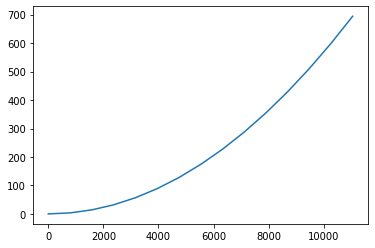

In [99]:
plt.plot(x0, z0)
plt.show()

In [100]:
rng = np.random.default_rng()
q0=np.zeros(12*node_N)

In [101]:

for j in range(1,12):
    if j==1:  
        q0[(j-1)*node_N:j*node_N]=x0
    elif j==5:    
        q0[(j-1)*node_N:j*node_N]=z0
    elif j==7 or j==9 or j==11:    
        q0[(j-1)*node_N:j*node_N]=rng.standard_normal(node_N)

In [102]:
q0

array([ 0.00000000e+00,  7.89477489e+02,  1.57895498e+03,  2.36843247e+03,
        3.15790996e+03,  3.94738744e+03,  4.73686493e+03,  5.52634242e+03,
        6.31581991e+03,  7.10529740e+03,  7.89477489e+03,  8.68425238e+03,
        9.47372987e+03,  1.02632074e+04,  1.10526848e+04,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  

### Vessel

In [103]:
t

array([0. , 0.5])

In [104]:
sampleTime = 0.01                 # sample time [seconds]
N = 50_000                         # number of samples

In [105]:
N

50000

In [106]:
vehicle=semisub('DPcontrol',10,10.,40.0,0,0) 

In [107]:
[simTime, simData] = simulate(N, sampleTime, vehicle)

In [108]:
simData.shape

(50001, 24)

In [109]:
ans_t=[]
sum_=0
for i in range(simData.shape[0]):
    ans_t.append(sum_)
    sum_+=0.01

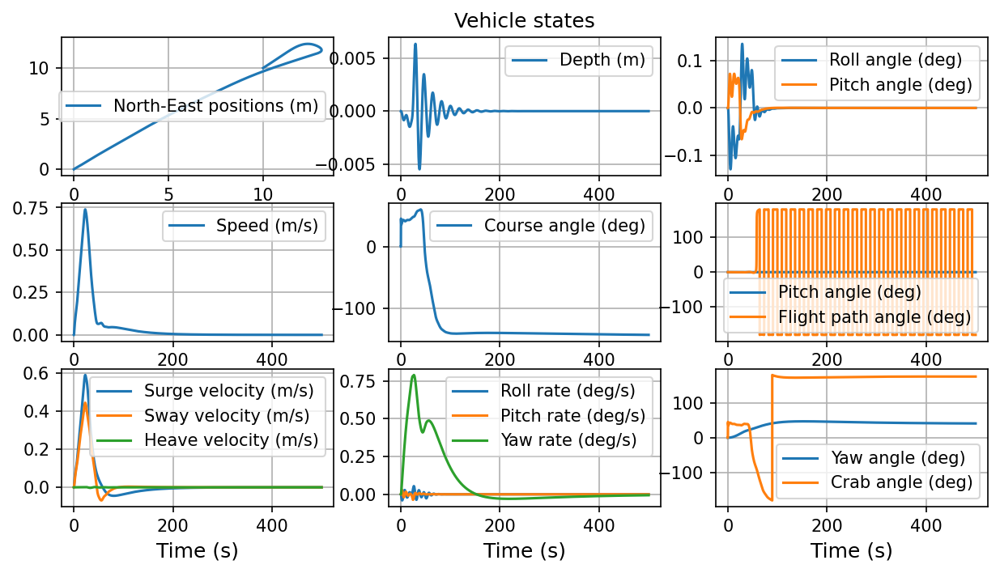

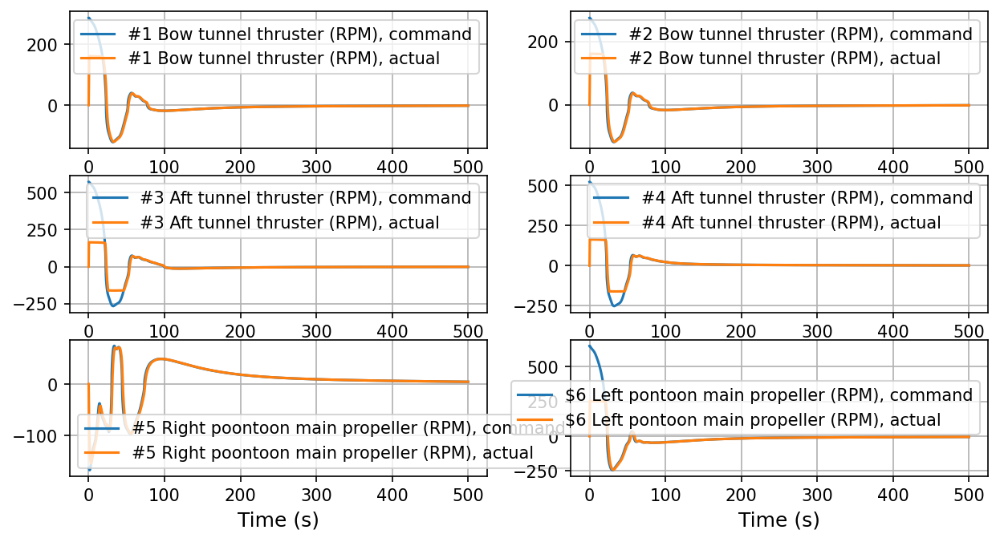

In [110]:
plotVehicleStates(simTime, simData, 1)                    
plotControls(simTime, simData, vehicle, 2)

In [111]:
numDataPoints = 5                 # number of 3D data points
FPS = 10                            # frames per second (animated GIF)
filename = '3D_animation.gif'       # data file for animated GIF
browser = 'safari'                  # browser for visualization of animated GIF

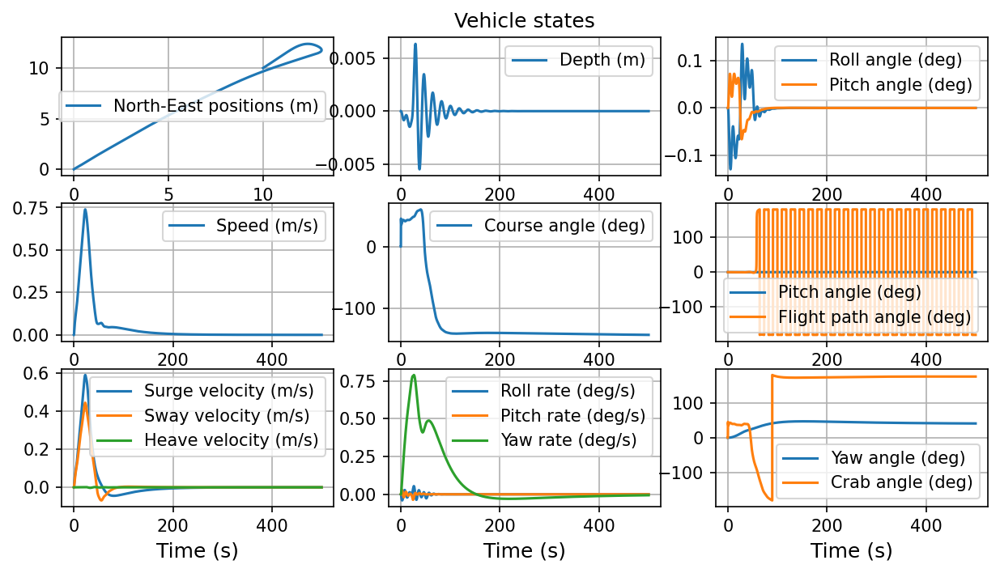

In [112]:
plotVehicleStates(simTime, simData, 3)

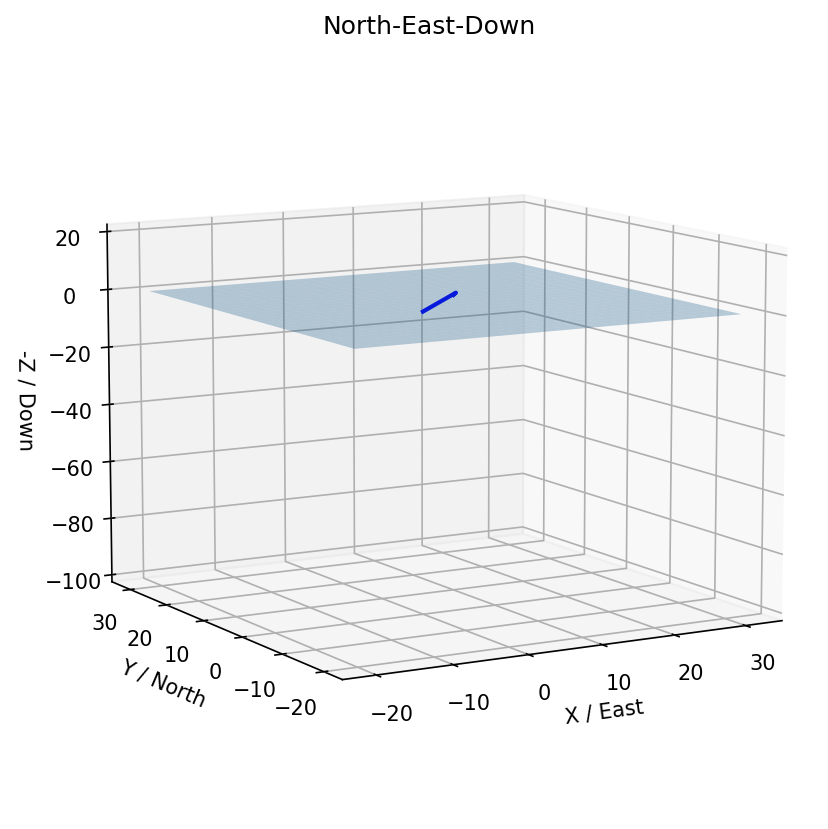

In [113]:
plot3D(simData, numDataPoints, FPS, filename, 3)  

### Modelling

In [114]:
# class Time:
#     def __init__(self):
#         self.time=0

In [115]:
# co=Time()

In [116]:
# t

In [117]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx

In [124]:
def grayscott1d(Q, t, simData):
#     dt=0
#     dt=abs(t-co.time)
#     print('dt',t,co.time,dt)
#     co.time=t
    
    
#     print(Q)   
    
    idx = find_nearest(np.array(ans_t), t)
#     print(t)
#     print(idx)
#     ind=ans_t.index(val)
    # State vectors
    x_ve = simData[:, 0][idx]
    y_ve = simData[:, 1][idx]
    z_ve = simData[:, 2][idx]
#     phi_ve = R2D(ssa(simData[:, 3][idx]))
#     theta_ve = R2D(ssa(simData[:, 4][idx]))
#     psi_v = R2D(ssa(simData[:, 5][idx]))
    phi_ve = ssa(simData[:, 3][idx])
    theta_ve = ssa(simData[:, 4][idx])
    psi_v = ssa(simData[:, 5][idx])
    u_ve = simData[:, 6][idx]
    v_ve = simData[:, 7][idx]
    w_ve = simData[:, 8][idx]
#     p_ve = R2D(simData[:, 9][idx])
#     q_ve = R2D(simData[:, 10][idx])
#     r_ve = R2D(simData[:, 11][idx])
    p_ve = simData[:, 9][idx]
    q_ve = simData[:, 10][idx]
    r_ve = simData[:, 11][idx]
#     if t>dt*co.count:
#         co.count+=1
        
#     print(type(Q))
    x,y,z=Q[0:node_N],Q[2*node_N:3*node_N],Q[4*node_N:5*node_N]
#     print(x0[-1],y0[-1])

    x[-1]=x_ve+x0[-1]
    y[-1]=y_ve
    z[-1]=z_ve+z0[-1]
    x[0]=0
    y[0]=0
    z[0]=0
#     print(z)
#     print(z_ve)
#     print(x_ve,y_ve,z_ve)
#     print(x[0],y[0],z[0])
#     print(x[-1],y[-1],z[-1])
#     print()
    dx,dy,dz=Q[1*node_N:2*node_N],Q[3*node_N:4*node_N],Q[5*node_N:6*node_N]
    
    dx[-1]=u_ve
    dy[-1]=v_ve 
    dz[-1]=w_ve
#     print(dx,dy.shape, dx.shape)
    φ,θ,ψ=Q[6*node_N:7*node_N],Q[8*node_N:9*node_N],Q[10*node_N:11*node_N]
    
    φ[-1]=phi_ve
    θ[-1]=theta_ve
    ψ[-1]=psi_v
    
    dφ,dθ,dψ=Q[7*node_N:8*node_N],Q[9*node_N:10*node_N],Q[11*node_N:12*node_N]
    
    dφ[-1]=p_ve
    dθ[-1]= q_ve
    dψ[-1]=r_ve
#     print(z)    
#     print(t)
    
#     ddx = np.empty_like(y)
#     ddy = np.empty_like(y)
#     ddz = np.empty_like(y)
#     ddφ = np.empty_like(y)
#     ddθ = np.empty_like(y)
#     ddψ= np.empty_like(y)
    C=ne(x,y,z,φ,θ,ψ)
#     print('C',C)
  
    a,b,c=C[:,0],C[:,1],C[:,2]
#     print(a)
    
#     for it in [φ,θ,ψ,x,y,z,dx,dy,dz]:
#         print(it)
    # here single Re_b(φ,θ,ψ) etc.
#     print(np.einsum('ijk,ik->ij', Re_b(φ,θ,ψ).astype(float), ne_(x,y,z,dx,dy,dz).astype(float).T))
#     print(ne_(x,y,z,dx,dy,dz).astype(float))
    ddx,ddy, ddz = (1/Ws*(d_s(a,b,c,x,y,z).T + 
                          np.einsum('ijk,ik->ij', Re_b(φ,θ,ψ).astype(float), ne_(x,y,z,dx,dy,dz).astype(float).T)
                         )).T
#     print('ddx',ddx)  
#     print('ddy',ddy) 
#     print('ddz',ddz) 
    
    me_=me(φ,θ,ψ)
#     print(Re_b(φ,θ,ψ).shape)
#     print(Irho_e(φ,θ,ψ).shape)
#     print(Irho_e(φ,θ,ψ).shape)

    
    C1=np.einsum('ijk,ik->ij', Re_b(φ,θ,ψ).astype(float), np.einsum('ijk,ik->ij', Irho_e(φ,θ,ψ).astype(float),
                                                        np.einsum('ijk,ik->ij', Π(dφ,dθ,dψ).astype(float), np.array([dφ,dθ,dψ]).astype(float).T)))
        
    C2= np.cross(np.einsum('ijk,ik->ij',Π(φ,θ,ψ).astype(float),np.array([dφ,dθ,dψ]).astype(float).T),
                 np.einsum('ijk,ik->ij',Irho_e(φ,θ,ψ).astype(float),
                           np.einsum('ijk,ik->ij',Π(φ,θ,ψ).astype(float),np.array([dφ,dθ,dψ]).astype(float).T)))
    
#     print(Re_b(φ,θ,ψ).shape)
# #     print(me_)
# #     print(me_[:,0])
#     print(d_s(me_[:,0],me_[:,1],me_[:,2],dt,ds).shape)
# #     print(Irho_e(φ,θ,ψ).shape)
#     print(d_s(me_[:,0],me_[:,1],me_[:, 2],dt,ds))
#     print(me_)
#     print('d_s',d_s(me_[:,0],me_[:,1],me_[:, 2],x,y,z))
    C3= np.einsum('ijk,ik->ij',Re_b(φ,θ,ψ).astype(float),d_s(me_[:,0],me_[:,1],me_[:, 2],x,y,z).astype(float).T)
    
#     print(d_s(x,y,z,dt,ds).shape)
#     print(ne(x,y,z,φ,θ,ψ,dt,ds).T.shape)
    C4= np.cross(d_s(x,y,z,x,y,z).T,ne(x,y,z,φ,θ,ψ))
#     print(np.dot(DR,K).shape)
#     print(Re_b(φ,θ,ψ).shape)
#     print(np.dot(DR,K[:,0]))

    K1=np.einsum('ijk,ik->ij',Π(φ,θ,ψ).astype(float),np.array([dφ,dθ,dψ]).astype(float).T).T
#     print('K1',np.array([dφ,dθ,dψ]))
    C5= np.einsum('ijk,ik->ij',Re_b(φ,θ,ψ).astype(float),-np.dot(DR,K1).astype(float).T)
#     print('C1',C1)
#     print('C2',C2)
#     print('C3',C3)
#     print('C4',C4)
#     print('C5',C5)
#     print()
    B =-C1-C2+C3+C4+C5
#     print(Re_b(φ,θ,ψ).shape)
#     print(Irho_e(φ,θ,ψ).shape)
#     print(Π(φ,θ,ψ).shape)
    A1 =Re_b(φ,θ,ψ).astype(float)
    A2 = Irho_e(φ,θ,ψ).astype(float)
    A3=Π(φ,θ,ψ).astype(float)
#     print(np.einsum('ijk,ijk->ijk',A1,A2))
#     print('A1',A1)
#     print(A1)
#     print('bu',A1[0])
#     print('hey', np.dot(A1[0],A2[0]))
#     print('op', np.einsum('ijk,ikr->ijr',A1,A2))
#     print(Π(φ,θ,ψ).shape)
    A=np.einsum('ijk,ikr->ijr',np.einsum('ijk,ikr->ijr',A1,A2),A3)
    
#     print(A)
#     print()
#     print()


#     print(A.shape)
#     print(B.shape)
#     print(np.linalg.solve(A,B) ) 


    ddφ,ddθ,ddψ = np.linalg.solve(A,B).T 
    
#     ans_φ=[]
#     ans_θ=[]
#     ans_ψ=[]
#     for i in range(len(A)):
#         a,b,c=np.linalg.lstsq(A[i],B[i], rcond=None)[0]
#         ans_φ.append(a)
#         ans_θ.append(b)
#         ans_ψ.append(c)
    
# #     print(ans_ψ)

#     ddφ,ddθ,ddψ=np.array(ans_φ),np.array(ans_θ),np.array(ans_ψ)
#     ddφ,ddθ,ddψ =np.linalg.lstsq(A,B,rcond=-1).T 
#     ddφ,ddθ,ddψ =torch.linalg.tensorsolve(torch.from_numpy(A),torch.from_numpy(B)).T
#     print(ddφ)
#     print(np.concatenate([dx, ddx, dy, ddy, dz, ddz, dφ, ddφ, dθ, ddθ, dψ, ddψ]))
    
    # is it the right order ?
#     print('dx',dx)
#     print('dy',dy)
#     print('dz',dz)
    
#     A1111=np.concatenate(np.stack([dx,ddx, dy, ddy, dz, ddz dφ, dθ, dψ, , ddy, ddφ, ddθ, ddψ], axis=0).T) 
    A1111=np.concatenate([dx, ddx, dy, ddy, dz, ddz, dφ, ddφ, dθ, ddθ, dψ, ddψ], axis=0) 
#     print(A1111)
#     print(A1111)
    
#     print(A)
#     print()
#     print(A1111)
    return A1111
    

In [125]:
# for i in range(1000):
#     Q1111=100*rng.standard_normal(12*node_N)
#     print(grayscott1d(Q1111, 0.1, simData))

In [126]:
q0.shape

(180,)

In [1]:
import numpy as np

In [3]:
np.concatenate([np.array([0,3,6]),np.array([1,4,7]),np.array([2,5,8])])

array([0, 3, 6, 1, 4, 7, 2, 5, 8])

In [128]:
# q0=[i for i in range(12)]
max_t = 2 #0.1 # 10 #600  
dt = 0.5
t=np.arange(0,max_t,dt)
# ds = 0.025
print(t)

[0.  0.5 1.  1.5]


In [129]:
startTime1 = datetime.now()
us=odeint(grayscott1d, q0, t, args=(simData,),full_output = 1
#           ,mxstep=5000
         )
print(datetime.now() - startTime1)

0.0
0
C1 [[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
C2 [[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10528606e+07  3.35866396e+07 -1.11540407e+08]
 [-5.63193229e+07  1.94835530e+07  1.22448169e+08]
 [-4.78071539e+07  3.90235407e+07  3.25812729e+07]
 [-1.08604534e+07  4.10921206e+07 -2.23383355e+07]
 [-1.82911276e+07 -1.39057689e+08 -9.26115732e+07]
 [-4.41886148e+07  9.98824462e+07  7.63080880e+07]
 [-3.35480309e+07 -5.58781476e+07 -1.20848465e+08]
 [-1.14407405e+07  8.13144693e+07 -5.83603487e+07]
 [-4.15270185e+06  4.37958988e+06 -2.28622972e+07]
 [ 6.99210176e+07  5.27148658e+07  1.28581874e+08]
 [-2.88736881e+07 -1.58989528e+08 -1.27974812e+07]
 [-7.843511

C1 [[ 0.          0.          0.        ]
 [-0.45980864 -0.03577372 -0.33348034]
 [-0.05297975 -0.13774722  0.74326189]
 [ 1.4551436   2.37880748  1.15586531]
 [ 1.85484402 -0.63646164 -0.6463983 ]
 [-0.8638511  -2.41068719 -1.63234302]
 [-0.30834752  1.71859992  1.33567816]
 [-0.72161632 -0.21245329 -1.01375008]
 [ 0.33350624  0.26104573  0.79022297]
 [-0.03338708  0.03724136 -0.19193364]
 [-0.08098471 -0.09290524  0.01833878]
 [-0.21406342 -1.34754446 -0.11392268]
 [-0.6438878   0.2231244   0.25800104]
 [-0.03891475 -0.04414948  0.20534032]
 [ 0.          0.          0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.60972756e-03 -1.15535268e-02 -7.61804695e-04]
 [-1.38579449e-03 -7.40934880e-03 -3.98192747e-04]
 [ 4.58949579e-02 -3.61473408e-02 -9.75347406e-03]
 [ 5.37089483e-04 -1.61880740e-03 -1.31879169e-02]
 [ 1.08751344e-02  7.69688733e-04  3.82135486e-02]
 [ 1.62164048e-02  3.62777724e-02 -4.46099209e-02]
 [-5.81850386e-03  5.28595490e-04  5.20038233e-03]


[ 0.00000000e+00  5.88905186e-06  1.17868339e-06  1.73982167e-06
 -7.94033672e-06 -2.98132889e-07 -2.35780849e-07  1.53611743e-05
 -1.33741255e-05  2.01185887e-05 -2.20616152e-05 -2.43804946e-07
  2.12383471e-05 -2.03544043e-05  0.00000000e+00  0.00000000e+00
  3.50616973e+02  7.01753714e+01  1.03583909e+02 -4.72744491e+02
 -1.77499629e+01 -1.40377041e+01  9.14559520e+02 -7.96256425e+02
  1.19780210e+03 -1.31348423e+03 -1.45154376e+01  1.26446925e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.63172130e-19
 -3.25706867e-09 -1.40315138e-20  3.41350900e-19 -7.07823696e-10
 -7.83048393e-22  3.70325529e-19 -2.45686662e-09 -1.14009614e-19
 -2.96290988e-18 -1.45930395e-09 -5.62894445e-19 -2.61715819e-18
  0.00000000e+00  0.00000000e+00  1.55447085e-11 -1.93916370e-01
 -1.33671448e-12  3.25190347e-11 -4.21417591e-02 -7.45947984e-14
  3.52793232e-11 -1.46274673e-01 -1.08611958e-11 -2.82263719e-10
 -8.68827013e-02 -5.36245346e-11 -2.49325432e-10 -1.36090450e-01
  0.00000000e+00  6.28401

[ 0.00000000e+00  1.29062984e-05  2.58317296e-06  3.81294960e-06
 -1.74018429e-05 -6.53380577e-07 -5.16731398e-07  3.36651646e-05
 -2.93103980e-05  4.40913946e-05 -4.83496828e-05 -5.34316955e-07
  4.65454292e-05 -4.46082021e-05  0.00000000e+00  0.00000000e+00
  3.50616972e+02  7.01753711e+01  1.03583913e+02 -4.72744494e+02
 -1.77499637e+01 -1.40377042e+01  9.14559520e+02 -7.96256423e+02
  1.19780210e+03 -1.31348423e+03 -1.45154489e+01  1.26446926e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  9.55429854e-19
 -7.13811005e-09 -8.21593176e-20  1.99872882e-18 -1.55124870e-09
 -4.58498376e-21  2.16838541e-18 -5.38440728e-09 -6.67565993e-19
 -1.73488731e-17 -3.19817396e-09 -3.29594369e-18 -1.53243760e-17
  0.00000000e+00  0.00000000e+00  7.46612454e-11 -1.93916370e-01
 -6.42028913e-12  1.56188948e-10 -4.21417619e-02 -3.58297002e-13
  1.69446617e-10 -1.46274672e-01 -5.21663990e-11 -1.35571277e-09
 -8.68827026e-02 -2.57558700e-10 -1.19751020e-09 -1.36090450e-01
  0.00000000e+00  1.37718

C1 [[  0.           0.           0.        ]
 [ -2.72964038  -0.30051133  -2.74751982]
 [ -0.52141534  -0.84981129   5.20658213]
 [  8.47976839  14.55001792   3.9310897 ]
 [ 10.73413612   6.08577845 -18.86988662]
 [ -6.78493293 -38.7301372  -23.79781881]
 [ -5.49642178   8.23394905   5.81220258]
 [ -4.65969699  -1.21452176  -6.75460993]
 [  2.40389382  -0.90932856   3.55331357]
 [ -0.22458489   0.25319926  -1.29761806]
 [ 13.48538469  11.88708595  25.74891867]
 [ -1.45759619  -9.10163649  -0.76665992]
 [ -4.37847738   1.516394     1.82670188]
 [  0.3261804   -0.17214743   3.17800153]
 [  0.           0.           0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.36814270e-02 -5.28834970e-01 -3.48697866e-02]
 [-6.34314116e-02 -3.39145162e-01 -1.82263159e-02]
 [ 2.10073131e+00 -1.65455809e+00 -4.46441975e-01]
 [ 2.45840196e-02 -7.40971316e-02 -6.03645346e-01]
 [ 4.97783028e-01  3.52306399e-02  1.74913345e+00]
 [ 7.42266952e-01  1.66052809e+00 -2.04191235e+00]
 [-2.6

C1 [[  0.           0.           0.        ]
 [ -3.47699185  -0.44095499  -3.98798027]
 [ -0.79730498  -1.10382951   7.13868294]
 [  1.10419679   8.10743364  -0.99461128]
 [ 14.18611167  12.94055675 -31.06572294]
 [ -9.15356838 -58.34758504 -35.13452364]
 [ -9.01505405   9.32606405   6.20562358]
 [ -6.16676007  -1.52200741  -9.06783562]
 [  3.25493978  -2.6008345    3.69798282]
 [ -0.30295776   0.34306906  -1.75413765]
 [ -2.4874354    0.21276562  -3.38916773]
 [ -4.06815067 -11.79548561  -0.87473694]
 [ -5.93210358   2.0543951    2.51543032]
 [  0.76914838  -0.16092989   5.291789  ]
 [  0.           0.           0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.34724170e-01 -9.66958054e-01 -6.37583076e-02]
 [-1.15982330e-01 -6.20116227e-01 -3.33262425e-02]
 [ 3.84112057e+00 -3.02530968e+00 -8.16305742e-01]
 [ 4.49511323e-02 -1.35484341e-01 -1.10374650e+00]
 [ 9.10180519e-01  6.44181071e-02  3.19823551e+00]
 [ 1.35721166e+00  3.03622345e+00 -3.73357272e+00]
 [-4.8

C1 [[  0.           0.           0.        ]
 [ -3.80865911  -0.51840123  -4.66096596]
 [ -0.95352766  -1.22215841   8.12363174]
 [ -5.00715681   2.222669    -4.47940714]
 [ 16.08867857  16.76519766 -37.32677821]
 [-10.17627215 -67.33633994 -40.15935275]
 [-10.97219587   9.55949434   6.13557226]
 [ -6.8917293   -1.65333964 -10.20967326]
 [  3.66061547  -3.67505951   3.53637049]
 [ -0.34200123   0.38813822  -1.98229727]
 [-17.63483017 -11.38772674 -31.117937  ]
 [ -3.81860651 -13.50527572  -1.16803038]
 [ -6.71092969   2.32418469   2.86864571]
 [  1.05416402  -0.14105515   6.54098163]
 [  0.           0.           0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.72100734e-01 -1.23522147e+00 -8.14467931e-02]
 [-1.48159334e-01 -7.92155226e-01 -4.25719497e-02]
 [ 4.90676336e+00 -3.86462437e+00 -1.04277428e+00]
 [ 5.74219563e-02 -1.73071846e-01 -1.40995920e+00]
 [ 1.16269212e+00  8.22896356e-02  4.08552300e+00]
 [ 1.73374321e+00  3.87856389e+00 -4.76937908e+00]
 [-6.2

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.38784201e+00 -6.88261773e-01 -6.11172355e+00]
 [-1.30277963e+00 -1.44167718e+00  1.01309604e+01]
 [-1.94671467e+01 -1.19073231e+01 -1.17492860e+01]
 [ 2.05766804e+01  2.43361682e+01 -4.88818947e+01]
 [-1.17195778e+01 -8.12705273e+01 -4.75049541e+01]
 [-1.51121767e+01  9.47577368e+00  5.55466356e+00]
 [-8.28194365e+00 -1.87247946e+00 -1.24615776e+01]
 [ 4.40748502e+00 -6.22290195e+00  2.73940072e+00]
 [-4.19801370e-01  4.78544195e-01 -2.43841617e+00]
 [-5.35954013e+01 -3.94738239e+01 -9.69261062e+01]
 [-2.93917435e+00 -1.70453148e+01 -1.39453198e+00]
 [-8.27234162e+00  2.86537200e+00  3.59276690e+00]
 [ 1.75025796e+00 -7.25865470e-02  9.42062838e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.60564247e-01 -1.87015204e+00 -1.23312215e-01]
 [-2.24316429e-01 -1.19934016e+00 -6.44548515e-02]
 [ 7.42894495e+00 -5.85113365e+00 -1.57878522e+00]
 [ 8.69381519e-02 -2.620

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.63532359e+00 -7.80879928e-01 -6.88917977e+00]
 [-1.49589869e+00 -1.54296170e+00  1.11531906e+01]
 [-2.65292430e+01 -1.87075118e+01 -1.48083802e+01]
 [ 2.32879029e+01  2.77159888e+01 -5.36742663e+01]
 [-1.21794566e+01 -8.53596980e+01 -4.93351640e+01]
 [-1.72201742e+01  9.19425730e+00  5.08622136e+00]
 [-8.94617848e+00 -1.96081485e+00 -1.35707559e+01]
 [ 4.73887796e+00 -7.67119316e+00  2.10530840e+00]
 [-4.58557685e-01  5.23880696e-01 -2.66637544e+00]
 [-6.87345790e+01 -5.14753807e+01 -1.24561378e+02]
 [-5.17000066e+00 -1.81711951e+01 -1.30607224e+00]
 [-9.05482093e+00  3.13678218e+00  3.96366722e+00]
 [ 2.16085682e+00 -2.39354814e-02  1.10495108e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.11651198e-01 -2.23681920e+00 -1.47489152e-01]
 [-2.68296519e-01 -1.43448609e+00 -7.70920460e-02]
 [ 8.88548365e+00 -6.99832923e+00 -1.88832790e+00]
 [ 1.03983530e-01 -3.134

 [ 1.75218418e+06 -2.59439968e+04 -1.55135996e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.36454554e-21 -1.61331446e+06  4.38942345e-19]
 [-2.79607662e-12 -3.87558906e+06 -4.60283251e-10]
 [-1.34624284e-12  8.53847418e+06 -8.23208285e-10]
 [-3.21942970e-20 -1.31088251e+06  1.21391732e-18]
 [ 1.42186911e-11 -1.58009970e+05 -3.54376561e-10]
 [ 3.54220253e-12 -1.68760169e+07  1.00574409e-10]
 [ 1.28776799e-20  2.15684104e+07 -1.95865494e-18]
 [-1.10082948e-11 -1.43890238e+06  1.26220622e-10]
 [ 2.48335843e-13 -1.26041461e+05 -3.66035555e-13]
 [-2.05168901e-18 -5.58194193e+07  4.57201570e-19]
 [ 4.61773141e-12 -1.68665800e+05 -5.08488992e-11]
 [ 3.48458985e-12  4.09278634e+07 -4.45428788e-10]
 [-2.42649487e-18 -9.48954799e+07 -3.63324472e-19]
 [ 0.00000000e+00  0.00000000e+00  6.16297582e-33]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.58688600e-02 -2.76956567e-01  2.97373341e-01]
 [-1.26989786e-02 -1.19925925e-01 -2.96493793e-01]
 [ 6.01048648e+00 -4.81

[ 0.00000000e+00  5.50097774e-05  1.10101101e-05  1.62517213e-05
 -7.41708831e-05 -2.78486763e-06 -2.20243474e-06  1.43489106e-04
 -1.24928031e-04  1.87928229e-04 -2.06078089e-04 -2.27740135e-06
  1.98387935e-04 -1.90130989e-04  0.00000000e+00  0.00000000e+00
  3.50616966e+02  7.01753646e+01  1.03583993e+02 -4.72744553e+02
 -1.77499821e+01 -1.40377052e+01  9.14559516e+02 -7.96256382e+02
  1.19780207e+03 -1.31348425e+03 -1.45156924e+01  1.26446952e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  7.10842284e-17
 -3.04243582e-08 -6.11270595e-18  1.48705933e-16 -6.61180181e-09
 -3.41134821e-19  1.61328441e-16 -2.29496505e-08 -4.96671229e-17
 -1.29076063e-15 -1.36313954e-08 -2.45219101e-16 -1.14013755e-15
  0.00000000e+00  0.00000000e+00  1.35634945e-09 -1.93916369e-01
 -1.16635851e-10  2.83743954e-09 -4.21418222e-02 -6.50916080e-12
  3.07828825e-09 -1.46274659e-01 -9.47692309e-10 -2.46288455e-08
 -8.68827288e-02 -4.67899594e-09 -2.17548249e-08 -1.36090450e-01
  0.00000000e+00  5.86991

C1 [[  0.           0.           0.        ]
 [ -5.53064218  -1.45042919 -12.27171601]
 [ -2.91578446  -2.03531218  17.54161094]
 [-36.38708759 -22.49483159 -11.59672427]
 [ 48.84147796  32.45328483 -57.13137571]
 [ -9.67230967 -54.18658516 -26.52669339]
 [-27.85030523   5.53232386   1.33455802]
 [-12.46921762  -2.21060097 -19.96308855]
 [  5.8530603  -17.90857748  -4.7608848 ]
 [ -0.68907195   0.79775848  -4.03272877]
 [ -1.09360091   2.76448576   1.01642552]
 [ -9.11679719 -27.1267845   -2.13273276]
 [-13.77117306   4.77708919   6.31261621]
 [  5.4809604    0.47067277  23.40782428]
 [  0.           0.           0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.14145618e-01 -5.12564832e+00 -3.37969953e-01]
 [-6.14798638e-01 -3.28711022e+00 -1.76655621e-01]
 [ 2.03609815e+01 -1.60367048e+01 -4.32711254e+00]
 [ 2.38277959e-01 -7.18177339e-01 -5.85073932e+00]
 [ 4.82468448e+00  3.41467250e-01  1.69532163e+01]
 [ 7.19430246e+00  1.60944170e+01 -1.97909333e+01]
 [-2.5

1.8691521713343683e-07
0
C1 [[  0.           0.           0.        ]
 [ -5.58174956  -1.58188184 -13.28656971]
 [ -3.19621335  -2.0986764   18.64810646]
 [-30.33448575 -14.52731     -6.90166051]
 [ 54.78514234  29.74514477 -52.7782254 ]
 [ -8.42867084 -39.67402365 -17.30142804]
 [-28.9039274    4.82911997   0.80396832]
 [-12.97512372  -2.20811156 -20.98057877]
 [  5.85635825 -19.72974565  -6.35131107]
 [ -0.7271521    0.84371303  -4.26022061]
 [ 26.64370887  25.59134063  52.04060259]
 [ -6.87749285 -29.30180499  -2.63468299]
 [-14.56031552   5.05251264   6.72466253]
 [  6.17361405   0.58688059  25.8874244 ]
 [  0.           0.           0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.97223477e-01 -5.72192419e+00 -3.77286619e-01]
 [-6.86319249e-01 -3.66950566e+00 -1.97206284e-01]
 [ 2.27296080e+01 -1.79023048e+01 -4.83049907e+00]
 [ 2.65997437e-01 -8.01724500e-01 -6.53136718e+00]
 [ 5.38594938e+00  3.81190750e-01  1.89254180e+01]
 [ 8.03122847e+00  1.79667115e+0

2.0692921275177894e-07
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298403e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04 -3.00369838e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753596e+01  1.03584056e+02 -4.72744600e+02
 -1.77499965e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  3.69294279e-16 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939843e-09 -1.93916368e-01
 -2.02890638e-10  4.93578541e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.78429768e-08 -1.36090450e-01
  0.00000000e+00  7.74188

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768706e-04  2.47860242e-04 -2.71798260e-04 -3.00369838e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753596e+01  1.03584056e+02 -4.72744600e+02
 -1.77499965e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  3.69294279e-16 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939843e-09 -1.93916368e-01
 -2.02890638e-10  4.93578541e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.7


[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04 -3.00369427e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753596e+01  1.03584056e+02 -4.72744600e+02
 -1.77499965e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  3.69294279e-16 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939843e-09 -1.93916368e-01
 -2.02890638e-10  4.93578541e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.78429768e-08 -1.36090450e-01
  0.00000000e+00  7.7418

C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.82606834e-01 -8.00494810e+00]
 [ 6.60110564e+00  4.67193343e-01  2.31952979e+01]
 [ 9.84319874e+00  2.20202876e+01 -2.70778442e+01]
 [-3.53177585e+00  3.20852682e-01  3.15658203e+00]
 [-1.32783263e+01 -1.08889110e+01  1.57896410e+01]
 [-2.01827155e-02 -1.96684458e-02  1.48095454e-06]
 [-6.91250857e+01  2.07333598e+02 -2.35036947e+01]
 [ 4.30511832e+01  8.85840135e+00  7.84098426e-01]
 [ 1.09674508e-01  1.90353783e-01  1.80738463e-01]
 [-9.29265921e+00  1.24195027e+01  2.14512478e-01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10528616e+07  3.35866357e+07 -1.11540407e+08]
 [-5.63193248e+07  1.94835525e+07  1.22448167e+08]
 [-4.78071149e+07  3.90235736e+07  3.25812800e+07]
 [-1.08604665e+07  4.109

2.0692921275177894e-07
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

 -1.30339580e+08  4.01330102e+05  8.68521435e+04 -7.75679971e+05]
2.0692921275177894e-07
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04 -3.00369838e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753596e+01  1.03584056e+02 -4.72744600e+02
 -1.77499965e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  4.11121971e-12 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939843e-09 -1.93916368e-01
 -2.02890638e-10  4.93578541e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.78429768e-08 -1.36090450e-01
  0.00000000e+00  7.74188

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04 -3.00369838e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753596e+01  1.03584056e+02 -4.72744600e+02
 -1.77499965e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  3.69294279e-16 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939843e-09 -1.93916368e-01
 -2.02890638e-10  4.93578541e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.78429768e-08 -1.36090450e-01
  0.00000000e+00  7.74188

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04 -3.00369838e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753596e+01  1.03584056e+02 -4.72744600e+02
 -1.77499965e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  3.69294279e-16 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939843e-09 -1.93916368e-01
 -2.02890638e-10  4.93578541e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.78429768e-08 -1.36090450e-01
  0.00000000e+00  7.74188

 -1.30339580e+08  4.01330102e+05  8.68521435e+04 -7.75679971e+05]
2.0692921275177894e-07
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04 -3.00369838e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753596e+01  1.03584056e+02 -4.72744600e+02
 -1.77499965e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  3.69294279e-16 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939843e-09 -1.93916368e-01
 -2.02890638e-10  4.93578541e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.78429768e-08 -1.36090450e-01
  0.00000000e+00  7.74188

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04 -3.00369838e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753596e+01  1.03584056e+02 -4.72744600e+02
 -1.77499965e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  3.69294279e-16 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939844e-09 -1.93916368e-01
 -2.02890638e-10  4.93578541e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.78429768e-08 -1.36090450e-01
  0.00000000e+00  7.74188

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055670e+01 -4.03016358e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011078e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499208e+01  3.59125958e+00  7.58887952e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866358e+00 -2.33262650e+01 -9.82578176e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363792e+01  5.63312656e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

 -1.30339580e+08  4.01330102e+05  8.68521435e+04 -7.75679971e+05]
2.0692921275177894e-07
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993513e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163532e-01 -4.49740353e+00 -

 -1.30339580e+08  4.01330102e+05  8.68521435e+04 -7.75679971e+05]
2.0692921275177894e-07
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499214e+01  3.59125940e+00  7.58885127e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866311e+00 -2.33262624e+01 -9.82578029e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04 -3.00369838e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753596e+01  1.03584056e+02 -4.72744600e+02
 -1.77499965e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  3.69294279e-16 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939843e-09 -1.93916368e-01
 -2.02890638e-10  4.93578541e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.78429768e-08 -1.36090450e-01
  0.00000000e+00  7.74188

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04 -3.00369838e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753596e+01  1.03584056e+02 -4.72744600e+02
 -1.77499965e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  3.69294279e-16 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939843e-09 -1.93916368e-01
 -2.02890638e-10  4.93578541e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.78429768e-08 -1.36090450e-01
  0.00000000e+00  7.74188

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444465e+01  2.12055674e+01 -4.03016406e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26010975e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866313e+00 -2.33262630e+01 -9.82578041e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

 [ 3.08148791e-33  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.39897925e-02 -4.18690155e-01  4.49555296e-01]
 [-1.91977207e-02 -1.81298488e-01 -4.48225626e-01]
 [ 9.08638033e+00 -7.27274656e+00 -1.98498852e+00]
 [-1.05029101e-01 -1.54084335e+00 -5.06126631e-01]
 [ 5.16672739e-01  7.91702560e-02  1.18661343e+00]
 [ 1.27167993e+00  5.72659993e-01 -2.21999067e+00]
 [-9.04267528e-03  2.49955102e-02  7.43344283e-01]
 [-1.05559166e+00 -1.75654386e+00  2.50640391e+00]
 [ 1.29375151e-02 -1.27102775e-02  3.54043963e-02]
 [-4.79561612e+00  1.05255575e+01 -2.31684461e+00]
 [ 9.02993771e+00  3.92217561e+01  2.62386880e+00]
 [ 2.57592397e-01 -5.44162469e-02 -8.29661228e-02]
 [-4.04387145e-01  7.56891290e-01 -1.70732912e-01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442749e+00  8.48100153e-01  3.11942540e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04 -3.00369838e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753596e+01  1.03584056e+02 -4.72744600e+02
 -1.77499965e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  3.69294279e-16 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939843e-09 -1.93916368e-01
 -2.02890638e-10  4.93578541e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.7

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737513e+00 -4.97204288e+00  4.20202667e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04 -3.00369838e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753596e+01  1.03584056e+02 -4.72744600e+02
 -1.77499965e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  3.69294279e-16 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939843e-09 -1.93916368e-01
 -2.02890638e-10  4.93578541e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.78429768e-08 -1.36090450e-01
  0.00000000e+00  7.74188

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363800e+01  5.63312674e+01  1.17664832e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442748e+00  8.48100194e-01  3.11942545e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04 -3.00369838e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753596e+01  1.03584056e+02 -4.72744600e+02
 -1.77499965e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  3.69294279e-16 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939843e-09 -1.93916368e-01
 -2.02890638e-10  4.93578541e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.78429768e-08 -1.36090450e-01
  0.00000000e+00  7.74188

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04 -3.00369838e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753504e+01  1.03584065e+02 -4.72744600e+02
 -1.77499965e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  3.69294279e-16 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939843e-09 -1.93916368e-01
 -2.02890638e-10  4.93578541e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.78429768e-08 -1.36090450e-01
  0.00000000e+00  7.74188

[ 0.00000000e+00  7.25528933e-05  1.45213336e-05  2.14345467e-05
 -9.78246528e-05 -3.67298814e-06 -2.90481119e-06  1.89249081e-04
 -1.64768710e-04  2.47860242e-04 -2.71798260e-04 -3.00369838e-06
  2.61655658e-04 -2.50765484e-04  0.00000000e+00  0.00000000e+00
  3.50616961e+02  7.01753596e+01  1.03584056e+02 -4.72744599e+02
 -1.77499979e+01 -1.40377060e+01  9.14559512e+02 -7.96256349e+02
  1.19780205e+03 -1.31348426e+03 -1.45158829e+01  1.26446972e+03
 -1.21184187e+03  1.26810627e+03  0.00000000e+00  1.62717734e-16
 -4.01269616e-08 -1.39925006e-17  3.40400280e-16 -8.72036854e-09
 -7.80886788e-19  3.69294279e-16 -3.02685012e-08 -1.13692193e-16
 -2.95465889e-15 -1.79785723e-08 -5.61327041e-16 -2.60987007e-15
  0.00000000e+00  0.00000000e+00  2.35939843e-09 -1.93916368e-01
 -2.02890638e-10  4.93578537e-09 -4.21418694e-02 -1.13228259e-11
  5.35474740e-09 -1.46274648e-01 -1.64853073e-09 -4.28423964e-08
 -8.68827493e-02 -8.13921304e-09 -3.78429768e-08 -1.36090450e-01
  0.00000000e+00  7.74188

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866358e+00 -2.33262629e+01 -9.82578058e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

 -1.30339581e+08  4.01330102e+05  8.68521435e+04 -7.75679971e+05]
2.0692921275177894e-07
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908051e+00 -3.26328000e+01 -2.51339276e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -

C1 [[-2.10619453e-10 -9.93637960e-11  1.71574244e-10]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10528616e+07  3.35866357e+07 -1.11540407e+08]
 [-5.63193248e+07  1.94835525e+07  1.22448167e+08]
 [-4.78071149e+07  3.90235736e+07  3.25812800e+07]
 [-1.08604665e+07  4.10922358e+07 -2.23383924e+07]
 [-1.82911275e+07 -1.39057920e+08 -9.26116028e+07]
 [-4.41886782e+07  9.98824884e+07  7.63081350e+07]
 [-3.35480310e+07 -5.58781531e+07 -1.20848464e+08]
 [-1.14407476e+07  8.13144285e+07 -5.83603797e+07]
 [-4.15270716e+06  4.37959316e+06 -2.28622676e+07]
 [ 6.99210753e+07  5.27148200e+07  1.28581710e+08]
 [-2.88736404e+07 -1.58989415e+08 -1.27974432e+07]
 [-7.84351079e+07 -2.43022824e+07  3.30987353e+07]
 [ 4.93658141e+07  9.27927583e+07  1.28644560e+08]
 [ 1.75218428e+06 -2.59438575e+04 -1.55135994e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.04589584e-21 -1.61331441e+06  2.26650031e-18]
 [-6.36330187e-12 -3.87558905e+06 -1.04751125e-09]
 [-3.06376990e-12  8.53

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444353e+01  2.12055650e+01 -4.03016329e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26010886e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499204e+01  3.59126026e+00  7.58894063e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866314e+00 -2.33262627e+01 -9.82578045e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88907932e+00 -3.26327998e+01 -2.51339297e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442738e+00  8.48100156e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016075e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476074e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024873e+01  9.00180554e+00  5.43286395e+00]
 [ 6.79444338e+01  2.12055668e+01 -4.03016356e+01]
 [-5.46737494e+00 -4.97204185e+00  4.20202724e+00]
 [-3.00499209e+01  3.59125994e+00  7.58890368e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866319e+00 -2.33262630e+01 -9.82578042e+00]
 [-8.03020328e-01  9.35884838e-01 -4.71500400e+00]
 [ 6.24363787e+01  5.63312660e+01  1.17664830e+02]
 [-6.88908050e+00 -3.26328000e+01 -2.51339288e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633332e+00]
 [ 7.67442739e+00  8.48100158e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287967e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577542e+01 -2.19413979e+01 -5.92034958e+00]
 [ 3.26011074e-01 -9.826

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.60016076e+00 -1.86263480e+00 -1.54152280e+01]
 [-3.79476073e+00 -2.20993519e+00  2.08961470e+01]
 [-1.13024865e+01  9.00180648e+00  5.43286443e+00]
 [ 6.79444344e+01  2.12055663e+01 -4.03016348e+01]
 [-5.46737492e+00 -4.97204178e+00  4.20202727e+00]
 [-3.00499210e+01  3.59125994e+00  7.58890457e-02]
 [-1.39134917e+01 -2.16785435e+00 -2.29705783e+01]
 [ 5.67866320e+00 -2.33262629e+01 -9.82578040e+00]
 [-8.03020329e-01  9.35884839e-01 -4.71500399e+00]
 [ 6.24363801e+01  5.63312673e+01  1.17664832e+02]
 [-6.88908051e+00 -3.26328000e+01 -2.51339287e+00]
 [-1.61407668e+01  5.60517261e+00  7.56633333e+00]
 [ 7.67442738e+00  8.48100155e-01  3.11942541e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.77089585e-01 -7.01287968e+00 -4.62408412e-01]
 [-8.41163546e-01 -4.49740347e+00 -2.41699096e-01]
 [ 2.78577544e+01 -2.19413967e+01 -5.92034926e+00]
 [ 3.26011078e-01 -9.826

2.2694320837012106e-07
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.50717176e+00 -2.16776787e+00 -1.76741957e+01]
 [-4.44361535e+00 -2.30101006e+00  2.31903513e+01]
 [ 1.46398953e+01  3.99115684e+01  1.96973172e+01]
 [ 8.24383393e+01  9.07228674e+00 -2.40278152e+01]
 [-2.17029326e+00  3.39312830e+01  2.76465776e+01]
 [-2.96967705e+01  2.76983425e+00 -2.38782869e-02]
 [-1.47513599e+01 -2.08247251e+00 -2.48977373e+01]
 [ 5.24197221e+00 -2.67526074e+01 -1.36062790e+01]
 [-8.78498004e-01  1.02840583e+00 -5.16952030e+00]
 [ 4.92633385e+01  4.85786212e+01  9.30708644e+01]
 [-1.12257174e+01 -3.48572042e+01 -2.83120048e+00]
 [-1.77237541e+01  6.16030090e+00  8.43140769e+00]
 [ 9.32590588e+00  1.14750860e+00  3.69541404e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.17523622e+00 -8.43504013e+00 -5.56181488e-01]
 [-1.01174527e+00 -5.40944386e+00 -2.90713890e-01]
 [ 3.35070915e+01 -2.63910140e+01 -7.12096970e+00]

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.38489688e+00 -2.38301437e+00 -1.92367439e+01]
 [-4.89979247e+00 -2.35036599e+00  2.47306894e+01]
 [ 3.25773969e+01  6.09458548e+01  2.81792856e+01]
 [ 9.24750804e+01 -3.83455616e-01 -1.21392087e+01]
 [-4.33366617e-03  5.96161359e+01  4.27714918e+01]
 [-2.85337430e+01  2.56669616e+00  3.57857975e-01]
 [-1.52482508e+01 -2.00245541e+00 -2.61345407e+01]
 [ 4.80659243e+00 -2.88590932e+01 -1.62157441e+01]
 [-9.28137392e-01  1.08970830e+00 -5.46958935e+00]
 [ 1.06332128e+01  1.94758450e+01  2.18248637e+01]
 [-6.87551511e+00 -3.80710324e+01 -3.46598416e+00]
 [-1.87705289e+01  6.52835642e+00  9.01561679e+00]
 [ 1.04972587e+01  1.36605271e+00  4.10005516e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31614035e+00 -9.44635321e+00 -6.22864505e-01]
 [-1.13304770e+00 -6.05800527e+00 -3.25568818e-01]
 [ 3.75243915e+01 -2.95551943e+01 -7.97474641e+00]
 [ 4.39138295e-01 -1.323

C1 [[   0.            0.            0.        ]
 [  -5.16282427   -2.66937587  -21.27924516]
 [  -5.50432768   -2.40051224   26.69469335]
 [  50.85409695   82.22391673   34.84107718]
 [ 105.28842583  -13.16022208    2.92719069]
 [   2.48991576   89.26360373   59.80132836]
 [ -25.93532034    2.80789394    1.44384101]
 [ -15.80763198   -1.87641658  -27.64669931]
 [   4.09180194  -31.26429914  -19.55858766]
 [  -0.99029011    1.16697915   -5.84660589]
 [ -60.16754338  -35.39099244 -108.44648607]
 [  -9.3693996   -40.244551     -3.02607561]
 [ -20.08742896    6.99259129    9.76439352]
 [  12.05810945    1.66399447   46.35239346]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.50456767e+00 -1.07987550e+01 -7.12037922e-01]
 [-1.29526216e+00 -6.92530900e+00 -3.72179375e-01]
 [ 4.28966166e+01 -3.37865792e+01 -9.11648229e+00]
 [ 5.02008956e-01 -1.51306647e+00 -1.23264019e+01]
 [ 1.01646964e+01  7.19405844e-01  3.57172332e+01]
 [ 1.5157009

C1 [[   0.            0.            0.        ]
 [  -4.76324671   -3.06639762  -24.04843268]
 [  -6.33755014   -2.44624289   29.28016622]
 [  57.0541688    89.60109824   31.89642982]
 [ 121.61940312  -29.73740349   20.56941781]
 [   4.99985305  118.98421812   76.06333358]
 [ -20.60090641    4.12055372    4.00242798]
 [ -16.4211862    -1.67339733  -29.52937966]
 [   2.89387532  -33.86573414  -23.86972438]
 [  -1.07027225    1.2672706    -6.33394617]
 [-149.31976504 -105.64084965 -272.04712571]
 [ -12.44249685  -42.9916046    -3.66877503]
 [ -21.79212365    7.59570128   10.75662428]
 [  14.21863297    2.08728112   53.69938188]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.76695792e+00 -1.26820118e+01 -8.36214382e-01]
 [-1.52115025e+00 -8.13305335e+00 -4.37085859e-01]
 [ 5.03775833e+01 -3.96789286e+01 -1.07063890e+01]
 [ 5.89558383e-01 -1.77694057e+00 -1.44760830e+01]
 [ 1.19373822e+01  8.44867151e-01  4.19461918e+01]
 [ 1.7800325

C1 [[   0.            0.            0.        ]
 [  -4.86784855   -2.97096606  -23.38908262]
 [  -6.13781435   -2.43746049   28.67191761]
 [  57.98791228   90.59963607   33.99736509]
 [ 117.86600828  -25.95594887   16.76487868]
 [   4.50571826  113.16808418   72.99234   ]
 [ -22.04965017    3.7020095     3.27953195]
 [ -16.28915105   -1.72470735  -29.09733002]
 [   3.20072062  -33.31658212  -22.87208015]
 [  -1.05163697    1.24381671   -6.22017859]
 [-131.64049536  -91.62037325 -239.66080387]
 [ -13.86480322  -41.8392461    -3.30995925]
 [ -21.39394718    7.45459795   10.52253641]
 [  13.70012833    1.98464429   51.94183867]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.70380283e+00 -1.22287280e+01 -8.06326169e-01]
 [-1.46678092e+00 -7.84235962e+00 -4.21463424e-01]
 [ 4.85769793e+01 -3.82606876e+01 -1.03237113e+01]
 [ 5.68485955e-01 -1.71342829e+00 -1.39586729e+01]
 [ 1.15107118e+01  8.14669689e-01  4.04469341e+01]
 [ 1.7164102

C1 [[   0.            0.            0.        ]
 [  -4.49879233   -3.29053144  -25.58223418]
 [  -6.80526509   -2.46204291   30.67881607]
 [  48.57561284   80.12671081   23.69215057]
 [ 129.97664264  -37.95603181   28.26850132]
 [   5.88161481  129.21391253   81.15017956]
 [ -16.82730297    5.35455291    5.95660436]
 [ -16.69664337   -1.5476685   -30.49790572]
 [   2.13325325  -34.9710899   -26.10836467]
 [  -1.11271615    1.32088779   -6.59357038]
 [-176.58285179 -127.4100082  -321.82068428]
 [  -7.85634346  -45.97912997   -4.15584804]
 [ -22.70123935    7.91842343   11.29642601]
 [  15.43347175    2.330152     57.80488227]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.91542216e+00 -1.37475859e+01 -9.06475247e-01]
 [-1.64896101e+00 -8.81641275e+00 -4.73810894e-01]
 [ 5.46104215e+01 -4.30129260e+01 -1.16059870e+01]
 [ 6.39095280e-01 -1.92624462e+00 -1.56924054e+01]
 [ 1.29403946e+01  9.15854988e-01  4.54706305e+01]
 [ 1.9295952

C1 [[   0.            0.            0.        ]
 [  -4.05612126   -3.62840471  -27.85732075]
 [  -7.50658385   -2.47461172   32.71497508]
 [  20.8120563    48.98000819    4.44900634]
 [ 141.33069092  -48.30257928   36.39118166]
 [   6.48727445  135.63268211   83.32807232]
 [ -10.27011253    7.85794176    9.54408887]
 [ -17.02889948   -1.3466147   -31.846643  ]
 [   0.89823181  -36.16425169  -29.18941468]
 [  -1.17352688    1.39819163   -6.96678128]
 [-174.72863216 -126.20446318 -317.81407747]
 [ -11.94573606  -47.74417993   -3.53722825]
 [ -24.00907248    8.3841065    12.08603131]
 [  17.25504514    2.70015753   63.93198023]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.13942565e+00 -1.53553289e+01 -1.01248516e+00]
 [-1.84180243e+00 -9.84746839e+00 -5.29221787e-01]
 [ 6.09969427e+01 -4.80433047e+01 -1.29633122e+01]
 [ 7.13836966e-01 -2.15151548e+00 -1.75275998e+01]
 [ 1.44537450e+01  1.02296174e+00  5.07883227e+01]
 [ 2.1552561

C1 [[   0.            0.            0.        ]
 [  -3.44112351   -4.05020672  -30.63965537]
 [  -8.37574194   -2.47450143   35.14978117]
 [ -29.48373527   -7.22066966  -24.31394207]
 [ 153.44860626  -57.41034802   40.61322974]
 [   6.1338612   129.62503332   77.68255278]
 [  -0.88819822   11.99878482   15.00345158]
 [ -17.32222107   -1.0808411   -33.36612674]
 [  -0.75426892  -36.89714557  -32.51297872]
 [  -1.24479466    1.48952499   -7.4060566 ]
 [-108.82891652  -73.65247785 -196.11131017]
 [ -14.79653607  -50.18875821   -4.24345703]
 [ -25.5496044     8.93494836   13.03600711]
 [  19.50889883    3.16675297   71.4724212 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.41910004e+00 -1.73626391e+01 -1.14484141e+00]
 [-2.08257010e+00 -1.11347691e+01 -5.98403772e-01]
 [ 6.89706801e+01 -5.43239231e+01 -1.46579843e+01]
 [ 8.07154297e-01 -2.43277268e+00 -1.98188922e+01]
 [ 1.63432054e+01  1.15668738e+00  5.74276105e+01]
 [ 2.4369996

 -1.30339640e+08  4.01330088e+05  8.68506552e+04 -7.75679952e+05]
3.222418067125992e-07
0
C1 [[   0.            0.            0.        ]
 [  -3.55472947   -3.97536591  -30.15043808]
 [  -8.22204233   -2.47565011   34.72573519]
 [ -20.01541492    3.33013317  -19.27188413]
 [ 151.45827491  -56.10893504   40.32765878]
 [   6.27759845  131.72663293   79.29207671]
 [  -2.63552702   11.18618223   13.96123192]
 [ -17.27912196   -1.12897742  -33.10869836]
 [  -0.45402224  -36.82602578  -31.96660614]
 [  -1.23249228    1.4737016    -7.33008108]
 [-124.35444813  -86.09209997 -224.72061638]
 [ -15.964139    -49.36825985   -3.97156107]
 [ -25.28308232    8.83946307   12.87011037]
 [  19.11079863    3.08367375   70.14348269]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.36948852e+00 -1.70065618e+01 -1.12136269e+00]
 [-2.03986026e+00 -1.09064144e+01 -5.86131561e-01]
 [ 6.75562171e+01 -5.32097992e+01 -1.43573650e+01]
 [ 7.90600683e-01 -2.382

C1 [[   0.            0.            0.        ]
 [  -2.34604628   -4.72342428  -34.96017651]
 [  -9.7484089    -2.44595341   38.8277428 ]
 [-101.35644331  -86.47194972  -55.98296431]
 [ 168.60803478  -63.3468344    35.28158444]
 [   3.61676094   94.77394604   54.12156336]
 [  16.0402165    20.66839869   25.62058669]
 [ -17.5588117    -0.63397551  -35.47405021]
 [  -3.54179022  -36.46826699  -36.57866034]
 [  -1.34965425    1.62537886   -8.056166  ]
 [  46.81028616   52.45417852   89.80962024]
 [ -13.93531947  -55.15834625   -4.0874718 ]
 [ -27.83112529    9.7557258    14.48276661]
 [  23.05136033    3.91759376   83.25019826]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.86485342e+00 -2.05619498e+01 -1.35579478e+00]
 [-2.46631270e+00 -1.31865071e+01 -7.08668074e-01]
 [ 8.16794457e+01 -6.43342989e+01 -1.73590406e+01]
 [ 9.55886951e-01 -2.88104982e+00 -2.34708286e+01]
 [ 1.93546871e+01  1.36982327e+00  6.80095179e+01]
 [ 2.8860508

C1 [[   0.            0.            0.        ]
 [  -1.37297305   -5.27219498  -38.38370174]
 [ -10.85439      -2.40292811   41.66682787]
 [-115.18440704 -100.14815752  -52.53785056]
 [ 177.99415952  -61.60703679   22.69396735]
 [   0.52530953   52.40555745   27.4041688 ]
 [  30.9141042    29.29780186   35.644889  ]
 [ -17.5785753    -0.25731438  -36.95143736]
 [  -5.86560486  -34.80891862  -38.77545997]
 [  -1.42845537    1.7286474    -8.54775315]
 [ 114.073269    109.23278493  212.37180156]
 [ -15.50656371  -58.27705371   -5.07986813]
 [ -29.55693152   10.38089608   15.60907068]
 [  25.88385083    4.53177724   92.61502183]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.22720425e+00 -2.31626543e+01 -1.52727782e+00]
 [-2.77825518e+00 -1.48543553e+01 -7.98301399e-01]
 [ 9.20103271e+01 -7.24717827e+01 -1.95547425e+01]
 [ 1.07679164e+00 -3.24545310e+00 -2.64394755e+01]
 [ 2.18027095e+01  1.54308041e+00  7.66115121e+01]
 [ 3.2510822

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.98987931e-01 -5.58150331e+00 -4.02777938e+01]
 [-1.14727847e+01 -2.37252415e+00  4.32128044e+01]
 [-1.00663561e+02 -8.27981827e+01 -3.88355033e+01]
 [ 1.82442066e+02 -5.86806660e+01  1.34882035e+01]
 [-1.36092498e+00  2.63829362e+01  1.14506488e+01]
 [ 3.95066357e+01  3.46629323e+01  4.17099375e+01]
 [-1.75318880e+01 -4.22664597e-02 -3.77024147e+01]
 [-7.17153600e+00 -3.34058563e+01 -3.95865293e+01]
 [-1.47062787e+00  1.78433602e+00 -8.81193177e+00]
 [ 1.07258345e+02  1.05741122e+02  1.99082388e+02]
 [-1.01429221e+01 -6.14982133e+01 -5.45856537e+00]
 [-3.04843884e+01  1.07185159e+01  1.62258297e+01]
 [ 2.74573793e+01  4.87787866e+00  9.78006084e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.43094440e+00 -2.46249606e+01 -1.62369814e+00]
 [-2.95365205e+00 -1.57921416e+01 -8.48699811e-01]
 [ 9.78190986e+01 -7.70473187e+01 -2.07893394e+01]
 [ 1.14477334e+00 -3.450

C1 [[   0.            0.            0.        ]
 [   1.26748528   -6.63688293  -46.56610804]
 [ -13.55685154   -2.24339649   48.23734898]
 [  19.62808295   54.19083298   32.44311082]
 [ 195.06856924  -42.87391114  -22.21980331]
 [  -7.09190584  -54.53757838  -36.25830741]
 [  68.82479967   54.92123593   63.8721766 ]
 [ -17.1123407     0.69665885  -39.88966691]
 [ -11.48979005  -26.39409445  -40.20002664]
 [  -1.60434035    1.96288672   -9.65469907]
 [-100.29320614  -54.79280397 -184.14564102]
 [ -16.67570242  -66.00903231   -5.80946885]
 [ -33.44205351   11.80352823   18.24695041]
 [  32.69810195    6.05410654  114.99990014]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.12310581e+00 -2.95928178e+01 -1.95126464e+00]
 [-3.54952337e+00 -1.89780598e+01 -1.01991709e+00]
 [ 1.17553066e+02 -9.25917708e+01 -2.49836307e+01]
 [ 1.37572710e+00 -4.14643252e+00 -3.37793840e+01]
 [ 2.78553827e+01  1.97145343e+00  9.78797296e+01]
 [ 4.1536109

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.47648105e-04  2.95515035e-05  4.36202461e-05
 -1.99077225e-04 -7.47469632e-06 -5.91141065e-06  3.85129631e-04
 -3.35311043e-04  5.04405728e-04 -5.53120609e-04 -6.11284732e-06
  5.32480196e-04 -5.10318034e-04  0.00000000e+00  0.00000000e+00
  3.50616922e+02  7.01753221e+01  1.03584520e+02 -4.72744945e+02
 -1.77501029e+01 -1.40377120e+01  9.14559488e+02 -7.96256111e+02
  1.19780191e+03 -1.31348436e+03 -1.45172909e+01  1.26447121e+03
 -1.21184186e+03  1.26810628e+03  0.00000000e+00  1.37361288e-15
 -8.16600104e-08 -1.18120672e-16  2.87355294e-15 -1.77463564e-08
 -6.59201139e-18  3.11746868e-15 -6.15976293e-08 -9.59754362e-16
 -2.49423204e-14 -3.65871526e-08 -4.73855232e-15 -2.20317192e-14
  0.00000000e+00  0.00000000e+00  9.77119178e-09 -1.93916363e-01
 -8.40252878e-10  2.04410045e-08 -4.21422183e-02 -4.68922656e-11
  2.21761079e-08 -1.46274569e-01 -6.82720988e-09 -1.77427146e-07
 -8.68829010e-02 -3.37076966e-08 -1.5

C1 [[   0.            0.            0.        ]
 [   3.13535626   -7.53949172  -51.75173055]
 [ -15.30899248   -2.11014159   52.27549487]
 [  92.27227192  134.92564592   58.76638336]
 [ 204.90462158  -27.98618721  -50.30136825]
 [  -9.70467279  -94.38898064  -57.59544274]
 [  92.68182795   73.6091304    83.62493925]
 [ -16.49248804    1.32555829  -41.37473131]
 [ -14.90015765  -18.07827277  -38.37076074]
 [  -1.70835391    2.10391325  -10.31585307]
 [-270.24881302 -188.96828932 -495.99930544]
 [ -20.77368317  -69.8847396    -5.0870155 ]
 [ -35.75993631   12.66348516   19.8895095 ]
 [  37.02134851    7.05004171  129.120498  ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.71119310e+00 -3.38137025e+01 -2.22957799e+00]
 [-4.05579870e+00 -2.16849399e+01 -1.16538994e+00]
 [ 1.34319783e+02 -1.05799078e+02 -2.85473009e+01]
 [ 1.57195584e+00 -4.73785536e+00 -3.85974559e+01]
 [ 3.18284843e+01  2.25264587e+00  1.11840641e+02]
 [ 4.7460480

C1 [[   0.            0.            0.        ]
 [   5.96532317   -8.85244129  -59.01846085]
 [ -17.81140672   -1.89229287   57.8066766 ]
 [  16.49477692   48.37378593   -1.54437149]
 [ 220.25970271  -12.46912807  -77.87772005]
 [  -8.53588522  -84.30839773  -46.71479061]
 [ 123.50640146  100.89598645  111.6996828 ]
 [ -15.26137672    2.22159382  -43.02929623]
 [ -19.24470416   -3.01287891  -32.57933487]
 [  -1.84630023    2.29391864  -11.20050364]
 [-165.54280156 -104.84733974 -301.91833895]
 [ -16.24239754  -77.38909128   -6.05482413]
 [ -38.85563881   13.8267286    22.1654399 ]
 [  43.05104482    8.47570678  148.7363557 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.56027598e+00 -3.99078330e+01 -2.63140812e+00]
 [-4.78676088e+00 -2.55931447e+01 -1.37542424e+00]
 [ 1.58527590e+02 -1.24868218e+02 -3.36926457e+01]
 [ 1.85527399e+00 -5.59175714e+00 -4.55538258e+01]
 [ 3.75648781e+01  2.65863272e+00  1.31997522e+02]
 [ 5.6014105

C1 [[   0.            0.            0.        ]
 [   9.15854085  -10.28669677  -66.62819607]
 [ -20.4870172    -1.63478118   63.472197  ]
 [-129.59755873 -112.19414731  -69.17185698]
 [ 238.56364057   -6.55196002  -90.48188311]
 [  -1.95700497    6.32436829   11.68293864]
 [ 150.55075445  128.27467762  139.23859841]
 [ -13.57393068    3.16398608  -44.2861644 ]
 [ -23.08631719   16.39804747  -23.1257235 ]
 [  -1.98266973    2.48519109  -12.08412781]
 [ 132.28279307  135.38679123  243.92282394]
 [ -14.1995868   -84.25393332   -7.3211227 ]
 [ -41.93844737   15.003654     24.52765714]
 [  49.29646397    9.99622064  168.98023794]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.47966797e+00 -4.65065934e+01 -3.06651239e+00]
 [-5.57825076e+00 -2.98249719e+01 -1.60285061e+00]
 [ 1.84739878e+02 -1.45517068e+02 -3.92642377e+01]
 [ 2.16205556e+00 -6.51637081e+00 -5.30862493e+01]
 [ 4.37762981e+01  3.09823771e+00  1.53823597e+02]
 [ 6.5276013

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

 [ 1.75218538e+06 -2.59423403e+04 -1.55135978e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.59672407e-19 -1.61331392e+06  1.15698563e-16]
 [-4.52362595e-11 -3.87558893e+06 -7.44669513e-09]
 [-2.17797289e-11  8.53849136e+06 -1.33183217e-08]
 [-8.48606777e-18 -1.31087561e+06  3.19974317e-16]
 [ 2.30038891e-10 -1.58008043e+05 -5.73332543e-09]
 [ 5.73075714e-11 -1.68760196e+07  1.62715027e-09]
 [ 3.39436146e-18  2.15684155e+07 -5.16271553e-16]
 [-1.78095764e-10 -1.43883150e+06  2.04206159e-09]
 [ 4.01769685e-12 -1.26041365e+05 -5.92189990e-12]
 [-5.40790093e-16 -5.58190732e+07  1.20507335e-16]
 [ 7.47095753e-11 -1.68887013e+05 -8.22715407e-10]
 [ 5.63754457e-11  4.09278651e+07 -7.20637231e-09]
 [-6.39586710e-16 -9.48954770e+07 -9.57671343e-17]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.40532088e-02 -1.11791501e+00  1.20032608e+00]
 [-5.12583148e-02 -4.84072524e-01 -1.19677553e+00]
 [ 2.42610386e+01 -1.94

[ 0.00000000e+00  1.93718343e-04  3.87723731e-05  5.72310355e-05
 -2.61194817e-04 -9.80702435e-06 -7.75593326e-06  5.05300589e-04
 -4.39937204e-04  6.61794065e-04 -7.25709362e-04 -8.02046937e-06
  6.98628821e-04 -6.69551196e-04  0.00000000e+00  0.00000000e+00
  3.50616886e+02  7.01752864e+01  1.03584961e+02 -4.72745272e+02
 -1.77502041e+01 -1.40377178e+01  9.14559465e+02 -7.96255885e+02
  1.19780177e+03 -1.31348445e+03 -1.45186297e+01  1.26447263e+03
 -1.21184186e+03  1.26810629e+03  0.00000000e+00  3.10117905e-15
 -1.07140163e-07 -2.66679352e-16  6.48756207e-15 -2.32837654e-08
 -1.48826576e-17  7.03824911e-15 -8.08177580e-08 -2.16681861e-15
 -5.63117954e-14 -4.80033699e-08 -1.06981430e-14 -4.97405870e-14
  0.00000000e+00  0.00000000e+00  1.68202806e-08 -1.93916358e-01
 -1.44642973e-09  3.51874382e-08 -4.21425501e-02 -8.07210719e-11
  3.81743010e-08 -1.46274495e-01 -1.17524631e-08 -3.05425864e-07
 -8.68830452e-02 -5.80250003e-08 -2.69784714e-07 -1.36090450e-01
  0.00000000e+00  2.06710

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

5.525070684869524e-07
0
C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65

 [ 1.75218538e+06 -2.59423403e+04 -1.55135978e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.59672407e-19 -1.61331392e+06  1.15698563e-16]
 [-4.52362595e-11 -3.87558893e+06 -7.44669513e-09]
 [-2.17797289e-11  8.53849136e+06 -1.33183217e-08]
 [-8.48606777e-18 -1.31087561e+06  3.19974317e-16]
 [ 2.30038891e-10 -1.58008043e+05 -5.73332543e-09]
 [ 5.73075714e-11 -1.68760196e+07  1.62715027e-09]
 [ 3.39436146e-18  2.15684155e+07 -5.16271553e-16]
 [-1.78095764e-10 -1.43883150e+06  2.04206159e-09]
 [ 4.01769685e-12 -1.26041365e+05 -5.92189990e-12]
 [-5.40790093e-16 -5.58190732e+07  1.20507335e-16]
 [ 7.47095753e-11 -1.68887013e+05 -8.22715407e-10]
 [ 5.63754657e-11  4.09278723e+07 -7.20637357e-09]
 [-6.39586484e-16 -9.48954604e+07 -9.57671176e-17]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.40532088e-02 -1.11791501e+00  1.20032608e+00]
 [-5.12583148e-02 -4.84072524e-01 -1.19677553e+00]
 [ 2.42610386e+01 -1.94

5.525070684869524e-07
0
C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10528675e+07  3.35866120e+07 -1.11540402e+08]
 [-5.63193361e+07  1.94835491e+07  1.22448153e+08]
 [-4.78068767e+07  3.90237747e+07  3.25813238e+07]
 [-1.08605463e+07  4.10929393e+07 -2.23387394e+07]
 [-1.82911267e+07 -1.39059333e+08 -9.26117840e+07]
 [-4.41890661e+07  9.98827465e+07  7.63084218e+07]
 [-3.35480320e+07 -5.58781869e+07 -1.20848457e+08]
 [-1.14407910e+07  8.13141793e+07 -5.83605694e+07]
 [-4.15273957e+06  4.37961315e+06 -2.28620866e+07]
 [ 6.99214278e+07  5.27145404e+07  1.28580711e+08]
 [-2.88733488e+07 -1.58988728e+08 -1.27972114e+07]
 [-7.84350603e+07 -2.43023782e+07  3.30988484e+07]
 [ 4.93658425e+07  9.27928010e+07  1.28644502e+08]
 [ 1.75218538e+06 -2.59423403e+04 -1.55135978e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.59672407e-19 -1.61331392e+06  1.15698563e-16]
 [-4.52362595e-11 -3.87558893e+06 -7.44669513e-09]
 [-2.17797289e-11  8.53

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

5.525070684869524e-07
0
C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

[ 0.00000000e+00  1.93718340e-04  3.87723731e-05  5.72310355e-05
 -2.61194817e-04 -9.80702435e-06 -7.75593326e-06  5.05300589e-04
 -4.39937204e-04  6.61794065e-04 -7.25709362e-04 -8.02046937e-06
  6.98628821e-04 -6.69551196e-04  0.00000000e+00  0.00000000e+00
  3.50616886e+02  7.01752864e+01  1.03584961e+02 -4.72745272e+02
 -1.77502041e+01 -1.40377178e+01  9.14559465e+02 -7.96255885e+02
  1.19780177e+03 -1.31348445e+03 -1.45186297e+01  1.26447263e+03
 -1.21184186e+03  1.26810629e+03  0.00000000e+00  3.10117905e-15
 -1.07140163e-07 -2.66679352e-16  6.48756207e-15 -2.32837654e-08
 -1.48826576e-17  7.03824911e-15 -8.08177580e-08 -2.16681861e-15
 -5.63117954e-14 -4.80033699e-08 -1.06981430e-14 -4.97405870e-14
  0.00000000e+00  0.00000000e+00  1.68202801e-08 -1.93916358e-01
 -1.44642973e-09  3.51874382e-08 -4.21425501e-02 -8.07210719e-11
  3.81743010e-08 -1.46274495e-01 -1.17524631e-08 -3.05425864e-07
 -8.68830452e-02 -5.80250003e-08 -2.69784714e-07 -1.36090450e-01
  0.00000000e+00  2.06710

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

5.525070684869524e-07
0
C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

[ 0.00000000e+00  1.93718340e-04  3.87723731e-05  5.72310355e-05
 -2.61194817e-04 -9.80702435e-06 -7.75593326e-06  5.05300589e-04
 -4.39937204e-04  6.61794065e-04 -7.25709362e-04 -8.02046937e-06
  6.98628821e-04 -6.69551196e-04  0.00000000e+00  0.00000000e+00
  3.50616886e+02  7.01752864e+01  1.03584961e+02 -4.72745272e+02
 -1.77502041e+01 -1.40377178e+01  9.14559465e+02 -7.96255885e+02
  1.19780177e+03 -1.31348445e+03 -1.45186297e+01  1.26447263e+03
 -1.21184186e+03  1.26810629e+03  0.00000000e+00  3.10117905e-15
 -1.07140163e-07 -2.66679352e-16  6.48756207e-15 -2.32837654e-08
 -1.48826576e-17  7.03824911e-15 -8.08177580e-08 -2.16681861e-15
 -5.63117954e-14 -4.80033699e-08 -1.06981430e-14 -4.97405870e-14
  0.00000000e+00  0.00000000e+00  1.68202801e-08 -1.93916358e-01
 -1.44642973e-09  3.51874382e-08 -4.21425501e-02 -8.07210719e-11
  3.81743010e-08 -1.46274495e-01 -1.17524631e-08 -3.05425864e-07
 -8.68830452e-02 -5.80250003e-08 -2.69784714e-07 -1.36090450e-01
  0.00000000e+00  2.06710

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66517533 -115.34054992  -57.94478916]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597843e+02 -1.56433897e+02 -4.22098777e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

5.525070684869524e-07
0
C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553668    27.61512411  -17.18738889]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408861   15.59746014   25.74090084]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

C1 [[   0.            0.            0.        ]
 [  10.88674626  -11.04995867  -70.55288082]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572943e+00 -4.99952087e+01 -3.29654215e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

[ 0.00000000e+00  1.93718340e-04  3.87723731e-05  5.72310355e-05
 -2.61194817e-04 -9.80702435e-06 -7.75593326e-06  5.05300589e-04
 -4.39937204e-04  6.61794065e-04 -7.25709362e-04 -8.02046937e-06
  6.98628821e-04 -6.69551196e-04  0.00000000e+00  0.00000000e+00
  3.50616886e+02  7.01752864e+01  1.03584961e+02 -4.72745272e+02
 -1.77502041e+01 -1.40377178e+01  9.14559465e+02 -7.96255885e+02
  1.19780177e+03 -1.31348445e+03 -1.45186297e+01  1.26447263e+03
 -1.21184186e+03  1.26810629e+03  0.00000000e+00  3.10117905e-15
 -1.07140163e-07 -2.66679352e-16  6.48756207e-15 -2.32837654e-08
 -1.48826576e-17  7.03824911e-15 -8.08177580e-08 -2.16681861e-15
 -5.63117954e-14 -4.80033699e-08 -1.06981430e-14 -4.97405870e-14
  0.00000000e+00  0.00000000e+00  1.68202801e-08 -1.93916358e-01
 -1.44642973e-09  3.51874382e-08 -4.21425501e-02 -8.07210719e-11
  3.81743010e-08 -1.46274495e-01 -1.17524631e-08 -3.05425864e-07
 -8.68830452e-02 -5.80250003e-08 -2.69784714e-07 -1.36090450e-01
  0.00000000e+00  2.06710

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644114  161.88048759  298.35708664]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

 -1.30339873e+08  4.01330108e+05  8.68460892e+04 -7.75679889e+05]
5.525070684869524e-07
0
C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18477448   -6.6337934   -93.02023679]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424465e+00 -7.005

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.75536575   27.61512208  -17.18739036]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

5.525070684869524e-07
0
C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943179   10.78830137  179.27503534]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786992   -1.49302957   66.35326625]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669334e+00 -3.20622437e+01 -1.72308574e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

5.525070684869524e-07
0
C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105357    3.64756303  -44.76102062]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.5522952   -84.52672941   -6.22033761]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

5.525070684869524e-07
0
C1 [[   0.            0.            0.        ]
 [  10.88674595  -11.0499591   -70.55288225]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572926e+00 -4.99952095e+01 -3.29654219e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.5329118    73.6917705    52.95513422]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601455e+01  3.33064695e+00  1.65362591e+02]
 [ 7.0172573

5.525070684869524e-07
0
C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644358  161.88050103  298.35708957]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

5.525070684869524e-07
0
C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473111   -6.633786    -93.02022023]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424401e+00 -7.00519077e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65

C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.75536579   27.61512218  -17.18738909]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943114   10.78830141  179.27503613]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65362589e+02]
 [ 7.0172573

5.525070684869524e-07
0
C1 [[   0.            0.            0.        ]
 [  10.8867467   -11.04995854  -70.55288173]
 [ -21.88786991   -1.49302983   66.35326671]
 [-135.66518033 -115.34054563  -57.94478896]
 [ 248.18473035   -6.6337891   -93.02021555]
 [   2.53291183   73.69176964   52.95513429]
 [ 161.93892532  141.00524681  151.89420529]
 [ -12.56105387    3.6475628   -44.76102093]
 [ -24.7553659    27.61512202  -17.18739033]
 [  -2.05026005    2.58129912  -12.52555505]
 [ 163.01644483  161.88049053  298.35709342]
 [ -26.55229509  -84.52672944   -6.22033762]
 [ -43.47408857   15.59745996   25.74090025]
 [  52.47943118   10.78830142  179.27503625]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.96572989e+00 -4.99952098e+01 -3.29654234e+00]
 [-5.99669357e+00 -3.20622440e+01 -1.72308583e+00]
 [ 1.98597694e+02 -1.56433895e+02 -4.22098786e+01]
 [ 2.32424535e+00 -7.00519480e+00 -5.70684834e+01]
 [ 4.70601447e+01  3.33064698e+00  1.65

C1 [[  0.           0.           0.        ]
 [ 12.70004798 -11.84426359 -74.55257146]
 [-23.32964348  -1.34362701  69.26542083]
 [-77.87126374 -46.56199668 -14.87640041]
 [257.47846277  -7.45326213 -95.22602997]
 [  7.01422762 146.43124545  96.3404463 ]
 [171.61610403 152.52949648 163.30137399]
 [-11.43697737   4.13681442 -45.13141347]
 [-26.23608718  39.7442362  -10.57734679]
 [ -2.11745245   2.6777199  -12.96672573]
 [ 63.62475419  84.54062607 113.67876106]
 [-19.1072075  -89.45196496  -8.00114313]
 [-45.00539816  16.19494435  26.97544132]
 [ 55.69121569  11.59947406 189.65064538]
 [  0.           0.           0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.46936908e+00 -5.36099837e+01 -3.53489085e+00]
 [-6.43026828e+00 -3.43804217e+01 -1.84766906e+00]
 [ 2.12956621e+02 -1.67745587e+02 -4.52620637e+01]
 [ 2.49230126e+00 -7.51169699e+00 -6.11947341e+01]
 [ 5.04627501e+01  3.57146074e+00  1.77318888e+02]
 [ 7.52462032e+01  1.68335443e+02 -2.06999516e+02]
 [-2.6

6.310080616869177e-07
0
C1 [[   0.            0.            0.        ]
 [  18.62930193  -14.4150938   -86.96364332]
 [ -27.89133561   -0.85715203   78.17981139]
 [ 146.78219831  211.95628946   86.27869514]
 [ 278.2906351    -0.89300345 -117.90432684]
 [  12.97497925  304.40884334  183.30788572]
 [ 189.21998913  175.71046584  186.42918778]
 [  -7.41384226    5.62017551  -45.60290354]
 [ -29.52620471   80.60594352   11.89414139]
 [  -2.31662968    2.96884517  -14.28869871]
 [-386.64682226 -269.8668317  -714.12468892]
 [ -17.5482038   -99.51017721   -8.37257027]
 [ -49.56971537   18.010365     30.80586223]
 [  65.41177404   14.1305878   220.99676752]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.08575031e+00 -6.52112501e+01 -4.29984777e+00]
 [-7.82178373e+00 -4.18203888e+01 -2.24750686e+00]
 [ 2.59040056e+02 -2.04050150e+02 -5.50579693e+01]
 [ 3.03166642e+00 -9.13727355e+00 -7.44375907e+01]
 [ 6.13831227e+01  4.34432872e+00  2.15

C1 [[   0.            0.            0.        ]
 [  25.24464497  -17.27006336  -99.90959776]
 [ -32.78645769   -0.32933567   87.34269767]
 [-104.51833057  -63.66713192  -72.41755163]
 [ 284.20713979   36.72741338 -179.23515711]
 [  -4.24843265  210.25209562  113.68027703]
 [ 189.71893607  174.57315226  186.81383403]
 [  -2.45930091    7.09065827  -45.09458409]
 [ -31.35591568  125.45726551   34.80515296]
 [  -2.5121813     3.26273625  -15.60836345]
 [  86.81037968  110.03610506  156.21570503]
 [ -28.50617949 -106.55931976   -7.92061625]
 [ -54.08213669   19.86217575   34.82427756]
 [  75.07124654   16.7702768   252.10057918]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.08603270e+01 -7.79479338e+01 -5.13967196e+00]
 [-9.34948601e+00 -4.99885069e+01 -2.68647684e+00]
 [ 3.09633451e+02 -2.43909715e+02 -6.58131137e+01]
 [ 3.62382930e+00 -1.09219564e+01 -8.89766196e+01]
 [ 7.33723363e+01  5.19283617e+00  2.57820197e+02]
 [ 1.0940645

7.604880629198823e-07
0
C1 [[   0.            0.            0.        ]
 [  33.98815582  -21.06962626 -115.98236116]
 [ -39.05387008    0.32939364   98.62442962]
 [-149.70591469  -93.25425441  -41.28623793]
 [ 288.15051377   91.17630124 -237.95861399]
 [ -53.53825321 -247.5237564  -165.72631799]
 [ 172.82443933  134.87137732  152.27266542]
 [   4.60402148    8.77806922  -43.17351811]
 [ -32.71280422  178.3104771    56.04485575]
 [  -2.74186133    3.61876774  -17.18787278]
 [-163.645822    -91.54185839 -311.64271098]
 [ -27.60751926 -118.25465878  -10.45315367]
 [ -59.41184239   22.13449861   39.88682282]
 [  86.22552572   20.00605361  288.02754379]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31970185e+01 -9.47190875e+01 -6.24552004e+00]
 [-1.13611015e+01 -6.07439580e+01 -3.26449488e+00]
 [ 3.76252365e+02 -2.96398740e+02 -7.99760124e+01]
 [ 4.40358047e+00 -1.32719698e+01 -1.08121163e+02]
 [ 8.91593280e+01  6.31011467e+00  3.13

C1 [[   0.            0.            0.        ]
 [  43.4956542   -25.27623619 -132.46112824]
 [ -45.69930373    0.98387524  110.18545277]
 [ 138.48532512  240.84277826   99.96590267]
 [ 322.50562604   53.47910442 -144.52143991]
 [ -97.82472718 -647.95576628 -385.52620208]
 [ 146.881571     59.73690502   85.35675211]
 [  12.73279738   10.3248747   -39.82568905]
 [ -34.79802877  221.75811376   63.86477241]
 [  -2.96622435    3.97865876  -18.76406441]
 [-258.04414616 -158.13428301 -483.30790907]
 [ -32.59432644 -128.80769475   -9.66878116]
 [ -64.63775823   24.46748472   45.20971737]
 [  96.50381537   23.22877274  321.22842417]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.57612108e+01 -1.13123085e+02 -7.45903545e+00]
 [-1.35685663e+01 -7.25465636e+01 -3.89878890e+00]
 [ 4.49356750e+02 -3.54001121e+02 -9.55186272e+01]
 [ 5.25926794e+00 -1.58507962e+01 -1.29129817e+02]
 [ 1.06483431e+02  7.53616999e+00  3.74168719e+02]
 [ 1.5877748

 -1.30340530e+08  4.01330265e+05  8.68350514e+04 -7.75679728e+05]
9.193476396691113e-07
0
C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.939

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

9.193476396691113e-07
0
C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

9.193476396691113e-07
0
C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

9.193476396691113e-07
0
C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

9.193476396691113e-07
0
C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

 -1.30340572e+08  4.01330298e+05  8.68346164e+04 -7.75679718e+05]
9.193476396691113e-07
0
C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.939

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

 -1.30340572e+08  4.01330276e+05  8.68343774e+04 -7.75679718e+05]
9.193476396691113e-07
0
C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.939

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

C1 [[   0.            0.            0.        ]
 [  56.24423866  -31.09473035 -153.3083081 ]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733757e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

 -1.30340572e+08  4.01330276e+05  8.68343774e+04 -7.75679718e+05]
9.193476396691113e-07
0
C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773034  -49.0067237   -13.59105375]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.939

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45793048   -6.54086652 -106.07923194]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.47242203   27.08827494  356.94801112]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122652  -44.98032981  -77.43344606]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857284e+02 -4.33197293e+02 -1.16887825e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237963  249.14551899   50.04448091]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

9.193476396691113e-07
0
C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.47242033   27.08827495  356.94800597]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947377    1.74672555  124.96142861]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033100e+01 -8.87723838e+01 -4.77079439e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

9.193476396691113e-07
0
C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993127   11.98886844  -33.68885547]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.40772113 -144.63986246  -11.74659793]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

C1 [[-2.79288170e-11  5.45659425e-11 -2.68381170e-12]
 [ 5.62442386e+01 -3.10947306e+01 -1.53308308e+02]
 [-5.44394739e+01  1.74672522e+00  1.24961426e+02]
 [-1.16001227e+02 -4.49803310e+01 -7.74334464e+01]
 [ 3.95942353e+02 -1.57481088e+02  1.54387937e+02]
 [-9.34867304e+01 -3.55299734e+02 -1.70419583e+02]
 [ 1.18187731e+02 -4.90067250e+01 -1.35910539e+01]
 [ 2.40799313e+01  1.19888685e+01 -3.36888555e+01]
 [-4.03423799e+01  2.49145522e+02  5.00444816e+01]
 [-3.23911714e+00  4.43385027e+00 -2.07296401e+01]
 [-4.84579296e+01 -6.54086699e+00 -1.06079232e+02]
 [-2.74077209e+01 -1.44639863e+02 -1.17465979e+01]
 [-7.10013833e+01  2.74763325e+01  5.22201309e+01]
 [ 1.07472422e+02  2.70882753e+01  3.56948011e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00 -1.57858237e-23]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.939

9.193476396691113e-07
0
C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48672706 -355.29973087 -170.41958202]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300190e+02  9.22170723e+00  4.57

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385033  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.47242177   27.08827552  356.9480107 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

 -1.30340572e+08  4.01330276e+05  8.68343774e+04 -7.75679718e+05]
9.193476396691113e-07
0
C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122604  -44.98032981  -77.43344827]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857337e+02 -4.33197136e+02 -1.16887782e+02]
 [ 6.43567300e+00 -1.939

 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300195e+02  9.22170721e+00  4.57858639e+02]
 [ 1.94289607e+02  4.34658790e+02 -5.34498887e+02]
 [-6.97122547e+01  6.33330167e+00  6.23065398e+01]
 [-2.62089037e+02 -2.14923224e+02  3.11666484e+02]
 [-3.98377065e-01 -3.88226888e-01  2.92322726e-05]
 [-1.36459605e+03  4.09279559e+03 -4.63932621e+02]
 [ 8.49784075e+02  1.75084654e+02  1.54870618e+01]
 [ 2.16476572e+00  3.75729914e+00  3.56743382e+00]
 [-1.83425259e+02  2.45144096e+02  4.23426739e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10528797e+07  3.35865633e+07 -1.11540393e+08]
 [-5.63193593e+07  1.94835423e+07  1.22448125e+08]
 [-4.78063867e+07  3.90241886

[ 0.00000000e+00  3.22338813e-04  6.45154899e-05  9.52305155e-05
 -4.34617195e-04 -1.63185912e-05 -1.29055417e-05  8.40798090e-04
 -7.32036006e-04  1.10119625e-03 -1.20754882e-03 -1.33474428e-05
  1.16248969e-03 -1.11410395e-03  0.00000000e+00  0.00000000e+00
  3.50616732e+02  7.01751359e+01  1.03586824e+02 -4.72746656e+02
 -1.77506310e+01 -1.40377419e+01  9.14559368e+02 -7.96254928e+02
  1.19780119e+03 -1.31348485e+03 -1.45242785e+01  1.26447863e+03
 -1.21184184e+03  1.26810632e+03  0.00000000e+00  1.42799093e-14
 -1.78276547e-07 -1.22798248e-15  2.98730417e-14 -3.87435983e-08
 -6.85297494e-17  3.24088372e-14 -1.34477124e-07 -9.97748435e-15
 -2.59297380e-13 -7.98756983e-08 -4.92615410e-14 -2.29039111e-13
  0.00000000e+00  0.00000000e+00  4.65711338e-08 -1.93916337e-01
 -4.00486484e-09  9.74249272e-08 -4.21439506e-02 -2.23496394e-10
  1.05695142e-07 -1.46274179e-01 -3.25396074e-08 -8.45648032e-07
 -8.68836540e-02 -1.60657269e-07 -7.46966546e-07 -1.36090450e-01
  0.00000000e+00  3.43957

C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.94289607e+02  4.34658790e+02 -5.34498887e+02]
 [-6.97122547e+01  6.33330167e+00  6.23065398e+01]
 [-2.62089037e+02 -2.14923224e+02  3.11666484e+02]
 [-3.98377065e-01 -3.88226888e-01  2.92322726e-05]
 [-1.36459605e+03  4.09279559e+03 -4.63932621e+02]
 [ 8.49784075e+02  1.75084654e+02  1.54870618e+01]
 [ 2.16476572e+00  3.75729914e+00  3.56743382e+00]
 [-1.83425265e+02  2.45144094e+02  4.23426696e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10528797e+07  3.35865633e+07 -1.11540393e+08]
 [-5.63193593e+07  1.94835423e+07  1.22448125e+08]
 [-4.78063867e+07  3.90241886e+07  3.25814139e+07]
 [-1.08607106e+07  4.109

C1 [[   0.            0.            0.        ]
 [  56.24423854  -31.09473064 -153.30830802]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48672132 -355.2996119  -170.41950656]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300219e+02  9.22170913e+00  4.57858633e+02]
 [ 1.9428960

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34238003  249.14552214   50.04448318]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.0013833    27.47633246   52.22013094]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

C1 [[   0.            0.            0.        ]
 [  56.24423858  -31.09473063 -153.30830806]
 [ -54.43947391    1.74672522  124.96142617]
 [-116.00122738  -44.98033097  -77.43344642]
 [ 395.94235314 -157.48108762  154.38793694]
 [ -93.48673039 -355.29973372 -170.41958321]
 [ 118.18773146  -49.00672497  -13.59105392]
 [  24.07993134   11.98886853  -33.68885552]
 [ -40.34237986  249.14552172   50.04448164]
 [  -3.23911714    4.43385027  -20.72964006]
 [ -48.45792959   -6.54086699 -106.07923175]
 [ -27.4077209  -144.63986276  -11.74659794]
 [ -71.00138329   27.47633271   52.22013153]
 [ 107.472422     27.08827532  356.94801104]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.92863743e+01 -1.38424268e+02 -9.12733760e+00]
 [-1.66033099e+01 -8.87723825e+01 -4.77079456e+00]
 [ 5.49857281e+02 -4.33197218e+02 -1.16887804e+02]
 [ 6.43567300e+00 -1.93961000e+01 -1.58012223e+02]
 [ 1.30300193e+02  9.22170728e+00  4.57858633e+02]
 [ 1.9428960

[ 0.00000000e+00  3.22338813e-04  6.45154899e-05  9.52305155e-05
 -4.34617195e-04 -1.63185912e-05 -1.29055417e-05  8.40798090e-04
 -7.32036006e-04  1.10119625e-03 -1.20754882e-03 -1.33474428e-05
  1.16248969e-03 -1.11410395e-03  0.00000000e+00  0.00000000e+00
  3.50616732e+02  7.01751359e+01  1.03586824e+02 -4.72746656e+02
 -1.77506310e+01 -1.40377419e+01  9.14559368e+02 -7.96254928e+02
  1.19780119e+03 -1.31348485e+03 -1.45242785e+01  1.26447863e+03
 -1.21184184e+03  1.26810632e+03  0.00000000e+00  1.42799093e-14
 -1.78276547e-07 -1.22798248e-15  2.98730417e-14 -3.87435983e-08
 -6.85297494e-17  3.24088372e-14 -1.34477124e-07 -9.97748435e-15
 -2.59297380e-13 -7.98756983e-08 -4.92615410e-14 -2.29039111e-13
  0.00000000e+00  0.00000000e+00  4.65711338e-08 -1.93916337e-01
 -4.00486484e-09  9.74249272e-08 -4.21439506e-02 -2.23496394e-10
  1.05695142e-07 -1.46274179e-01 -3.25396069e-08 -8.45648032e-07
 -8.68836540e-02 -1.60657269e-07 -7.46966546e-07 -1.36090450e-01
  0.00000000e+00  3.43957

C1 [[   0.            0.            0.        ]
 [  58.88627689  -32.33121964 -157.47691831]
 [ -56.23448843    1.88721638  127.95273872]
 [-214.21482202 -154.52180714 -122.53423571]
 [ 404.60913437 -199.3843684   200.69894753]
 [ -85.56800104 -193.62557966  -68.38459512]
 [ 114.29862384  -67.68972232  -31.05671488]
 [  26.47094007   12.28037211  -32.21113871]
 [ -41.87175947  249.81047887   44.33767072]
 [  -3.29267905    4.52558861  -21.12213351]
 [-326.22248838 -227.73729497 -617.21620952]
 [ -46.7150962  -142.90443938  -10.8228528 ]
 [ -72.2493604    28.0912199    53.66877179]
 [ 109.35132381   27.82196754  363.12800423]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.00340634e+01 -1.43790663e+02 -9.48118583e+00]
 [-1.72469801e+01 -9.22138880e+01 -4.95574745e+00]
 [ 5.71173364e+02 -4.49995936e+02 -1.21420538e+02]
 [ 6.68519435e+00 -2.01480640e+01 -1.64138269e+02]
 [ 1.35351774e+02  9.57921034e+00  4.75609495e+02]
 [ 2.0182174

 [ 1.75218805e+06 -2.59386397e+04 -1.55135937e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.44206610e-18 -1.61331273e+06  1.10724358e-15]
 [-1.40047475e-10 -3.87558862e+06 -2.30544050e-08]
 [-6.74251542e-11  8.53852974e+06 -4.12328069e-08]
 [-8.12152258e-17 -1.31086019e+06  3.06226409e-15]
 [ 7.12194877e-10 -1.58003740e+05 -1.77502340e-08]
 [ 1.77420098e-10 -1.68760258e+07  5.03758002e-09]
 [ 3.24842785e-17  2.15684267e+07 -4.94075014e-15]
 [-5.51357217e-10 -1.43867316e+06  6.32207213e-09]
 [ 1.24384444e-11 -1.26041152e+05 -1.83336965e-11]
 [-5.17531264e-15 -5.58183001e+07  1.15317659e-15]
 [ 2.31306137e-10 -1.69380984e+05 -2.54745332e-09]
 [ 1.74534244e-10  4.09278921e+07 -2.23103976e-08]
 [-6.12087037e-15 -9.48954169e+07 -9.16504256e-16]
 [-1.57772181e-30  1.49011612e-08  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.12720183e-01 -1.96730487e+00  2.11233301e+00]
 [-9.02037740e-02 -8.51870914e-01 -2.10608343e+00]
 [ 4.26951225e+01 -3.41

C1 [[   0.            0.            0.        ]
 [  72.42510017  -38.86331824 -178.1249466 ]
 [ -65.38139172    2.50591678  143.04927931]
 [  39.73734456  135.82402953   81.04882013]
 [ 359.40401496 -222.92388679  134.9552307 ]
 [ -52.54712197  617.72569567  414.20054767]
 [ 109.2815095  -118.20342968  -82.29503489]
 [  38.80967043   13.51430311  -23.6509507 ]
 [ -50.43076718  224.82605319    6.13901961]
 [  -3.55535916    4.98772306  -23.08149343]
 [ 124.77528005  139.62125113  211.56206002]
 [ -45.81632492 -157.90610077  -11.51972142]
 [ -78.35375438   31.23557402   61.13885752]
 [ 116.83904139   31.21344484  388.21018392]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.39857908e+01 -1.72153430e+02 -1.13513664e+01]
 [-2.06489389e+01 -1.10403125e+02 -5.93327067e+00]
 [ 6.83833443e+02 -5.38787095e+02 -1.45378711e+02]
 [ 8.00400518e+00 -2.41224034e+01 -1.96516349e+02]
 [ 1.62050876e+02  1.14687015e+01  5.69428364e+02]
 [ 2.4163099

C1 [[   0.            0.            0.        ]
 [  85.1245325   -45.33937919 -196.49967238]
 [ -73.92694126    2.92210244  157.03782135]
 [   9.12934091   82.55784235  -23.50533492]
 [ 209.82085867   66.39462508 -298.15219496]
 [ -81.45112756  674.67943369  418.92343661]
 [ 131.28086795  -77.89689936  -53.60965604]
 [  50.34230423   14.31262443  -14.2352278 ]
 [ -56.1805128   160.03771431  -32.22429618]
 [  -3.78864059    5.41642848  -24.87353739]
 [-398.73750759 -304.23133043 -755.2928572 ]
 [ -28.70115054 -175.5413687   -15.06784745]
 [ -83.73695679   34.22734356   68.31193312]
 [ 120.48486955   33.79963598  401.4083358 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.79216469e+01 -2.00402286e+02 -1.32140400e+01]
 [-2.40372297e+01 -1.28519312e+02 -6.90686798e+00]
 [ 7.96039768e+02 -6.27229136e+02 -1.69242698e+02]
 [ 9.31755538e+00 -2.80808049e+01 -2.28764821e+02]
 [ 1.88643060e+02  1.33505947e+01  6.62871916e+02]
 [ 2.8128028

 [ 1.75218960e+06 -2.59364875e+04 -1.55135914e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.68244888e-18 -1.61331203e+06  2.14961868e-15]
 [-1.95187138e-10 -3.87558845e+06 -3.21314889e-08]
 [-9.39694631e-11  8.53855206e+06 -5.74674079e-08]
 [-1.57675739e-16 -1.31085122e+06  5.94522178e-15]
 [ 9.92613058e-10 -1.58001237e+05 -2.47391724e-08]
 [ 2.47274890e-10 -1.68760294e+07  7.02103577e-09]
 [ 6.30654416e-17  2.15684333e+07 -9.59203709e-15]
 [-7.68428872e-10 -1.43858107e+06  8.81122992e-09]
 [ 1.73357312e-11 -1.26041028e+05 -2.55520751e-11]
 [-1.00473279e-14 -5.58178505e+07  2.23869512e-15]
 [ 3.22385897e-10 -1.69668127e+05 -3.55076299e-09]
 [ 2.43252703e-10  4.09279037e+07 -3.10945556e-08]
 [-1.18831254e-14 -9.48953916e+07 -1.77932142e-15]
 [ 0.00000000e+00 -1.49011612e-08  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.33075553e-01 -2.32257197e+00  2.49379107e+00]
 [-1.06492957e-01 -1.00570725e+00 -2.48641194e+00]
 [ 5.04056580e+01 -4.03

 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.31097519e+01 -2.37638927e+02 -1.56693561e+01]
 [-2.85035469e+01 -1.52399432e+02 -8.19022943e+00]
 [ 9.43944114e+02 -7.43827004e+02 -2.00703871e+02]
 [ 1.10490798e+01 -3.32986466e+01 -2.71274085e+02]
 [ 2.23696299e+02  1.58312264e+01  7.86047760e+02]
 [ 3.33544398e+02  7.46211583e+02 -9.17624679e+02]
 [-1.19678078e+02  1.08728176e+01  1.06964482e+02]
 [-4.49931456e+02 -3.68957151e+02  5.35052992e+02]
 [-6.83909827e-01 -6.66485576e-01  5.01847441e-05]
 [-2.34287562e+03  7.02669966e+03 -7.96457130e+02]
 [ 1.45888055e+03  3.00876898e+02  2.66003793e+01]
 [ 3.71627897e+00  6.45030042e+00  6.12425728e+00]
 [-3.14895881e+02  4.20850639e+02  7.26927412e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10528934e+07  3.35865085e+07 -1.11540382e+08]
 [-5.63193854e+07  1.94835346e+07  1.22448094e+08]
 [-4.78058370e+07  3.90246530

C1 [[    0.             0.             0.        ]
 [  112.13386488   -60.64615714  -232.5740547 ]
 [  -92.23532235     3.19974506   187.22021806]
 [  -55.62321581    19.65820639   -62.6828114 ]
 [  164.26390167   102.37182365   -89.24686217]
 [ -210.60533014  -300.26800799  -160.18730973]
 [  279.38211059   231.62045274   219.26917817]
 [   73.67032655    15.05888179     9.9282953 ]
 [  -38.92599859   -64.3870903    -65.39433478]
 [   -4.26524396     6.3536635    -28.71146274]
 [ -563.40988359  -462.92609908 -1059.2752167 ]
 [  -58.98985602  -197.71231461   -16.71824618]
 [  -94.53140031    41.04857843    84.72552227]
 [  115.78983701    37.01606995   391.75102202]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.73951320e+01 -2.68396437e+02 -1.76974552e+01]
 [-3.21927237e+01 -1.72124443e+02 -9.25028752e+00]
 [ 1.06611157e+03 -8.40147222e+02 -2.26693619e+02]
 [ 1.24793730e+01 -3.76085966e+01 -3.06387428e+02]
 [ 2.52650627e+02 

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

[ 0.00000000e+00  4.53237160e-04  9.07144621e-05  1.33903868e-04
 -6.11111643e-04 -2.29456833e-05 -1.81463643e-05  1.18223741e-03
 -1.02930761e-03  1.54838025e-03 -1.69792213e-03 -1.87714234e-05
  1.63456865e-03 -1.56653000e-03  0.00000000e+00  0.00000000e+00
  3.50616497e+02  7.01749057e+01  1.03589674e+02 -4.72748771e+02
 -1.77512827e+01 -1.40377800e+01  9.14559220e+02 -7.96253466e+02
  1.19780030e+03 -1.31348546e+03 -1.45329124e+01  1.26448779e+03
 -1.21184181e+03  1.26810636e+03  0.00000000e+00  3.96880599e-14
 -2.50672790e-07 -3.41297380e-15  8.30257507e-14 -5.44778948e-08
 -1.90464295e-16  9.00737375e-14 -1.89086681e-07 -2.77303471e-14
 -7.20663907e-13 -1.12312792e-07 -1.36912758e-13 -6.36567227e-13
  0.00000000e+00  0.00000000e+00  9.20751457e-08 -1.93916305e-01
 -7.91815630e-09  1.92616700e-07 -4.21460927e-02 -4.41871635e-10
  2.08968659e-07 -1.46273695e-01 -6.43335659e-08 -1.67192048e-06
 -8.68845851e-02 -3.17635102e-07 -1.47681842e-06 -1.36090450e-01
  0.00000000e+00  4.83634

[ 0.00000000e+00  4.53237160e-04  9.07144621e-05  1.33903868e-04
 -6.11111643e-04 -2.29456833e-05 -1.81463643e-05  1.18223741e-03
 -1.02930761e-03  1.54838025e-03 -1.69792213e-03 -1.87714234e-05
  1.63456865e-03 -1.56653000e-03  0.00000000e+00  0.00000000e+00
  3.50616497e+02  7.01749057e+01  1.03589674e+02 -4.72748771e+02
 -1.77512841e+01 -1.40377789e+01  9.14559220e+02 -7.96253466e+02
  1.19780014e+03 -1.31348563e+03 -1.45329123e+01  1.26448779e+03
 -1.21184181e+03  1.26810636e+03  0.00000000e+00  3.96880599e-14
 -2.50672790e-07 -3.41297380e-15  8.30257507e-14 -5.44778948e-08
 -1.90464295e-16  9.00737375e-14 -1.89086681e-07 -2.77303471e-14
 -7.20663907e-13 -1.12312792e-07 -1.36912758e-13 -6.36567227e-13
  0.00000000e+00  0.00000000e+00  9.20751457e-08 -1.93916305e-01
 -7.91815630e-09  1.92616700e-07 -4.21460927e-02 -4.41871635e-10
  2.08968659e-07 -1.46273695e-01 -6.43335659e-08 -1.67192048e-06
 -8.68845851e-02 -3.17635102e-07 -1.47681842e-06 -1.36090450e-01
  0.00000000e+00  4.83634

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

[ 0.00000000e+00  4.53237160e-04  9.07144621e-05  1.33903870e-04
 -6.11111643e-04 -2.29456833e-05 -1.81463643e-05  1.18223741e-03
 -1.02930761e-03  1.54838025e-03 -1.69792213e-03 -1.87714234e-05
  1.63456865e-03 -1.56653000e-03  0.00000000e+00  0.00000000e+00
  3.50616497e+02  7.01749057e+01  1.03589674e+02 -4.72748771e+02
 -1.77512841e+01 -1.40377789e+01  9.14559220e+02 -7.96253466e+02
  1.19780030e+03 -1.31348546e+03 -1.45329124e+01  1.26448779e+03
 -1.21184181e+03  1.26810636e+03  0.00000000e+00  3.96880599e-14
 -2.50672790e-07 -3.41297380e-15  8.30257507e-14 -5.44778948e-08
 -1.90464295e-16  9.00737375e-14 -1.89086681e-07 -2.77303471e-14
 -7.20663907e-13 -1.12312792e-07 -1.36912758e-13 -6.36567227e-13
  0.00000000e+00  0.00000000e+00  9.20751457e-08 -1.93916305e-01
 -7.91815654e-09  1.92616700e-07 -4.21460927e-02 -4.41871635e-10
  2.08968659e-07 -1.46273695e-01 -6.43335659e-08 -1.67192048e-06
 -8.68845851e-02 -3.17635102e-07 -1.47681842e-06 -1.36090450e-01
  0.00000000e+00  4.83634

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

[ 0.00000000e+00  4.53237160e-04  9.07144621e-05  1.33903868e-04
 -6.11111643e-04 -2.29456833e-05 -1.81463643e-05  1.18223741e-03
 -1.02930761e-03  1.54838025e-03 -1.69792210e-03 -1.87714234e-05
  1.63456865e-03 -1.56653000e-03  0.00000000e+00  0.00000000e+00
  3.50616497e+02  7.01749057e+01  1.03589674e+02 -4.72748771e+02
 -1.77512841e+01 -1.40377789e+01  9.14559220e+02 -7.96253466e+02
  1.19780030e+03 -1.31348546e+03 -1.45329124e+01  1.26448779e+03
 -1.21184181e+03  1.26810636e+03  0.00000000e+00  3.96880599e-14
 -2.50672790e-07 -3.41297380e-15  8.30257507e-14 -5.44778948e-08
 -1.90464295e-16  9.00737375e-14 -1.89086681e-07 -2.77303471e-14
 -7.20663907e-13 -1.12312792e-07 -1.36912758e-13 -6.36567227e-13
  0.00000000e+00  0.00000000e+00  9.20751457e-08 -1.93916305e-01
 -7.91815630e-09  1.92616700e-07 -4.21460927e-02 -4.41871635e-10
  2.08968659e-07 -1.46273695e-01 -6.43335659e-08 -1.67192043e-06
 -8.68845851e-02 -3.17635102e-07 -1.47681842e-06 -1.36090450e-01
  0.00000000e+00  4.83634

1.2926851817158863e-06
0
C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.1241591

 -1.30341695e+08  4.01330622e+05  8.68178570e+04 -7.75679457e+05]
1.2926851817158863e-06
0
C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10528984e+07  3.35864887e+07 -1.11540378e+08]
 [-5.63193949e+07  1.94835319e+07  1.22448082e+08]
 [-4.78056373e+07  3.90248216e+07  3.25815516e+07]
 [-1.08609618e+07  4.10966007e+07 -2.23405455e+07]
 [-1.82911227e+07 -1.39066688e+08 -9.26127268e+07]
 [-4.41910843e+07  9.98840898e+07  7.63099143e+07]
 [-3.35480371e+07 -5.58783628e+07 -1.20848423e+08]
 [-1.14410167e+07  8.13128825e+07 -5.83615564e+07]
 [-4.15290827e+06  4.37971718e+06 -2.28611448e+07]
 [ 6.99232620e+07  5.27130854e+07  1.28575509e+08]
 [-2.88718315e+07 -1.58985151e+08 -1.27960048e+07]
 [-7.84348122e+07 -2.43028771e+07  3.30994372e+07]
 [ 4.93659906e+07  9.27930231e+07  1.28644199e+08]
 [ 1.75219107e+06 -2.59344443e+04 -1.55135891e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.07448940e-17 -1.61331137e+06  3.45644493e-15]
 [-2.47531217e-10 -3.87558828e+06 -4.07484034e-08]
 [-1.19166716e-10  8.53

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

[ 0.00000000e+00  4.53237160e-04  9.07144621e-05  1.33903868e-04
 -6.11111643e-04 -2.29456833e-05 -1.81463643e-05  1.18223741e-03
 -1.02930761e-03  1.54838025e-03 -1.69792213e-03 -1.87714234e-05
  1.63456865e-03 -1.56653000e-03  0.00000000e+00  0.00000000e+00
  3.50616497e+02  7.01749057e+01  1.03589674e+02 -4.72748771e+02
 -1.77512841e+01 -1.40377789e+01  9.14559220e+02 -7.96253466e+02
  1.19780030e+03 -1.31348546e+03 -1.45329124e+01  1.26448779e+03
 -1.21184181e+03  1.26810636e+03  0.00000000e+00  3.96880599e-14
 -2.50672790e-07 -3.41297380e-15  8.30257507e-14 -5.44778948e-08
 -1.90464295e-16  9.00737375e-14 -1.89086681e-07 -2.77303471e-14
 -7.20663907e-13 -1.12312792e-07 -1.36912758e-13 -6.36567227e-13
  0.00000000e+00  0.00000000e+00  9.20751457e-08 -1.93916305e-01
 -7.91815630e-09  1.92616700e-07 -4.21460927e-02 -4.41871635e-10
  2.08968659e-07 -1.46273695e-01 -6.43335659e-08 -1.67192048e-06
 -8.68845851e-02 -3.17635102e-07 -1.47681842e-06 -1.36090450e-01
  0.00000000e+00  4.83634

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

[ 0.00000000e+00  4.53237160e-04  9.07144621e-05  1.33903868e-04
 -6.11111643e-04 -2.29456833e-05 -1.81463643e-05  1.18223741e-03
 -1.02930761e-03  1.54838025e-03 -1.69792213e-03 -1.87714234e-05
  1.63456865e-03 -1.56653000e-03  0.00000000e+00  0.00000000e+00
  3.50616497e+02  7.01749057e+01  1.03589674e+02 -4.72748771e+02
 -1.77512841e+01 -1.40377789e+01  9.14559220e+02 -7.96253466e+02
  1.19780030e+03 -1.31348546e+03 -1.45329124e+01  1.26448779e+03
 -1.21184181e+03  1.26810636e+03  0.00000000e+00  3.96880599e-14
 -2.50672790e-07 -3.41297380e-15  8.30257507e-14 -5.44778948e-08
 -1.90464295e-16  9.00737375e-14 -1.89086681e-07 -2.77303471e-14
 -7.20663907e-13 -1.12312792e-07 -1.36912758e-13 -6.36567227e-13
  0.00000000e+00  0.00000000e+00  9.20751457e-08 -1.93916305e-01
 -7.91815630e-09  1.92616700e-07 -4.21460927e-02 -4.41871635e-10
  2.08968659e-07 -1.46273695e-01 -6.43335659e-08 -1.67192048e-06
 -8.68845851e-02 -3.17635102e-07 -1.47681842e-06 -1.36090450e-01
  0.00000000e+00  4.83634

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

1.2926851817158863e-06
0
C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.1241591

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

 [-6.31088724e-30  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.49862227e-01 -2.61555511e+00  2.80837385e+00]
 [-1.19926272e-01 -1.13257386e+00 -2.80006283e+00]
 [ 5.67645664e+01 -4.54346826e+01 -1.24011739e+01]
 [-6.56158494e-01 -9.62571269e+00 -3.16219566e+00]
 [ 3.22766016e+00  4.94747534e-01  7.41294249e+00]
 [ 7.94427958e+00  3.57797338e+00 -1.38689443e+01]
 [-5.64972758e-02  1.56152453e-01  4.64367199e+00]
 [-6.59425912e+00 -1.09730238e+01  1.56575829e+01]
 [ 8.08218067e-02 -7.94018270e-02  2.21167230e-01]
 [-2.99612305e+01  6.57571965e+01 -1.44730020e+01]
 [ 5.64112001e+01  2.45019455e+02  1.63865801e+01]
 [ 1.60917381e+00 -3.39930308e-01 -5.18296974e-01]
 [-2.52624545e+00  4.72833388e+00 -1.06656283e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  4.53237160e-04  9.07144621e-05  1.33903868e-04
 -6.11111643e-04 -2.29456833e-05 -1.81463643e-05  1.18223741e-03
 -1.02930761e-03  1.54838025e-03 -1.69792213e-03

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10528984e+07  3.35864887e+07 -1.11540378e+08]
 [-5.63193949e+07  1.94835319e+07  1.22448082e+08]
 [-4.78056373e+07  3.90248216e+07  3.25815516e+07]
 [-1.08609619e+07  4.10966010e+07 -2.23405457e+07]
 [-1.82911228e+07 -1.39066688e+08 -9.26127270e+07]
 [-4.41910843e+07  9.98840898e+07  7.63099143e+07]
 [-3.35480371e+07 -5.58783628e+07 -1.20848423e+08]
 [-1.14410167e+07  8.13128825e+07 -5.83615564e+07]
 [-4.15290827e+06  4.37971718e+06 -2.28611448e+07]
 [ 6.99232620e+07  5.27130854e+07  1.28575509e+08]
 [-2.88718315e+07 -1.58985151e+08 -1.27960048e+07]
 [-7.84348122e+07 -2.43028771e+07  3.30994372e+07]
 [ 4.93659906e+07  9.27930231e+07  1.28644199e+08]
 [ 1.75219107e+06 -2.59344443e+04 -1.55135891e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.07448940e-17 -1.61331137e+06  3.45644493e-15]
 [-2.47531217e-10 -3.87558828e+06 -4.07484034e-08]
 [-1.19166716e-10  8.53

[ 0.00000000e+00  4.53237160e-04  9.07144621e-05  1.33903868e-04
 -6.11111643e-04 -2.29456833e-05 -1.81463643e-05  1.18223741e-03
 -1.02930761e-03  1.54838025e-03 -1.69792213e-03 -1.87714234e-05
  1.63456865e-03 -1.56653000e-03  0.00000000e+00  0.00000000e+00
  3.50616497e+02  7.01749057e+01  1.03589674e+02 -4.72748771e+02
 -1.77512841e+01 -1.40377789e+01  9.14559220e+02 -7.96253466e+02
  1.19780030e+03 -1.31348546e+03 -1.45329124e+01  1.26448779e+03
 -1.21184181e+03  1.26810636e+03  0.00000000e+00  3.96880599e-14
 -2.50672790e-07 -3.41297380e-15  8.30257507e-14 -5.44778948e-08
 -1.90464295e-16  9.00737375e-14 -1.89086681e-07 -2.77303471e-14
 -7.20663907e-13 -1.12312792e-07 -1.36912758e-13 -6.36567227e-13
  0.00000000e+00  0.00000000e+00  9.20751457e-08 -1.93916305e-01
 -7.91815630e-09  1.92616700e-07 -4.21460927e-02 -4.41871635e-10
  2.08968659e-07 -1.46273696e-01 -6.43335659e-08 -1.67192048e-06
 -8.68845851e-02 -3.17635102e-07 -1.47681842e-06 -1.36090450e-01
  0.00000000e+00  4.83634

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565546    37.10070363   388.85600239]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

[ 0.00000000e+00  4.53237160e-04  9.07144621e-05  1.33903868e-04
 -6.11111643e-04 -2.29456833e-05 -1.81463643e-05  1.18223741e-03
 -1.02930761e-03  1.54838025e-03 -1.69792213e-03 -1.87714234e-05
  1.63456865e-03 -1.56653000e-03  0.00000000e+00  0.00000000e+00
  3.50616497e+02  7.01749057e+01  1.03589674e+02 -4.72748771e+02
 -1.77512841e+01 -1.40377789e+01  9.14559220e+02 -7.96253466e+02
  1.19780030e+03 -1.31348546e+03 -1.45329124e+01  1.26448779e+03
 -1.21184181e+03  1.26810636e+03  0.00000000e+00  3.96880599e-14
 -2.50672790e-07 -3.41297380e-15  8.30257507e-14 -5.44778948e-08
 -1.90464295e-16  9.00737375e-14 -1.89086681e-07 -2.77303471e-14
 -7.20663907e-13 -1.12312792e-07 -1.36912758e-13 -6.36567227e-13
  0.00000000e+00  0.00000000e+00  9.20751457e-08 -1.93916305e-01
 -7.91815630e-09  1.92616700e-07 -4.21460927e-02 -4.41871635e-10
  2.08968659e-07 -1.46273695e-01 -6.43335659e-08 -1.67192048e-06
 -8.68845851e-02 -3.17635102e-07 -1.47681842e-06 -1.36090450e-01
  0.00000000e+00  4.83634

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159171    15.07149453    11.81841048]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10528984e+07  3.35864887e+07 -1.11540378e+08]
 [-5.63193949e+07  1.94835319e+07  1.22448082e+08]
 [-4.78056373e+07  3.90248216e+07  3.25815516e+07]
 [-1.08609618e+07  4.10966007e+07 -2.23405455e+07]
 [-1.82911227e+07 -1.39066688e+08 -9.26127268e+07]
 [-4.41910843e+07  9.98840898e+07  7.63099143e+07]
 [-3.35480371e+07 -5.58783628e+07 -1.20848423e+08]
 [-1.14410167e+07  8.13128825e+07 -5.83615564e+07]
 [-4.15290827e+06  4.37971718e+06 -2.28611448e+07]
 [ 6.99232620e+07  5.27130854e+07  1.28575509e+08]
 [-2.88718315e+07 -1.58985151e+08 -1.27960048e+07]
 [-7.84348122e+07 -2.43028771e+07  3.30994372e+07]
 [ 4.93659906e+07  9.27930231e+07  1.28644199e+08]
 [ 1.75219107e+06 -2.59344443e+04 -1.55135891e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.07448940e-17 -1.61331137e+06  3.45644493e-15]
 [-2.47531217e-10 -3.87558828e+06 -4.07484034e-08]
 [-1.19166716e-10  8.53

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565361    37.10070354   388.85599685]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657771     3.1838502    189.38454866]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260964e+01 -1.75510917e+02 -9.43228230e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47883461    44.67679352    -1.57385565]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249332e+01 -3.83485439e+01 -3.12415989e+02]
 [ 2.57621657e+02 

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159191    15.0714961     11.81841111]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457395  -205.84159523   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

C1 [[-1.76003187e-11  3.43866331e-11 -1.69129761e-12]
 [ 1.14012563e+02 -6.18122796e+01 -2.34926111e+02]
 [-9.35265778e+01  3.18384976e+00  1.89384545e+02]
 [-1.98939771e+02 -1.38324559e+02 -1.34855925e+02]
 [ 1.78478802e+02  4.46767849e+01 -1.57384881e+00]
 [-2.13841519e+02 -3.08233102e+02 -1.62214101e+02]
 [ 2.94023553e+02  2.56064092e+02  2.41962290e+02]
 [ 7.51815919e+01  1.50714963e+01  1.18184111e+01]
 [-3.55972001e+01 -8.09842647e+01 -6.39063879e+01]
 [-4.29824627e+00  6.42197517e+00 -2.89871418e+01]
 [-7.29125163e+02 -5.91029615e+02 -1.36440550e+03]
 [-3.41845738e+01 -2.05841596e+02 -1.86350839e+01]
 [-9.52647371e+01  4.15619994e+01  8.59577339e+01]
 [ 1.14725655e+02  3.71007040e+01  3.88856002e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00 -6.26907167e-24]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.834

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47881617    44.67678764    -1.5738555 ]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249373e+01 -3.83485470e+01 -3.12415915e+02]
 [ 2.57621657e+02 

[ 0.00000000e+00  4.53237160e-04  9.07144621e-05  1.33903868e-04
 -6.11111643e-04 -2.29456833e-05 -1.81463643e-05  1.18223741e-03
 -1.02930761e-03  1.54838025e-03 -1.69792213e-03 -1.87714234e-05
  1.63456865e-03 -1.56653000e-03  0.00000000e+00  0.00000000e+00
  3.50616497e+02  7.01749057e+01  1.03589674e+02 -4.72748771e+02
 -1.77512841e+01 -1.40377789e+01  9.14559220e+02 -7.96253466e+02
  1.19780030e+03 -1.31348546e+03 -1.45329124e+01  1.26448779e+03
 -1.21184181e+03  1.26810636e+03  0.00000000e+00  3.96880599e-14
 -2.50672790e-07 -3.41297380e-15  8.30257507e-14 -5.44778948e-08
 -1.90464295e-16  9.00737375e-14 -1.89086681e-07 -2.77303471e-14
 -7.20663907e-13 -1.12312792e-07 -1.36912758e-13 -6.36567227e-13
  0.00000000e+00  0.00000000e+00  9.20751457e-08 -1.93916305e-01
 -7.91815630e-09  1.92616700e-07 -4.21460927e-02 -4.41871635e-10
  2.08968659e-07 -1.46273695e-01 -6.43335659e-08 -1.67192048e-06
 -8.68845851e-02 -3.17635102e-07 -1.47681842e-06 -1.36090450e-01
  0.00000000e+00  4.83634

[ 0.00000000e+00  4.53237160e-04  9.07144621e-05  1.33903868e-04
 -6.11111643e-04 -2.29456833e-05 -1.81463643e-05  1.18223741e-03
 -1.02930761e-03  1.54838025e-03 -1.69792213e-03 -1.87714234e-05
  1.63456865e-03 -1.56653000e-03  0.00000000e+00  0.00000000e+00
  3.50616497e+02  7.01749057e+01  1.03589674e+02 -4.72748771e+02
 -1.77512841e+01 -1.40377789e+01  9.14559220e+02 -7.96253466e+02
  1.19780030e+03 -1.31348546e+03 -1.45329124e+01  1.26448779e+03
 -1.21184181e+03  1.26810636e+03  0.00000000e+00  3.96880599e-14
 -2.50672790e-07 -3.41297380e-15  8.30257507e-14 -5.44778948e-08
 -1.90464295e-16  9.00737375e-14 -1.89086681e-07 -2.77303471e-14
 -7.20663907e-13 -1.12312792e-07 -1.36912758e-13 -6.36567227e-13
  0.00000000e+00  0.00000000e+00  9.20751457e-08 -1.93916305e-01
 -7.91815630e-09  1.92616700e-07 -4.21460927e-02 -4.41871635e-10
  2.08968659e-07 -1.46273695e-01 -6.43335659e-08 -1.67192048e-06
 -8.68845851e-02 -3.17635102e-07 -1.47681842e-06 -1.36090450e-01
  0.00000000e+00  4.83634

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473732    41.562         85.95773411]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

C1 [[    0.             0.             0.        ]
 [  114.01256209   -61.8122814   -234.92611128]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308600e+01 -2.73677010e+02 -1.80456472e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10528984e+07  3.35864887e+07 -1.11540378e+08]
 [-5.63193949e+07  1.94835319e+07  1.22448082e+08]
 [-4.78056373e+07  3.90248216e+07  3.25815516e+07]
 [-1.08609620e+07  4.10966022e+07 -2.23405471e+07]
 [-1.82911228e+07 -1.39066690e+08 -9.26127282e+07]
 [-4.41910843e+07  9.98840898e+07  7.63099143e+07]
 [-3.35480371e+07 -5.58783628e+07 -1.20848423e+08]
 [-1.14410167e+07  8.13128825e+07 -5.83615564e+07]
 [-4.15290827e+06  4.37971718e+06 -2.28611448e+07]
 [ 6.99232620e+07  5.27130854e+07  1.28575509e+08]
 [-2.88718315e+07 -1.58985151e+08 -1.27960048e+07]
 [-7.84348122e+07 -2.43028771e+07  3.30994372e+07]
 [ 4.93659906e+07  9.27930231e+07  1.28644199e+08]
 [ 1.75219107e+06 -2.59344443e+04 -1.55135891e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.07448940e-17 -1.61331137e+06  3.45644493e-15]
 [-2.47531217e-10 -3.87558828e+06 -4.07484034e-08]
 [-1.19166716e-10  8.53

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720622   -80.98426347   -63.90639237]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

1.2926851817158863e-06
0
C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473693    41.56199926    85.95773405]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.1241591

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

C1 [[    0.             0.             0.        ]
 [  114.01256288   -61.81227961  -234.92611075]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.26473713    41.56199944    85.95773388]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308634e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

[ 0.00000000e+00  4.53237160e-04  9.07144621e-05  1.33903868e-04
 -6.11111643e-04 -2.29456833e-05 -1.81463643e-05  1.18223741e-03
 -1.02930761e-03  1.54838025e-03 -1.69792213e-03 -1.87714234e-05
  1.63456865e-03 -1.56653000e-03  0.00000000e+00  0.00000000e+00
  3.50616497e+02  7.01749057e+01  1.03589674e+02 -4.72748771e+02
 -1.77512841e+01 -1.40377789e+01  9.14559220e+02 -7.96253466e+02
  1.19780030e+03 -1.31348546e+03 -1.45329124e+01  1.26448779e+03
 -1.21184181e+03  1.26810636e+03  0.00000000e+00  3.96880599e-14
 -2.50672790e-07 -3.41297380e-15  8.30257507e-14 -5.44778948e-08
 -1.90464295e-16  9.00737375e-14 -1.89086681e-07 -2.77303471e-14
 -7.20663907e-13 -1.12312792e-07 -1.36912758e-13 -6.36567227e-13
  0.00000000e+00  0.00000000e+00  9.20751457e-08 -1.93916305e-01
 -7.91815630e-09  1.92616700e-07 -4.21460927e-02 -4.41871635e-10
  2.08968659e-07 -1.46273695e-01 -6.43335659e-08 -1.67192048e-06
 -8.68845851e-02 -3.17635102e-07 -1.47681842e-06 -1.36090450e-01
  0.00000000e+00  4.83634

[ 0.00000000e+00  4.53237160e-04  9.07144621e-05  1.33903868e-04
 -6.11111643e-04 -2.29456833e-05 -1.81463643e-05  1.18223741e-03
 -1.02930761e-03  1.54838025e-03 -1.69792213e-03 -1.87714234e-05
  1.63456865e-03 -1.56653000e-03  0.00000000e+00  0.00000000e+00
  3.50616497e+02  7.01749057e+01  1.03589674e+02 -4.72748771e+02
 -1.77512841e+01 -1.40377789e+01  9.14559220e+02 -7.96253466e+02
  1.19780030e+03 -1.31348546e+03 -1.45329124e+01  1.26448779e+03
 -1.21184181e+03  1.26810636e+03  0.00000000e+00  3.96880599e-14
 -2.50672790e-07 -3.41297380e-15  8.30257507e-14 -5.44778948e-08
 -1.90464295e-16  9.00737375e-14 -1.89086681e-07 -2.77303471e-14
 -7.20663907e-13 -1.12312792e-07 -1.36912758e-13 -6.36567227e-13
  0.00000000e+00  0.00000000e+00  9.20751457e-08 -1.93916305e-01
 -7.91815630e-09  1.92616700e-07 -4.21460927e-02 -4.41871635e-10
  2.08968659e-07 -1.46273695e-01 -6.43335659e-08 -1.67192048e-06
 -8.68845851e-02 -3.17635102e-07 -1.47681842e-06 -1.36090450e-01
  0.00000000e+00  4.83634

C1 [[    0.             0.             0.        ]
 [  114.01256292   -61.8122796   -234.92611081]
 [  -93.52657781     3.18384976   189.3845448 ]
 [ -198.93977145  -138.32455869  -134.85592473]
 [  178.47880181    44.67678491    -1.57384881]
 [ -213.84151915  -308.23310222  -162.21410052]
 [  294.02355285   256.06409231   241.96229006]
 [   75.18159192    15.07149625    11.81841109]
 [  -35.59720014   -80.98426473   -63.90638788]
 [   -4.29824627     6.42197517   -28.9871418 ]
 [ -729.12516281  -591.02961516 -1364.40549817]
 [  -34.18457377  -205.84159559   -18.63508387]
 [  -95.264737      41.56199974    85.95773477]
 [  114.72565541    37.10070404   388.8560023 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.81308635e+01 -2.73677012e+02 -1.80456480e+01]
 [-3.28260960e+01 -1.75510914e+02 -9.43228263e+00]
 [ 1.08708563e+03 -8.56685341e+02 -2.31156044e+02]
 [ 1.27249371e+01 -3.83485473e+01 -3.12415910e+02]
 [ 2.57621657e+02 

1.3083988993989135e-06
0
C1 [[    0.             0.             0.        ]
 [  116.3480926    -63.28503415  -237.81930583]
 [  -95.13696722     3.15684997   192.09424449]
 [ -343.43724787  -294.68166462  -193.54792028]
 [  195.07964349   -29.31832174   104.69541113]
 [ -216.90434063  -307.27952511  -158.59728133]
 [  312.5336046    285.35156699   269.37835782]
 [   77.03131583    15.08151877    14.20766228]
 [  -31.05003741  -101.14110766   -61.32494732]
 [   -4.33937346     6.50778026   -29.33266878]
 [ -769.56332581  -617.14329987 -1439.65024565]
 [  -50.15404768  -204.89574484   -15.18534873]
 [  -96.17545739    42.21019258    87.51192304]
 [  113.24674661    37.17596985   384.78850467]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.90635258e+01 -2.80371022e+02 -1.84870407e+01]
 [-3.36290009e+01 -1.79803831e+02 -9.66299179e+00]
 [ 1.11367368e+03 -8.77650735e+02 -2.36813066e+02]
 [ 1.30362327e+01 -3.92865587e+01 -3.2005805

C1 [[    0.             0.             0.        ]
 [  118.65936306   -64.76913575  -240.64795057]
 [  -96.73681878     3.12196937   194.79875774]
 [ -408.64483224  -360.14504909  -200.30065073]
 [  208.87535847  -101.00276125   201.18976937]
 [ -219.21420376  -298.58899229  -150.90528684]
 [  330.97134679   312.71985521   295.2443464 ]
 [   78.82757256    15.08568105    16.61594043]
 [  -26.11568289  -120.3816234    -57.98999489]
 [   -4.38021705     6.59375043   -29.67803193]
 [ -610.47307319  -485.86263478 -1148.14153674]
 [  -67.77018292  -203.18992741   -16.11156043]
 [  -97.07628059    42.8633507     89.07616819]
 [  111.60596311    37.21629041   380.23117202]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.00074570e+01 -2.87145912e+02 -1.89337667e+01]
 [-3.44416066e+01 -1.84148617e+02 -9.89648849e+00]
 [ 1.14058289e+03 -8.98870070e+02 -2.42538607e+02]
 [ 1.33512923e+01 -4.02359042e+01 -3.27792572e+02]
 [ 2.70301060e+02 

1.339826334764968e-06
0
C1 [[   0.            0.            0.        ]
 [ 120.94442822  -66.26415404 -243.40971933]
 [ -98.3252359     3.07920454  197.49747295]
 [-375.06683027 -313.88968632 -152.53757082]
 [ 218.49108981 -166.08447786  282.41135924]
 [-221.16722634 -287.27833525 -142.25952466]
 [ 349.05295667  337.76725653  319.1577901 ]
 [  80.56705079   15.08463947   19.04066184]
 [ -20.83072741 -138.50629844  -53.95639952]
 [  -4.4207765     6.67988489  -30.02323124]
 [-301.71950521 -239.52219289 -581.15255607]
 [ -36.46610627 -213.36881618  -19.42209565]
 [ -97.96710935   43.52153127   90.65037334]
 [ 109.80233456   37.22104048  375.18115816]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.09626571e+01 -2.94001683e+02 -1.93858260e+01]
 [-3.52639131e+01 -1.88545272e+02 -1.01327727e+01]
 [ 1.16781326e+03 -9.20343152e+02 -2.48332613e+02]
 [ 1.36701157e+01 -4.11965842e+01 -3.35619470e+02]
 [ 2.76754998e+02  1.95859855e+01  9.72

 [ 1.75219196e+06 -2.59332076e+04 -1.55135878e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.36698569e-17 -1.61331097e+06  4.39736501e-15]
 [-2.79217263e-10 -3.87558818e+06 -4.59645983e-08]
 [-1.34419065e-10  8.53858607e+06 -8.22085397e-08]
 [-3.22559566e-16 -1.31083755e+06  1.21621419e-14]
 [ 1.41996949e-09 -1.57997424e+05 -3.53902894e-08]
 [ 3.53730938e-10 -1.68760348e+07  1.00437826e-08]
 [ 1.29009731e-16  2.15684433e+07 -1.96219194e-14]
 [-1.09922516e-09 -1.43844073e+06  1.26046093e-08]
 [ 2.47989623e-11 -1.26040838e+05 -3.65525416e-11]
 [-2.05529970e-14 -5.58171653e+07  4.57927683e-15]
 [ 4.61197409e-10 -1.70105523e+05 -5.08010837e-09]
 [ 3.47976918e-10  4.09279212e+07 -4.44812666e-08]
 [-2.43086375e-14 -9.48953530e+07 -3.63988812e-15]
 [ 6.31088724e-30  0.00000000e+00 -5.04870979e-29]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.59165957e-01 -2.77793664e+00  2.98272684e+00]
 [-1.27371434e-01 -1.20288789e+00 -2.97389915e+00]
 [ 6.02889606e+01 -4.82

[ 0.00000000e+00  4.99676356e-04  1.00009131e-04  1.47624416e-04
 -6.73727342e-04 -2.52968618e-05 -2.00056711e-05  1.30337090e-03
 -1.13477144e-03  1.70702903e-03 -1.87189347e-03 -2.06965549e-05
  1.80205049e-03 -1.72703861e-03  0.00000000e+00  0.00000000e+00
  3.50616395e+02  7.01748054e+01  1.03590916e+02 -4.72749693e+02
 -1.77515687e+01 -1.40377950e+01  9.14559156e+02 -7.96252828e+02
  1.19779991e+03 -1.31348572e+03 -1.45366735e+01  1.26449178e+03
 -1.21184180e+03  1.26810638e+03  0.00000000e+00  5.31768522e-14
 -2.76357030e-07 -4.57297137e-15  1.11243619e-13 -6.00602114e-08
 -2.55197450e-16  1.20687163e-13 -2.08460638e-07 -3.71550618e-14
 -9.65596372e-13 -1.23820694e-07 -1.83445613e-13 -8.52917690e-13
  0.00000000e+00  0.00000000e+00  1.11910002e-07 -1.93916291e-01
 -9.62399034e-09  2.34109836e-07 -4.21470265e-02 -5.37059755e-10
  2.53984885e-07 -1.46273485e-01 -7.81923002e-08 -2.03208686e-06
 -8.68849911e-02 -3.86061123e-07 -1.79495571e-06 -1.36090450e-01
  0.00000000e+00  5.33188

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.39526025e+02 -7.97430543e+01 -2.64378312e+02]
 [-1.11602073e+02  2.37463218e+00  2.20770481e+02]
 [-3.30842550e+01  1.00182036e+02 -4.48079740e+01]
 [ 6.98810730e+01 -1.31100538e+02  8.40784410e+01]
 [-2.52106125e+02 -5.14162255e+02 -2.68047160e+02]
 [ 4.41262989e+02  4.17898897e+02  4.00449123e+02]
 [ 9.28793110e+01  1.49652083e+01  4.05493707e+01]
 [ 3.22599213e+01 -2.22432991e+02  1.44805474e-01]
 [-4.76349334e+00  7.44050766e+00 -3.30369674e+01]
 [-8.61024602e+02 -7.23845653e+02 -1.60554286e+03]
 [-5.63730461e+01 -2.32289930e+02 -2.08207567e+01]
 [-1.05322271e+02  4.95040412e+01  1.04835676e+02]
 [ 8.70063460e+01  3.56653335e+01  3.09784369e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.98020446e+01 -3.57444758e+02 -2.35691788e+01]
 [-4.28734958e+01 -2.29231783e+02 -1.23193392e+01]
 [ 1.41979849e+03 -1.11907590e+03 -3.01956013e+02]
 [ 1.66206079e+01 -5.008

1.5643258463676199e-06
0
C1 [[   0.            0.            0.        ]
 [ 149.58522916  -88.54121889 -274.24493549]
 [-119.25165744    1.64260136  235.0483723 ]
 [-384.08296557 -271.36024508 -147.59737712]
 [ -56.74370958  137.07425933 -236.0144738 ]
 [-237.34518373 -437.05283779 -192.30623598]
 [ 376.6848974   334.38201813  316.98854188]
 [  97.37697686   14.95191398   53.86410729]
 [  59.18753645 -182.25736849   37.12216992]
 [  -4.96889505    7.92794923  -34.93716278]
 [ 467.11309008  304.04218719  842.32404917]
 [ -81.6349996  -241.46177503  -18.94447893]
 [-109.55140645   53.5069808   114.16999693]
 [  66.15226647   33.12654026  248.97362272]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.58400168e+01 -4.00781210e+02 -2.64267381e+01]
 [-4.80714054e+01 -2.57023773e+02 -1.38129304e+01]
 [ 1.59191976e+03 -1.25485542e+03 -3.38592991e+02]
 [ 1.86361189e+01 -5.61594133e+01 -4.57528416e+02]
 [ 3.77278244e+02  2.66993641e+01  1.3

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

 -1.30343083e+08  4.01331097e+05  8.67993349e+04 -7.75679142e+05]
1.6339211110074947e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

[ 0.00000000e+00  5.72880060e-04  1.14660616e-04  1.69252952e-04
 -7.72430929e-04 -2.90031888e-05 -2.29365662e-05  1.49431785e-03
 -1.30101761e-03  1.95711257e-03 -2.14613068e-03 -2.37322868e-05
  2.06605913e-03 -1.98005396e-03  0.00000000e+00  0.00000000e+00
  3.50616213e+02  7.01746274e+01  1.03593120e+02 -4.72751329e+02
 -1.77520738e+01 -1.40378236e+01  9.14559041e+02 -7.96251697e+02
  1.19779923e+03 -1.31348619e+03 -1.45433434e+01  1.26449863e+03
 -1.21184200e+03  1.26810642e+03  0.00000000e+00  8.01346045e-14
 -3.16843994e-07 -6.89129552e-15  1.67637728e-13 -6.88600809e-08
 -3.84568584e-16  1.81869048e-13 -2.39000426e-07 -5.59906269e-14
 -1.45510144e-12 -1.41961119e-07 -2.76443234e-13 -1.28530073e-12
  0.00000000e+00  0.00000000e+00  1.47101991e-07 -1.93916266e-01
 -1.26506554e-08  3.07728663e-07 -4.21486832e-02 -7.05947255e-10
  3.33855032e-07 -1.46273111e-01 -1.02781137e-07 -2.67111266e-06
 -8.68857113e-02 -5.07466825e-07 -2.35941129e-06 -1.36090450e-01
  0.00000000e+00  6.11301

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

1.6339211110074947e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]

[ 0.00000000e+00  5.72880060e-04  1.14660616e-04  1.69252952e-04
 -7.72430929e-04 -2.90031888e-05 -2.29365662e-05  1.49431785e-03
 -1.30101761e-03  1.95711257e-03 -2.14613065e-03 -2.37322868e-05
  2.06605913e-03 -1.98005396e-03  0.00000000e+00  0.00000000e+00
  3.50616213e+02  7.01746274e+01  1.03593120e+02 -4.72751329e+02
 -1.77520738e+01 -1.40378236e+01  9.14559041e+02 -7.96251697e+02
  1.19779923e+03 -1.31348619e+03 -1.45433434e+01  1.26449886e+03
 -1.21184178e+03  1.26810642e+03  0.00000000e+00  8.01346045e-14
 -3.16843994e-07 -6.89129552e-15  1.67637728e-13 -6.88600809e-08
 -3.84568584e-16  1.81869048e-13 -2.39000426e-07 -5.59906269e-14
 -1.45510144e-12 -1.41961119e-07 -2.76443234e-13 -1.28530073e-12
  0.00000000e+00  0.00000000e+00  1.47101991e-07 -1.93916266e-01
 -1.26506554e-08  3.07728663e-07 -4.21486832e-02 -7.05947255e-10
  3.33855032e-07 -1.46273111e-01 -1.02781137e-07 -2.67111258e-06
 -8.68857113e-02 -5.07466825e-07 -2.35941129e-06 -1.36090450e-01
  0.00000000e+00  6.11301

[ 0.00000000e+00  5.72880060e-04  1.14660616e-04  1.69252952e-04
 -7.72430929e-04 -2.90031888e-05 -2.29365662e-05  1.49431785e-03
 -1.30101761e-03  1.95711257e-03 -2.14613068e-03 -2.37322868e-05
  2.06605913e-03 -1.98005396e-03  0.00000000e+00  0.00000000e+00
  3.50616213e+02  7.01746274e+01  1.03593120e+02 -4.72751329e+02
 -1.77520738e+01 -1.40378236e+01  9.14559041e+02 -7.96251697e+02
  1.19779923e+03 -1.31348619e+03 -1.45433434e+01  1.26449886e+03
 -1.21184178e+03  1.26810642e+03  0.00000000e+00  8.01346045e-14
 -3.16843994e-07 -6.89129552e-15  1.67637728e-13 -6.88600809e-08
 -3.84568584e-16  1.81869048e-13 -2.39000426e-07 -5.59906269e-14
 -1.45510144e-12 -1.41961119e-07 -2.76443234e-13 -1.28530073e-12
  0.00000000e+00  0.00000000e+00  1.47101991e-07 -1.93916266e-01
 -1.26506554e-08  3.07728663e-07 -4.21486832e-02 -7.05947255e-10
  3.33855032e-07 -1.46273111e-01 -1.02781137e-07 -2.67111266e-06
 -8.68857113e-02 -5.07466825e-07 -2.35941129e-06 -1.36090450e-01
  0.00000000e+00  6.11301

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

 -1.30343083e+08  4.01331097e+05  8.67993349e+04 -7.75679142e+05]
1.6339211110074947e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

[ 0.00000000e+00  5.72880060e-04  1.14660616e-04  1.69252952e-04
 -7.72430929e-04 -2.90031888e-05 -2.29365662e-05  1.49431785e-03
 -1.30101761e-03  1.95711257e-03 -2.14613068e-03 -2.37322868e-05
  2.06605913e-03 -1.98005396e-03  0.00000000e+00  0.00000000e+00
  3.50616213e+02  7.01746274e+01  1.03593120e+02 -4.72751329e+02
 -1.77520738e+01 -1.40378236e+01  9.14559041e+02 -7.96251697e+02
  1.19779923e+03 -1.31348619e+03 -1.45433434e+01  1.26449886e+03
 -1.21184178e+03  1.26810642e+03  0.00000000e+00  8.01346045e-14
 -3.16843994e-07 -6.89129552e-15  1.67637728e-13 -6.88600809e-08
 -3.84568584e-16  1.81869048e-13 -2.39000426e-07 -5.59906269e-14
 -1.45510144e-12 -1.41961119e-07 -2.76443234e-13 -1.28530073e-12
  0.00000000e+00  0.00000000e+00  1.47101991e-07 -1.93916266e-01
 -1.26506554e-08  3.07728663e-07 -4.21486832e-02 -7.05947255e-10
  3.33855032e-07 -1.46273111e-01 -1.02781137e-07 -2.67111266e-06
 -8.68857113e-02 -5.07466825e-07 -2.35941129e-06 -1.36090450e-01
  0.00000000e+00  6.11301

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

1.6339211110074947e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

 -1.30343083e+08  4.01331097e+05  8.67993349e+04 -7.75679142e+05]
1.6339211110074947e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

 -1.30343083e+08  4.01331097e+05  8.67993349e+04 -7.75679142e+05]
1.6339211110074947e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458164e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126676e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385722e+01  1.21824135e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

[ 0.00000000e+00  5.72880060e-04  1.14660616e-04  1.69252952e-04
 -7.72430929e-04 -2.90031888e-05 -2.29365662e-05  1.49431785e-03
 -1.30101761e-03  1.95711257e-03 -2.14613068e-03 -2.37322868e-05
  2.06605913e-03 -1.98005396e-03  0.00000000e+00  0.00000000e+00
  3.50616213e+02  7.01746274e+01  1.03593120e+02 -4.72751329e+02
 -1.77520738e+01 -1.40378236e+01  9.14559041e+02 -7.96251697e+02
  1.19779923e+03 -1.31348619e+03 -1.45433434e+01  1.26449886e+03
 -1.21184178e+03  1.26810642e+03  0.00000000e+00  8.01346045e-14
 -3.16843994e-07 -6.89129552e-15  1.67637728e-13 -6.88600809e-08
 -3.84568584e-16  1.81869048e-13 -2.39000426e-07 -5.59906269e-14
 -1.45510144e-12 -1.41961119e-07 -2.76443234e-13 -1.28530073e-12
  0.00000000e+00  0.00000000e+00  1.47101991e-07 -1.93916266e-01
 -1.26506554e-08  3.07728663e-07 -4.21486832e-02 -7.05947255e-10
  3.33855032e-07 -1.46273111e-01 -1.02781137e-07 -2.67111266e-06
 -8.68857113e-02 -5.07466825e-07 -2.35941129e-06 -1.36090450e-01
  0.00000000e+00  6.11301

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644552e+02  4.15115314e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670312e+03 -1.36908686e+03 -3.69415703e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821350e+01  1.50989956e+01  6.39585955e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688725e+02  5.68385720e+01  1.21824131e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787963e-01  2.46131664e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438027e+01 -2.80402001e+02 -1.50693171e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821356e+01  1.50989976e+01  6.39585969e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840599e+02  9.20788725e-01  2.46131658e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438001e+01 -2.80401994e+02 -1.50693169e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189516e+02  2.25694814e+02  2.01246395e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413850e+02 -8.38901578e+02 -1.77510472e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458169e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

 -1.30343083e+08  4.01331097e+05  8.67993349e+04 -7.75679142e+05]
1.6339211110074947e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413723e+02 -8.38901507e+02 -1.77510446e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385718e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

[ 0.00000000e+00  5.72880060e-04  1.14660616e-04  1.69252952e-04
 -7.72430929e-04 -2.90031888e-05 -2.29365662e-05  1.49431785e-03
 -1.30101761e-03  1.95711257e-03 -2.14613068e-03 -2.37322868e-05
  2.06605913e-03 -1.98005396e-03  0.00000000e+00  0.00000000e+00
  3.50616213e+02  7.01746274e+01  1.03593120e+02 -4.72751329e+02
 -1.77520738e+01 -1.40378236e+01  9.14559041e+02 -7.96251697e+02
  1.19779923e+03 -1.31348619e+03 -1.45433434e+01  1.26449886e+03
 -1.21184179e+03  1.26810643e+03  0.00000000e+00  8.01346045e-14
 -3.16843994e-07 -6.89129552e-15  1.67637728e-13 -6.88600809e-08
 -3.84568584e-16  1.81869048e-13 -2.39000426e-07 -5.59906269e-14
 -1.45510144e-12 -1.41961119e-07 -2.76443234e-13 -1.28530073e-12
  0.00000000e+00  0.00000000e+00  1.47101991e-07 -1.93916266e-01
 -1.26506554e-08  3.07728663e-07 -4.21486832e-02 -7.05947255e-10
  3.33855032e-07 -1.46273111e-01 -1.02781137e-07 -2.67111266e-06
 -8.68857113e-02 -5.07466825e-07 -2.35941130e-06 -1.36090450e-01
  0.00000000e+00  6.11301

C1 [[-2.19366008e-11 -1.03490153e-11  1.78699339e-11]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

[ 0.00000000e+00  5.72880060e-04  1.14660616e-04  1.69252952e-04
 -7.72430929e-04 -2.90031888e-05 -2.29365662e-05  1.49431785e-03
 -1.30101761e-03  1.95711257e-03 -2.14613068e-03 -2.37322868e-05
  2.06605913e-03 -1.98005396e-03  0.00000000e+00  0.00000000e+00
  3.50616213e+02  7.01746274e+01  1.03593120e+02 -4.72751329e+02
 -1.77520738e+01 -1.40378236e+01  9.14559041e+02 -7.96251697e+02
  1.19779923e+03 -1.31348619e+03 -1.45433434e+01  1.26449886e+03
 -1.21184178e+03  1.26810642e+03  0.00000000e+00  8.01346045e-14
 -3.16843994e-07 -6.89129552e-15  1.67637728e-13 -6.88600809e-08
 -3.84568584e-16  1.81869048e-13 -2.39000426e-07 -5.59906269e-14
 -1.45510144e-12 -1.41961119e-07 -2.76443234e-13 -1.28530073e-12
  0.00000000e+00  0.00000000e+00  1.47101991e-07 -1.93916266e-01
 -1.26506554e-08  3.07728663e-07 -4.21486832e-02 -7.05947255e-10
  3.33855032e-07 -1.46273111e-01 -1.02781137e-07 -2.67111266e-06
 -8.68857113e-02 -5.07466825e-07 -2.35941129e-06 -1.36090450e-01
  0.00000000e+00  6.11301

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543861e+01 -9.52809585e+01  6.21396649e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582463e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.56428952e+02 -9.56604525e+01 -2.79965530e+02]
 [-1.24840598e+02  9.20787433e-01  2.46131659e+02]
 [ 2.25644553e+02  4.15115315e+02  1.97443359e+02]
 [-4.67013471e+01  1.04392499e+02 -1.13870293e+02]
 [-1.66472056e+02  3.02458165e+02  2.66334165e+02]
 [ 2.40189561e+02  2.25694867e+02  2.01246446e+02]
 [ 9.87821355e+01  1.50989978e+01  6.39585970e+01]
 [ 6.90543865e+01 -9.52809627e+01  6.21396715e+01]
 [-5.12677136e+00  8.32126675e+00 -3.64537100e+01]
 [-9.58413719e+02 -8.38901484e+02 -1.77510448e+03]
 [-4.05983590e+01 -2.63496645e+02 -2.30931600e+01]
 [-1.12688726e+02  5.68385720e+01  1.21824132e+02]
 [ 4.60582464e+01  3.02052460e+01  1.90023328e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.09190699e+01 -4.37235207e+02 -2.88304822e+01]
 [-5.24438022e+01 -2.80401997e+02 -1.50693176e+01]
 [ 1.73670311e+03 -1.36908662e+03 -3.69415638e+02]
 [ 2.03316072e+01 -6.126

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.57952347e+02 -9.74454101e+01 -2.81073212e+02]
 [-1.26155511e+02  7.24159893e-01  2.48847797e+02]
 [ 3.49103866e+02  5.48188359e+02  2.35962859e+02]
 [-3.39371175e+01  6.53109283e+01 -5.02837801e+01]
 [-1.44321767e+02  5.43732190e+02  4.09158945e+02]
 [ 1.96559693e+02  1.97463850e+02  1.70146725e+02]
 [ 9.88046290e+01  1.51683174e+01  6.63723532e+01]
 [ 6.95572340e+01 -6.69904145e+01  6.78011725e+01]
 [-5.16533949e+00  8.42005425e+00 -3.68323458e+01]
 [-9.04399917e+02 -7.91833140e+02 -1.67854760e+03]
 [-7.93943665e+01 -2.57364704e+02 -1.84333065e+01]
 [-1.13438272e+02  5.76900231e+01  1.23762408e+02]
 [ 4.05865515e+01  2.93518108e+01  1.73932272e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.22233714e+01 -4.46596600e+02 -2.94477651e+01]
 [-5.35666330e+01 -2.86405529e+02 -1.53919581e+01]
 [ 1.77388316e+03 -1.39842312e+03 -3.77331419e+02]
 [ 2.07670206e+01 -6.257

 [ 1.75219620e+06 -2.59273278e+04 -1.55135814e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.23868917e-17 -1.61330907e+06  1.04184420e-14]
 [-4.29852188e-10 -3.87558769e+06 -7.07624929e-08]
 [-2.06922334e-10  8.53864704e+06 -1.26561450e-07]
 [-7.64267193e-16 -1.31081304e+06  2.88164113e-14]
 [ 2.18610069e-09 -1.57990587e+05 -5.44847692e-08]
 [ 5.44569655e-10 -1.68760446e+07  1.54626252e-08]
 [ 3.05655788e-16  2.15684611e+07 -4.64890784e-14]
 [-1.69218968e-09 -1.43818916e+06  1.94048133e-08]
 [ 3.81777982e-11 -1.26040499e+05 -5.62723513e-11]
 [-4.86938094e-14 -5.58159368e+07  1.08481306e-14]
 [ 7.10066702e-10 -1.70889022e+05 -7.82271910e-09]
 [ 5.35710737e-10  4.09279527e+07 -6.84789524e-08]
 [-5.75928820e-14 -9.48952839e+07 -8.62388283e-15]
 [-1.26217745e-29  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.97489202e-01 -3.44681207e+00  3.70091617e+00]
 [-1.58038780e-01 -1.49252351e+00 -3.68995873e+00]
 [ 7.48070718e+01 -5.98

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.64326925e+02 -1.06363664e+02 -2.84563925e+02]
 [-1.32188222e+02 -3.35694227e-01  2.62053965e+02]
 [-4.24195086e+02 -3.48338817e+02 -2.50966491e+02]
 [ 3.58829970e+00 -8.71467360e+01  1.23512749e+02]
 [-6.72309288e+01  1.34232561e+03  8.37253326e+02]
 [-4.50243458e+01  7.96617599e+01  3.37716010e+01]
 [ 9.68293647e+01  1.57745770e+01  7.75909612e+01]
 [ 6.08029305e+01  1.01219189e+02  9.54751521e+01]
 [-5.35274027e+00  8.91668508e+00 -3.87225198e+01]
 [ 4.39483471e+02  2.50589300e+02  8.04530509e+02]
 [-5.52407917e+01 -2.78378654e+02 -2.19012433e+01]
 [-1.16974332e+02  6.20621043e+01  1.33595025e+02]
 [ 1.07457086e+01  2.43617753e+01  8.59806067e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.89521084e+01 -4.94890932e+02 -3.26322616e+01]
 [-5.93591770e+01 -3.17377053e+02 -1.70564222e+01]
 [ 1.96568851e+03 -1.54978484e+03 -4.18172948e+02]
 [ 2.30133442e+01 -6.934

 -1.30343926e+08  4.01331399e+05  8.67886571e+04 -7.75678952e+05]
1.8253080887671506e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.68427131e+02 -1.15201015e+02 -2.84457712e+02]
 [-1.37237891e+02 -1.47945164e+00  2.74549459e+02]
 [ 2.28264658e+02  3.86481326e+02  1.97570605e+02]
 [-5.59799170e+01  8.91287591e+01 -1.76179667e+02]
 [-1.14374506e+02  4.98461856e+02  2.62665309e+02]
 [-2.43571991e+02  4.36012678e+01 -1.99358036e+01]
 [ 9.12262332e+01  1.69288520e+01  8.70564473e+01]
 [ 3.89747497e+01  2.83334092e+02  1.29586617e+02]
 [-5.53101293e+00  9.41770258e+00 -4.06076883e+01]
 [-9.01453449e+02 -8.18080709e+02 -1.66170559e+03]
 [-4.85665754e+01 -2.95003054e+02 -2.62381753e+01]
 [-1.20153542e+02  6.66317430e+01  1.43649656e+02]
 [-2.27591746e+01  1.82193103e+01 -1.30380041e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.60262278e+01 -5.45664209e+02 -3.59802294e+01]
 [-6.54490352e+01 -3.49938349e+02 -

C1 [[   0.            0.            0.        ]
 [ 169.6867729  -120.42442828 -282.57608264]
 [-139.75510982   -2.17776339  281.65598572]
 [ 122.5078818   251.32866829   30.24887204]
 [ -72.82194452  237.10680775 -345.79839589]
 [-176.18760459 -538.33389214 -366.88037263]
 [-298.14668101   75.08008674    5.79068952]
 [  86.07459967   17.94658357   91.71420441]
 [  24.67516691  380.2246826   156.55314682]
 [  -5.63356062    9.72036025  -41.7363884 ]
 [ 498.54627888  286.37489575  917.52649894]
 [ -50.18263764 -303.80307565  -26.0433255 ]
 [-121.88821028   69.47171397  149.78134542]
 [ -44.30542506   14.02262238  -76.81108095]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.04364830e+01 -5.77318072e+02 -3.80674771e+01]
 [-6.92456601e+01 -3.70238218e+02 -1.98972727e+01]
 [ 2.29304616e+03 -1.80818836e+03 -4.87897264e+02]
 [ 2.68475762e+01 -8.08977735e+01 -6.59093598e+02]
 [ 5.43483267e+02  3.84597781e+01  1.90979476e+03]
 [ 8.1029827

C1 [[    0.             0.             0.        ]
 [  169.62053097  -128.93120162  -276.28781587]
 [ -143.03913646    -3.30837225   292.76523551]
 [ -225.3350363   -106.93017304   -20.81388071]
 [   71.43543723   114.6835208    -63.10865844]
 [ -203.04765858 -1455.6831431   -862.00013316]
 [ -246.1865217    213.43947619   145.24813535]
 [   74.50632635    20.27726466    97.50449051]
 [    8.43389032   492.05267029   211.90134853]
 [   -5.79705751    10.22810333   -43.61355611]
 [-1106.20465623  -991.52630864 -2017.68222004]
 [  -67.07499859  -314.71377819   -28.2002152 ]
 [ -124.49019042    74.37389436   160.15281468]
 [  -82.0036223      6.27164532  -188.50979786]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.80632143e+01 -6.32057673e+02 -4.16770028e+01]
 [-7.58112168e+01 -4.05343154e+02 -2.17838718e+01]
 [ 2.51043708e+03 -1.97984009e+03 -5.34213628e+02]
 [ 2.93940834e+01 -8.85687291e+01 -7.21597589e+02]
 [ 5.95021905e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

[ 0.00000000e+00  6.94886140e-04  1.39079665e-04  2.05301636e-04
 -9.36937741e-04 -3.51806577e-05 -2.78214059e-05  1.81256270e-03
 -1.57809397e-03  2.37391811e-03 -2.60319293e-03 -2.87952379e-05
  2.50607714e-03 -2.40174620e-03  0.00000000e+00  0.00000000e+00
  3.50615855e+02  7.01742767e+01  1.03597460e+02 -4.72754552e+02
 -1.77530687e+01 -1.40378787e+01  9.14558897e+02 -7.96249469e+02
  1.19779788e+03 -1.31348712e+03 -1.45564704e+01  1.26451278e+03
 -1.21184174e+03  1.26810649e+03  0.00000000e+00  1.43001851e-13
 -3.84322255e-07 -1.22979332e-14  2.99151871e-13 -8.35273746e-08
 -6.86270551e-16  3.24549420e-13 -2.89899881e-07 -9.99163673e-14
 -2.59666051e-12 -1.72195529e-07 -4.93321245e-13 -2.29364728e-12
  0.00000000e+00  0.00000000e+00  2.16430326e-07 -1.93916218e-01
 -1.86135298e-08  4.52756650e-07 -4.21519471e-02 -1.03865618e-09
  4.91199925e-07 -1.46272375e-01 -1.51221156e-07 -3.92999806e-06
 -8.68871304e-02 -7.46639627e-07 -3.47139267e-06 -1.36090450e-01
  0.00000000e+00  7.41490

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

 -1.30344856e+08  4.01331742e+05  8.67770629e+04 -7.75678744e+05]
1.98189743420687e-06
0
C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+

 -1.30344856e+08  4.01331742e+05  8.67770629e+04 -7.75678744e+05]
1.98189743420687e-06
0
C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

[ 0.00000000e+00  6.94886140e-04  1.39079665e-04  2.05301636e-04
 -9.36937741e-04 -3.51806577e-05 -2.78214059e-05  1.81256270e-03
 -1.57809397e-03  2.37391811e-03 -2.60319293e-03 -2.87952374e-05
  2.50607714e-03 -2.40174620e-03  0.00000000e+00  0.00000000e+00
  3.50615855e+02  7.01742767e+01  1.03597460e+02 -4.72754552e+02
 -1.77530687e+01 -1.40378799e+01  9.14558816e+02 -7.96249469e+02
  1.19779788e+03 -1.31348712e+03 -1.45564704e+01  1.26451278e+03
 -1.21184174e+03  1.26810649e+03  0.00000000e+00  1.43001851e-13
 -3.84322255e-07 -1.22979332e-14  2.99151871e-13 -8.35273746e-08
 -6.86270551e-16  3.24549420e-13 -2.89899881e-07 -9.99163673e-14
 -2.59666051e-12 -1.72195529e-07 -4.93321245e-13 -2.29364728e-12
  0.00000000e+00  0.00000000e+00  2.16430326e-07 -1.93916218e-01
 -1.86135298e-08  4.52756650e-07 -4.21519471e-02 -1.03865618e-09
  4.91199925e-07 -1.46272375e-01 -1.51221156e-07 -3.92999806e-06
 -8.68871304e-02 -7.46639627e-07 -3.47139267e-06 -1.36090450e-01
  0.00000000e+00  7.41490

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.29760963e-01 -4.01007626e+00  4.30571033e+00]
 [-1.83863231e-01 -1.73642880e+00 -4.29295709e+00]
 [ 8.70336878e+01 -6.96628564e+01 -1.90150746e+01]
 [-1.00614642e+00 -1.47579490e+01 -4.84905159e+00]
 [ 4.94855911e+00  7.58885689e-01  1.13656270e+01]
 [ 1.21800862e+01  5.48685246e+00 -2.12648167e+01]
 [-8.66371654e-02  2.39417804e-01  7.11952404e+00]
 [-1.01100162e+01 -1.68232587e+01  2.40058499e+01]
 [ 1.23915732e-01 -1.21737765e-01  3.39077627e-01]
 [-4.59420358e+01  1.00825212e+02 -2.21887414e+01]
 [ 8.64903183e+01  3.75658239e+02  2.51132930e+01]
 [ 2.46711906e+00 -5.21152938e-01 -7.94651697e-01]
 [-3.87323597e+00  7.24939537e+00 -1.63521169e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  6.94886140e-04  1.39079665e-04  2.05301636e-04
 -9.36937741e-04 -3.51806577e-05 -2.78214059e-05  1.81256270e-03
 -1.57809397e-03  2.37391811e-03 -2.60319293e-03

 [ 1.75220048e+06 -2.59213963e+04 -1.55135749e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.93226800e-17 -1.61330715e+06  1.90835547e-14]
 [-5.81810259e-10 -3.87558721e+06 -9.57785287e-08]
 [-2.80052179e-10  8.53870854e+06 -1.71305526e-07]
 [-3.19763974e-09 -1.31078832e+06  1.20564292e-07]
 [ 1.55647412e-08 -1.57983689e+05 -3.87924054e-07]
 [ 7.37087789e-10 -1.68760544e+07  2.09292946e-08]
 [ 5.59872339e-16  2.15684792e+07 -8.51543063e-14]
 [-2.29032259e-09 -1.43793537e+06  2.62648505e-08]
 [ 5.16741819e-11 -1.26040157e+05 -7.61654314e-11]
 [-8.91904752e-14 -5.58146975e+07  1.98682066e-14]
 [ 9.61163126e-10 -1.71678637e+05 -1.05907984e-08]
 [ 7.25096231e-10  4.09279845e+07 -9.26877747e-08]
 [-1.05492898e-13 -9.48952142e+07 -1.57966114e-14]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.29760963e-01 -4.01007626e+00  4.30571033e+00]
 [-1.83863231e-01 -1.73642880e+00 -4.29295709e+00]
 [ 8.70336878e+01 -6.96

[ 0.00000000e+00  6.94886140e-04  1.39079665e-04  2.05301636e-04
 -9.36937741e-04 -3.51806577e-05 -2.78214059e-05  1.81256270e-03
 -1.57809397e-03  2.37391811e-03 -2.60319293e-03 -2.87952379e-05
  2.50607714e-03 -2.40174620e-03  0.00000000e+00  0.00000000e+00
  3.50615855e+02  7.01742767e+01  1.03597460e+02 -4.72754552e+02
 -1.77530687e+01 -1.40378799e+01  9.14558816e+02 -7.96249469e+02
  1.19779788e+03 -1.31348712e+03 -1.45564704e+01  1.26451278e+03
 -1.21184174e+03  1.26810649e+03  0.00000000e+00  1.43001851e-13
 -3.84322255e-07 -1.22979332e-14  2.99151871e-13 -8.35273746e-08
 -6.86270551e-16  3.24549420e-13 -2.89899881e-07 -9.99163673e-14
 -2.59666051e-12 -1.72195529e-07 -4.93321245e-13 -2.29364728e-12
  0.00000000e+00  0.00000000e+00  2.16430326e-07 -1.93916218e-01
 -1.86135298e-08  4.52756650e-07 -4.21519471e-02 -1.03865618e-09
  4.91199925e-07 -1.46272375e-01 -1.51221770e-07 -3.92999747e-06
 -8.68871304e-02 -7.46639627e-07 -3.47139267e-06 -1.36090450e-01
  0.00000000e+00  7.41490

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  6.94886140e-04  1.39079665e-04  2.05301636e-04
 -9.36937741e-04 -3.51806577e-05 -2.78214059e-05  1.81256270e-03
 -1.57809397e-03  2.37391811e-03 -2.60319293e-03 -2.87952379e-05
  2.50607714e-03 -2.40174620e-03  0.00000000e+00  0.00000000e+00
  3.50615855e+02  7.01742767e+01  1.03597460e+02 -4.72754552e+02
 -1.77530687e+01 -1.40378799e+01  9.14558816e+02 -7.96249469e+02
  1.19779788e+03 -1.31348712e+03 -1.45564704e+01  1.26451278e+03
 -1.21184174e+03  1.26810649e+03  0.00000000e+00  1.43001851e-13
 -3.84322255e-07 -1.22979332e-14  2.99151871e-13 -8.35273746e-08
 -6.86270551e-16  3.24549420e-13 -2.89899881e-07 -9.99163673e-14
 -2.59666051e-12 -1.72195529e-07 -4.93321245e-13 -2.29364728e-12
  0.00000000e+00  0.00000000e+00  2.16430326e-07 -1.93916218e-01
 -1.86135298e-08  4.52756650e-07 -4.21519471e-02 -1.03865618e-09
  4.91199925e-07 -1.46272375e-01 -1.51221156e-07 -3.92999806e-06
 -8.68871304e-02 -7.46639595e-07 -3.4

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  6.94886140e-04  1.39079665e-04  2.05301636e-04
 -9.36937741e-04 -3.51806577e-05 -2.78214059e-05  1.81256270e-03
 -1.57809397e-03  2.37391811e-03 -2.60319293e-03 -2.87952379e-05
  2.50607714e-03 -2.40174620e-03  0.00000000e+00  0.00000000e+00
  3.50615855e+02  7.01742767e+01  1.03597460e+02 -4.72754552e+02
 -1.77530687e+01 -1.40378799e+01  9.14558816e+02 -7.96249469e+02
  1.19779788e+03 -1.31348712e+03 -1.45564704e+01  1.26451278e+03
 -1.21184174e+03  1.26810649e+03  0.00000000e+00  1.43001851e-13
 -3.84322255e-07  3.40316474e-13  2.99151871e-13 -8.35273746e-08
 -6.86270551e-16  3.24549420e-13 -2.89899881e-07 -9.99163673e-14
 -2.59666051e-12 -1.72195529e-07 -4.93321245e-13 -2.29364728e-12
  0.00000000e+00  0.00000000e+00  2.16430326e-07 -1.93916218e-01
 -1.86135298e-08  4.52756650e-07 -4.21519471e-02 -1.03865618e-09
  4.91199925e-07 -1.46272375e-01 -1.51221156e-07 -3.92999806e-06
 -8.68871304e-02 -7.46639627e-07 -3.4

[ 0.00000000e+00  6.94886140e-04  1.39079665e-04  2.05301636e-04
 -9.36937741e-04 -3.51806577e-05 -2.78214059e-05  1.81256270e-03
 -1.57809397e-03  2.37391811e-03 -2.60319293e-03 -2.87952379e-05
  2.50607714e-03 -2.40174620e-03  0.00000000e+00  0.00000000e+00
  3.50615855e+02  7.01742767e+01  1.03597460e+02 -4.72754552e+02
 -1.77530687e+01 -1.40378799e+01  9.14558816e+02 -7.96249469e+02
  1.19779788e+03 -1.31348712e+03 -1.45564704e+01  1.26451278e+03
 -1.21184174e+03  1.26810649e+03  0.00000000e+00  1.43001851e-13
 -3.84322255e-07 -1.22979332e-14  2.99151871e-13 -8.35273746e-08
 -6.86270551e-16  6.77163828e-13 -2.89899881e-07 -9.99163673e-14
 -2.59666051e-12 -1.72195529e-07 -4.93321245e-13 -2.29364728e-12
  0.00000000e+00  0.00000000e+00  2.16430326e-07 -1.93916218e-01
 -1.86135298e-08  4.52756650e-07 -4.21519471e-02 -1.03865618e-09
  4.91199925e-07 -1.46272375e-01 -1.51221156e-07 -3.92999806e-06
 -8.68871304e-02 -7.46639627e-07 -3.47139267e-06 -1.36090450e-01
  0.00000000e+00  7.41490

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

[ 0.00000000e+00  6.94886140e-04  1.39079665e-04  2.05301636e-04
 -9.36937741e-04 -3.51806577e-05 -2.78214059e-05  1.81256270e-03
 -1.57809397e-03  2.37391811e-03 -2.60319293e-03 -2.87952379e-05
  2.50607714e-03 -2.40174620e-03  0.00000000e+00  0.00000000e+00
  3.50615855e+02  7.01742767e+01  1.03597460e+02 -4.72754552e+02
 -1.77530687e+01 -1.40378799e+01  9.14558816e+02 -7.96249469e+02
  1.19779788e+03 -1.31348712e+03 -1.45564704e+01  1.26451278e+03
 -1.21184174e+03  1.26810649e+03  0.00000000e+00  1.43001851e-13
 -3.84322255e-07 -1.22979332e-14  2.99151871e-13 -8.35273746e-08
 -6.86270551e-16  3.24549420e-13 -2.89899881e-07 -9.99163673e-14
 -2.59666051e-12 -1.72195529e-07 -4.93321245e-13 -2.29364728e-12
  0.00000000e+00  0.00000000e+00  2.16430326e-07 -1.93916218e-01
 -1.86135298e-08  4.52756650e-07 -4.21519471e-02 -1.03865618e-09
  4.91199925e-07 -1.46272375e-01 -1.51221156e-07 -3.92999806e-06
 -8.68871304e-02 -7.46639627e-07 -3.47139267e-06 -1.36090450e-01
  0.00000000e+00  7.41490

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.29760963e-01 -4.01007626e+00  4.30571033e+00]
 [-1.83863231e-01 -1.73642880e+00 -4.29295709e+00]
 [ 8.70336878e+01 -6.96628564e+01 -1.90150746e+01]
 [-1.00614642e+00 -1.47579490e+01 -4.84905159e+00]
 [ 4.94855911e+00  7.58885689e-01  1.13656270e+01]
 [ 1.21800862e+01  5.48685246e+00 -2.12648167e+01]
 [-8.66371654e-02  2.39417804e-01  7.11952404e+00]
 [-1.01100162e+01 -1.68232587e+01  2.40058499e+01]
 [ 1.23915732e-01 -1.21737765e-01  3.39077627e-01]
 [-4.59420358e+01  1.00825212e+02 -2.21887414e+01]
 [ 8.64903183e+01  3.75658239e+02  2.51132930e+01]
 [ 2.46711906e+00 -5.21152938e-01 -7.94651697e-01]
 [-3.87323597e+00  7.24939537e+00 -1.63521169e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  6.94886140e-04  1.39079665e-04  2.05301636e-04
 -9.36937741e-04 -3.51806577e-05 -2.78214059e-05  1.81256270e-03
 -1.57809397e-03  2.37391811e-03 -2.60319293e-03

1.98189743420687e-06
0
C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02  4.28555307e+01  2.12811302e+03]
 [ 9.02909515e+02  2.02018873e+03 -2.48436262e+03]
 [-3.23976229e+02  2.94351834e+01  2.89560989e+02]
 [-1.21790296e+03 -9.98672294e+02  1.44843894e+03]
 [-1.85137047e+00 -1.80421297e+00  1.35857957e-04]
 [-6.34468524e+03  1.90263024e+04 -2.15610451e+03]
 [ 3.94949183e+03  8.17833537e+02  7.21537703e+01]
 [ 1.00594397e+01  1.74611578e+01  1.65775102e+01]
 [-8.52463216e+02  1.13928269e+03  1.96797288e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10529494e+07  3.35862848e+07 -1.11540338e+08]
 [-5.63194921e+07  1.94835033e+07  1.22447965e+08]
 [-4.78035891e+07  3.90265

[ 0.00000000e+00  6.94886140e-04  1.39079665e-04  2.05301636e-04
 -9.36937741e-04 -3.51806577e-05 -2.78214059e-05  1.81256270e-03
 -1.57809397e-03  2.37391811e-03 -2.60319293e-03 -2.87952379e-05
  2.50607714e-03 -2.40174620e-03  0.00000000e+00  0.00000000e+00
  3.50615855e+02  7.01742767e+01  1.03597460e+02 -4.72754552e+02
 -1.77530687e+01 -1.40378799e+01  9.14558816e+02 -7.96249469e+02
  1.19779788e+03 -1.31348712e+03 -1.45564704e+01  1.26451278e+03
 -1.21184174e+03  1.26810649e+03  0.00000000e+00  1.43001851e-13
 -3.84322255e-07 -1.22979332e-14  2.99151871e-13 -8.35273746e-08
 -6.86270551e-16  3.24549420e-13 -2.89899881e-07 -9.99163673e-14
 -2.59666051e-12 -1.72195529e-07 -4.93321245e-13 -2.29364728e-12
  0.00000000e+00  0.00000000e+00  2.16430326e-07 -1.93916218e-01
 -1.86135298e-08  4.52756650e-07 -4.21519471e-02 -1.03865618e-09
  4.91199925e-07 -1.46272375e-01 -1.51221156e-07 -3.92999806e-06
 -8.68871304e-02 -7.46639627e-07 -3.47139267e-06 -1.36090450e-01
  0.00000000e+00  7.41490

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

[ 0.00000000e+00  6.94886140e-04  1.39079665e-04  2.05301636e-04
 -9.36937741e-04 -3.51806577e-05 -2.78214059e-05  1.81256270e-03
 -1.57809397e-03  2.37391811e-03 -2.60319293e-03 -2.87952379e-05
  2.50607714e-03 -2.40174620e-03  0.00000000e+00  0.00000000e+00
  3.50615855e+02  7.01742767e+01  1.03597460e+02 -4.72754552e+02
 -1.77530687e+01 -1.40378799e+01  9.14558816e+02 -7.96249469e+02
  1.19779788e+03 -1.31348712e+03 -1.45564704e+01  1.26451278e+03
 -1.21184174e+03  1.26810649e+03  0.00000000e+00  1.43001851e-13
 -3.84322255e-07 -1.22979332e-14  2.99151871e-13 -8.35273746e-08
 -6.86270551e-16  3.24549420e-13 -2.89899881e-07 -9.99163673e-14
 -2.59666051e-12 -1.72195529e-07 -4.93321245e-13 -2.29364728e-12
  0.00000000e+00  0.00000000e+00  2.16430326e-07 -1.93916218e-01
 -1.86135298e-08  4.52756650e-07 -4.21519471e-02 -1.03865618e-09
  4.91199925e-07 -1.46272375e-01 -1.51221156e-07 -3.92999806e-06
 -8.68871304e-02 -7.46639627e-07 -3.47139267e-06 -1.36090450e-01
  0.00000000e+00  7.41490

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15248481   238.63747508   146.15220863]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509789e+03 -2.01510685e+03 -5.43729547e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10529494e+07  3.35862848e+07 -1.11540338e+08]
 [-5.63194921e+07  1.94835033e+07  1.22447965e+08]
 [-4.78035891e+07  3.90265516e+07  3.25819279e+07]
 [-1.08616483e+07  4.11026514e+07 -2.23435300e+07]
 [-1.82911160e+07 -1.39078841e+08 -9.26142844e+07]
 [-4.41944192e+07  9.98863094e+07  7.63123806e+07]
 [-3.35480454e+07 -5.58786535e+07 -1.20848366e+08]
 [-1.14413897e+07  8.13107395e+07 -5.83631874e+07]
 [-4.15318703e+06  4.37988909e+06 -2.28595885e+07]
 [ 6.99262925e+07  5.27106808e+07  1.28566914e+08]
 [-2.88693246e+07 -1.58979238e+08 -1.27940110e+07]
 [-7.84344021e+07 -2.43037011e+07  3.31004100e+07]
 [ 4.93662353e+07  9.27933902e+07  1.28643698e+08]
 [ 1.75220048e+06 -2.59213963e+04 -1.55135749e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.93226800e-17 -1.61330715e+06  1.90835547e-14]
 [-5.81810259e-10 -3.87558721e+06 -9.57785287e-08]
 [-2.80052179e-10  8.53870854e+06 -1.71305526e-07]
 [-1.39999654e-15 -1.310

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225701    20.84696954    98.34157446]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

[ 0.00000000e+00  6.94886140e-04  1.39079665e-04  2.05301636e-04
 -9.36937741e-04 -3.51806577e-05 -2.78214059e-05  1.81256270e-03
 -1.57809397e-03  2.37391811e-03 -2.60319293e-03 -2.87952379e-05
  2.50607714e-03 -2.40174620e-03  0.00000000e+00  0.00000000e+00
  3.50615855e+02  7.01742767e+01  1.03597460e+02 -4.72754552e+02
 -1.77530687e+01 -1.40378799e+01  9.14558816e+02 -7.96249469e+02
  1.19779788e+03 -1.31348712e+03 -1.45564704e+01  1.26451278e+03
 -1.21184174e+03  1.26810649e+03  0.00000000e+00  1.43001851e-13
 -3.84322255e-07 -1.22979332e-14  2.99151871e-13 -8.35273746e-08
 -6.86270551e-16  3.24549420e-13 -2.89899881e-07 -9.99163673e-14
 -2.59666051e-12 -1.72195529e-07 -4.93321245e-13 -2.29364728e-12
  0.00000000e+00  0.00000000e+00  2.16430326e-07 -1.93916218e-01
 -1.86135298e-08  4.52756650e-07 -4.21519471e-02 -1.03865618e-09
  4.91199925e-07 -1.46272375e-01 -1.51221156e-07 -3.92999806e-06
 -8.68871304e-02 -7.46639627e-07 -3.47139267e-06 -1.36090450e-01
  0.00000000e+00  7.41490

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066929     4.61987075  -211.44815393]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

1.98189743420687e-06
0
C1 [[    0.             0.             0.        ]
 [  169.26679341  -130.59576295  -274.54717634]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300006e+01 -6.43303054e+02 -4.24185226e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e

 [ 1.75220048e+06 -2.59213963e+04 -1.55135749e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.93226800e-17 -1.61330715e+06  1.90835547e-14]
 [-5.81810259e-10 -3.87558721e+06 -9.57785287e-08]
 [-2.80052179e-10  8.53870854e+06 -1.71305526e-07]
 [-1.39999654e-15 -1.31078832e+06  5.27856811e-14]
 [ 2.95901245e-09 -1.57983689e+05 -7.37482294e-08]
 [ 7.37087789e-10 -1.68760544e+07  2.09292946e-08]
 [ 5.59872339e-16  2.15684792e+07 -8.51543063e-14]
 [-2.29032259e-09 -1.43793537e+06  2.62648505e-08]
 [ 5.16741819e-11 -1.26040157e+05 -7.61654314e-11]
 [-8.91904752e-14 -5.58146975e+07  1.98682066e-14]
 [ 9.61163126e-10 -1.71678637e+05 -1.05907984e-08]
 [ 7.25096231e-10  4.09279845e+07 -9.26877747e-08]
 [-1.05492898e-13 -9.48952142e+07 -1.57966114e-14]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.29760963e-01 -4.01007626e+00  4.30571033e+00]
 [-1.83863231e-01 -1.73642880e+00 -4.29295709e+00]
 [ 8.70336878e+01 -6.96

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.1481398    504.65313956   223.76151455]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902493  -317.96423786   -24.87127652]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44338561    24.5560302     70.91760506]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172382e+01 -9.01446145e+01 -7.34438515e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.1481396    504.65314546   223.76151639]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723657    75.38017866   162.24856587]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2668011   -130.59576183  -274.54718647]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300096e+01 -6.43303064e+02 -4.24185262e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45232487 -1390.38152968  -808.05102407]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609867e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863876    10.33013883   -43.98839005]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.7406814      4.61986771  -211.44818972]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.5542611     -3.52352364   294.86810593]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600029e+01 -4.12554919e+02 -2.21714425e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.56931558   251.71420231   185.05096597]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58046941 -1035.61347224 -2117.06653072]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

 -1.30344856e+08  4.01331742e+05  8.67770629e+04 -7.75678744e+05]
1.98189743420687e-06
0
C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44342813    24.55585987    70.91782762]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813734   504.65315037   223.76150865]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723669    75.38017859   162.24856578]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  169.2667969   -130.59576381  -274.54717993]
 [ -143.55425989    -3.52352466   294.86810693]
 [   76.15246779   238.63750141   146.15218671]
 [  123.44336333    24.55601922    70.91760544]
 [ -188.45230617 -1390.38145265  -808.05097943]
 [ -215.5693323    251.71421543   185.0509669 ]
 [   71.75225757    20.84696903    98.34157229]
 [    7.14813936   504.65314545   223.76151627]
 [   -5.82863878    10.33013871   -43.98839007]
 [-1158.58047717 -1035.6134336  -2117.06654319]
 [  -67.32902503  -317.96423789   -24.87127651]
 [ -124.96723603    75.380179     162.24856723]
 [  -89.74066934     4.61987055  -211.44815388]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96300064e+01 -6.43303069e+02 -4.24185250e+01]
 [-7.71600052e+01 -4.12554915e+02 -2.21714440e+01]
 [ 2.55509596e+03 -2.01510682e+03 -5.43729559e+02]
 [ 2.99172472e+01 -9.01446224e+01 -7.34438330e+02]
 [ 6.05609880e+02 

C1 [[    0.             0.             0.        ]
 [  168.73220805  -132.44072667  -272.40716675]
 [ -144.07309528    -3.75786441   297.17024695]
 [  366.97263695   569.1203267    274.88367928]
 [  184.7496684    -90.88574629   229.27875378]
 [ -164.79053267 -1218.32426206  -689.81555673]
 [ -174.8931482    297.59807354   232.95338892]
 [   68.50193448    21.52731772    99.14395048]
 [    6.6583265    514.39239934   236.92704129]
 [   -5.86351601    10.44444411   -44.40736791]
 [ -790.96108983  -747.20505794 -1443.70098066]
 [  -99.62797306  -313.37672327   -25.01528902]
 [ -125.48368314    76.51596699   164.60050835]
 [  -98.448318       2.73655283  -237.26833698]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.13986734e+01 -6.55997389e+02 -4.32555902e+01]
 [-7.86825788e+01 -4.20695882e+02 -2.26089533e+01]
 [ 2.60550873e+03 -2.05491865e+03 -5.54471883e+02]
 [ 3.05078290e+01 -9.19235706e+01 -7.48933675e+02]
 [ 6.17562150e+02 

C1 [[   0.            0.            0.        ]
 [ 167.21472072 -136.07366585 -267.51100194]
 [-144.92715363   -4.20270516  301.61176408]
 [ 371.23207047  575.29761603  176.54832626]
 [ 300.31558911 -325.42448414  508.3970806 ]
 [-101.3499443  -638.12111617 -321.57289538]
 [ -77.97280114  396.36846454  336.2134172 ]
 [  61.47231877   23.02861311  100.312611  ]
 [   8.81764045  519.59063506  261.88748844]
 [  -5.93186294   10.67364726  -45.24457409]
 [ 430.3098378   222.41265431  806.42925402]
 [ -96.93558772 -320.93660567  -23.58492924]
 [-126.46258434   78.8206415   169.32909085]
 [-115.98887654   -1.13528987 -289.291436  ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.49878487e+01 -6.81758118e+02 -4.49542581e+01]
 [-8.17723512e+01 -4.37216442e+02 -2.34967960e+01]
 [ 2.70781120e+03 -2.13571428e+03 -5.76272791e+02]
 [ 3.17063374e+01 -9.55336363e+01 -7.78349675e+02]
 [ 6.41817297e+02  4.54173212e+01  2.25534965e+03]
 [ 9.5688159

2.1181093525879016e-06
0
C1 [[    0.             0.             0.        ]
 [  162.33320118  -143.08225851  -255.23395963]
 [ -145.88808616    -4.96807439   309.80582427]
 [ -650.70747831  -536.79809117  -319.39877205]
 [  402.02440315  -498.26082908   524.35516502]
 [   19.64741988   617.51605962   417.23374778]
 [  136.25913774   599.22910309   546.1069492 ]
 [   45.38884934    26.61573458   100.82867742]
 [   25.12525245   472.74755352   297.68712625]
 [   -6.06290267    11.13437759   -46.91598975]
 [ -878.73274627  -796.80821794 -1582.75330002]
 [  -59.93367879  -343.03197066   -29.99542208]
 [ -128.2056284     83.56430656   178.87920185]
 [ -151.21779826    -9.23244055  -393.80587682]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.02373565e+02 -7.34767930e+02 -4.84497452e+01]
 [-8.81303970e+01 -4.71212056e+02 -2.53237768e+01]
 [ 2.91832335e+03 -2.30200502e+03 -6.21142707e+02]
 [ 3.41727365e+01 -1.02962467e+02 -8.3888289

2.1570270435539106e-06
0
C1 [[    0.             0.             0.        ]
 [  158.9420006   -146.44146097  -247.84666808]
 [ -145.98959355    -5.27166649   313.53681955]
 [ -396.27417531  -226.15763759  -103.02232888]
 [  370.40157579  -338.08687549   186.97728991]
 [   42.33458927   839.40215159   523.30571699]
 [  228.35840775   689.13719001   636.93236924]
 [   36.39971903    28.71064774   100.13969362]
 [   37.96743409   422.81308079   303.44929854]
 [   -6.12558194    11.3658787    -47.75019999]
 [-1170.59508415 -1041.37602689 -2124.06397896]
 [  -82.29486661  -344.19026577   -30.27002882]
 [ -128.97068745    86.00432747   183.6973967 ]
 [ -168.69784306   -13.41652177  -445.67048356]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.06170106e+02 -7.62017014e+02 -5.02465649e+01]
 [-9.13986699e+01 -4.88687112e+02 -2.62629151e+01]
 [ 3.02653270e+03 -2.38749852e+03 -6.44211238e+02]
 [ 3.54406254e+01 -1.06781242e+02 -8.6999998

C1 [[   0.            0.            0.        ]
 [ 154.90159545 -149.69324463 -239.6264316 ]
 [-145.83632168   -5.51103123  317.00955939]
 [  95.62503273  338.02633002  165.88909458]
 [ 310.04363047  -47.61496781 -283.86182255]
 [  32.79444348  675.78915542  398.83128737]
 [ 295.69058037  761.71613107  708.33389528]
 [  26.83111058   31.00967843   98.80097957]
 [  52.43476944  358.08084412  298.12842744]
 [  -6.18635859   11.59811966  -48.58341235]
 [  81.85056769  -50.16639055  179.28923543]
 [-108.71274717 -344.57789828  -27.3362649 ]
 [-129.66554794   88.49044028  188.54213525]
 [-185.945702    -17.6616216  -496.84435135]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.10035768e+02 -7.89762218e+02 -5.20761022e+01]
 [-9.47264425e+01 -5.06480333e+02 -2.72191520e+01]
 [ 3.13671086e+03 -2.47455527e+03 -6.67701575e+02]
 [ 3.67316391e+01 -1.10669592e+02 -9.01683962e+02]
 [ 7.43512961e+02  5.26123260e+01  2.61271983e+03]
 [ 1.1084651

 -1.30346247e+08  4.01332269e+05  8.67598501e+04 -7.75678434e+05]
2.2348624254859288e-06
0
C1 [[   0.            0.            0.        ]
 [ 150.20227696 -152.82983686 -230.57585251]
 [-145.42775762   -5.6774562   320.2135062 ]
 [ 383.66919942  659.72167432  264.65507778]
 [ 260.91097931  277.88207529 -734.86952144]
 [   1.48072324  240.09064828  122.71076504]
 [ 330.94483147  810.29133605  754.06079896]
 [  16.728629     33.51295737   96.80335606]
 [  67.07391401  281.62597991  280.18938706]
 [  -6.24522606   11.8310873   -49.41562723]
 [ 663.94227124  439.28120314 1258.81272418]
 [-103.57963541 -352.58580856  -26.05695332]
 [-130.29091583   91.02307752  193.41176257]
 [-202.85260333  -21.94454476 -547.0001298 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.13970553e+02 -8.18003542e+02 -5.39383573e+01]
 [-9.81137146e+01 -5.24591721e+02 -2.81924874e+01]
 [ 3.24885786e+03 -2.56317616e+03 -6.91613980e+02]
 [ 3.80457791e+01 -1.14

C1 [[    0.             0.             0.        ]
 [  144.83596925  -155.84368907  -220.69989959]
 [ -144.76426851    -5.76221452   323.13826286]
 [  267.98614604   519.20205685   128.2289446 ]
 [  262.3667447    524.22174943 -1011.36687714]
 [  -32.94044773  -238.36218295  -161.79275066]
 [  331.06669256   829.30046441   769.51463237]
 [    6.14287044    36.21868577    94.14146421]
 [   80.32642686   197.05833229   248.95487385]
 [   -6.30217787    12.06476841   -50.24684503]
 [ -511.03153787  -470.21159486  -895.31213431]
 [  -75.48826879  -365.8764902    -29.06111296]
 [ -130.84759476    93.60263648   198.3046309 ]
 [ -219.30907496   -26.24127718  -595.80828657]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.17974459e+02 -8.46740987e+02 -5.58333304e+01]
 [-1.01560486e+02 -5.43021276e+02 -2.91829214e+01]
 [ 3.36297369e+03 -2.65336316e+03 -7.15948996e+02]
 [ 3.93830494e+01 -1.18655017e+02 -9.66752427e+02]
 [ 7.97165736e+02 

C1 [[    0.             0.             0.        ]
 [  135.52236346  -160.11843101  -204.35512517]
 [ -143.29402306    -5.71723075   326.9795929 ]
 [ -557.28272624  -420.02028616  -321.78441557]
 [  403.48056673   564.73036717  -914.06275444]
 [  -51.27783385  -516.5507766   -298.84230984]
 [  270.11325117   794.55315691   731.15771916]
 [  -10.51957207    40.64799168    88.9010216 ]
 [   94.3421113     63.69226355   178.24816294]
 [   -6.38399977    12.41659878   -51.49180309]
 [-1103.6854978   -964.70799388 -1987.51034013]
 [ -107.17245762  -368.04262701   -27.16251831]
 [ -131.55581689    97.56073249   205.68392711]
 [ -242.90982319   -32.65807582  -665.77284555]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.24109922e+02 -8.90777382e+02 -5.87371369e+01]
 [-1.06842204e+02 -5.71262172e+02 -3.07006324e+01]
 [ 3.53783877e+03 -2.79158571e+03 -7.53245405e+02]
 [ 4.14323403e+01 -1.24826722e+02 -1.01704201e+03]
 [ 8.38632490e+02 

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

[ 0.00000000e+00  8.31337644e-04  1.66389784e-04  2.45620479e-04
 -1.12092372e-03 -4.20899951e-05 -3.32846389e-05  2.16848782e-03
 -1.88797531e-03  2.84007304e-03 -3.11437202e-03 -3.44636137e-05
  2.99819986e-03 -2.87336702e-03  0.00000000e+00  0.00000000e+00
  3.50615373e+02  7.01738045e+01  1.03603304e+02 -4.72758890e+02
 -1.77544083e+01 -1.40379557e+01  9.14558417e+02 -7.96246552e+02
  1.19779605e+03 -1.31348836e+03 -1.45741181e+01  1.26453151e+03
 -1.21184168e+03  1.26810658e+03  0.00000000e+00  2.44859046e-13
 -4.59789957e-07 -2.10581236e-14  5.12228874e-13 -9.99327690e-08
 -1.17508654e-15  5.55719938e-13 -3.46825525e-07 -1.71084547e-13
 -4.44621159e-12 -2.06010354e-07 -8.44709532e-13 -3.92736758e-12
  0.00000000e+00  0.00000000e+00  3.09774219e-07 -1.93916152e-01
 -2.66426636e-08  6.48019974e-07 -4.21563417e-02 -1.48661652e-09
  7.03050512e-07 -1.46271384e-01 -2.16440802e-07 -5.62497062e-06
 -8.68890413e-02 -1.06866929e-06 -4.96857223e-06 -1.36090450e-01
  0.00000000e+00  8.87093

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

[ 0.00000000e+00  8.31337644e-04  1.66389784e-04  2.45620479e-04
 -1.12092372e-03 -4.20899951e-05 -3.32846389e-05  2.16848782e-03
 -1.88797531e-03  2.84007304e-03 -3.11437202e-03 -3.44636137e-05
  2.99819986e-03 -2.87336702e-03  0.00000000e+00  0.00000000e+00
  3.50615373e+02  7.01738045e+01  1.03603304e+02 -4.72758890e+02
 -1.77544083e+01 -1.40379557e+01  9.14558512e+02 -7.96246469e+02
  1.19779605e+03 -1.31348836e+03 -1.45741181e+01  1.26453129e+03
 -1.21184190e+03  1.26810658e+03  0.00000000e+00  2.44859046e-13
 -4.59789957e-07 -2.10581236e-14  5.12228874e-13 -9.99327690e-08
 -1.17508654e-15  5.55719938e-13 -3.46825525e-07 -1.71084547e-13
 -4.44621159e-12 -2.06010354e-07 -8.44709532e-13 -3.92736758e-12
  0.00000000e+00  0.00000000e+00  3.09774219e-07 -1.93916152e-01
 -2.66426636e-08  6.48019974e-07 -4.21563417e-02 -1.48661652e-09
  7.03050512e-07 -1.46271384e-01 -2.16440802e-07 -5.62497062e-06
 -8.68890413e-02 -1.06866929e-06 -4.96857223e-06 -1.36090450e-01
  0.00000000e+00  8.87093

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

[ 3.29660192e-13  8.31337644e-04  1.66389784e-04  2.45620479e-04
 -1.12092372e-03 -4.20899951e-05 -3.32846389e-05  2.16848782e-03
 -1.88797531e-03  2.84007304e-03 -3.11437202e-03 -3.44636137e-05
  2.99819986e-03 -2.87336702e-03  0.00000000e+00 -3.45966777e-26
  3.50615373e+02  7.01738045e+01  1.03603304e+02 -4.72758890e+02
 -1.77544083e+01 -1.40379557e+01  9.14558512e+02 -7.96246469e+02
  1.19779605e+03 -1.31348836e+03 -1.45741181e+01  1.26453151e+03
 -1.21184168e+03  1.26810658e+03  0.00000000e+00  2.44859046e-13
 -4.59789957e-07 -2.10581236e-14  5.12228874e-13 -9.99327690e-08
 -1.17508654e-15  5.55719938e-13 -3.46825525e-07 -1.71084547e-13
 -4.44621159e-12 -2.06010354e-07 -8.44709532e-13 -3.92736758e-12
  0.00000000e+00 -2.03771253e-26  3.09774219e-07 -1.93916152e-01
 -2.66426636e-08  6.48019974e-07 -4.21563417e-02 -1.48661652e-09
  7.03050512e-07 -1.46271384e-01 -2.16440802e-07 -5.62497062e-06
 -8.68890413e-02 -1.06866929e-06 -4.96857223e-06 -1.36090450e-01
  0.00000000e+00  8.87093

2.3710743438669605e-06
0
C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.0

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  8.31337644e-04  1.66389784e-04  2.45620479e-04
 -1.12092372e-03 -4.20899945e-05 -3.32846389e-05  2.16848782e-03
 -1.88797531e-03  2.84007304e-03 -3.11437202e-03 -3.44636137e-05
  2.99819986e-03 -2.87336702e-03  0.00000000e+00  0.00000000e+00
  3.50615373e+02  7.01738045e+01  1.03603304e+02 -4.72758890e+02
 -1.77544083e+01 -1.40379557e+01  9.14558512e+02 -7.96246469e+02
  1.19779605e+03 -1.31348836e+03 -1.45741181e+01  1.26453151e+03
 -1.21184168e+03  1.26810658e+03  0.00000000e+00  2.44859046e-13
 -4.59789957e-07 -2.10581236e-14  5.12228874e-13 -9.99327690e-08
 -1.17508654e-15  5.55719938e-13 -3.46825525e-07 -1.71084547e-13
 -4.44621159e-12 -2.06010354e-07 -8.44709532e-13 -3.92736758e-12
  0.00000000e+00  0.00000000e+00  3.09774219e-07 -1.93916152e-01
 -2.66426636e-08  6.48019974e-07 -4.21563417e-02 -1.48661652e-09
  7.03050512e-07 -1.46271384e-01 -2.16440802e-07 -5.62497062e-06
 -8.68890413e-02 -1.06866929e-06 -4.9

C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.74875896e-01 -4.79752113e+00  5.15121904e+00]
 [-2.19964463e-01 -2.07741149e+00 -5.13595080e+00]
 [ 1.04128036e+02 -8.33459204e+01 -2.27508291e+01]
 [-1.20383583e+00 -1.76560524e+01 -5.80204701e+00]
 [ 5.92034080e+00  9.08224325e-01  1.35977857e+01]
 [ 1.45720220e+01  6.56538526e+00 -2.54417970e+01]
 [-1.03666981e-01  2.86440567e-01  8.51757016e+00]
 [-1.20952278e+01 -2.01266040e+01  2.87199788e+01]
 [ 1.48250987e-01 -1.45644527e-01  4.05653864e-01]
 [-5.49694526e+01  1.20631672e+02 -2.65451688e+01]
 [ 1.03476536e+02  4.49427803e+02  3.00356763e+01]
 [ 2.95157078e+00 -6.23475471e-01 -9.50710224e-01]
 [-4.63388775e+00  8.67300580e+00 -1.95631019e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  8.31337644e-04  1.66389784e-04  2.45620479e-04
 -1.12092372e-03 -4.20899951e-05 -3.32846389e-05  2.16848782e-03
 -1.88797528e-03  2.84007304e-03 -3.11437202e-03 -3.44636137e-05
  2.99819986e-03 -2.87336702e-03  0

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.29231111e+03  2.89162232e+03 -3.55613618e+03]
 [-4.63705138e+02  4.21321048e+01  4.14447957e+02]
 [-1.74308611e+03 -1.42927561e+03  2.07315725e+03]
 [-2.64983795e+00 -2.58235254e+00  1.94457177e-04]
 [-9.08344321e+03  2.72367053e+04 -3.08606699e+03]
 [ 5.65308629e+03  1.17383590e+03  1.03415402e+02]
 [ 1.43972625e+01  2.49918315e+01  2.37260647e+01]
 [-1.22014536e+03  1.63066162e+03  2.81687694e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10529877e+07  3.35861318e+07 -1.11540309e+08]
 [-5.63195651e+07  1.94834818e+07  1.22447878e+08]
 [-4.78020517e+07  3.90278502

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10529877e+07  3.35861318e+07 -1.11540309e+08]
 [-5.63195651e+07  1.94834818e+07  1.22447878e+08]
 [-4.78020517e+07  3.90278502e+07  3.25822102e+07]
 [-1.08621637e+07  4.11071937e+07 -2.23457702e+07]
 [-1.82911110e+07 -1.39087965e+08 -9.26154530e+07]
 [-4.41969230e+07  9.98879758e+07  7.63142321e+07]
 [-3.35480517e+07 -5.58788716e+07 -1.20848324e+08]
 [-1.14416696e+07  8.13091309e+07 -5.83644116e+07]
 [-4.15339629e+06  4.38001814e+06 -2.28584203e+07]
 [ 6.99285667e+07  5.27088756e+07  1.28560460e+08]
 [-2.88674432e+07 -1.58974798e+08 -1.27925142e+07]
 [-7.84340941e+07 -2.43043195e+07  3.31011400e+07]
 [ 4.93664189e+07  9.27936657e+07  1.28643322e+08]
 [ 1.75220754e+06 -2.59116019e+04 -1.55135642e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.75887271e-10 -1.61330398e+06  8.87520591e-08]
 [-1.33632048e-09 -3.87558640e+06 -2.19989544e-07]
 [-4.00782148e-10  8.53

[ 0.00000000e+00  8.31337644e-04  1.66389784e-04  2.45620479e-04
 -1.12092372e-03 -4.20899951e-05 -3.32846389e-05  2.16848782e-03
 -1.88797531e-03  2.84007304e-03 -3.11437202e-03 -3.44636137e-05
  2.99819986e-03 -2.87336702e-03  0.00000000e+00  0.00000000e+00
  3.50615373e+02  7.01738045e+01  1.03603304e+02 -4.72758890e+02
 -1.77544083e+01 -1.40379557e+01  9.14558512e+02 -7.96246469e+02
  1.19779605e+03 -1.31348836e+03 -1.45741181e+01  1.26453151e+03
 -1.21184168e+03  1.26810658e+03  0.00000000e+00  2.44859046e-13
 -4.59789957e-07 -2.10581236e-14  5.12228874e-13 -9.99327690e-08
 -1.17508654e-15  5.55719938e-13 -3.46825525e-07 -1.71084547e-13
 -4.44621159e-12 -2.06010354e-07 -8.44709532e-13 -3.92736758e-12
  0.00000000e+00  0.00000000e+00  3.09774219e-07 -1.93916152e-01
 -2.66426441e-08  6.48019782e-07 -4.21563417e-02 -1.48661652e-09
  7.03050512e-07 -1.46271384e-01 -2.16440802e-07 -5.62497062e-06
 -8.68890413e-02 -1.06866929e-06 -4.96857223e-06 -1.36090450e-01
  0.00000000e+00  8.87093

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

[ 0.00000000e+00  8.31337644e-04  1.66389784e-04  2.45620479e-04
 -1.12092372e-03 -4.20899951e-05 -3.32846389e-05  2.16848782e-03
 -1.88797531e-03  2.84007304e-03 -3.11437202e-03 -3.44636137e-05
  2.99819986e-03 -2.87336702e-03  0.00000000e+00  0.00000000e+00
  3.50615373e+02  7.01738045e+01  1.03603304e+02 -4.72758890e+02
 -1.77544083e+01 -1.40379557e+01  9.14558512e+02 -7.96246469e+02
  1.19779605e+03 -1.31348836e+03 -1.45741181e+01  1.26453151e+03
 -1.21184168e+03  1.26810658e+03  0.00000000e+00  2.44859046e-13
 -4.59789957e-07 -2.10581236e-14  5.12228874e-13 -9.99327690e-08
 -1.17508654e-15  5.55719938e-13 -3.46825525e-07 -1.71084547e-13
 -4.44621159e-12 -2.06010354e-07 -8.44709532e-13 -3.92736758e-12
  0.00000000e+00  0.00000000e+00  3.09774219e-07 -1.93916152e-01
 -2.66426636e-08  6.48019974e-07 -4.21563417e-02 -1.48661652e-09
  7.03050512e-07 -1.46271384e-01 -2.16440802e-07 -5.62497062e-06
 -8.68890413e-02 -1.06866926e-06 -4.96857223e-06 -1.36090450e-01
  0.00000000e+00  8.87093

2.3710743438669605e-06
0
C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.0

[ 0.00000000e+00  8.31337644e-04  1.66389784e-04  2.45620479e-04
 -1.12092372e-03 -4.20899951e-05 -3.32846389e-05  2.16848782e-03
 -1.88797531e-03  2.84007304e-03 -3.11437202e-03 -3.44636137e-05
  2.99819986e-03 -2.87336702e-03  0.00000000e+00  0.00000000e+00
  3.50615373e+02  7.01738045e+01  1.03603304e+02 -4.72758890e+02
 -1.77544083e+01 -1.40379557e+01  9.14558512e+02 -7.96246469e+02
  1.19779605e+03 -1.31348836e+03 -1.45741181e+01  1.26453151e+03
 -1.21184168e+03  1.26810658e+03  0.00000000e+00  5.74519238e-13
 -4.59789957e-07 -2.10581236e-14  5.12228874e-13 -9.99327690e-08
 -1.17508654e-15  5.55719938e-13 -3.46825525e-07 -1.71084547e-13
 -4.44621159e-12 -2.06010354e-07 -8.44709532e-13 -3.92736758e-12
  0.00000000e+00  0.00000000e+00  3.09774219e-07 -1.93916152e-01
 -2.66426636e-08  6.48019974e-07 -4.21563417e-02 -1.48661652e-09
  7.03050512e-07 -1.46271384e-01 -2.16440802e-07 -5.62497062e-06
 -8.68890413e-02 -1.06866929e-06 -4.96857223e-06 -1.36090450e-01
  0.00000000e+00  8.87093

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

[ 0.00000000e+00  8.31337644e-04  1.66389784e-04  2.45620479e-04
 -1.12092372e-03 -4.20899951e-05 -3.32846389e-05  2.16848782e-03
 -1.88797531e-03  2.84007304e-03 -3.11437202e-03 -3.44636137e-05
  2.99819986e-03 -2.87336702e-03  0.00000000e+00  0.00000000e+00
  3.50615373e+02  7.01738045e+01  1.03603304e+02 -4.72758890e+02
 -1.77544083e+01 -1.40379557e+01  9.14558512e+02 -7.96246469e+02
  1.19779605e+03 -1.31348836e+03 -1.45741181e+01  1.26453151e+03
 -1.21184168e+03  1.26810658e+03  0.00000000e+00  2.44859046e-13
 -4.59789957e-07 -2.10581236e-14  5.12228874e-13 -9.99327690e-08
 -1.17508654e-15  5.55719938e-13 -3.46825525e-07 -1.71084547e-13
 -4.44621159e-12 -2.06010354e-07 -8.44709532e-13 -3.92736758e-12
  0.00000000e+00  0.00000000e+00  3.09774219e-07 -1.93916152e-01
 -2.66426636e-08  6.48019974e-07 -4.21563417e-02 -1.48661652e-09
  7.03050512e-07 -1.46271384e-01 -2.16440802e-07 -5.62497062e-06
 -8.68890413e-02 -1.06866929e-06 -4.96857223e-06 -1.36090450e-01
  0.00000000e+00  8.87093

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

2.3710743438669605e-06
0
C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.0

 -1.30347266e+08  4.01332662e+05  8.67468761e+04 -7.75678210e+05]
2.3710743438669605e-06
0
C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

2.3710743438669605e-06
0
C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.0

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.29231111e+03  2.89162232e+03 -3.55613618e+03]
 [-4.63705138e+02  4.21321048e+01  4.14447957e+02]
 [-1.74308611e+03 -1.42927561e+03  2.07315725e+03]
 [-2.64983795e+00 -2.58235254e+00  1.94457177e-04]
 [-9.08344321e+03  2.72367053e+04 -3.08606699e+03]
 [ 5.65308629e+03  1.17383590e+03  1.03415402e+02]
 [ 1.43972625e+01  2.49918315e+01  2.37260647e+01]
 [-1.22014536e+03  1.63066162e+03  2.81687694e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10529877e+07  3.35861318e+07 -1.11540309e+08]
 [-5.63195651e+07  1.94834818e+07  1.22447878e+08]
 [-4.78020517e+07  3.90278502

[ 0.00000000e+00  8.31337644e-04  1.66389784e-04  2.45620479e-04
 -1.12092372e-03 -4.20899951e-05 -3.32846389e-05  2.16848782e-03
 -1.88797531e-03  2.84007304e-03 -3.11437202e-03 -3.44636137e-05
  2.99819986e-03 -2.87336702e-03  0.00000000e+00  0.00000000e+00
  3.50615373e+02  7.01738045e+01  1.03603304e+02 -4.72758890e+02
 -1.77544083e+01 -1.40379557e+01  9.14558512e+02 -7.96246469e+02
  1.19779605e+03 -1.31348836e+03 -1.45741181e+01  1.26453151e+03
 -1.21184168e+03  1.26810658e+03  0.00000000e+00  2.44859046e-13
 -4.59789957e-07 -2.10581236e-14  5.12228874e-13 -9.99327690e-08
 -1.17508654e-15  5.55719938e-13 -3.46825525e-07 -1.71084547e-13
 -4.44621159e-12 -2.06010354e-07 -8.44709532e-13 -3.92736758e-12
  0.00000000e+00  0.00000000e+00  3.09774219e-07 -1.93916152e-01
 -2.66426636e-08  6.48019974e-07 -4.21563417e-02 -1.48661652e-09
  7.03050512e-07 -1.46271384e-01 -2.16440802e-07 -5.62497062e-06
 -8.68890413e-02 -1.06866929e-06 -4.96857223e-06 -1.36090450e-01
  0.00000000e+00  8.87093

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36385745 -580.48869525 -295.51026815]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687884e+03 -2.88569650e+03 -7.78639149e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400016 -236.33575502 -107.99919013]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861430e+02  6.13387807e+01  3.04618304e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155467   43.83868306   84.58077148]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16294586 -381.68992702  -30.44136704]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10529877e+07  3.35861318e+07 -1.11540309e+08]
 [-5.63195651e+07  1.94834818e+07  1.22447878e+08]
 [-4.78020517e+07  3.90278502e+07  3.25822102e+07]
 [-1.08621637e+07  4.11071937e+07 -2.23457702e+07]
 [-1.82911110e+07 -1.39087965e+08 -9.26154530e+07]
 [-4.41969230e+07  9.98879758e+07  7.63142321e+07]
 [-3.35480517e+07 -5.58788716e+07 -1.20848324e+08]
 [-1.14416696e+07  8.13091309e+07 -5.83644116e+07]
 [-4.15339629e+06  4.38001814e+06 -2.28584203e+07]
 [ 6.99285667e+07  5.27088756e+07  1.28560460e+08]
 [-2.88674432e+07 -1.58974798e+08 -1.27925142e+07]
 [-7.84340941e+07 -2.43043195e+07  3.31011400e+07]
 [ 4.93664189e+07  9.27936657e+07  1.28643322e+08]
 [ 1.75220754e+06 -2.59116019e+04 -1.55135642e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.21507558e-16 -1.61330398e+06  3.90885955e-14]
 [-8.32724610e-10 -3.87558640e+06 -1.37085909e-07]
 [-4.00782148e-10  8.53

C1 [[   0.            0.            0.        ]
 [ 128.46431635 -162.79408416 -192.45311873]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286625e+02 -9.20755111e+02 -6.07139026e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

 -1.30347266e+08  4.01332662e+05  8.67471567e+04 -7.75678209e+05]
2.3710743438669605e-06
0
C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400297 -236.33575918 -107.99919184]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155293   43.83867882   84.58076549]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613453   12.65200536  -52.32053   ]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94491982  100.25909226  210.62774604]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060882   -5.55997927  329.16206573]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437724e+02 -5.90487154e+02 -3.17338118e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

2.3710743438669605e-06
0
C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31634897  354.37137407 -544.64103077]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274571e+01 -1.29028155e+02 -1.05127763e+03]
 [ 8.66861432e+02  6.13387807e+01  3.0

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382504  727.88761208  665.4765826 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923110

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597132  177.29446248  643.39132903]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

 [ 0.00000000e+00  1.49011612e-08 -4.03896783e-28]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.74875896e-01 -4.79752113e+00  5.15121904e+00]
 [-2.19964463e-01 -2.07741149e+00 -5.13595080e+00]
 [ 1.04128036e+02 -8.33459204e+01 -2.27508291e+01]
 [-1.20383583e+00 -1.76560524e+01 -5.80204701e+00]
 [ 5.92034080e+00  9.08224325e-01  1.35977857e+01]
 [ 1.45720220e+01  6.56538526e+00 -2.54417970e+01]
 [-1.03666981e-01  2.86440567e-01  8.51757016e+00]
 [-1.20952278e+01 -2.01266040e+01  2.87199788e+01]
 [ 1.48250987e-01 -1.45644527e-01  4.05653864e-01]
 [-5.49694526e+01  1.20631672e+02 -2.65451688e+01]
 [ 1.03476536e+02  4.49427803e+02  3.00356763e+01]
 [ 2.95157078e+00 -6.23475474e-01 -9.50710227e-01]
 [-4.63388775e+00  8.67300580e+00 -1.95631019e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  8.31337644e-04  1.66389784e-04  2.45620479e-04
 -1.12092372e-03 -4.20899951e-05 -3.32846389e-05  2.16848782e-03
 -1.88797531e-03  2.84007304e-03 -3.11437202e-03

2.3710743438669605e-06
0
C1 [[   0.            0.            0.        ]
 [ 128.46432926 -162.79408396 -192.45313423]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286638e+02 -9.20755125e+02 -6.07139078e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.0

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31618217  354.37137103 -544.64097581]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274709e+01 -1.29028166e+02 -1.05127738e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155964   43.83868308   84.58076517]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613462   12.65200554  -52.32052994]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.76268028  -36.88008967 -709.77379859]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00061075   -5.55997874  329.16205807]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437719e+02 -5.90487152e+02 -3.17338108e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90384478  727.8876047   665.47658397]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31599053  177.29443214  643.39133784]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00061139   -5.55997781  329.16206079]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437724e+02 -5.90487151e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50397669 -236.33543405 -107.9989903 ]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861606e+02  6.13387931e+01  3.04618305e+03]
 [ 1.2923111

2.3710743438669605e-06
0
C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06154956   43.83868351   84.58077171]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94492088  100.25909264  210.62774813]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.0

C1 [[   0.            0.            0.        ]
 [ 128.46431942 -162.79408529 -192.453121  ]
 [-142.00060916   -5.55998008  329.16205937]
 [-703.36388591 -580.48867039 -295.51026805]
 [ 577.31623565  354.37136295 -544.64098923]
 [ -30.50400021 -236.33575583 -107.99918996]
 [ 198.90382787  727.88761545  665.4765875 ]
 [ -22.06155346   43.83868223   84.58076781]
 [  97.96229997  -23.58218425  117.74676101]
 [  -6.43613466   12.65200539  -52.32052997]
 [ 326.31597051  177.29446452  643.39133475]
 [ -77.16289485 -381.68972222  -30.44134183]
 [-131.94491975  100.25909315  210.62774987]
 [-257.7626707   -36.8800865  -709.77377039]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28286633e+02 -9.20755132e+02 -6.07139061e+01]
 [-1.10437723e+02 -5.90487146e+02 -3.17338129e+01]
 [ 3.65687608e+03 -2.88569645e+03 -7.78639166e+02]
 [ 4.28274700e+01 -1.29028166e+02 -1.05127737e+03]
 [ 8.66861432e+02  6.13387807e+01  3.04618305e+03]
 [ 1.2923111

C1 [[   0.            0.            0.        ]
 [ 124.67966381 -164.07716146 -186.20524604]
 [-141.26113537   -5.44001111  330.13611212]
 [-449.86186199 -294.52630794 -113.12185026]
 [ 676.00640036  199.45192732 -312.34595226]
 [ -12.51361071   24.57451415   56.17278005]
 [ 158.0143049   682.21498587  621.83448793]
 [ -27.93824962   45.50218145   82.17546719]
 [  97.71886459  -65.21994119   84.5427157 ]
 [  -6.46147586   12.76995958  -52.73452002]
 [ 729.57755116  518.35776225 1387.03384436]
 [-120.12895518 -374.40898738  -29.37364231]
 [-132.11497724  101.62626473  213.10633996]
 [-264.88462333  -38.96468085 -730.86052155]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.30400910e+02 -9.35930053e+02 -6.17145602e+01]
 [-1.12257794e+02 -6.00218946e+02 -3.22568152e+01]
 [ 3.71713286e+03 -2.93333939e+03 -7.91494578e+02]
 [ 4.35337185e+01 -1.31154983e+02 -1.06860780e+03]
 [ 8.81151253e+02  6.23497003e+01  3.09639985e+03]
 [ 1.3136087

C1 [[   0.            0.            0.        ]
 [ 120.72442594 -165.32267235 -179.76192564]
 [-140.46048036   -5.29109992  331.03045825]
 [ -50.62099019  151.04555228  115.68570762]
 [ 775.1495006    28.65862818  -75.82464612]
 [   7.67301632  333.00202027  244.70997682]
 [ 115.64989966  629.07346133  571.92292357]
 [ -33.87401089   47.20938448   79.608552  ]
 [  96.02052234 -104.88815938   49.97758255]
 [  -6.48633189   12.8880788   -53.14826121]
 [ 585.48793697  428.55985358 1124.11317417]
 [ -68.55423061 -389.95620292  -34.42914104]
 [-132.26890231  103.00547154  215.5891186 ]
 [-271.78603927  -41.02734061 -751.28520061]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.32532466e+02 -9.51229004e+02 -6.27233940e+01]
 [-1.14092740e+02 -6.10030288e+02 -3.27840921e+01]
 [ 3.77788174e+03 -2.98137300e+03 -8.04455401e+02]
 [ 4.42457570e+01 -1.33299198e+02 -1.08608009e+03]
 [ 8.95557982e+02  6.33688817e+01  3.14702757e+03]
 [ 1.3350803

C1 [[    0.             0.             0.        ]
 [  112.30239704  -167.69792945  -166.29725048]
 [ -138.67793793    -4.90239739   332.57537979]
 [  554.51730507   809.31155259   355.36782729]
 [  952.99082211  -301.69313236   327.55259492]
 [   43.31021221   952.79539793   608.70733871]
 [   32.93598467   503.79419949   456.99636429]
 [  -45.88719267    50.7488926     73.99687754]
 [   88.18577204  -176.54460597   -21.13434   ]
 [   -6.53458537    13.12480555   -53.97499726]
 [ -845.69776893  -683.70671826 -1505.47256866]
 [  -97.32290446  -389.30702624   -34.10523911]
 [ -132.52899043   105.80009443   220.56643926]
 [ -284.87559271   -45.07383158  -789.99249397]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.36847422e+02 -9.82199000e+02 -6.47656009e+01]
 [-1.17807256e+02 -6.29891598e+02 -3.38514699e+01]
 [ 3.90085582e+03 -3.07861500e+03 -8.30694052e+02]
 [ 4.56872045e+01 -1.37639822e+02 -1.12145024e+03]
 [ 9.24722162e+02 

C1 [[   0.            0.            0.        ]
 [  93.4198338  -171.96514045 -137.12214701]
 [-134.40704846   -3.73407067  334.6587063 ]
 [-570.50248251 -482.85012095 -323.04735653]
 [1130.08957379 -592.54588994  483.10860232]
 [  24.06293326 1255.51780078  728.74862223]
 [ -82.22682312  210.49303196  199.44604684]
 [ -70.22048394   58.27864777   60.92494911]
 [  56.00171052 -278.45172211 -155.10875064]
 [  -6.62523711   13.60016503  -55.62548546]
 [-144.53065301 -156.3762632  -214.74493146]
 [-116.21393939 -397.78335967  -29.06431455]
 [-132.86285631  111.53476627  230.56260653]
 [-307.85159951  -52.76046447 -857.78243178]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.45684698e+02 -1.04562736e+03 -6.89481726e+01]
 [-1.25414782e+02 -6.70568726e+02 -3.60375216e+01]
 [ 4.15270938e+03 -3.27781092e+03 -8.84442888e+02]
 [ 4.86395828e+01 -1.46529878e+02 -1.19389287e+03]
 [ 9.84453407e+02  6.96574591e+01  3.45942297e+03]
 [ 1.4675655

2.5851216441800104e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.74919037e+01 -1.74721725e+02 -1.13361976e+02]
 [-1.30611866e+02 -2.48657379e+00  3.35306894e+02]
 [-2.94382263e+01  1.47104723e+02  1.07751011e+02]
 [ 1.11182231e+03 -3.94243748e+02  4.31752392e+01]
 [-9.54960355e+01  2.19376495e+02  6.79485418e+01]
 [-8.85767465e+01 -2.59786532e-01  2.44351197e+01]
 [-8.84336957e+01  6.42538517e+01  4.95931496e+01]
 [ 2.10254087e+01 -3.09523857e+02 -2.30175667e+02]
 [-6.68807951e+00  1.39582989e+01 -5.68607425e+01]
 [ 4.18998219e+02  3.64404764e+02  8.17548555e+02]
 [-1.32955095e+02 -4.02899062e+02 -3.13980462e+01]
 [-1.32955999e+02  1.15963471e+02  2.38089928e+02]
 [-3.21907171e+02 -5.80685068e+01 -8.99074130e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.52494100e+02 -1.09450097e+03 -7.21709903e+01]
 [-1.31276607e+02 -7.01911767e+02 -3.77219444e+01]
 [ 4.34676573e+03 -3.43133385e+03 -9.25867777e+02]

[ 0.00000000e+00  9.13208451e-04  1.82775762e-04  2.69812948e-04
 -1.23131616e-03 -4.62358642e-05 -3.65625938e-05  2.38204283e-03
 -2.07390352e-03  3.11976564e-03 -3.42107973e-03 -3.78681497e-05
  3.29347721e-03 -3.15633949e-03  0.00000000e+00  0.00000000e+00
  3.50615043e+02  7.01734807e+01  1.03607311e+02 -4.72761865e+02
 -1.77553271e+01 -1.40380077e+01  9.14558304e+02 -7.96244411e+02
  1.19779481e+03 -1.31348922e+03 -1.45862037e+01  1.26454434e+03
 -1.21184165e+03  1.26810664e+03  0.00000000e+00  3.24553824e-13
 -5.05070565e-07 -2.79125295e-14  6.78942742e-13 -1.09776880e-07
 -1.55754436e-15  7.36592004e-13 -3.80980713e-07 -2.26767662e-13
 -5.89333350e-12 -2.26299630e-07 -1.11964433e-12 -5.20561948e-12
  0.00000000e+00  0.00000000e+00  3.73791931e-07 -1.93916107e-01
 -3.21497207e-08  7.81934855e-07 -4.21593558e-02 -1.79383956e-09
  8.48343860e-07 -1.46270704e-01 -2.61170061e-07 -6.78743110e-06
 -8.68903520e-02 -1.28953014e-06 -5.99538041e-06 -1.36090450e-01
  0.00000000e+00  9.74454

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.00774698e+01 -1.77080188e+02 -8.80863888e+01]
 [-1.26338057e+02 -8.95267403e-01  3.35141639e+02]
 [ 4.20549050e+02  6.47210733e+02  1.95613371e+02]
 [ 1.06642708e+03 -5.52647828e+01 -4.80145084e+02]
 [-2.48958689e+02 -1.29498421e+03 -8.27438924e+02]
 [-1.15752352e+01 -1.55987344e+02 -9.50482016e+01]
 [-1.06312854e+02  7.04348199e+01  3.70581103e+01]
 [-1.79657193e+01 -2.96750503e+02 -2.69029257e+02]
 [-6.74648920e+00  1.43177652e+01 -5.80937647e+01]
 [-1.61294061e+03 -1.24455393e+03 -2.91704458e+03]
 [-1.04300773e+02 -4.18861712e+02 -3.70299241e+01]
 [-1.32920323e+02  1.20501820e+02  2.45637386e+02]
 [-3.32911740e+02 -6.28906773e+01 -9.31185836e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.59459027e+02 -1.14449085e+03 -7.54674280e+01]
 [-1.37272302e+02 -7.33970691e+02 -3.94448392e+01]
 [ 4.54525030e+03 -3.58838388e+03 -9.68244429e+02]
 [ 5.32418309e+01 -1.603

2.721333562561042e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.46071095e+01 -1.79582296e+02 -5.21989408e+01]
 [-1.19947646e+02  1.79633616e+00  3.33614326e+02]
 [-8.51410182e+02 -7.37339199e+02 -3.90774189e+02]
 [ 1.10244630e+03  1.80738421e+02 -7.49184438e+02]
 [-3.57481050e+02 -2.17966051e+03 -1.25984070e+03]
 [ 2.05462897e+02 -2.20891227e+02 -1.23155917e+02]
 [-1.29147831e+02  7.88582266e+01  1.86742205e+01]
 [-6.69264333e+01 -2.10963633e+02 -2.52973525e+02]
 [-6.81744088e+00  1.47990462e+01 -5.97343209e+01]
 [ 7.47345219e+02  6.43008013e+02  1.42051102e+03]
 [-1.28595842e+02 -4.25715057e+02 -3.06699034e+01]
 [-1.32682511e+02  1.26723336e+02  2.55723246e+02]
 [-3.42387829e+02 -6.84246758e+01 -9.58354287e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.68987523e+02 -1.21288048e+03 -7.99771997e+01]
 [-1.45474802e+02 -7.77829523e+02 -4.18018780e+01]
 [ 4.81678436e+03 -3.80329765e+03 -1.02623450e+03]


C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

2.760251253527051e-06
0
C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

 -1.30350128e+08  4.01333801e+05  8.67102893e+04 -7.75677578e+05]
2.760251253527051e-06
0
C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

[ 0.00000000e+00  9.67788944e-04  1.93699703e-04  2.85941800e-04
 -1.30491153e-03 -4.89999005e-05 -3.87479041e-05  2.52441280e-03
 -2.19785538e-03  3.30622720e-03 -3.62555164e-03 -4.01394646e-05
  3.49033051e-03 -3.34498781e-03  0.00000000e+00  0.00000000e+00
  3.50614805e+02  7.01732479e+01  1.03610192e+02 -4.72764003e+02
 -1.77559875e+01 -1.40380450e+01  9.14558154e+02 -7.96242932e+02
  1.19779391e+03 -1.31348983e+03 -1.45948822e+01  1.26455355e+03
 -1.21184162e+03  1.26810669e+03  0.00000000e+00  3.86291536e-13
 -5.35257631e-07 -3.32226361e-14  8.08091513e-13 -1.16340027e-07
 -1.85382563e-15  8.76709639e-13 -4.03750748e-07 -2.69904058e-13
 -7.01438672e-12 -2.39825990e-07 -1.33263147e-12 -6.19585278e-12
  0.00000000e+00  0.00000000e+00  4.19808450e-07 -1.93916075e-01
 -3.61084775e-08  8.78193159e-07 -4.21615225e-02 -2.01467430e-09
  9.52782359e-07 -1.46270215e-01 -2.93321813e-07 -7.62302010e-06
 -8.68912943e-02 -1.44828916e-06 -6.73346098e-06 -1.36090450e-01
  0.00000000e+00  1.03269

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

[ 0.00000000e+00  9.67788944e-04  1.93699703e-04  2.85941800e-04
 -1.30491153e-03 -4.89999005e-05 -3.87479041e-05  2.52441280e-03
 -2.19785538e-03  3.30622720e-03 -3.62555164e-03 -4.01394646e-05
  3.49033051e-03 -3.34498781e-03  0.00000000e+00  0.00000000e+00
  3.50614805e+02  7.01732479e+01  1.03610192e+02 -4.72764003e+02
 -1.77559875e+01 -1.40380450e+01  9.14558154e+02 -7.96242932e+02
  1.19779391e+03 -1.31348983e+03 -1.45948822e+01  1.26455355e+03
 -1.21184162e+03  1.26810669e+03  0.00000000e+00  3.86291536e-13
 -5.35257348e-07 -3.32226361e-14  8.08091513e-13 -1.16340027e-07
 -1.85382563e-15  8.76709639e-13 -4.03750748e-07 -2.69904058e-13
 -7.01438672e-12 -2.39825990e-07 -1.33263147e-12 -6.19585278e-12
  0.00000000e+00  0.00000000e+00  4.19808450e-07 -1.93916075e-01
 -3.61084775e-08  8.78193159e-07 -4.21615225e-02 -2.01467430e-09
  9.52782359e-07 -1.46270215e-01 -2.93321813e-07 -7.62302010e-06
 -8.68912943e-02 -1.44828916e-06 -6.73346098e-06 -1.36090450e-01
  0.00000000e+00  1.03269

C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10530329e+07  3.35859514e+07 -1.11540274e+08]
 [-5.63196511e+07  1.94834566e+07  1.22447774e+08]
 [-4.78002393e+07  3.90293811e+07  3.25825429e+07]
 [-1.08627712e+07  4.11125486e+07 -2.23484109e+07]
 [-1.82911050e+07 -1.39098721e+08 -9.26168303e+07]
 [-4.41998743e+07  9.98899401e+07  7.63164148e+07]
 [-3.35480591e+07 -5.58791286e+07 -1.20848274e+08]
 [-1.14419996e+07  8.13072347e+07 -5.83658547e+07]
 [-4.15364296e+06  4.38017026e+06 -2.28570433e+07]
 [ 6.99312472e+07  5.27067474e+07  1.28552852e+08]
 [-2.88652259e+07 -1.58969564e+08 -1.27907497e+07]
 [-7.84337309e+07 -2.43050482e+07  3.31020003e+07]
 [ 4.93666354e+07  9.27939905e+07  1.28642878e+08]
 [ 1.75221587e+06 -2.59000558e+04 -1.55135516e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.23134894e-16 -1.61330025e+06  7.17833968e-14]
 [-1.12850004e-09 -3.87558545e+06 -1.85779784e-07]
 [-5.43061326e-10  8.53892976e+06 -3.32291529e-07]
 [-5.26723289e-15 -1.310

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

 -1.30350128e+08  4.01333801e+05  8.67102893e+04 -7.75677578e+05]
2.760251253527051e-06
0
C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e

[ 0.00000000e+00  9.67788944e-04  1.93699703e-04  2.85941800e-04
 -1.30491153e-03 -4.89999005e-05 -3.87479041e-05  2.52441280e-03
 -2.19785538e-03  3.30622720e-03 -3.62555164e-03 -4.01394646e-05
  3.49033051e-03 -3.34498781e-03  0.00000000e+00  0.00000000e+00
  3.50614805e+02  7.01732479e+01  1.03610192e+02 -4.72764003e+02
 -1.77559875e+01 -1.40380450e+01  9.14558154e+02 -7.96242932e+02
  1.19779391e+03 -1.31348983e+03 -1.45948822e+01  1.26455355e+03
 -1.21184162e+03  1.26810669e+03  0.00000000e+00  3.86291536e-13
 -5.35257631e-07 -3.32226361e-14  8.08091513e-13 -1.16340027e-07
 -1.85382563e-15  8.76709639e-13 -4.03750748e-07 -2.69904058e-13
 -7.01438672e-12 -2.39825990e-07 -1.33263147e-12 -6.19585278e-12
  0.00000000e+00  0.00000000e+00  4.19808450e-07 -1.93916075e-01
 -3.61084775e-08  8.78193159e-07 -4.21615225e-02 -2.01467430e-09
  9.52782359e-07 -1.46270215e-01 -2.93321813e-07 -7.62302010e-06
 -8.68912943e-02 -1.44828916e-06 -6.73346098e-06 -1.36090450e-01
  0.00000000e+00  1.03269

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

[ 0.00000000e+00  9.67788944e-04  1.93699703e-04  2.85941800e-04
 -1.30491153e-03 -4.89999005e-05 -3.87479041e-05  2.52441280e-03
 -2.19785538e-03  3.30622720e-03 -3.62555164e-03 -4.01394646e-05
  3.49033051e-03 -3.34498781e-03  0.00000000e+00  3.62215336e-26
  3.50614805e+02  7.01732479e+01  1.03610192e+02 -4.72764003e+02
 -1.77559875e+01 -1.40380450e+01  9.14558154e+02 -7.96242932e+02
  1.19779391e+03 -1.31348983e+03 -1.45948822e+01  1.26455355e+03
 -1.21184162e+03  1.26810669e+03  0.00000000e+00  3.86291536e-13
 -5.35257631e-07 -3.32226361e-14  8.08091513e-13 -1.16340027e-07
 -1.85382563e-15  8.76709639e-13 -4.03750748e-07 -2.69904058e-13
 -7.01438672e-12 -2.39825990e-07 -1.33263147e-12 -6.19585278e-12
  0.00000000e+00  1.70882083e-26  4.19808450e-07 -1.93916075e-01
 -3.61084775e-08  8.78193159e-07 -4.21615225e-02 -2.01467430e-09
  9.52782359e-07 -1.46270215e-01 -2.93321813e-07 -7.62302010e-06
 -8.68912943e-02 -1.44828916e-06 -6.73346098e-06 -1.36090450e-01
  2.82985194e-13  1.03269

2.760251253527051e-06
0
C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526

[ 0.00000000e+00  9.67788944e-04  1.93699703e-04  2.85941800e-04
 -1.30491153e-03 -4.89999005e-05 -3.87479041e-05  2.52441280e-03
 -2.19785538e-03  3.30622720e-03 -3.62555164e-03 -4.01394646e-05
  3.49033051e-03 -3.34498781e-03  0.00000000e+00  0.00000000e+00
  3.50614805e+02  7.01732479e+01  1.03610192e+02 -4.72764003e+02
 -1.77559875e+01 -1.40380450e+01  9.14558154e+02 -7.96242932e+02
  1.19779391e+03 -1.31348983e+03 -1.45948822e+01  1.26455355e+03
 -1.21184162e+03  1.26810669e+03  0.00000000e+00  3.86291536e-13
 -5.35257631e-07 -3.32226361e-14  8.08091513e-13 -1.16340027e-07
 -1.85382563e-15  8.76709639e-13 -4.03750748e-07 -2.69904058e-13
 -7.01438672e-12 -2.39825990e-07 -1.33263147e-12 -6.19585278e-12
  0.00000000e+00  0.00000000e+00  4.19808450e-07 -1.93916075e-01
 -3.61084775e-08  8.78193159e-07 -4.21615225e-02 -2.01467430e-09
  9.52782359e-07 -1.46270215e-01 -2.93321813e-07 -7.62302010e-06
 -8.68912943e-02 -1.44828916e-06 -6.73346098e-06 -1.36090450e-01
  0.00000000e+00  1.03269

 -1.30350128e+08  4.01333801e+05  8.67102893e+04 -7.75677578e+05]
2.760251253527051e-06
0
C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e

2.760251253527051e-06
0
C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506424   163.95262479  -694.82927976]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525366e+01 -1.74870544e+02 -1.42483527e+03]
 [ 1.17486863e+03 

 [ 0.00000000e+00 -1.49011612e-08  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.19989108e-01 -5.58496736e+00  5.99673625e+00]
 [-2.56063699e-01 -2.41839808e+00 -5.97894686e+00]
 [ 1.21224495e+02 -9.70309650e+01 -2.64875681e+01]
 [-1.40156665e+00 -2.05542357e+01 -6.75547457e+00]
 [ 6.89213993e+00  1.05773706e+00  1.58301201e+01]
 [ 1.69640618e+01  7.64450042e+00 -2.96194816e+01]
 [-1.20706833e-01  3.33468575e-01  9.91562338e+00]
 [-1.40804213e+01 -2.34298742e+01  3.34341961e+01]
 [ 1.72587556e-01 -1.69552169e-01  4.72226352e-01]
 [-6.40000959e+01  1.40442397e+02 -3.09012408e+01]
 [ 1.20464096e+02  5.23199087e+02  3.49531986e+01]
 [ 3.43601938e+00 -7.25790446e-01 -1.10677748e+00]
 [-5.39458269e+00  1.00966553e+01 -2.27740810e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  9.67788944e-04  1.93699703e-04  2.85941800e-04
 -1.30491153e-03 -4.89999005e-05 -3.87479041e-05  2.52441280e-03
 -2.19785538e-03  3.30622720e-03 -3.62555164e-03

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253192  -140.76011568  -216.23560709]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94989104   234.11886212   342.80809908]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625158   129.9068934    260.77256143]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700679  -180.55054484   -33.39119312]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855443e+02 -1.24781946e+03 -8.22811620e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

2.760251253527051e-06
0
C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35009858  -182.07541865   -74.29739836]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526

 [ 1.75221587e+06 -2.59000558e+04 -1.55135516e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.23134894e-16 -1.61330025e+06  7.17833968e-14]
 [-1.12850004e-09 -3.87558545e+06 -1.85779784e-07]
 [-5.43061326e-10  8.53892976e+06 -3.32291529e-07]
 [-5.26723289e-15 -1.31069937e+06  1.98587482e-13]
 [ 5.74009121e-09 -1.57958876e+05 -1.43061596e-07]
 [ 1.42972389e-09 -1.68760898e+07  4.05982808e-08]
 [ 2.10597566e-15  2.15685441e+07 -3.20308454e-13]
 [-4.44185380e-09 -1.43702232e+06  5.09456096e-08]
 [ 1.00229510e-10 -1.26038925e+05 -1.47733949e-10]
 [-3.35460083e-13 -5.58102379e+07  7.47022239e-14]
 [ 1.86485807e-09 -1.74513011e+05 -2.05607645e-08]
 [ 1.40645835e-09  4.09280989e+07 -1.79785170e-07]
 [-3.96808029e-13 -9.48949632e+07 -5.94217151e-14]
 [ 0.00000000e+00 -1.49011612e-08  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.19989108e-01 -5.58496736e+00  5.99673625e+00]
 [-2.56063699e-01 -2.41839808e+00 -5.97894686e+00]
 [ 1.21224495e+02 -9.70

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94987896   234.11885608   342.80808068]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67527597   163.95260546  -694.82937849]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525182e+01 -1.74870528e+02 -1.42483562e+03]
 [ 1.17486863e+03 

2.760251253527051e-06
0
C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526

[ 0.00000000e+00  9.67788944e-04  1.93699703e-04  2.85941800e-04
 -1.30491153e-03 -4.89999005e-05 -3.87479041e-05  2.52441280e-03
 -2.19785538e-03  3.30622720e-03 -3.62555164e-03 -4.01394646e-05
  3.49033051e-03 -3.34498781e-03  0.00000000e+00  0.00000000e+00
  3.50614805e+02  7.01732479e+01  1.03610192e+02 -4.72764003e+02
 -1.77559875e+01 -1.40380450e+01  9.14558154e+02 -7.96242932e+02
  1.19779391e+03 -1.31348983e+03 -1.45948822e+01  1.26455355e+03
 -1.21184162e+03  1.26810669e+03  0.00000000e+00  3.86291536e-13
 -5.35257631e-07 -3.32226361e-14  8.08091513e-13 -1.16340027e-07
 -1.85382563e-15  8.76709639e-13 -4.03750748e-07 -2.69904058e-13
 -7.01438672e-12 -2.39825990e-07 -1.33263147e-12 -6.19585278e-12
  0.00000000e+00  0.00000000e+00  4.19808450e-07 -1.93916075e-01
 -3.61084775e-08  8.78193159e-07 -4.21615225e-02 -2.01467430e-09
  9.52782359e-07 -1.46270215e-01 -2.93321813e-07 -7.62302010e-06
 -8.68912943e-02 -1.44828916e-06 -6.73346098e-06 -1.36090450e-01
  0.00000000e+00  1.03269

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47852497     3.39807006   332.27621625]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665291e+02 -8.00236189e+02 -4.30060435e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

 [ 0.00000000e+00 -1.49011612e-08  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.19989108e-01 -5.58496736e+00  5.99673625e+00]
 [-2.56063699e-01 -2.41839808e+00 -5.97894686e+00]
 [ 1.21224495e+02 -9.70309650e+01 -2.64875681e+01]
 [-1.40156665e+00 -2.05542357e+01 -6.75547457e+00]
 [ 6.89213993e+00  1.05773706e+00  1.58301201e+01]
 [ 1.69640619e+01  7.64450033e+00 -2.96194821e+01]
 [-1.20706833e-01  3.33468575e-01  9.91562338e+00]
 [-1.40804213e+01 -2.34298742e+01  3.34341961e+01]
 [ 1.72587556e-01 -1.69552169e-01  4.72226352e-01]
 [-6.40000959e+01  1.40442397e+02 -3.09012408e+01]
 [ 1.20464096e+02  5.23199087e+02  3.49531986e+01]
 [ 3.43601938e+00 -7.25790446e-01 -1.10677748e+00]
 [-5.39458269e+00  1.00966553e+01 -2.27740810e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  9.67788944e-04  1.93699703e-04  2.85941800e-04
 -1.30491153e-03 -4.89999005e-05 -3.87479041e-05  2.52441280e-03
 -2.19785538e-03  3.30622720e-03 -3.62555164e-03

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56810973  -441.86161902   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264274    -6.33356963    40.6573345 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550326e+03 -3.91311360e+03 -1.05586603e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

[ 0.00000000e+00  9.67788944e-04  1.93699703e-04  2.85941800e-04
 -1.30491153e-03 -4.89999005e-05 -3.87479041e-05  2.52441280e-03
 -2.19785538e-03  3.30622720e-03 -3.62555164e-03 -4.01394646e-05
  3.49033051e-03 -3.34498781e-03  0.00000000e+00  0.00000000e+00
  3.50614805e+02  7.01732479e+01  1.03610192e+02 -4.72764001e+02
 -1.77559888e+01 -1.40380450e+01  9.14558154e+02 -7.96242932e+02
  1.19779391e+03 -1.31348983e+03 -1.45948822e+01  1.26455355e+03
 -1.21184162e+03  1.26810669e+03  0.00000000e+00  3.86291536e-13
 -5.35257631e-07 -3.32226361e-14  8.08091513e-13 -1.16340027e-07
 -1.85382563e-15  8.76709639e-13 -4.03750748e-07 -2.69904058e-13
 -7.01438672e-12 -2.39825990e-07 -1.33263147e-12 -6.19585278e-12
  0.00000000e+00  0.00000000e+00  4.19808450e-07 -1.93916075e-01
 -3.61084775e-08  8.78193152e-07 -4.21615225e-02 -2.01467430e-09
  9.52782359e-07 -1.46270215e-01 -2.93321813e-07 -7.62302010e-06
 -8.68912943e-02 -1.44828916e-06 -6.73346098e-06 -1.36090450e-01
  0.00000000e+00  1.03269

 -1.30350128e+08  4.01333801e+05  8.67102893e+04 -7.75677578e+05]
2.760251253527051e-06
0
C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01254895  -140.76009392  -216.23562104]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94990081   234.1188904    342.80807823]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  9.67788944e-04  1.93699703e-04  2.85941800e-04
 -1.30491153e-03 -4.89999005e-05 -3.87479041e-05  2.52441280e-03
 -2.19785538e-03  3.30622720e-03 -3.62555164e-03 -4.01394646e-05
  3.49033051e-03 -3.34498781e-03  0.00000000e+00  0.00000000e+00
  3.50614805e+02  7.01732479e+01  1.03610192e+02 -4.72764003e+02
 -1.77559875e+01 -1.40380450e+01  9.14558154e+02 -7.96242932e+02
  1.19779391e+03 -1.31348983e+03 -1.45948822e+01  1.26455355e+03
 -1.21184163e+03  1.26810670e+03  0.00000000e+00  3.86291536e-13
 -5.35257631e-07 -3.32226361e-14  8.08091513e-13 -1.16340027e-07
 -1.85382563e-15  8.76709639e-13 -4.03750748e-07 -2.69904058e-13
 -7.01438672e-12 -2.39825990e-07 -1.33263147e-12 -6.19585278e-12
  0.00000000e+00  0.00000000e+00  4.19808450e-07 -1.93916075e-01
 -3.61084775e-08  8.78193159e-07 -4.21615225e-02 -2.01467430e-09
  9.52782359e-07 -1.46270215e-01 -2.93321813e-07 -7.62302010e-06
 -8.68912943e-02 -1.44828916e-06 -6.7

C1 [[    0.             0.             0.        ]
 [   20.93700856  -180.55054587   -33.39119266]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

[ 0.00000000e+00  9.67788944e-04  1.93699703e-04  2.85941800e-04
 -1.30491153e-03 -4.89999005e-05 -3.87479041e-05  2.52441280e-03
 -2.19785538e-03  3.30622720e-03 -3.62555164e-03 -4.01394646e-05
  3.49033051e-03 -3.34498781e-03  0.00000000e+00  0.00000000e+00
  3.50614805e+02  7.01732479e+01  1.03610192e+02 -4.72764003e+02
 -1.77559875e+01 -1.40380450e+01  9.14558154e+02 -7.96242932e+02
  1.19779391e+03 -1.31348983e+03 -1.45948822e+01  1.26455355e+03
 -1.21184162e+03  1.26810669e+03  0.00000000e+00  3.86291536e-13
 -5.35257631e-07 -3.32226361e-14  8.08091513e-13 -1.16340027e-07
 -1.85382563e-15  8.76709639e-13 -4.03750748e-07 -2.69904058e-13
 -7.01438672e-12 -2.39825990e-07 -1.33263147e-12 -6.19585278e-12
  0.00000000e+00  0.00000000e+00  4.19808450e-07 -1.93916075e-01
 -3.61084775e-08  8.78193159e-07 -4.21615225e-02 -2.01467430e-09
  9.52782359e-07 -1.46270215e-01 -2.93321813e-07 -7.62302010e-06
 -8.68912943e-02 -1.44828916e-06 -6.73346098e-06 -1.36090450e-01
  0.00000000e+00  1.03269

[ 0.00000000e+00  9.67788944e-04  1.93699703e-04  2.85941800e-04
 -1.30491153e-03 -4.89999005e-05 -3.87479041e-05  2.52441280e-03
 -2.19785538e-03  3.30622720e-03 -3.62555164e-03 -4.01394646e-05
  3.49033051e-03 -3.34498781e-03  0.00000000e+00  0.00000000e+00
  3.50614805e+02  7.01732479e+01  1.03610192e+02 -4.72764003e+02
 -1.77559875e+01 -1.40380450e+01  9.14558154e+02 -7.96242932e+02
  1.19779391e+03 -1.31348983e+03 -1.45948822e+01  1.26455355e+03
 -1.21184162e+03  1.26810669e+03  0.00000000e+00  3.86291536e-13
 -5.35257631e-07 -3.32226361e-14  8.08091513e-13 -1.16340027e-07
 -1.85382563e-15  8.76709639e-13 -4.03750748e-07 -2.69904058e-13
 -7.01438672e-12 -2.39825990e-07 -1.33263147e-12 -6.19585278e-12
  0.00000000e+00  0.00000000e+00  4.19808450e-07 -1.93916075e-01
 -3.61084775e-08  8.78193159e-07 -4.21615225e-02 -2.01467430e-09
  9.52782359e-07 -1.46270215e-01 -2.93321813e-07 -7.62302010e-06
 -8.68912943e-02 -1.44828916e-06 -6.73346098e-06 -1.36090450e-01
  0.00000000e+00  1.03269

2.760251253527051e-06
0
C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94989431   234.11885574   342.80811301]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788509   -70.75703678  -964.77359348]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526

C1 [[    0.             0.             0.        ]
 [   20.93700844  -180.55054601   -33.39119294]
 [ -116.47851775     3.39806942   332.27621112]
 [ -232.45264148    -6.33356888    40.6573302 ]
 [ 1159.67506382   163.95262149  -694.82927751]
 [ -341.6447504  -1716.12973956  -926.04459579]
 [  347.35010148  -182.07541249   -74.2973926 ]
 [ -139.94646536    83.08825869     8.85483003]
 [  -87.01253067  -140.76010109  -216.2355985 ]
 [   -6.84993535    15.04050951   -60.55311139]
 [  166.94988783   234.11886351   342.8080969 ]
 [  -86.56811078  -441.86161925   -34.85000381]
 [ -132.48625149   129.90689324   260.77255518]
 [ -344.74788486   -70.75703682  -964.77359287]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.73855455e+02 -1.24781949e+03 -8.22811667e+01]
 [-1.49665296e+02 -8.00236196e+02 -4.30060456e+01]
 [ 4.95550275e+03 -3.91311434e+03 -1.05586623e+03]
 [ 5.80525357e+01 -1.74870544e+02 -1.42483526e+03]
 [ 1.17486863e+03 

 -1.30350286e+08  4.01333864e+05  8.67082318e+04 -7.75677544e+05]
2.7797100990100557e-06
0
C1 [[    0.             0.             0.        ]
 [   13.87503279  -180.96277778   -23.78667292]
 [ -114.68024117     4.2648715    331.46105821]
 [  199.9176792    489.34517975   263.31416752]
 [ 1189.76408812   137.82938675  -650.41554674]
 [ -319.3490666  -1284.85471261  -645.02496608]
 [  422.70837704  -145.42005924   -34.97263919]
 [ -145.15446374    85.19525571     3.80709348]
 [  -95.53061177   -99.62117424  -191.58484719]
 [   -6.86543491    15.16144083   -60.96213493]
 [ -737.24339171  -474.19168698 -1321.48674701]
 [ -144.62454547  -430.66227651   -33.7710995 ]
 [ -132.36963801   131.5168027    263.29817536]
 [ -345.30818871   -71.80528153  -966.11498089]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.76315341e+02 -1.26547504e+03 -8.34454206e+01]
 [-1.51782855e+02 -8.11558848e+02 -4.36145414e+01]
 [ 5.02559985e+03 -3.96861056

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.93003547e+00 -1.81266855e+02 -1.57571900e+01]
 [-1.13164267e+02  5.01443620e+00  3.30713705e+02]
 [ 4.64307171e+02  7.90327144e+02  3.70743132e+02]
 [ 1.21264998e+03  1.14366185e+02 -6.15198349e+02]
 [-2.96343544e+02 -8.59315338e+02 -3.75717497e+02]
 [ 4.86040440e+02 -1.07214092e+02  4.28720597e+00]
 [-1.49349968e+02  8.69278846e+01 -4.26107408e-01]
 [-1.01733268e+02 -6.28996272e+01 -1.68477138e+02]
 [-6.87786061e+00  1.52614255e+01 -6.12997904e+01]
 [-1.39576235e+03 -1.00003688e+03 -2.53095858e+03]
 [-7.87036581e+01 -4.48868473e+02 -4.08208393e+01]
 [-1.32264270e+02  1.32855634e+02  2.65384584e+02]
 [-3.45453440e+02 -7.26094127e+01 -9.66265335e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.78360171e+02 -1.28015157e+03 -8.44132311e+01]
 [-1.53543117e+02 -8.20971030e+02 -4.41203658e+01]
 [ 5.08386905e+03 -4.01474529e+03 -1.08328923e+03]
 [ 5.95579632e+01 -1.794

[ 0.00000000e+00  9.85881994e-04  1.97320906e-04  2.91288504e-04
 -1.32930796e-03 -4.99161826e-05 -3.94723207e-05  2.57160747e-03
 -2.23894452e-03  3.36803790e-03 -3.69333270e-03 -4.08926928e-05
  3.55558634e-03 -3.40752342e-03  0.00000000e+00  0.00000000e+00
  3.50614723e+02  7.01731677e+01  1.03611183e+02 -4.72764739e+02
 -1.77562148e+01 -1.40380579e+01  9.14558103e+02 -7.96242422e+02
  1.19779360e+03 -1.31349004e+03 -1.45978684e+01  1.26455672e+03
 -1.21184161e+03  1.26810671e+03  0.00000000e+00  4.08363702e-13
 -5.45264435e-07 -3.51211109e-14  8.54264029e-13 -1.18515740e-07
 -1.95975067e-15  9.26803856e-13 -4.11298841e-07 -2.85325966e-13
 -7.41518045e-12 -2.44309919e-07 -1.40877790e-12 -6.54987638e-12
  0.00000000e+00  0.00000000e+00  4.35651947e-07 -1.93916064e-01
 -3.74715234e-08  9.11334729e-07 -4.21622685e-02 -2.09070774e-09
  9.88740613e-07 -1.46270047e-01 -3.04391658e-07 -7.91071389e-06
 -8.68916188e-02 -1.50295035e-06 -6.98758254e-06 -1.36090450e-01
  0.00000000e+00  1.05200

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.25842906e+00 -1.81775606e+02  5.52052596e-01]
 [-1.10052677e+02  6.60578966e+00  3.29016616e+02]
 [ 5.56704329e+02  8.95574686e+02  3.24368007e+02]
 [ 1.24809861e+03  7.77853552e+01 -5.67740675e+02]
 [-2.46054673e+02  7.83571037e+01  2.00667557e+02]
 [ 6.12965286e+02 -1.20673539e+01  9.86728980e+01]
 [-1.57428477e+02  9.03629105e+01 -9.05192243e+00]
 [-1.11812232e+02  1.71386337e+01 -1.16061859e+02]
 [-6.90168858e+00  1.54616585e+01 -6.19745943e+01]
 [-1.60087966e+03 -1.18244594e+03 -2.90141599e+03]
 [-1.47771551e+02 -4.37360064e+02 -3.42045746e+01]
 [-1.32029590e+02  1.35557898e+02  2.69557842e+02]
 [-3.44869055e+02 -7.40446073e+01 -9.63926902e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.82485199e+02 -1.30975850e+03 -8.63655946e+01]
 [-1.57094082e+02 -8.39958196e+02 -4.51407636e+01]
 [ 5.20141436e+03 -4.10781976e+03 -1.10840348e+03]
 [ 6.09365580e+01 -1.835

0
C1 [[   0.            0.            0.        ]
 [ -16.83559995 -182.15106575   17.17637969]
 [-106.84065973    8.32148893  327.04769001]
 [ 163.61511669  455.4477569    49.39971078]
 [1266.33505062   70.20317692 -564.46490617]
 [-203.21424585  961.44192935  724.83763425]
 [ 736.27925987  102.39997528  209.18952654]
 [-165.05220501   93.74237386  -17.86737476]
 [-118.83330873  104.45833509  -57.65254167]
 [  -6.92414957   15.6622366   -62.6487227 ]
 [-308.81010865 -158.98652601 -524.41000147]
 [-104.07047004 -453.1390894   -34.09859767]
 [-131.76398137  138.29283659  273.73103964]
 [-343.10012663  -75.2405727  -958.01390179]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.86657384e+02 -1.33970389e+03 -8.83402818e+01]
 [-1.60685638e+02 -8.59162429e+02 -4.61728267e+01]
 [ 5.32030208e+03 -4.20196922e+03 -1.13380783e+03]
 [ 6.23309658e+01 -1.87750368e+02 -1.52979293e+03]
 [ 1.26140610e+03  8.92477642e+01  4.43271493e+03]
 [ 1.88028

C1 [[   0.            0.            0.        ]
 [ -29.78965488 -182.39253232   34.09269563]
 [-103.53535286   10.16289863  324.80481296]
 [-364.16119478 -131.39750367 -233.44789432]
 [1270.03459307   92.54442448 -595.76365108]
 [-180.98273474 1610.64543898 1092.51779627]
 [ 851.78235361  228.04349772  328.70107684]
 [-172.17619209   97.04740771  -26.84412392]
 [-123.03970489  197.03062145    3.74966056]
 [  -6.94524072   15.86315191  -63.32217579]
 [ 835.89819195  779.63866812 1569.46892097]
 [ -81.02359623 -463.12916475  -42.24549658]
 [-131.46866757  141.06027841  277.90340971]
 [-340.12870045  -76.1877896  -948.47044014]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.90876727e+02 -1.36998777e+03 -9.03372928e+01]
 [-1.64317784e+02 -8.78583730e+02 -4.72165552e+01]
 [ 5.44053209e+03 -4.29719635e+03 -1.15950298e+03]
 [ 6.37411862e+01 -1.91995465e+02 -1.56438675e+03]
 [ 1.28992852e+03  9.12651408e+01  4.53295398e+03]
 [ 1.9227898

[ 0.00000000e+00  1.01969346e-03  2.04088037e-04  3.01280322e-04
 -1.37489902e-03 -5.16285210e-05 -4.08260796e-05  2.65980272e-03
 -2.31572997e-03  3.48354689e-03 -3.81999891e-03 -4.23007105e-05
  3.67753394e-03 -3.52438716e-03  0.00000000e+00  0.00000000e+00
  3.50614566e+02  7.01730140e+01  1.03613086e+02 -4.72766151e+02
 -1.77566510e+01 -1.40380825e+01  9.14558004e+02 -7.96241445e+02
  1.19779301e+03 -1.31349045e+03 -1.46035948e+01  1.26456280e+03
 -1.21184159e+03  1.26810674e+03  0.00000000e+00  4.51833957e-13
 -5.63964697e-07 -3.88601279e-14  9.45198773e-13 -1.22581720e-07
 -2.16836582e-15  1.02546248e-12 -4.25404352e-07 -3.15698790e-13
 -8.20452811e-12 -2.52689327e-07 -1.55874569e-12 -7.24711203e-12
  0.00000000e+00  0.00000000e+00  4.66046137e-07 -1.93916043e-01
 -4.00864579e-08  9.74913313e-07 -4.21636996e-02 -2.23657042e-09
  1.05772308e-06 -1.46269724e-01 -3.25628053e-07 -8.46262663e-06
 -8.68922412e-02 -1.60781308e-06 -7.47509016e-06 -1.36090450e-01
  0.00000000e+00  1.08808

C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.93675222e-16 -1.61329816e+06  9.44776956e-14]
 [-1.29466993e-09 -3.87558492e+06 -2.13137073e-07]
 [-6.22978164e-10  8.53899699e+06 -3.81228330e-07]
 [-6.93290762e-15 -1.31067233e+06  2.61383843e-13]
 [ 6.58554948e-09 -1.57951333e+05 -1.64133083e-07]
 [ 1.64026315e-09 -1.68761006e+07  4.65773855e-08]
 [ 2.77177846e-15  2.15685638e+07 -4.21573004e-13]
 [-5.09572226e-09 -1.43674479e+06  5.84477472e-08]
 [ 1.14988294e-10 -1.26038551e+05 -1.69487805e-10]
 [-4.41502592e-13 -5.58088821e+07  9.83062341e-14]
 [ 2.13964788e-09 -1.75372562e+05 -2.35947366e-08]
 [ 1.61356961e-09  4.09281336e+07 -2.06259874e-07]
 [-5.22256024e-13 -9.48948870e+07 -7.82087762e-14]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.42738147e-01 -5.98206506e+00  6.42312150e+00]
 [-2.74267118e-01 -2.59035410e+00 -6.40405811e+00]
 [ 1.29846886e+02 -1.03932971e+02 -2.83723775e+01]
 [-1.50130268e+00 -2.201

 -1.30352018e+08  4.01334574e+05  8.66847480e+04 -7.75677163e+05]
3.004724701214414e-06
0
C1 [[    0.             0.             0.        ]
 [  -77.90726964  -182.17792619    95.24658887]
 [  -91.34045151    17.60929785   314.77463439]
 [  -38.75219047   256.30763835   155.30932204]
 [ 1312.15376632    52.10490399  -424.97294967]
 [ -306.86167345  1226.05774813   763.31581033]
 [ 1150.50131881   622.37405026   701.30204835]
 [ -192.55314837   107.74337816   -59.10495968]
 [ -123.15380832   528.44766937   197.29120917]
 [   -7.00823207    16.56889642   -65.67394775]
 [-1431.64219102  -992.90499184 -2605.58516781]
 [ -108.49216468  -474.1562241    -35.66357754]
 [ -130.21951599   150.99925846   292.4893956 ]
 [ -320.10252082   -77.42562053  -885.97801896]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.06015789e+02 -1.47864683e+03 -9.75026329e+01]
 [-1.77349938e+02 -9.48267696e+02 -5.09614701e+01]
 [ 5.87190600e+03 -4.63896852e

C1 [[   0.            0.            0.        ]
 [ -99.7434499  -181.58211919  122.1892454 ]
 [ -85.87469817   21.27866427  309.43064154]
 [ 718.97450045 1076.26071711  440.53215625]
 [1386.07616183 -189.26436107  -46.76348903]
 [-401.63301894  389.24926571  253.20550624]
 [1213.38738127  706.38237525  783.02438154]
 [-198.8127577   111.75798686  -73.10177226]
 [-121.39170565  654.70396842  249.54125205]
 [  -7.03005198   16.87250862  -66.67932177]
 [ 735.25882478  743.62686671 1367.96272063]
 [-110.47270751 -480.99335788  -36.15940785]
 [-129.59144658  155.37738491  298.72685739]
 [-306.91433154  -76.91678836 -845.26131107]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.12680798e+02 -1.52648429e+03 -1.00657209e+02]
 [-1.83087357e+02 -9.78946261e+02 -5.26101790e+01]
 [ 6.06181317e+03 -4.78946967e+03 -1.29233307e+03]
 [ 7.10295307e+01 -2.13933145e+02 -1.74316478e+03]
 [ 1.43732774e+03  1.01690100e+02  5.05097835e+03]
 [ 2.1424195

 -1.30352863e+08  4.01334924e+05  8.66730326e+04 -7.75676978e+05]
3.085087059144542e-06
0
C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.184

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

[ 0.00000000e+00  1.08168110e-03  2.16494402e-04  3.19599144e-04
 -1.45848298e-03 -5.47679204e-05 -4.33079773e-05  2.82149399e-03
 -2.45650306e-03  3.69531323e-03 -4.05222039e-03 -4.48835475e-05
  3.90110611e-03 -3.73863734e-03  0.00000000e+00  0.00000000e+00
  3.50614265e+02  7.01727187e+01  1.03616740e+02 -4.72768863e+02
 -1.77574889e+01 -1.40381299e+01  9.14557814e+02 -7.96239569e+02
  1.19779187e+03 -1.31349123e+03 -1.46145833e+01  1.26457467e+03
 -1.21184155e+03  1.26810680e+03  0.00000000e+00  5.39341621e-13
 -5.98248504e-07 -4.63871248e-14  1.12825396e-12 -1.30036384e-07
 -2.58831791e-15  1.22406717e-12 -4.51264374e-07 -3.76840672e-13
 -9.79352336e-12 -2.68051736e-07 -1.86063960e-12 -8.65068126e-12
  0.00000000e+00  0.00000000e+00  5.24430398e-07 -1.93916002e-01
 -4.51097298e-08  1.09704058e-06 -4.21664487e-02 -2.51675832e-09
  1.19023194e-06 -1.46269104e-01 -3.66421034e-07 -9.52279868e-06
 -8.68934370e-02 -1.80924636e-06 -8.41154597e-06 -1.36090450e-01
  0.00000000e+00  1.15422

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.18777008e+03  4.89595171e+03 -6.02150844e+03]
 [-7.85033220e+02  7.13345123e+01  7.01646975e+02]
 [-2.95063050e+03 -2.41925044e+03  3.50983043e+03]
 [-4.48600017e+00 -4.37179225e+00  3.29225632e-04]
 [-1.53869805e+04  4.61280724e+04 -5.22477493e+03]
 [ 9.57122871e+03  2.00003908e+03  1.75633407e+02]
 [ 2.43710444e+01  4.23093093e+01  4.01624829e+01]
 [-2.06573272e+03  2.76069246e+03  4.76935637e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10530758e+07  3.35857799e+07 -1.11540240e+08]
 [-5.63197329e+07  1.94834325e+07  1.22447676e+08]
 [-4.77985160e+07  3.90308367

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

3.085087059144542e-06
0
C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

[ 0.00000000e+00  1.08168110e-03  2.16494402e-04  3.19599144e-04
 -1.45848298e-03 -5.47679204e-05 -4.33079773e-05  2.82149399e-03
 -2.45650306e-03  3.69531323e-03 -4.05222039e-03 -4.48835475e-05
  3.90110611e-03 -3.73863734e-03  0.00000000e+00  0.00000000e+00
  3.50614265e+02  7.01727187e+01  1.03616740e+02 -4.72768863e+02
 -1.77574889e+01 -1.40381299e+01  9.14557814e+02 -7.96239569e+02
  1.19779187e+03 -1.31349123e+03 -1.46145856e+01  1.26457446e+03
 -1.21184156e+03  1.26810680e+03  0.00000000e+00  5.39341621e-13
 -5.98248504e-07 -4.63871248e-14  1.12825396e-12 -1.30036384e-07
 -2.58831791e-15  1.22406717e-12 -4.51264374e-07 -3.76840672e-13
 -9.79352336e-12 -2.68051736e-07 -1.86063960e-12 -8.65068126e-12
  0.00000000e+00  0.00000000e+00  5.24430398e-07 -1.93916002e-01
 -4.51097298e-08  1.09704058e-06 -4.21664487e-02 -2.51709346e-09
  1.19023201e-06 -1.46269104e-01 -3.66421034e-07 -9.52279868e-06
 -8.68934370e-02 -1.80924636e-06 -8.41154597e-06 -1.36090450e-01
  0.00000000e+00  1.15422

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

 -1.30352863e+08  4.01334924e+05  8.66730326e+04 -7.75676978e+05]
3.085087059144542e-06
0
C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.184

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

3.085087059144542e-06
0
C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

[ 0.00000000e+00  1.08168110e-03  2.16494402e-04  3.19599144e-04
 -1.45848298e-03 -5.47679204e-05 -4.33079773e-05  2.82149399e-03
 -2.45650306e-03  3.69531323e-03 -4.05222039e-03 -4.48835475e-05
  3.90110611e-03 -3.73863734e-03  0.00000000e+00  0.00000000e+00
  3.50614265e+02  7.01727187e+01  1.03616740e+02 -4.72768863e+02
 -1.77574889e+01 -1.40381299e+01  9.14557813e+02 -7.96239569e+02
  1.19779187e+03 -1.31349123e+03 -1.46145856e+01  1.26457446e+03
 -1.21184156e+03  1.26810680e+03  0.00000000e+00  5.39341621e-13
 -5.98248504e-07 -4.63871248e-14  1.12825396e-12 -1.30036384e-07
 -2.58831791e-15  1.22406717e-12 -4.51264374e-07 -3.76840672e-13
 -9.79352336e-12 -2.68051736e-07 -1.86063960e-12 -8.65068126e-12
  0.00000000e+00  0.00000000e+00  5.24430398e-07 -1.93916002e-01
 -4.51097298e-08  1.09704058e-06 -4.21664487e-02 -2.51675832e-09
  1.19023194e-06 -1.46269104e-01 -3.66421034e-07 -9.52279868e-06
 -8.68934370e-02 -1.80924636e-06 -8.41154597e-06 -1.36090450e-01
  0.00000000e+00  1.15422

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

 -1.30352863e+08  4.01334924e+05  8.66730326e+04 -7.75676978e+05]
3.085087059144542e-06
0
C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.184

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

[ 0.00000000e+00  1.08168110e-03  2.16494402e-04  3.19599144e-04
 -1.45848298e-03 -5.47679204e-05 -4.33079773e-05  2.82149399e-03
 -2.45650306e-03  3.69531323e-03 -4.05222039e-03 -4.48835475e-05
  3.90110611e-03 -3.73863734e-03  0.00000000e+00  0.00000000e+00
  3.50614265e+02  7.01727187e+01  1.03616740e+02 -4.72768863e+02
 -1.77574889e+01 -1.40381299e+01  9.14557814e+02 -7.96239569e+02
  1.19779187e+03 -1.31349123e+03 -1.46145856e+01  1.26457446e+03
 -1.21184156e+03  1.26810680e+03  0.00000000e+00  5.39341621e-13
 -5.98248504e-07 -4.63871248e-14  1.12825396e-12 -1.30036384e-07
 -2.58831791e-15  1.22406717e-12 -4.51264374e-07 -3.76840672e-13
 -9.79352336e-12 -2.68051736e-07 -1.86063960e-12 -8.65068126e-12
  0.00000000e+00  0.00000000e+00  5.24430398e-07 -1.93916002e-01
 -4.51097298e-08  1.09704058e-06 -4.21664487e-02 -2.51675832e-09
  1.19023194e-06 -1.46269104e-01 -3.66421034e-07 -9.52279868e-06
 -8.68934370e-02 -1.80924636e-06 -8.41154597e-06 -1.36090450e-01
  0.00000000e+00  1.15422

3.085087059144542e-06
0
C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15

C1 [[   0.            0.            0.        ]
 [-114.66614403 -181.01830597  140.32814881]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788165e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972146  -61.26533291   -9.37010148]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794919e+03]
 [ 2.1877700

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.0752802   -67.34872909]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10530758e+07  3.35857799e+07 -1.11540240e+08]
 [-5.63197329e+07  1.94834325e+07  1.22447676e+08]
 [-4.77985160e+07  3.90308367e+07  3.25828592e+07]
 [-1.08633489e+07  4.11176406e+07 -2.23509218e+07]
 [-1.82910993e+07 -1.39108949e+08 -9.26181396e+07]
 [-4.42026806e+07  9.98918078e+07  7.63184901e+07]
 [-3.35480661e+07 -5.58793730e+07 -1.20848226e+08]
 [-1.14423134e+07  8.13054318e+07 -5.83672268e+07]
 [-4.15387751e+06  4.38031489e+06 -2.28557340e+07]
 [ 6.99337953e+07  5.27047236e+07  1.28545617e+08]
 [-2.88631180e+07 -1.58964586e+08 -1.27890718e+07]
 [-7.84333854e+07 -2.43057407e+07  3.31028181e+07]
 [ 4.93668412e+07  9.27942991e+07  1.28642457e+08]
 [ 1.75222378e+06 -2.58890843e+04 -1.55135396e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.48183100e-16 -1.61329670e+06  1.12014298e-13]
 [-1.40972347e-09 -3.87558455e+06 -2.32079078e-07]
 [-6.78304152e-10  8.53

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144639   23.88298203  305.51875578]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963037e+02 -9.99669988e+02 -5.37238992e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

 -1.30352863e+08  4.01334924e+05  8.66730326e+04 -7.75676978e+05]
3.085087059144542e-06
0
C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807087  114.19164599  -82.41135645]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.184

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046356  -44.79594214]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

[ 0.00000000e+00  1.08168110e-03  2.16494402e-04  3.19599144e-04
 -1.45848298e-03 -5.47679204e-05 -4.33079773e-05  2.82149399e-03
 -2.45650306e-03  3.69531323e-03 -4.05222039e-03 -4.48835475e-05
  3.90110611e-03 -3.73863734e-03  0.00000000e+00  0.00000000e+00
  3.50614265e+02  7.01727187e+01  1.03616740e+02 -4.72768863e+02
 -1.77574889e+01 -1.40381299e+01  9.14557814e+02 -7.96239569e+02
  1.19779187e+03 -1.31349123e+03 -1.46145856e+01  1.26457446e+03
 -1.21184156e+03  1.26810680e+03  0.00000000e+00  5.39341621e-13
 -5.98248504e-07 -4.63871248e-14  1.12825396e-12 -1.30036384e-07
 -2.58831791e-15  1.22406717e-12 -4.51264374e-07 -3.76840672e-13
 -9.79352336e-12 -2.68051736e-07 -1.86063960e-12 -8.65068126e-12
  0.00000000e+00  0.00000000e+00  5.24430398e-07 -1.93916002e-01
 -4.51097298e-08  1.09704058e-06 -4.21664487e-02 -2.51675832e-09
  1.19023194e-06 -1.46269104e-01 -3.66421034e-07 -9.52279868e-06
 -8.68934370e-02 -1.80924636e-06 -8.41154597e-06 -1.36090450e-01
  0.00000000e+00  1.15422

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57982839  -61.26533129   -9.37008357]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776495e+03  1.03842750e+02  5.15794930e+03]
 [ 2.1877700

[ 0.00000000e+00  1.08168110e-03  2.16494402e-04  3.19599144e-04
 -1.45848298e-03 -5.47679204e-05 -4.33079773e-05  2.82149399e-03
 -2.45650306e-03  3.69531323e-03 -4.05222039e-03 -4.48835475e-05
  3.90110611e-03 -3.73863734e-03  0.00000000e+00  0.00000000e+00
  3.50614265e+02  7.01727187e+01  1.03616740e+02 -4.72768863e+02
 -1.77574889e+01 -1.40381299e+01  9.14557814e+02 -7.96239569e+02
  1.19779187e+03 -1.31349123e+03 -1.46145856e+01  1.26457446e+03
 -1.21184156e+03  1.26810680e+03  0.00000000e+00  5.39341621e-13
 -5.98248504e-07 -4.63871248e-14  1.12825396e-12 -1.30036384e-07
 -2.58831791e-15  1.22406717e-12 -4.51264374e-07 -3.76840672e-13
 -9.79352336e-12 -2.68051736e-07 -1.86063960e-12 -8.65068126e-12
  0.00000000e+00  0.00000000e+00  5.24430398e-07 -1.93916002e-01
 -4.51097298e-08  1.09704058e-06 -4.21664487e-02 -2.51675832e-09
  1.19023194e-06 -1.46269104e-01 -3.66421034e-07 -9.52279868e-06
 -8.68934370e-02 -1.80924636e-06 -8.41154597e-06 -1.36090450e-01
  0.00000000e+00  1.15422

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

3.085087059144542e-06
0
C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02160444 -398.8357631   234.66544382]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346672e+01 -2.18463112e+02 -1.78008262e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.3118876   727.02348421  269.33758933]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

[ 0.00000000e+00  1.08168110e-03  2.16494402e-04  3.19599144e-04
 -1.45848298e-03 -5.47679204e-05 -4.33079773e-05  2.82149399e-03
 -2.45650306e-03  3.69531323e-03 -4.05222039e-03 -4.48835475e-05
  3.90110611e-03 -3.73863734e-03  0.00000000e+00  0.00000000e+00
  3.50614265e+02  7.01727187e+01  1.03616740e+02 -4.72768863e+02
 -1.77574889e+01 -1.40381299e+01  9.14557814e+02 -7.96239569e+02
  1.19779187e+03 -1.31349123e+03 -1.46145856e+01  1.26457446e+03
 -1.21184156e+03  1.26810680e+03  0.00000000e+00  5.39341621e-13
 -5.98248504e-07 -4.63871248e-14  1.12825396e-12 -1.30036384e-07
 -2.58831791e-15  1.22406717e-12 -4.51264374e-07 -3.76840672e-13
 -9.79352336e-12 -2.68051736e-07 -1.86063960e-12 -8.65068126e-12
  0.00000000e+00  0.00000000e+00  5.24430398e-07 -1.93916002e-01
 -4.51097298e-08  1.09704058e-06 -4.21664487e-02 -2.51675832e-09
  1.19023194e-06 -1.46269104e-01 -3.66421034e-07 -9.52279868e-06
 -8.68934370e-02 -1.80924636e-06 -8.41154597e-06 -1.36090450e-01
  0.00000000e+00  1.15422

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144922   23.88298408  305.51875214]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963034e+02 -9.99669986e+02 -5.37238965e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

 -1.30352863e+08  4.01334924e+05  8.66730326e+04 -7.75676978e+05]
3.085087059144542e-06
0
C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807605  114.19165034  -82.4113553 ]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.184

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10530758e+07  3.35857799e+07 -1.11540240e+08]
 [-5.63197329e+07  1.94834325e+07  1.22447676e+08]
 [-4.77985160e+07  3.90308367e+07  3.25828592e+07]
 [-1.08633489e+07  4.11176406e+07 -2.23509218e+07]
 [-1.82910993e+07 -1.39108949e+08 -9.26181396e+07]
 [-4.42026806e+07  9.98918078e+07  7.63184901e+07]
 [-3.35480661e+07 -5.58793730e+07 -1.20848226e+08]
 [-1.14423134e+07  8.13054318e+07 -5.83672268e+07]
 [-4.15387751e+06  4.38031489e+06 -2.28557340e+07]
 [ 6.99337963e+07  5.27047241e+07  1.28545619e+08]
 [-2.88631186e+07 -1.58964589e+08 -1.27890717e+07]
 [-7.84333854e+07 -2.43057407e+07  3.31028181e+07]
 [ 4.93668412e+07  9.27942993e+07  1.28642456e+08]
 [ 1.75222378e+06 -2.58890773e+04 -1.55135396e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.48183100e-16 -1.61329670e+06  1.12014298e-13]
 [-1.40972347e-09 -3.87558455e+06 -2.32079078e-07]
 [-6.78304152e-10  8.53

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76482125  643.54260337  130.79687571]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009555e+03 -4.89114953e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807666  114.19165109  -82.41134995]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107926  689.21000207 1176.61384893]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525287  158.33492714  302.87885797]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

C1 [[   0.            0.            0.        ]
 [-114.66614414 -181.01830593  140.32814894]
 [ -82.17144683   23.88298304  305.5187541 ]
 [ 360.76377658  643.54141588  130.79620735]
 [1434.02157046 -398.83579644  234.66553834]
 [-451.57972175  -61.26533313   -9.37010142]
 [1230.43583679  719.64120061  798.11176711]
 [-202.06807275  114.19165075  -82.41135528]
 [-121.31189578  727.02357801  269.3375775 ]
 [  -7.04286654   17.07528018  -67.3487291 ]
 [ 641.23107453  689.21000184 1176.6138334 ]
 [ -85.4921965  -491.36046353  -44.79594217]
 [-129.14525497  158.33492632  302.87885581]
 [-296.60026129  -76.21853881 -813.5060017 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.17183085e+02 -1.55879902e+03 -1.02788166e+02]
 [-1.86963040e+02 -9.99669975e+02 -5.37239001e+01]
 [ 6.19009563e+03 -4.89114960e+03 -1.31976943e+03]
 [ 7.25346657e+01 -2.18463114e+02 -1.78008259e+03]
 [ 1.46776498e+03  1.03842713e+02  5.15794920e+03]
 [ 2.1877700

C1 [[   0.            0.            0.        ]
 [-122.23068879 -180.68676679  149.44022373]
 [ -80.30513954   25.23213474  303.4581624 ]
 [ -54.11193787  166.36889132 -115.21957058]
 [1450.07269244 -499.79186747  355.42247164]
 [-470.32077116 -222.82782391 -100.16256422]
 [1231.16887804  712.70360907  792.98992577]
 [-203.40766311  115.32757357  -87.04775245]
 [-121.79640209  758.68174797  274.39477085]
 [  -7.04875324   17.17677198  -67.68318026]
 [ -51.14004539  145.02262115 -102.43368168]
 [-112.72610914 -487.75421012  -36.64288919]
 [-128.91444527  159.82520996  304.95270812]
 [-290.9915277   -75.76042232 -796.25885937]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.19451912e+02 -1.57508332e+03 -1.03862016e+02]
 [-1.88916102e+02 -1.01011323e+03 -5.42851352e+01]
 [ 6.25474011e+03 -4.94239543e+03 -1.33359713e+03]
 [ 7.32931679e+01 -2.20745903e+02 -1.79868683e+03]
 [ 1.48310329e+03  1.04927474e+02  5.21185548e+03]
 [ 2.2106234

C1 [[    0.             0.             0.        ]
 [ -129.86109653  -180.32233084   158.5759536 ]
 [  -78.43045852    26.61236521   301.32791734]
 [ -489.97099095  -329.26425555  -335.74542582]
 [ 1457.27768548  -588.08063508   448.99494333]
 [ -484.74856188  -338.28101779  -162.69953638]
 [ 1226.58695971   696.7944132    779.38827596]
 [ -204.54988218   116.40594392   -91.6665922 ]
 [ -122.69227145   786.94480943   276.1852262 ]
 [   -7.05429247    17.27833312   -68.01746315]
 [ -901.86065471  -528.79394113 -1668.3148608 ]
 [ -161.65710505  -478.06195008   -37.43705928]
 [ -128.67873189   161.32311023   307.02501835]
 [ -285.08453316   -75.22922522  -778.10694048]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.21732529e+02 -1.59145223e+03 -1.04941447e+02]
 [-1.90879311e+02 -1.02061076e+03 -5.48492867e+01]
 [ 6.31972007e+03 -4.99391129e+03 -1.34749770e+03]
 [ 7.40556267e+01 -2.23040561e+02 -1.81738794e+03]
 [ 1.49852140e+03 

C1 [[    0.             0.             0.        ]
 [ -137.55511258  -179.92516098   167.73172483]
 [  -76.5484722     28.02345586   299.12813498]
 [ -817.0389303   -697.42869163  -464.04843287]
 [ 1453.26695174  -656.13993735   505.99374403]
 [ -495.19393597  -410.65577168  -199.4764756 ]
 [ 1216.61595895   672.18771247   757.46891987]
 [ -205.49092506   117.42404674   -96.26391073]
 [ -124.02963927   811.53690376   274.73750268]
 [   -7.05948391    17.37996259   -68.35157781]
 [-1613.33296008 -1094.69360505 -2974.02745495]
 [  -86.59296583  -498.39668878   -45.36709864]
 [ -128.43829583   162.82858121   309.09570456]
 [ -278.88180695   -74.6247154   -759.05753261]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.24024935e+02 -1.60790577e+03 -1.06026460e+02]
 [-1.92852668e+02 -1.03116255e+03 -5.54163546e+01]
 [ 6.38503546e+03 -5.04569760e+03 -1.36147123e+03]
 [ 7.48220417e+01 -2.25347090e+02 -1.83618594e+03]
 [ 1.51401932e+03 

 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.28645115e+02 -1.64106670e+03 -1.08213229e+02]
 [-1.96829823e+02 -1.05242894e+03 -5.65592395e+01]
 [ 6.51667245e+03 -5.15008039e+03 -1.38963689e+03]
 [ 7.63667401e+01 -2.29995758e+02 -1.87407256e+03]
 [ 1.54525457e+03  1.09322875e+02  5.43028654e+03]
 [ 2.30322416e+03  5.15441653e+03 -6.33945447e+03]
 [-8.26464360e+02  7.51001854e+01  7.38677847e+02]
 [-3.10630654e+03 -2.54686715e+03  3.69507516e+03]
 [-4.72274628e+00 -4.60251658e+00  3.46603383e-04]
 [-1.62002858e+04  4.85649355e+04 -5.50054465e+03]
 [ 1.00764698e+04  2.10733231e+03  1.84978292e+02]
 [ 2.56568633e+01  4.45421313e+01  4.22814674e+01]
 [-2.17476488e+03  2.90639826e+03  5.02113351e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10530872e+07  3.35857345e+07 -1.11540232e+08]
 [-5.63197545e+07  1.94834262e+07  1.22447650e+08]
 [-4.77980602e+07  3.90312

3.2136668318327468e-06
0
C1 [[   0.            0.            0.        ]
 [-176.89751332 -177.455081    213.68247313]
 [ -67.06671925   35.53238086  287.0920656 ]
 [ 395.09187873  667.66250079  338.79459858]
 [1225.96940343 -510.4439301    75.60142725]
 [-515.63485675 -459.29052644 -211.69586205]
 [1084.85410824  439.73787936  539.01134639]
 [-207.05663671  121.5155733  -118.78995113]
 [-137.37952113  871.26619199  223.01146138]
 [  -7.08021353   17.88909958  -70.01962879]
 [ 530.89951782  610.83664346  971.22432956]
 [-164.12352887 -492.06391747  -38.80551723]
 [-127.17170546  170.4677844   319.42197223]
 [-243.5417201   -70.49906625 -650.66619598]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.35663805e+02 -1.69144275e+03 -1.11535242e+02]
 [-2.02871659e+02 -1.08473553e+03 -5.82954397e+01]
 [ 6.71664344e+03 -5.30866967e+03 -1.43242908e+03]
 [ 7.87134495e+01 -2.37057784e+02 -1.93162888e+03]
 [ 1.59270608e+03  1.12678604e+02  5.5

C1 [[    0.             0.             0.        ]
 [ -209.27148094  -174.91208507   250.42391935]
 [  -59.46047584    42.06330034   276.23318609]
 [ -146.275501      33.3056853   -152.79777587]
 [  866.88063828   155.83848211  -888.04213595]
 [ -542.49285638  -763.42284903  -396.18665034]
 [  885.44033303   180.31159489   281.50689993]
 [ -204.36132911   123.42832657  -136.02605913]
 [ -153.69205712   833.72829524   141.43472395]
 [   -7.09050616    18.29753597   -71.35104514]
 [ -536.46864068  -241.94043536 -1021.7913262 ]
 [  -89.91848293  -519.57206429   -46.92157476]
 [ -126.09237491   176.71017976   327.64574263]
 [ -210.31472911   -65.88031433  -548.87252869]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.45187109e+02 -1.75979548e+03 -1.16042732e+02]
 [-2.11069501e+02 -1.12857074e+03 -6.06512029e+01]
 [ 6.98796781e+03 -5.52389332e+03 -1.49050307e+03]
 [ 8.18977492e+01 -2.46639980e+02 -2.00972607e+03]
 [ 1.65709230e+03 

 -1.30355252e+08  4.01335929e+05  8.66390759e+04 -7.75676456e+05]
3.358319076106977e-06
0
C1 [[    0.             0.             0.        ]
 [ -250.59271772  -171.05539425   295.92278968]
 [  -50.0416897     50.83591859   261.15847436]
 [ -265.78839211   -35.72862041    42.3262186 ]
 [  549.64910719   848.7184857  -1549.92395302]
 [ -582.03884315 -1501.02829633  -810.68096927]
 [  549.25142326  -107.45877542   -29.52030127]
 [ -195.8143958    123.84166989  -156.1992164 ]
 [ -172.08396443   677.31510699    21.78305835]
 [   -7.09547766    18.8093832    -73.01153914]
 [ -674.13650965  -335.77862234 -1263.04239246]
 [ -165.74637089  -513.71724497   -41.1565319 ]
 [ -124.68075213   184.67079424   337.87115182]
 [ -163.11655453   -58.49619509  -404.33675519]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.57356501e+02 -1.84714036e+03 -1.21802677e+02]
 [-2.21545111e+02 -1.18458578e+03 -6.36615261e+01]
 [ 7.33466914e+03 -5.79901315e

[ 0.00000000e+00  1.18875053e-03  2.37923451e-04  3.51242334e-04
 -1.60285646e-03 -6.01908834e-05 -4.75949120e-05  3.10077882e-03
 -2.69965575e-03  4.06109095e-03 -4.45333057e-03 -4.93495847e-05
  4.28728129e-03 -4.10870583e-03  0.00000000e+00  0.00000000e+00
  3.50613702e+02  7.01721675e+01  1.03623558e+02 -4.72773924e+02
 -1.77590526e+01 -1.40382183e+01  9.14557459e+02 -7.96236066e+02
  1.19778974e+03 -1.31349269e+03 -1.46350651e+01  1.26459621e+03
 -1.21184149e+03  1.26810690e+03  0.00000000e+00  7.15868650e-13
 -6.57465972e-07 -6.15718340e-14  1.49752386e-12 -1.42913817e-07
 -3.43547678e-15  1.62470836e-12 -4.95931414e-07 -5.00180520e-13
 -1.29989690e-11 -2.94587325e-07 -2.46964915e-12 -1.14820706e-11
  0.00000000e+00  0.00000000e+00  6.33388706e-07 -1.93915925e-01
 -5.44851385e-08  1.32495442e-06 -4.21715795e-02 -3.03965263e-09
  1.43752470e-06 -1.46267947e-01 -4.42549833e-07 -1.15013270e-05
 -8.68956690e-02 -2.18517460e-06 -1.01591906e-05 -1.36090450e-01
  0.00000000e+00  1.26847

[ 0.00000000e+00  1.19438576e-03  2.39051291e-04  3.52907824e-04
 -1.61045511e-03 -6.04763160e-05 -4.78205409e-05  3.11547802e-03
 -2.71245323e-03  4.08034239e-03 -4.47444165e-03 -4.95848155e-05
  4.30760648e-03 -4.12818311e-03  0.00000000e+00  0.00000000e+00
  3.50613671e+02  7.01721370e+01  1.03623935e+02 -4.72774203e+02
 -1.77591390e+01 -1.40382231e+01  9.14557440e+02 -7.96235873e+02
  1.19778962e+03 -1.31349277e+03 -1.46361953e+01  1.26459741e+03
 -1.21184149e+03  1.26810691e+03  0.00000000e+00  7.26097259e-13
 -6.60582680e-07 -6.24517172e-14  1.51892057e-12 -1.43591621e-07
 -3.48456420e-15  1.64792298e-12 -4.98282301e-07 -5.07327268e-13
 -1.31847042e-11 -2.95983954e-07 -2.50493760e-12 -1.16461316e-11
  0.00000000e+00  0.00000000e+00  6.39408010e-07 -1.93915921e-01
 -5.50031065e-08  1.33754519e-06 -4.21718630e-02 -3.06853946e-09
  1.45118621e-06 -1.46267883e-01 -4.46755493e-07 -1.16106293e-05
 -8.68957923e-02 -2.20594272e-06 -1.02557378e-05 -1.36090450e-01
  0.00000000e+00  1.27448

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10531230e+07  3.35855914e+07 -1.11540204e+08]
 [-5.63198228e+07  1.94834061e+07  1.22447568e+08]
 [-4.77966222e+07  3.90324364e+07  3.25832066e+07]
 [-1.08639831e+07  4.11232347e+07 -2.23536799e+07]
 [-1.82910941e+07 -1.39120198e+08 -9.26195835e+07]
 [-4.42057648e+07  9.98938606e+07  7.63207711e+07]
 [-3.35480738e+07 -5.58796415e+07 -1.20848173e+08]
 [-1.14426582e+07  8.13034504e+07 -5.83687346e+07]
 [-4.15413529e+06  4.38047385e+06 -2.28542951e+07]
 [ 6.99365952e+07  5.27024992e+07  1.28537665e+08]
 [-2.88608019e+07 -1.58959115e+08 -1.27872277e+07]
 [-7.84330055e+07 -2.43065016e+07  3.31037167e+07]
 [ 4.93670675e+07  9.27946387e+07  1.28641993e+08]
 [ 1.75223248e+06 -2.58770118e+04 -1.55135264e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.17560706e-16 -1.61329280e+06  1.66508823e-13]
 [-1.71877880e-09 -3.87558356e+06 -2.82961763e-07]
 [-8.26890791e-10  8.53

3.406536490865054e-06
0
C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.94900497e-01 -6.89263965e+00  7.40086399e+00]
 [-3.16006398e-01 -2.98466612e+00 -7.37887209e+00]
 [ 1.49621252e+02 -1.19762213e+02 -3.26955906e+01]
 [-1.73009344e+00 -2.53672956e+01 -8.33993738e+00]
 [ 8.50597226e+00  1.30648011e+00  1.95377335e+01]
 [ 2.09366931e+01  9.43810077e+00 -3.65590184e+01]
 [-1.49028778e-01  4.11580121e-01  1.22373124e+01]
 [-1.73770978e+01 -2.89151819e+01  4.12631325e+01]
 [ 2.13005486e-01 -2.09256645e-01  5.82769789e-01]
 [-7.90052380e+01  1.73352320e+02 -3.81342702e+01]
 [ 1.48677994e+02  6.45711698e+02  4.31065040e+01]
 [ 4.24050901e+00 -8.95679356e-01 -1.36597327e+00]
 [-6.65794063e+00  1.24609367e+01 -2.81063263e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.19438578e-03  2.39051291e-04  3.52907824e-04
 -1.61045511e-03 -6.04763160e-05 -4.78205409e-05  3.11547802e-03
 -2.71245323e-03  4.08034239e-03 -4.47444165e-03

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

[ 0.00000000e+00  1.19438576e-03  2.39051291e-04  3.52907824e-04
 -1.61045511e-03 -6.04763160e-05 -4.78205409e-05  3.11547802e-03
 -2.71245323e-03  4.08034245e-03 -4.47444165e-03 -4.95848155e-05
  4.30760648e-03 -4.12818311e-03  0.00000000e+00  0.00000000e+00
  3.50613671e+02  7.01721370e+01  1.03623935e+02 -4.72774203e+02
 -1.77591390e+01 -1.40382231e+01  9.14557440e+02 -7.96235873e+02
  1.19778962e+03 -1.31349277e+03 -1.46361953e+01  1.26459741e+03
 -1.21184149e+03  1.26810691e+03  0.00000000e+00  7.26097259e-13
 -6.60582680e-07 -6.24517172e-14  1.51892057e-12 -1.43591621e-07
 -3.48456420e-15  1.64792298e-12 -4.98282301e-07 -5.07327268e-13
 -1.31847042e-11 -2.95983954e-07 -2.50493760e-12 -1.16461316e-11
  0.00000000e+00  0.00000000e+00  6.39408010e-07 -1.93915921e-01
 -5.50031065e-08  1.33754519e-06 -4.21718630e-02 -3.06853946e-09
  1.45118621e-06 -1.46267883e-01 -4.46755506e-07 -1.16106293e-05
 -8.68957923e-02 -2.20594272e-06 -1.02557378e-05 -1.36090450e-01
  0.00000000e+00  1.27448

3.406536490865054e-06
0
C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10531230e+07  3.35855914e+07 -1.11540204e+08]
 [-5.63198228e+07  1.94834061e+07  1.22447568e+08]
 [-4.77966222e+07  3.90324364e+07  3.25832066e+07]
 [-1.08639838e+07  4.11232371e+07 -2.23536812e+07]
 [-1.82910930e+07 -1.39120190e+08 -9.26195779e+07]
 [-4.42057648e+07  9.98938606e+07  7.63207711e+07]
 [-3.35480738e+07 -5.58796415e+07 -1.20848173e+08]
 [-1.14426582e+07  8.13034504e+07 -5.83687346e+07]
 [-4.15413529e+06  4.38047385e+06 -2.28542951e+07]
 [ 6.99365952e+07  5.27024992e+07  1.28537665e+08]
 [-2.88608019e+07 -1.58959115e+08 -1.27872277e+07]
 [-7.84330055e+07 -2.43065016e+07  3.31037167e+07]
 [ 4.93670675e+07  9.27946387e+07  1.28641993e+08]
 [ 1.75223248e+06 -2.58770118e+04 -1.55135264e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.17560706e-16 -1.61329280e+06  1.66508823e-13]
 [-1.42997983e-09 -3.87558356e+06 -2.35416921e-07]
 [-6.87951822e-10  8.53

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.19438576e-03  2.39051291e-04  3.52907824e-04
 -1.61045511e-03 -6.04763160e-05 -4.78205409e-05  3.11547802e-03
 -2.71245323e-03  4.08034239e-03 -4.47444165e-03 -4.95848155e-05
  4.30760648e-03 -4.12818311e-03  0.00000000e+00  0.00000000e+00
  3.50613671e+02  7.01721370e+01  1.03623935e+02 -4.72774203e+02
 -1.77591390e+01 -1.40382231e+01  9.14557440e+02 -7.96235873e+02
  1.19778962e+03 -1.31349277e+03 -1.46361953e+01  1.26459741e+03
 -1.21184149e+03  1.26810691e+03  0.00000000e+00  7.26097259e-13
 -6.60582680e-07 -6.24517172e-14  1.51892057e-12 -1.43591621e-07
 -3.48456420e-15  1.64792298e-12 -4.98282301e-07 -5.07327268e-13
 -1.31847042e-11 -2.95983954e-07 -2.50493760e-12 -1.16461316e-11
  0.00000000e+00  0.00000000e+00  6.39408010e-07 -1.93915921e-01
 -5.50031065e-08  1.33754519e-06 -4.21718630e-02 -3.06853946e-09
  1.45118621e-06 -1.46267883e-01 -4.46755822e-07 -1.16106290e-05
 -8.68957923e-02 -2.20594272e-06 -1.0

[ 0.00000000e+00  1.19438576e-03  2.39051291e-04  3.52907824e-04
 -1.61045511e-03 -6.04763160e-05 -4.78205409e-05  3.11547802e-03
 -2.71245323e-03  4.08034239e-03 -4.47444165e-03 -4.95848155e-05
  4.30760648e-03 -4.12818311e-03  0.00000000e+00  0.00000000e+00
  3.50613671e+02  7.01721370e+01  1.03623935e+02 -4.72774203e+02
 -1.77591390e+01 -1.40382231e+01  9.14557440e+02 -7.96235873e+02
  1.19778962e+03 -1.31349277e+03 -1.46361953e+01  1.26459741e+03
 -1.21184149e+03  1.26810691e+03  0.00000000e+00  7.26097259e-13
 -6.60582680e-07 -6.24517172e-14  1.51892057e-12 -1.43591621e-07
 -3.48456420e-15  1.64792298e-12 -4.98282301e-07 -5.07327268e-13
 -1.31847042e-11 -2.95983954e-07 -2.50493760e-12 -1.16461316e-11
  0.00000000e+00  0.00000000e+00  6.39408010e-07 -1.93915921e-01
 -5.50031065e-08  1.33754519e-06 -4.21718630e-02 -3.06853946e-09
  1.45118621e-06 -1.46267883e-01 -4.46755493e-07 -1.16106293e-05
 -8.68957923e-02 -2.20594270e-06 -1.02557378e-05 -1.36090450e-01
  0.00000000e+00  1.27448

3.406536490865054e-06
0
C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10531230e+07  3.35855914e+07 -1.11540204e+08]
 [-5.63198228e+07  1.94834061e+07  1.22447568e+08]
 [-4.77966222e+07  3.90324364e+07  3.25832066e+07]
 [-1.08639838e+07  4.11232371e+07 -2.23536812e+07]
 [-1.82910930e+07 -1.39120190e+08 -9.26195779e+07]
 [-4.42057648e+07  9.98938606e+07  7.63207711e+07]
 [-3.35480738e+07 -5.58796415e+07 -1.20848173e+08]
 [-1.14426582e+07  8.13034504e+07 -5.83687346e+07]
 [-4.15413529e+06  4.38047385e+06 -2.28542951e+07]
 [ 6.99365952e+07  5.27024992e+07  1.28537665e+08]
 [-2.88608019e+07 -1.58959115e+08 -1.27872277e+07]
 [-7.84330055e+07 -2.43065016e+07  3.31037167e+07]
 [ 4.93670675e+07  9.27946387e+07  1.28641993e+08]
 [ 1.75223248e+06 -2.58770118e+04 -1.55135264e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.17560706e-16 -1.61329280e+06  1.66508823e-13]
 [-1.71877880e-09 -3.87558356e+06 -2.82961763e-07]
 [-8.26890791e-10  8.53

[ 0.00000000e+00  1.19438576e-03  2.39051291e-04  3.52907824e-04
 -1.61045511e-03 -6.04763160e-05 -4.78205409e-05  3.11547802e-03
 -2.71245323e-03  4.08034239e-03 -4.47444165e-03 -4.95848155e-05
  4.30760648e-03 -4.12818311e-03  0.00000000e+00  0.00000000e+00
  3.50613671e+02  7.01721370e+01  1.03623935e+02 -4.72774203e+02
 -1.77591390e+01 -1.40382231e+01  9.14557440e+02 -7.96235873e+02
  1.19778962e+03 -1.31349277e+03 -1.46361953e+01  1.26459741e+03
 -1.21184149e+03  1.26810691e+03  0.00000000e+00  7.26097259e-13
 -6.60582680e-07 -6.24517172e-14  1.51892057e-12 -1.43591621e-07
  1.85571918e-13  1.64792298e-12 -4.98282301e-07 -5.07327268e-13
 -1.31847042e-11 -2.95983954e-07 -2.50493760e-12 -1.16461316e-11
  0.00000000e+00  0.00000000e+00  6.39408010e-07 -1.93915921e-01
 -5.50031065e-08  1.33754519e-06 -4.21718630e-02 -3.06853946e-09
  1.45118621e-06 -1.46267883e-01 -4.46755493e-07 -1.16106293e-05
 -8.68957923e-02 -2.20594272e-06 -1.02557378e-05 -1.36090450e-01
  0.00000000e+00  1.27448

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

[ 0.00000000e+00  1.19438576e-03  2.39051291e-04  3.52907824e-04
 -1.61045511e-03 -6.04763160e-05 -4.78205409e-05  3.11547802e-03
 -2.71245323e-03  4.08034239e-03 -4.47444165e-03 -4.95848155e-05
  4.30760648e-03 -4.12818311e-03  0.00000000e+00  0.00000000e+00
  3.50613671e+02  7.01721370e+01  1.03623935e+02 -4.72774203e+02
 -1.77591390e+01 -1.40382231e+01  9.14557440e+02 -7.96235873e+02
  1.19778962e+03 -1.31349277e+03 -1.46361953e+01  1.26459741e+03
 -1.21184149e+03  1.26810691e+03  0.00000000e+00  7.26097259e-13
 -6.60582680e-07 -6.24517172e-14  1.51892057e-12 -1.43591621e-07
 -3.48456420e-15  1.64792298e-12 -4.98282301e-07 -5.07327268e-13
 -1.31847042e-11 -2.95983954e-07 -2.50493760e-12 -1.16461316e-11
  0.00000000e+00  0.00000000e+00  6.39408010e-07 -1.93915921e-01
 -5.50031065e-08  1.33754519e-06 -4.21718630e-02 -3.06853946e-09
  1.45118621e-06 -1.46267883e-01 -4.46755493e-07 -1.16106293e-05
 -8.68957923e-02 -2.20594272e-06 -1.02557378e-05 -1.36090450e-01
  0.00000000e+00  1.27448

3.406536490865054e-06
0
C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

[ 0.00000000e+00  1.19438576e-03  2.39051291e-04  3.52907824e-04
 -1.61045511e-03 -6.04763160e-05 -4.78205409e-05  3.11547802e-03
 -2.71245323e-03  4.08034239e-03 -4.47444165e-03 -4.95848155e-05
  4.30760648e-03 -4.12818311e-03  0.00000000e+00  0.00000000e+00
  3.50613671e+02  7.01721370e+01  1.03623935e+02 -4.72774203e+02
 -1.77591390e+01 -1.40382231e+01  9.14557440e+02 -7.96235873e+02
  1.19778962e+03 -1.31349277e+03 -1.46361953e+01  1.26459741e+03
 -1.21184149e+03  1.26810691e+03  0.00000000e+00  7.26097259e-13
 -6.60582680e-07 -6.24517172e-14  1.51892057e-12 -1.43591621e-07
 -3.48456420e-15  1.64792298e-12 -4.98282301e-07 -5.07327268e-13
 -1.31847042e-11 -2.95983954e-07 -2.50493760e-12 -1.16461316e-11
  0.00000000e+00  0.00000000e+00  6.39408010e-07 -1.93915921e-01
 -5.50031065e-08  1.33754519e-06 -4.21718630e-02 -3.06853946e-09
  1.45118621e-06 -1.46267883e-01 -4.46755493e-07 -1.16106293e-05
 -8.68957923e-02 -2.20594272e-06 -1.02557378e-05 -1.36090450e-01
  0.00000000e+00  1.27448

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10531230e+07  3.35855914e+07 -1.11540204e+08]
 [-5.63198228e+07  1.94834061e+07  1.22447568e+08]
 [-4.77966222e+07  3.90324364e+07  3.25832066e+07]
 [-1.08639838e+07  4.11232371e+07 -2.23536812e+07]
 [-1.82910930e+07 -1.39120190e+08 -9.26195779e+07]
 [-4.42057648e+07  9.98938606e+07  7.63207711e+07]
 [-3.35480738e+07 -5.58796415e+07 -1.20848173e+08]
 [-1.14426582e+07  8.13034504e+07 -5.83687346e+07]
 [-4.15413529e+06  4.38047385e+06 -2.28542951e+07]
 [ 6.99365952e+07  5.27024992e+07  1.28537665e+08]
 [-2.88608019e+07 -1.58959115e+08 -1.27872277e+07]
 [-7.84330055e+07 -2.43065016e+07  3.31037167e+07]
 [ 4.93670675e+07  9.27946387e+07  1.28641993e+08]
 [ 1.75223248e+06 -2.58770118e+04 -1.55135264e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.17560706e-16 -1.61329280e+06  1.66508823e-13]
 [-1.71877880e-09 -3.87558356e+06 -2.82961763e-07]
 [-8.26890791e-10  8.53

3.406536490865054e-06
0
C1 [[    0.             0.             0.        ]
 [ -275.709925    -168.39689125   322.80536467]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799609e+02 -1.90056272e+03 -1.25325621e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744

3.406536490865054e-06
0
C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.81442276   766.83506246 -1172.33418066]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561745e+01 -2.66373915e+02 -2.17056746

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207911   531.93771973   -43.387326  ]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.94900497e-01 -6.89263965e+00  7.40086399e+00]
 [-3.16006398e-01 -2.98466612e+00 -7.37887209e+00]
 [ 1.49621252e+02 -1.19762213e+02 -3.26955906e+01]
 [-1.73009344e+00 -2.53672956e+01 -8.33993738e+00]
 [ 8.50597226e+00  1.30648011e+00  1.95377335e+01]
 [ 2.09366931e+01  9.43810077e+00 -3.65590184e+01]
 [-1.49028778e-01  4.11580121e-01  1.22373124e+01]
 [-1.73770978e+01 -2.89151819e+01  4.12631325e+01]
 [ 2.13005486e-01 -2.09256645e-01  5.82769789e-01]
 [-7.90052380e+01  1.73352320e+02 -3.81342702e+01]
 [ 1.48677994e+02  6.45711697e+02  4.31065183e+01]
 [ 4.24050901e+00 -8.95679356e-01 -1.36597327e+00]
 [-6.65794063e+00  1.24609367e+01 -2.81063263e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.19438576e-03  2.39051291e-04  3.52907824e-04
 -1.61045511e-03 -6.04763160e-05 -4.78205409e-05  3.11547802e-03
 -2.71245323e-03  4.08034239e-03 -4.47444165e-03

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

[ 0.00000000e+00  1.19438576e-03  2.39051291e-04  3.52907824e-04
 -1.61045511e-03 -6.04763160e-05 -4.78205409e-05  3.11547802e-03
 -2.71245323e-03  4.08034239e-03 -4.47444165e-03 -4.95848155e-05
  4.30760648e-03 -4.12818311e-03  0.00000000e+00  0.00000000e+00
  3.50613671e+02  7.01721370e+01  1.03623935e+02 -4.72774203e+02
 -1.77591390e+01 -1.40382231e+01  9.14557440e+02 -7.96235873e+02
  1.19778962e+03 -1.31349277e+03 -1.46361953e+01  1.26459741e+03
 -1.21184149e+03  1.26810691e+03  0.00000000e+00  7.26097259e-13
 -6.60582680e-07 -6.24517172e-14  1.51892057e-12 -1.43591621e-07
 -3.48456420e-15  1.64792298e-12 -4.98282301e-07 -5.07327268e-13
 -1.31847042e-11 -2.95983954e-07 -2.50493760e-12 -1.16461316e-11
  0.00000000e+00  0.00000000e+00  6.39408010e-07 -1.93915921e-01
 -5.50031065e-08  1.33754519e-06 -4.21718630e-02 -3.06853946e-09
  1.45118621e-06 -1.46267883e-01 -4.46755493e-07 -1.16106293e-05
 -8.68957923e-02 -2.20594272e-06 -1.02557378e-05 -1.36090450e-01
  0.00000000e+00  1.27448

 [ 1.75223248e+06 -2.58770118e+04 -1.55135264e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.17560706e-16 -1.61329280e+06  1.66508823e-13]
 [-1.71877880e-09 -3.87558356e+06 -2.82961763e-07]
 [-8.26890791e-10  8.53916856e+06 -5.06136406e-07]
 [-1.22206365e-14 -1.31060332e+06  4.60725001e-13]
 [ 8.74365735e-09 -1.57932083e+05 -2.17919868e-07]
 [ 2.17763127e-09 -1.68761280e+07  6.18388664e-08]
 [ 4.88501799e-15  2.15686142e+07 -7.42982297e-13]
 [-6.76434678e-09 -1.43603646e+06  7.75957126e-08]
 [ 1.52656728e-10 -1.26037596e+05 -2.25009621e-10]
 [-7.78051491e-13 -5.58054212e+07  1.73197455e-13]
 [ 2.84120693e-09 -1.77562182e+05 -3.13456805e-08]
 [ 2.14218605e-09  4.09282223e+07 -2.73832109e-07]
 [-9.20419046e-13 -9.48946923e+07 -1.37840317e-13]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.94900497e-01 -6.89263965e+00  7.40086399e+00]
 [-3.16006398e-01 -2.98466612e+00 -7.37887209e+00]
 [ 1.49621252e+02 -1.19

3.406536490865054e-06
0
C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24894958  1009.89441654  1887.74787291]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986734   189.52809564   343.97409317]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

 [ 1.75223248e+06 -2.58770118e+04 -1.55135264e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.17560742e-16 -1.61329283e+06  1.66508819e-13]
 [-1.71877880e-09 -3.87558356e+06 -2.82961763e-07]
 [-8.26890791e-10  8.53916856e+06 -5.06136406e-07]
 [-1.22206365e-14 -1.31060332e+06  4.60725001e-13]
 [ 8.74365735e-09 -1.57932083e+05 -2.17919868e-07]
 [ 2.17763127e-09 -1.68761280e+07  6.18388664e-08]
 [ 4.88501799e-15  2.15686142e+07 -7.42982297e-13]
 [-6.76434678e-09 -1.43603646e+06  7.75957126e-08]
 [ 1.52656728e-10 -1.26037596e+05 -2.25009621e-10]
 [-7.78051491e-13 -5.58054212e+07  1.73197455e-13]
 [ 2.84120693e-09 -1.77562182e+05 -3.13456805e-08]
 [ 2.14218605e-09  4.09282223e+07 -2.73832109e-07]
 [-9.20419046e-13 -9.48946923e+07 -1.37840317e-13]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.94900596e-01 -6.89263971e+00  7.40086393e+00]
 [-3.16006398e-01 -2.98466612e+00 -7.37887209e+00]
 [ 1.49621252e+02 -1.19

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.81454608   766.83506759 -1172.33422425]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561465e+01 -2.66373891e+02 -2.17056799e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.4920714    531.93767583   -43.38735335]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986741   189.52809718   343.9740967 ]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[-6.80609720e-12  1.32974164e-11 -6.54029970e-13]
 [-2.75709925e+02 -1.68396891e+02  3.22805365e+02]
 [-4.44904306e+01  5.63981728e+01  2.51335524e+02]
 [ 8.11888945e+02  1.19093987e+03  5.08619631e+02]
 [ 5.54814424e+02  7.66835055e+02 -1.17233418e+03]
 [-5.56524860e+02 -1.48044157e+03 -7.56399847e+02]
 [ 3.30095074e+02 -2.04725627e+02 -1.56267497e+02]
 [-1.87853958e+02  1.22913286e+02 -1.67403468e+02]
 [-1.76492072e+02  5.31937675e+02 -4.33873532e+01]
 [-7.09423694e+00  1.91171368e+01 -7.40058234e+01]
 [ 1.05124897e+03  1.00989443e+03  1.88774792e+03]
 [-1.65766067e+02 -5.21135477e+02 -4.20180655e+01]
 [-1.23809868e+02  1.89528097e+02  3.43974097e+02]
 [-1.32075958e+02 -5.32380323e+01 -3.09276729e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00 -9.37472341e-25]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.663

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88896433  1190.93991801   508.61964428]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671409e+03 -5.96731540e+03 -1.61015208e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.8539612    122.9132825   -167.4034787 ]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

3.406536490865054e-06
0
C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24860518  1009.89411031  1887.74721919]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.0759232    -53.23802552  -309.27662115]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043324    56.39817308   251.33552173]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952235e+02 -1.21884603e+03 -6.55027127e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.8144184    766.83509474 -1172.33420084]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561760e+01 -2.66373913e+02 -2.17056743e+03]
 [ 1.78969674e+03 

 -1.30355880e+08  4.01336196e+05  8.66299851e+04 -7.75676319e+05]
3.406536490865054e-06
0
C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49209903   531.93768627   -43.38738693]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606619  -521.13547727   -42.01806605]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.4904358     56.39817797   251.33552426]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952244e+02 -1.21884603e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.8146229    766.83471085 -1172.33348506]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561223e+01 -2.66373761e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.09502593  -204.72558752  -156.26747702]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207317   531.93766728   -43.3873216 ]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.248976    1009.89444935  1887.74792774]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595816   -53.23803229  -309.27672906]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744e+03]
 [ 1.78969674e+03 

[ 0.00000000e+00  1.19438576e-03  2.39051291e-04  3.52907824e-04
 -1.61045511e-03 -6.04763160e-05 -4.78205409e-05  3.11547802e-03
 -2.71245323e-03  4.08034239e-03 -4.47444165e-03 -4.95848155e-05
  4.30760648e-03 -4.12818311e-03  0.00000000e+00  0.00000000e+00
  3.50613671e+02  7.01721370e+01  1.03623935e+02 -4.72774203e+02
 -1.77591390e+01 -1.40382231e+01  9.14557440e+02 -7.96235873e+02
  1.19778962e+03 -1.31349277e+03 -1.46361953e+01  1.26459741e+03
 -1.21184149e+03  1.26810691e+03  0.00000000e+00  7.26097259e-13
 -6.60582680e-07 -6.24517172e-14  1.51892057e-12 -1.43591621e-07
 -3.48456420e-15  1.64792298e-12 -4.98282301e-07 -5.07327268e-13
 -1.31847042e-11 -2.95983954e-07 -2.50493760e-12 -1.16461316e-11
  0.00000000e+00  0.00000000e+00  6.39408010e-07 -1.93915921e-01
 -5.50031065e-08  1.33754519e-06 -4.21718630e-02 -3.06853946e-09
  1.45118621e-06 -1.46267883e-01 -4.46755493e-07 -1.16106293e-05
 -8.68957923e-02 -2.20594272e-06 -1.02557378e-05 -1.36090450e-01
  0.00000000e+00  1.27448

3.406536490865054e-06
0
C1 [[    0.             0.             0.        ]
 [ -275.70992508  -168.39689097   322.80536472]
 [  -44.49043064    56.39817283   251.33552385]
 [  811.88894487  1190.93986784   508.61963099]
 [  554.814424     766.83505456 -1172.33417511]
 [ -556.52486043 -1480.44156952  -756.39984685]
 [  330.0950741   -204.7256269   -156.26749674]
 [ -187.85395817   122.91328633  -167.40346776]
 [ -176.49207248   531.93767548   -43.38735322]
 [   -7.09423694    19.11713676   -74.00582336]
 [ 1051.24897281  1009.89443495  1887.74791558]
 [ -165.76606677  -521.13547717   -42.01806551]
 [ -123.80986771   189.52809711   343.97409658]
 [ -132.07595773   -53.23803236  -309.27672836]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.64799608e+02 -1.90056272e+03 -1.25325622e+02]
 [-2.27952242e+02 -1.21884602e+03 -6.55027171e+01]
 [ 7.54671400e+03 -5.96731634e+03 -1.61015231e+03]
 [ 8.84561732e+01 -2.66373914e+02 -2.17056744

[ 0.00000000e+00  1.19438576e-03  2.39051291e-04  3.52907824e-04
 -1.61045511e-03 -6.04763160e-05 -4.78205409e-05  3.11547802e-03
 -2.71245323e-03  4.08034239e-03 -4.47444165e-03 -4.95848155e-05
  4.30760648e-03 -4.12818311e-03  0.00000000e+00  0.00000000e+00
  3.50613671e+02  7.01721370e+01  1.03623935e+02 -4.72774203e+02
 -1.77591390e+01 -1.40382231e+01  9.14557440e+02 -7.96235873e+02
  1.19778962e+03 -1.31349277e+03 -1.46361953e+01  1.26459741e+03
 -1.21184149e+03  1.26810691e+03  0.00000000e+00  7.26097259e-13
 -6.60582680e-07 -6.24517172e-14  1.51892057e-12 -1.43591621e-07
 -3.48456420e-15  1.64792298e-12 -4.98282301e-07 -5.07327268e-13
 -1.31847042e-11 -2.95983954e-07 -2.50493760e-12 -1.16461316e-11
  0.00000000e+00  0.00000000e+00  6.39408010e-07 -1.93915921e-01
 -5.50031065e-08  1.33754519e-06 -4.21718630e-02 -3.06853946e-09
  1.45118621e-06 -1.46267883e-01 -4.46755493e-07 -1.16106293e-05
 -8.68957923e-02 -2.20594272e-06 -1.02557378e-05 -1.36090450e-01
  0.00000000e+00  1.27448

C1 [[    0.             0.             0.        ]
 [ -284.11945314  -167.45572785   331.67294269]
 [  -42.66319897    58.29828809   247.93489769]
 [  755.43872182  1127.57811527   405.24726516]
 [  586.85756409   643.06704908  -924.16814768]
 [ -533.81489597 -1312.13143665  -640.25957029]
 [  259.07738712  -219.38477426  -182.99164172]
 [ -184.72363367   122.39320549  -170.96860925]
 [ -176.17144242   476.55707877   -62.25654067]
 [   -7.09311781    19.21982267   -74.33691631]
 [  672.65458595   695.36567649  1184.23654614]
 [  -93.36628474  -541.0082621    -48.25685638]
 [ -123.51677984   191.16026637   346.00263058]
 [ -121.31812294   -51.35265064  -276.326667  ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.67304223e+02 -1.91853942e+03 -1.26511100e+02]
 [-2.30108246e+02 -1.23037463e+03 -6.61222803e+01]
 [ 7.61806640e+03 -6.02395713e+03 -1.62543578e+03]
 [ 8.92937870e+01 -2.68894043e+02 -2.19110856e+03]
 [ 1.80663163e+03 

[ 0.00000000e+00  1.20565622e-03  2.41306969e-04  3.56238821e-04
 -1.62565242e-03 -6.10471853e-05 -4.82717990e-05  3.14487641e-03
 -2.73804818e-03  4.11884526e-03 -4.51666380e-03 -5.00553318e-05
  4.34825693e-03 -4.16713769e-03  0.00000000e+00  0.00000000e+00
  3.50613608e+02  7.01720757e+01  1.03624693e+02 -4.72774766e+02
 -1.77593130e+01 -1.40382330e+01  9.14557400e+02 -7.96235483e+02
  1.19778939e+03 -1.31349293e+03 -1.46384712e+01  1.26459982e+03
 -1.21184148e+03  1.26810692e+03  0.00000000e+00  7.46846313e-13
 -6.66816096e-07 -6.42365967e-14  1.56232444e-12 -1.44947242e-07
 -3.58413957e-15  1.69501458e-12 -5.02984072e-07 -5.21824667e-13
 -1.35614739e-11 -2.98777218e-07 -2.57652141e-12 -1.19789346e-11
  0.00000000e+00  0.00000000e+00  6.51532015e-07 -1.93915913e-01
 -5.60464010e-08  1.36290531e-06 -4.21724339e-02 -3.12672293e-09
  1.47870306e-06 -1.46267754e-01 -4.55226478e-07 -1.18307846e-05
 -8.68960407e-02 -2.24777369e-06 -1.04502021e-05 -1.36090450e-01
  0.00000000e+00  1.28651

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.09418717e+02 -1.64473494e+02  3.57939905e+02]
 [-3.72660988e+01  6.41269495e+01  2.37363218e+02]
 [-4.11643232e+02 -1.67342631e+02 -2.99478451e+02]
 [ 7.25669064e+02  7.46446371e+01  4.57306301e+00]
 [-4.23989019e+02 -2.99805550e+02  1.90847082e+00]
 [ 6.52413624e+01 -2.03930639e+02 -2.08490623e+02]
 [-1.73899934e+02  1.20168889e+02 -1.81112679e+02]
 [-1.68571947e+02  2.95144847e+02 -1.07354309e+02]
 [-7.08764012e+00  1.95281702e+01 -7.53291904e+01]
 [-1.82202854e+03 -1.29539048e+03 -3.40463231e+03]
 [-9.45615692e+01 -5.48246209e+02 -4.86605436e+01]
 [-1.22631949e+02  1.96094934e+02  3.52070006e+02]
 [-8.79218430e+01 -4.53137758e+01 -1.74013351e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.74888803e+02 -1.97297722e+03 -1.30101025e+02]
 [-2.36637140e+02 -1.26528609e+03 -6.79984685e+01]
 [ 7.83413571e+03 -6.19550869e+03 -1.67172587e+03]
 [ 9.18303977e+01 -2.765

C1 [[    0.             0.             0.        ]
 [ -326.31417618  -162.35782208   375.13137075]
 [  -33.74913174    68.11213614   230.01445483]
 [ -997.03826163  -795.83356534  -518.83486937]
 [  807.49040644  -353.74278114   598.48853759]
 [ -327.6112582    675.30984383   591.08236247]
 [  -38.77119181  -143.39842236  -177.4156635 ]
 [ -165.49354842   118.11069519  -187.38758706]
 [ -157.37915892   166.11464255  -126.51540956]
 [   -7.08221886    19.73396631   -75.9898695 ]
 [-1856.24155749 -1301.41412901 -3461.16305931]
 [ -165.11331505  -536.30106917   -43.84961239]
 [ -122.03944633   199.41573271   356.099126  ]
 [  -64.80602592   -40.98134275  -103.16833949]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.80004136e+02 -2.00969220e+03 -1.32522216e+02]
 [-2.41040470e+02 -1.28883174e+03 -6.92638428e+01]
 [ 7.97985838e+03 -6.31123480e+03 -1.70295247e+03]
 [ 9.35412831e+01 -2.81672667e+02 -2.29526884e+03]
 [ 1.89250439e+03 

C1 [[    0.             0.             0.        ]
 [ -334.761689    -161.26323285   383.61913824]
 [  -32.01812263    70.13217624   226.25209587]
 [-1032.22275501  -819.27857539  -475.69177581]
 [  831.6830465   -544.30093463   834.84444031]
 [ -278.09242189  1187.08524691   892.25447018]
 [  -80.70375776   -98.71085786  -147.512405  ]
 [ -160.93534409   116.90270587  -190.37070686]
 [ -149.85599365   100.69446915  -132.62960428]
 [   -7.07897663    19.83693064   -76.31995811]
 [-1115.33440081  -706.67730234 -2098.76964807]
 [  -95.78595805  -555.54183056   -49.04716061]
 [ -121.74301963   201.08519611   358.10877023]
 [  -53.01901518   -38.72724898   -67.03352972]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.82579487e+02 -2.02817662e+03 -1.33741185e+02]
 [-2.43257356e+02 -1.30068597e+03 -6.99009047e+01]
 [ 8.05322254e+03 -6.36950455e+03 -1.71867550e+03]
 [ 9.44026698e+01 -2.84263992e+02 -2.31639191e+03]
 [ 1.90991866e+03 

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.60066813e+02 -1.57838818e+02  4.08602607e+02]
 [-2.69473535e+01  7.62919675e+01  2.14623183e+02]
 [-3.64276018e+02 -3.47333852e+01 -2.25179286e+00]
 [ 8.01404248e+02 -8.92113948e+02  1.15450479e+03]
 [-1.51750148e+02  2.47494140e+03  1.61429100e+03]
 [-1.58561944e+02  8.63838539e+01 -4.66134445e+00]
 [-1.45855316e+02  1.12539537e+02 -1.98673563e+02]
 [-1.19742605e+02 -9.26552559e+01 -1.37337744e+02]
 [-7.06712068e+00  2.01460762e+01 -7.73092207e+01]
 [ 1.11071700e+03  1.02171615e+03  1.97968682e+03]
 [-9.70426407e+01 -5.62901299e+02 -4.94193081e+01]
 [-1.20855490e+02  2.06128835e+02  3.64117361e+02]
 [-1.68528421e+01 -3.16315275e+01  4.38885515e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.90376276e+02 -2.08413759e+03 -1.37431581e+02]
 [-2.49968893e+02 -1.33657427e+03 -7.18295890e+01]
 [ 8.27532641e+03 -6.54593537e+03 -1.76628210e+03]
 [ 9.70106005e+01 -2.921

C1 [[    0.             0.             0.        ]
 [ -393.60437664  -152.96574527   440.6457022 ]
 [  -20.5091742     84.70410201   198.35450012]
 [  648.8577078   1096.97092972   445.64452109]
 [  515.42913508  -676.01994971   616.09607817]
 [ -102.80885991  2706.66905295  1636.13197363]
 [ -139.44903092   420.42781079   283.94135929]
 [ -122.53547495   104.92957271  -208.15520662]
 [  -64.3611246   -322.98133601  -115.59738109]
 [   -7.0463356     20.55882098   -78.62589793]
 [-1587.67736357 -1177.41602437 -2988.97364766]
 [ -155.26055372  -559.56981726   -41.42065637]
 [ -119.68385796   212.93266406   372.07933994]
 [   32.88321368   -21.45459707   196.57261593]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.00937046e+02 -2.15993692e+03 -1.42430254e+02]
 [-2.59059665e+02 -1.38518509e+03 -7.44419986e+01]
 [ 8.57615839e+03 -6.78495742e+03 -1.83077784e+03]
 [ 1.00543283e+02 -3.02735613e+02 -2.46696859e+03]
 [ 2.03405601e+03 

 -1.30358507e+08  4.01337333e+05  8.65914024e+04 -7.75675744e+05]
3.679768507827489e-06
0
C1 [[    0.             0.             0.        ]
 [ -418.49613999  -149.10140989   463.58868266]
 [  -15.95687274    91.12914671   185.61529541]
 [  272.71188668   640.68921866    85.83141412]
 [  215.252406    -153.38342127  -162.18720699]
 [ -170.42423333  1492.3997223    829.91143712]
 [  -38.6524582    699.18051746   540.11436467]
 [ -102.71888168    97.82103299  -214.01094521]
 [  -15.39091981  -456.67499074   -84.20561354]
 [   -7.02700593    20.86875615   -79.6116528 ]
 [-1546.34661988 -1104.51132284 -2909.7977005 ]
 [ -160.41368816  -566.15230268   -41.84168997]
 [ -118.82114075   218.09156021   378.0119353 ]
 [   70.96311939   -13.34884757   313.60702397]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.08981412e+02 -2.21767493e+03 -1.46237869e+02]
 [-2.65984284e+02 -1.42221303e+03 -7.64319288e+01]
 [ 8.80530268e+03 -6.96706806e

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

3.727985922585566e-06
0
C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

 [ 4.03896783e-28  1.49011612e-08 -3.23117427e-27]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.32156444e-01 -7.54305072e+00  8.09926105e+00]
 [-3.45817971e-01 -3.26632175e+00 -8.07517110e+00]
 [ 1.63748244e+02 -1.31071101e+02 -3.57847548e+01]
 [-1.89360954e+00 -2.77613285e+01 -9.12861784e+00]
 [ 9.30870177e+00  1.43045295e+00  2.13820901e+01]
 [ 2.29127324e+01  1.03310579e+01 -4.00116183e+01]
 [-1.63127528e-01  4.50439006e-01  1.33920834e+01]
 [-1.90167693e+01 -3.16433535e+01  4.51572347e+01]
 [ 2.33110444e-01 -2.29006123e-01  6.37746553e-01]
 [-8.64729994e+01  1.89727111e+02 -4.17313698e+01]
 [ 1.62712955e+02  7.06649523e+02  4.71547695e+01]
 [ 4.64064176e+00 -9.80167886e-01 -1.49490471e+00]
 [-7.28636968e+00  1.36369398e+01 -3.07584321e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.30709022e-03  2.61607983e-04  3.86218930e-04
 -1.76242903e-03 -6.61852682e-05 -5.23331360e-05  3.40946192e-03
 -2.96840216e-03  4.46537086e-03 -4.89666342e-03

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

[ 0.00000000e+00  1.30709022e-03  2.61607983e-04  3.86218930e-04
 -1.76242903e-03 -6.61852682e-05 -5.23331360e-05  3.40946192e-03
 -2.96840216e-03  4.46537079e-03 -4.89666342e-03 -5.42933656e-05
  4.71411459e-03 -4.51772886e-03  0.00000000e+00  0.00000000e+00
  3.50613019e+02  7.01714978e+01  1.03631841e+02 -4.72780071e+02
 -1.77609525e+01 -1.40383256e+01  9.14557028e+02 -7.96231811e+02
  1.19778716e+03 -1.31349446e+03 -1.46598916e+01  1.26462257e+03
 -1.21184141e+03  1.26810704e+03  0.00000000e+00  9.51642433e-13
 -7.22916829e-07 -8.18542144e-14  1.99072439e-12 -1.57148685e-07
 -4.56696267e-15  2.15981617e-12 -5.45299817e-07 -6.64915931e-13
 -1.72802496e-11 -3.23916967e-07 -3.28306949e-12 -1.52637510e-11
  0.00000000e+00  0.00000000e+00  7.65771818e-07 -1.93915832e-01
 -6.58776277e-08  1.60186122e-06 -4.21778138e-02 -3.67524050e-09
  1.73798462e-06 -1.46266541e-01 -5.35045145e-07 -1.39052275e-05
 -8.68983815e-02 -2.64193703e-06 -1.22825680e-05 -1.36090450e-01
  0.00000000e+00  1.39475

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

[ 0.00000000e+00  1.30709022e-03  2.61607983e-04  3.86218930e-04
 -1.76242903e-03 -6.61852682e-05 -5.23331360e-05  3.40946192e-03
 -2.96840216e-03  4.46537079e-03 -4.89666342e-03 -5.42933656e-05
  4.71411459e-03 -4.51772886e-03  0.00000000e+00  0.00000000e+00
  3.50613019e+02  7.01714978e+01  1.03631841e+02 -4.72780071e+02
 -1.77609525e+01 -1.40383256e+01  9.14557028e+02 -7.96231811e+02
  1.19778716e+03 -1.31349446e+03 -1.46598916e+01  1.26462257e+03
 -1.21184141e+03  1.26810704e+03  0.00000000e+00  9.51642433e-13
 -7.22916829e-07 -8.18542144e-14  1.99072439e-12 -1.57148685e-07
 -4.56696267e-15  2.15981617e-12 -5.45299817e-07 -6.64915931e-13
 -1.72802496e-11 -3.23916967e-07 -3.28306949e-12 -1.52637510e-11
  0.00000000e+00  0.00000000e+00  7.65771818e-07 -1.93915832e-01
 -6.58776277e-08  1.60186122e-06 -4.21778138e-02 -3.67496326e-09
  1.73798456e-06 -1.46266541e-01 -5.35045145e-07 -1.39052275e-05
 -8.68983815e-02 -2.64193688e-06 -1.22825681e-05 -1.36090450e-01
  0.00000000e+00  1.39475

[ 0.00000000e+00  1.30709022e-03  2.61607983e-04  3.86218930e-04
 -1.76242903e-03 -6.61852682e-05 -5.23331360e-05  3.40946192e-03
 -2.96840216e-03  4.46537079e-03 -4.89666342e-03 -5.42933656e-05
  4.71411459e-03 -4.51772886e-03  0.00000000e+00  8.43547317e-27
  3.50613019e+02  7.01714978e+01  1.03631841e+02 -4.72780071e+02
 -1.77609525e+01 -1.40383256e+01  9.14557028e+02 -7.96231811e+02
  1.19778716e+03 -1.31349446e+03 -1.46598916e+01  1.26462257e+03
 -1.21184141e+03  1.26810704e+03  1.72721034e-13  9.51642433e-13
 -7.22916829e-07 -8.18542144e-14  1.99072439e-12 -1.57148685e-07
 -4.56696267e-15  2.15981617e-12 -5.45299817e-07 -6.64915931e-13
 -1.72802496e-11 -3.23916967e-07 -3.28306949e-12 -1.52637510e-11
  0.00000000e+00 -1.64808106e-26  7.65771818e-07 -1.93915832e-01
 -6.58776277e-08  1.60186122e-06 -4.21778138e-02 -3.67496326e-09
  1.73798456e-06 -1.46266541e-01 -5.35045145e-07 -1.39052275e-05
 -8.68983815e-02 -2.64193703e-06 -1.22825680e-05 -1.36090450e-01
  0.00000000e+00  1.39475

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

 -1.30359198e+08  4.01337634e+05  8.65812476e+04 -7.75675594e+05]
3.727985922585566e-06
0
C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.190

 -1.30359198e+08  4.01337634e+05  8.65812476e+04 -7.75675594e+05]
3.727985922585566e-06
0
C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.190

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

 [ 1.75224205e+06 -2.58637510e+04 -1.55135119e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.42304596e-16 -1.61328852e+06  2.38819227e-13]
 [-2.05843487e-09 -3.87558247e+06 -3.38884075e-07]
 [-9.90140268e-10  8.53930593e+06 -6.06180441e-07]
 [-1.75300148e-14 -1.31054804e+06  6.60872881e-13]
 [ 1.04723091e-08 -1.57916665e+05 -2.61003193e-07]
 [ 2.60801089e-09 -1.68761499e+07  7.40626198e-08]
 [ 7.00644894e-15  2.15686545e+07 -1.06563549e-12]
 [-8.10047178e-09 -1.43546917e+06  9.29313167e-08]
 [ 1.82824419e-10 -1.26036831e+05 -2.69475691e-10]
 [-1.11587113e-12 -5.58026489e+07  2.48344933e-13]
 [ 3.40329642e-09 -1.79311455e+05 -3.75608889e-08]
 [ 2.56555409e-09  4.09282934e+07 -3.27950633e-07]
 [-1.32011868e-12 -9.48945363e+07 -1.97705415e-13]
 [ 4.03896783e-28  1.49011612e-08 -3.23117427e-27]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.32156444e-01 -7.54305072e+00  8.09926105e+00]
 [-3.45817971e-01 -3.26632175e+00 -8.07517110e+00]
 [ 1.63748244e+02 -1.31

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

 -1.30359198e+08  4.01337634e+05  8.65812476e+04 -7.75675594e+05]
3.727985922585566e-06
0
C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.190

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.32156444e-01 -7.54305072e+00  8.09926105e+00]
 [-3.45817971e-01 -3.26632175e+00 -8.07517110e+00]
 [ 1.63748244e+02 -1.31071101e+02 -3.57847548e+01]
 [-1.89360954e+00 -2.77613285e+01 -9.12861784e+00]
 [ 9.30870177e+00  1.43045295e+00  2.13820901e+01]
 [ 2.29127324e+01  1.03310579e+01 -4.00116183e+01]
 [-1.63127528e-01  4.50439006e-01  1.33920834e+01]
 [-1.90167693e+01 -3.16433535e+01  4.51572347e+01]
 [ 2.33110444e-01 -2.29006123e-01  6.37746553e-01]
 [-8.64729994e+01  1.89727111e+02 -4.17313698e+01]
 [ 1.62712955e+02  7.06649523e+02  4.71547695e+01]
 [ 4.64064176e+00 -9.80167886e-01 -1.49490471e+00]
 [-7.28636968e+00  1.36369398e+01 -3.07584321e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.30709022e-03  2.61607983e-04  3.86218930e-04
 -1.76242903e-03 -6.61852682e-05 -5.23331360e-05  3.40946192e-03
 -2.96840216e-03  4.46537079e-03 -4.89666342e-03

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.30709022e-03  2.61607983e-04  3.86218930e-04
 -1.76242903e-03 -6.61852682e-05 -5.23331360e-05  3.40946192e-03
 -2.96840216e-03  4.46537079e-03 -4.89666342e-03 -5.42933656e-05
  4.71411459e-03 -4.51772886e-03  0.00000000e+00  0.00000000e+00
  3.50613019e+02  7.01714978e+01  1.03631841e+02 -4.72780071e+02
 -1.77609525e+01 -1.40383256e+01  9.14557028e+02 -7.96231811e+02
  1.19778716e+03 -1.31349446e+03 -1.46598916e+01  1.26462257e+03
 -1.21184141e+03  1.26810704e+03  0.00000000e+00  9.51642433e-13
 -7.22916829e-07 -8.18542144e-14  1.99072439e-12 -1.57148685e-07
 -4.56696267e-15  2.15981617e-12 -5.45299817e-07 -6.64915931e-13
 -1.72802496e-11 -3.23916967e-07 -3.28306949e-12 -1.52637510e-11
  0.00000000e+00  0.00000000e+00  7.65771818e-07 -1.93915832e-01
 -6.58776277e-08  1.60186122e-06 -4.21778138e-02 -3.67496326e-09
  1.73798456e-06 -1.46266541e-01 -5.35045145e-07 -1.39052275e-05
 -8.68983815e-02 -2.64193703e-06 -1.2

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

3.727985922585566e-06
0
C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67896493 -776.18619163 -553.46860039]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03747080e+03 -7.15163073e+03 -1.92971820e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025095   89.47015267 -218.74804094]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

[ 0.00000000e+00  1.30709022e-03  2.61607983e-04  3.86218930e-04
 -1.76242903e-03 -6.61852682e-05 -5.23331360e-05  3.40946192e-03
 -2.96840216e-03  4.46537079e-03 -4.89666342e-03 -5.42933656e-05
  4.71411459e-03 -4.51772886e-03  0.00000000e+00  0.00000000e+00
  3.50613019e+02  7.01714978e+01  1.03631841e+02 -4.72780071e+02
 -1.77609525e+01 -1.40383256e+01  9.14557028e+02 -7.96231811e+02
  1.19778716e+03 -1.31349446e+03 -1.46598916e+01  1.26462257e+03
 -1.21184141e+03  1.26810704e+03  0.00000000e+00  9.51642433e-13
 -7.22916829e-07 -8.18542144e-14  1.99072439e-12 -1.57148685e-07
 -4.56696267e-15  2.15981617e-12 -5.45299817e-07 -6.64915931e-13
 -1.72802496e-11 -3.23916967e-07 -3.28306949e-12 -1.52637510e-11
  0.00000000e+00  0.00000000e+00  7.65771818e-07 -1.93915832e-01
 -6.58776277e-08  1.60186122e-06 -4.21778138e-02 -3.67496326e-09
  1.73798456e-06 -1.46266541e-01 -5.35045145e-07 -1.39052275e-05
 -8.68983785e-02 -2.64193703e-06 -1.22825680e-05 -1.36090450e-01
  0.00000000e+00  1.39475

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.38839727   -4.89788367  431.84096124]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

3.727985922585566e-06
0
C1 [[ 2.32466694e-12  1.36920747e-12  3.64664134e-12]
 [-4.43068958e+02 -1.45076493e+02  4.85481062e+02]
 [-1.16695686e+01  9.76231010e+01  1.72448035e+02]
 [-9.70679020e+02 -7.76186159e+02 -5.53468573e+02]
 [-2.63532897e+01  3.51861480e+02 -7.67492614e+02]
 [-2.81645198e+02 -3.96872542e+02 -3.32590405e+02]
 [ 1.14364139e+02  9.67638615e+02  7.95968305e+02]
 [-8.10002540e+01  8.94701482e+01 -2.18748038e+02]
 [ 3.51573198e+01 -5.43481180e+02 -4.62089156e+01]
 [-7.00446321e+00  2.11789828e+01 -8.05959063e+01]
 [ 1.04972935e+03  9.17397297e+02  1.85578090e+03]
 [-1.65679498e+02 -5.72795930e+02 -4.22675601e+01]
 [-1.17978326e+02  2.23295588e+02  3.83909775e+02]
 [ 1.09388397e+02 -4.89788321e+00  4.31840961e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[-8.62606775e-26 -4.90943188e-25  3.67621889e-25]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]


C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35330155  351.86148346 -767.49261853]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961132e+02 -3.19031513e+02 -2.59981344e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025449   89.47014383 -218.74803836]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

 -1.30359198e+08  4.01337634e+05  8.65812476e+04 -7.75675594e+05]
3.727985922585566e-06
0
C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446302   21.17898276  -80.59590639]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.190

3.727985922585566e-06
0
C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832624  223.29558568  383.90977145]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67898596 -776.18615057 -553.46856279]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746490e+03 -7.15162943e+03 -1.92971790e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413298  967.63861273  795.96830141]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945099

 -1.30359198e+08  4.01337634e+05  8.65812476e+04 -7.75675594e+05]
3.727985922585566e-06
0
C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.15731975 -543.48118028  -46.20891578]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.190

[ 0.00000000e+00  1.30709022e-03  2.61607983e-04  3.86218930e-04
 -1.76242903e-03 -6.61852682e-05 -5.23331360e-05  3.40946192e-03
 -2.96840216e-03  4.46537079e-03 -4.89666342e-03 -5.42933656e-05
  4.71411459e-03 -4.51772886e-03  0.00000000e+00  0.00000000e+00
  3.50613019e+02  7.01714978e+01  1.03631841e+02 -4.72780071e+02
 -1.77609525e+01 -1.40383256e+01  9.14557028e+02 -7.96231811e+02
  1.19778716e+03 -1.31349446e+03 -1.46598916e+01  1.26462257e+03
 -1.21184141e+03  1.26810704e+03  0.00000000e+00  9.51642433e-13
 -7.22916829e-07 -8.18542144e-14  1.99072439e-12 -1.57148685e-07
 -4.56696267e-15  2.15981617e-12 -5.45299817e-07 -6.64915931e-13
 -1.72802496e-11 -3.23916967e-07 -3.28306949e-12 -1.52637510e-11
  0.00000000e+00  0.00000000e+00  7.65771818e-07 -1.93915832e-01
 -6.58776277e-08  1.60186122e-06 -4.21778138e-02 -3.67496326e-09
  1.73798456e-06 -1.46266541e-01 -5.35045145e-07 -1.39052275e-05
 -8.68983815e-02 -2.64193703e-06 -1.22825680e-05 -1.36090450e-01
  0.00000000e+00  1.39475

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.38839878   -4.8978832   431.84095939]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

3.727985922585566e-06
0
C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66957746   97.62309829  172.44804997]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000213e+02 -1.45972939e+03 -7.84481038e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36438687  967.63886671  795.96855408]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945101

[ 0.00000000e+00  1.30709022e-03  2.61607983e-04  3.86218930e-04
 -1.76242903e-03 -6.61852682e-05 -5.23331360e-05  3.40946192e-03
 -2.96840216e-03  4.46537079e-03 -4.89666342e-03 -5.42933656e-05
  4.71411459e-03 -4.51772886e-03  0.00000000e+00  0.00000000e+00
  3.50613019e+02  7.01714978e+01  1.03631841e+02 -4.72780071e+02
 -1.77609525e+01 -1.40383256e+01  9.14557028e+02 -7.96231811e+02
  1.19778716e+03 -1.31349446e+03 -1.46598916e+01  1.26462257e+03
 -1.21184141e+03  1.26810704e+03  0.00000000e+00  9.51642433e-13
 -7.22916829e-07 -8.18542144e-14  1.99072439e-12 -1.57148685e-07
 -4.56696267e-15  2.15981617e-12 -5.45299817e-07 -6.64915931e-13
 -1.72802496e-11 -3.23916967e-07 -3.28306949e-12 -1.52637510e-11
  0.00000000e+00  0.00000000e+00  7.65771818e-07 -1.93915832e-01
 -6.58776277e-08  1.60186122e-06 -4.21778138e-02 -3.67496326e-09
  1.73798456e-06 -1.46266541e-01 -5.35045145e-07 -1.39052275e-05
 -8.68983815e-02 -2.64193703e-06 -1.22825680e-05 -1.36090450e-01
  0.00000000e+00  1.39475

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

3.727985922585566e-06
0
C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67901068 -776.18615066 -553.46858247]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746490e+03 -7.15162927e+03 -1.92971787e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53

 [ 4.03896783e-28  1.49011612e-08 -3.23117427e-27]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.32156444e-01 -7.54305072e+00  8.09926105e+00]
 [-3.45817971e-01 -3.26632175e+00 -8.07517110e+00]
 [ 1.63748244e+02 -1.31071101e+02 -3.57847548e+01]
 [-1.89360954e+00 -2.77613285e+01 -9.12861784e+00]
 [ 9.30870177e+00  1.43045295e+00  2.13820901e+01]
 [ 2.29127310e+01  1.03310593e+01 -4.00116187e+01]
 [-1.63127528e-01  4.50439006e-01  1.33920834e+01]
 [-1.90167693e+01 -3.16433535e+01  4.51572347e+01]
 [ 2.33110444e-01 -2.29006123e-01  6.37746553e-01]
 [-8.64729994e+01  1.89727111e+02 -4.17313698e+01]
 [ 1.62712955e+02  7.06649523e+02  4.71547695e+01]
 [ 4.64064176e+00 -9.80167886e-01 -1.49490471e+00]
 [-7.28636968e+00  1.36369398e+01 -3.07584321e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.30709022e-03  2.61607983e-04  3.86218930e-04
 -1.76242903e-03 -6.61852682e-05 -5.23331360e-05  3.40946192e-03
 -2.96840216e-03  4.46537079e-03 -4.89666342e-03

 -1.30359200e+08  4.01337634e+05  8.65812476e+04 -7.75675594e+05]
3.727985922585566e-06
0
C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949763 -572.79593064  -42.26755776]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.190

[ 0.00000000e+00  1.30709022e-03  2.61607983e-04  3.86218930e-04
 -1.76242903e-03 -6.61852682e-05 -5.23331360e-05  3.40946192e-03
 -2.96840216e-03  4.46537079e-03 -4.89666342e-03 -5.42933656e-05
  4.71411459e-03 -4.51772886e-03  0.00000000e+00  0.00000000e+00
  3.50613019e+02  7.01714978e+01  1.03631841e+02 -4.72780071e+02
 -1.77609525e+01 -1.40383256e+01  9.14557028e+02 -7.96231811e+02
  1.19778716e+03 -1.31349446e+03 -1.46598916e+01  1.26462257e+03
 -1.21184141e+03  1.26810704e+03  0.00000000e+00  9.51642433e-13
 -7.22916829e-07 -8.18542144e-14  1.99072439e-12 -1.57148685e-07
 -4.56696267e-15  2.15981617e-12 -5.45299817e-07 -6.64915931e-13
 -1.72802496e-11 -3.23916967e-07 -3.28306949e-12 -1.52637510e-11
  0.00000000e+00  0.00000000e+00  7.65771818e-07 -1.93915832e-01
 -6.58776277e-08  1.60186122e-06 -4.21778138e-02 -3.67496326e-09
  1.73798456e-06 -1.46266541e-01 -5.35045145e-07 -1.39052275e-05
 -8.68983815e-02 -2.64193703e-06 -1.22825680e-05 -1.36090450e-01
  0.00000000e+00  1.39475

C1 [[   0.            0.            0.        ]
 [-443.06895781 -145.07649248  485.48106253]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

[ 0.00000000e+00  1.30709022e-03  2.61607983e-04  3.86218930e-04
 -1.76242903e-03 -6.61852682e-05 -5.23331360e-05  3.40946192e-03
 -2.96840216e-03  4.46537079e-03 -4.89666342e-03 -5.42933656e-05
  4.71411459e-03 -4.51772886e-03  0.00000000e+00  0.00000000e+00
  3.50613019e+02  7.01714978e+01  1.03631841e+02 -4.72780071e+02
 -1.77609525e+01 -1.40383256e+01  9.14557028e+02 -7.96231811e+02
  1.19778716e+03 -1.31349446e+03 -1.46598916e+01  1.26462257e+03
 -1.21184141e+03  1.26810704e+03  0.00000000e+00  9.51642433e-13
 -7.22916829e-07 -8.18542144e-14  1.99072439e-12 -1.57148685e-07
 -4.56696267e-15  2.15981617e-12 -5.45299817e-07 -6.64915931e-13
 -1.72802496e-11 -3.23916967e-07 -3.28306949e-12 -1.52637510e-11
  0.00000000e+00  0.00000000e+00  7.65771818e-07 -1.93915832e-01
 -6.58776277e-08  1.60186122e-06 -4.21778138e-02 -3.67496326e-09
  1.73798456e-06 -1.46266541e-01 -5.35045145e-07 -1.39052275e-05
 -8.68983815e-02 -2.64193703e-06 -1.22825680e-05 -1.36090450e-01
  0.00000000e+00  1.39475

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.3640858   967.63865008  795.96833508]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945102

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573337  -543.48118356  -46.20889326]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935736  917.39732662 1855.78090272]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.19031322e+02 -2.59981333e+03]
 [ 2.14357524e+03  1.51629671e+02  7.53315156e+03]
 [ 3.1945100

 -1.30359198e+08  4.01337634e+05  8.65812476e+04 -7.75675594e+05]
3.727985922585566e-06
0
C1 [[   0.            0.            0.        ]
 [-443.06895795 -145.0764926   485.48106217]
 [ -11.66956864   97.62310104  172.4480352 ]
 [-970.67902024 -776.18615947 -553.46857325]
 [ -26.35328969  351.86148016 -767.49261398]
 [-281.64519815 -396.87254209 -332.59040488]
 [ 114.36413854  967.63861485  795.9683054 ]
 [ -81.00025396   89.47014824 -218.74803779]
 [  35.1573198  -543.48118026  -46.20891562]
 [  -7.00446321   21.17898284  -80.59590632]
 [1049.72935429  917.39729691 1855.7808952 ]
 [-165.67949829 -572.79593029  -42.26756011]
 [-117.97832638  223.29558761  383.90977523]
 [ 109.3883972    -4.89788321  431.8409612 ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.17131883e+02 -2.27617453e+03 -1.50095722e+02]
 [-2.73000224e+02 -1.45972940e+03 -7.84481076e+01]
 [ 9.03746398e+03 -7.15163062e+03 -1.92971824e+03]
 [ 1.05961066e+02 -3.190

[ 0.00000000e+00  1.31272544e-03  2.62735812e-04  3.87884553e-04
 -1.77002778e-03 -6.64707314e-05 -5.25587666e-05  3.42416111e-03
 -2.98119957e-03  4.48462219e-03 -4.91777452e-03 -5.45289962e-05
  4.73444021e-03 -4.53720615e-03  0.00000000e+00  0.00000000e+00
  3.50612984e+02  7.01714643e+01  1.03632255e+02 -4.72780378e+02
 -1.77610475e+01 -1.40383310e+01  9.14557007e+02 -7.96231598e+02
  1.19778703e+03 -1.31349454e+03 -1.46611309e+01  1.26462388e+03
 -1.21184141e+03  1.26810704e+03  0.00000000e+00  9.64003569e-13
 -7.26033535e-07 -8.29176171e-14  2.01658172e-12 -1.57826589e-07
 -4.62628415e-15  2.18787083e-12 -5.47650681e-07 -6.73552662e-13
 -1.75047087e-11 -3.25313640e-07 -3.32571582e-12 -1.54620169e-11
  0.00000000e+00  0.00000000e+00  7.72388893e-07 -1.93915828e-01
 -6.64471156e-08  1.61570204e-06 -4.21781254e-02 -3.70671880e-09
  1.75300288e-06 -1.46266470e-01 -5.39668448e-07 -1.40253851e-05
 -8.68985171e-02 -2.66476838e-06 -1.23887037e-05 -1.36090450e-01
  0.00000000e+00  1.40076

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.59231185e+02 -1.42312894e+02  4.99441213e+02]
 [-8.97055885e+00  1.01976438e+02  1.63447818e+02]
 [-1.14794273e+03 -9.72092359e+02 -5.00061613e+02]
 [-1.11676140e+02  5.40350651e+02 -9.08702633e+02]
 [-3.44654272e+02 -1.58666337e+03 -1.03172721e+03]
 [ 2.29726066e+02  1.12656402e+03  9.51028791e+02]
 [-6.55138962e+01  8.31974587e+01 -2.21271008e+02]
 [ 6.73065019e+01 -5.70907587e+02 -1.99733369e+01]
 [-6.98764690e+00  2.13859486e+01 -8.12512418e+01]
 [ 6.92168141e+02  5.69177138e+02  1.19675908e+03]
 [-1.02440437e+02 -5.93079719e+02 -5.08233421e+01]
 [-1.17430254e+02  2.26788671e+02  3.87821771e+02]
 [ 1.35049414e+02  8.99030476e-01  5.10887372e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.22624477e+02 -2.31559736e+03 -1.52695534e+02]
 [-2.77728250e+02 -1.48501166e+03 -7.98068092e+01]
 [ 9.19391382e+03 -7.27603396e+03 -1.96328630e+03]
 [ 1.07798674e+02 -3.245

C1 [[    0.             0.             0.        ]
 [ -475.18787759  -139.4915035    512.85837938]
 [   -6.40694488   106.33864998   154.28167797]
 [ -355.65150474   -82.81691503    27.65507132]
 [ -129.90764698   564.41632101  -812.64736253]
 [ -375.58417811 -2408.95339573 -1487.61240427]
 [  342.65753464  1260.93451251  1084.03272808]
 [  -49.26103908    76.35170584  -223.27955657]
 [   96.5250649   -572.07644028     5.36739574]
 [   -6.96939842    21.59302307   -81.90591097]
 [-1248.8670964   -997.27647726 -2369.16279071]
 [ -159.36669198  -584.50555877   -50.01334607]
 [ -116.89514535   230.29976775   391.71746246]
 [  160.6401361      6.80500006   589.795917  ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.28164229e+02 -2.35535868e+03 -1.55317674e+02]
 [-2.82496862e+02 -1.51051099e+03 -8.11771769e+01]
 [ 9.35170403e+03 -7.40152218e+03 -1.99714705e+03]
 [ 1.09652134e+02 -3.30132476e+02 -2.69031429e+03]
 [ 2.21818567e+03 

C1 [[    0.             0.             0.        ]
 [ -483.08115777  -138.06091722   519.35407005]
 [   -5.1779883    108.520238     149.63966586]
 [  196.1709847    529.20611182   314.22341312]
 [ -117.81225239   517.67136188  -690.08157033]
 [ -375.01921902 -2622.96422978 -1591.76714216]
 [  394.54958145  1317.06875495  1140.0735895 ]
 [  -40.85868411    72.71202928  -224.08991972]
 [  109.61625083  -562.58837796    17.37705529]
 [   -6.95973662    21.6965984    -82.23299574]
 [-2032.9069447  -1610.33160525 -3809.7758715 ]
 [ -103.88998842  -600.82862594   -51.16985671]
 [ -116.63296495   232.06180416   393.65909566]
 [  173.38047457     9.79296078   629.11241387]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.30951789e+02 -2.37536628e+03 -1.56637118e+02]
 [-2.84896389e+02 -1.52334206e+03 -8.18667355e+01]
 [ 9.43110187e+03 -7.46467046e+03 -2.01418649e+03]
 [ 1.10584812e+02 -3.32937435e+02 -2.71318194e+03]
 [ 2.23703803e+03 

[ 0.00000000e+00  1.34090152e-03  2.68374950e-04  3.96212770e-04
 -1.80802159e-03 -6.78980703e-05 -5.36869211e-05  3.49765706e-03
 -3.04518657e-03  4.58087916e-03 -5.02333006e-03 -5.57074507e-05
  4.83606863e-03 -4.63459258e-03  0.00000000e+00  0.00000000e+00
  3.50612811e+02  7.01712948e+01  1.03634351e+02 -4.72781934e+02
 -1.77615284e+01 -1.40383581e+01  9.14556898e+02 -7.96230521e+02
  1.19778638e+03 -1.31349499e+03 -1.46674052e+01  1.26463054e+03
 -1.21184139e+03  1.26810708e+03  0.00000000e+00  1.02741758e-12
 -7.41617068e-07 -8.83730508e-14  2.14923251e-12 -1.61216186e-07
 -4.93061001e-15  2.33179444e-12 -5.59404985e-07 -7.17860049e-13
 -1.86562092e-11 -3.32297037e-07 -3.54449682e-12 -1.64791440e-11
  0.00000000e+00  0.00000000e+00  8.05901243e-07 -1.93915804e-01
 -6.93313637e-08  1.68579897e-06 -4.21797037e-02 -3.86754559e-09
  1.82906367e-06 -1.46266114e-01 -5.63083272e-07 -1.46339267e-05
 -8.68992039e-02 -2.78039889e-06 -1.29262314e-05 -1.36090450e-01
  0.00000000e+00  1.43083

 -1.30360430e+08  4.01338176e+05  8.65630461e+04 -7.75675325e+05]
3.85656569527377e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.06382414e+02 -1.33698362e+02  5.37945853e+02]
 [-1.71210153e+00  1.15052942e+02  1.35494274e+02]
 [ 7.46699391e+02  1.09866444e+03  3.89671782e+02]
 [-3.56523227e+01  2.21636228e+02 -1.72161833e+02]
 [-3.06419988e+02 -2.39102224e+03 -1.37717854e+03]
 [ 5.15338249e+02  1.43486706e+03  1.25833979e+03]
 [-1.46076740e+01  6.09188163e+01 -2.25743954e+02]
 [ 1.41115323e+02 -4.94195667e+02  4.98553592e+01]
 [-6.92859867e+00  2.20074642e+01 -8.32132515e+01]
 [-1.07840657e+03 -8.11357145e+02 -2.05940347e+03]
 [-1.05380368e+02 -6.08664030e+02 -5.15216803e+01]
 [-1.15870375e+02  2.37372550e+02  3.99458700e+02]
 [ 2.11242576e+02  1.88673906e+01  7.46093483e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.39385206e+02 -2.43589678e+03 -1.60628941e+02]
 [-2.92155846e+02 -1.56216090e+03 -8.

0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.14012683e+02 -1.32223064e+02  5.43832750e+02]
 [-6.33030393e-01  1.17222534e+02  1.30710744e+02]
 [ 3.69230151e+02  6.60185108e+02  1.25346524e+02]
 [-5.88801231e+00  1.03220161e+02  7.28521310e-01]
 [-2.64705428e+02 -2.05258361e+03 -1.15353179e+03]
 [ 5.39946251e+02  1.45611487e+03  1.27960960e+03]
 [-5.52700880e+00  5.66949431e+01 -2.26036723e+02]
 [ 1.48651814e+02 -4.58544430e+02  5.94178720e+01]
 [-6.91750122e+00  2.21111292e+01 -8.35396707e+01]
 [-2.25046103e+01  1.78952240e+01 -1.19666925e+02]
 [-1.81820486e+02 -5.93206516e+02 -4.35906082e+01]
 [-1.15624841e+02  2.39150638e+02  4.01383353e+02]
 [ 2.23704884e+02  2.19206878e+01  7.84647758e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.42219923e+02 -2.45624285e+03 -1.61970713e+02]
 [-2.94595958e+02 -1.57520905e+03 -8.46541353e+01]
 [ 9.75204492e+03 -7.71997667e+03 -2.08307645e+03]
 [ 1.14355193e+02 -3.4

C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 8.78813721e-16 -1.61328623e+06  2.82741748e-13]
 [-2.23973759e-09 -3.87558189e+06 -3.68735131e-07]
 [-1.07725898e-09  8.53937925e+06 -6.59585518e-07]
 [-2.07554927e-14 -1.31051854e+06  7.82459968e-13]
 [ 1.13951394e-08 -1.57908436e+05 -2.84002938e-07]
 [ 2.83774676e-09 -1.68761616e+07  8.05879253e-08]
 [ 8.29503994e-15  2.15686761e+07 -1.26161937e-12]
 [-8.81359058e-09 -1.43516635e+06  1.01117415e-07]
 [ 1.98927492e-10 -1.26036422e+05 -2.93211050e-10]
 [-1.32105418e-12 -5.58011689e+07  2.93976626e-13]
 [ 3.70341482e-09 -1.80243611e+05 -4.08812645e-08]
 [ 2.79154634e-09  4.09283313e+07 -3.56838906e-07]
 [-1.56289981e-12 -9.48944531e+07 -2.34069429e-13]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.50783403e-01 -7.86825639e+00  8.44846274e+00]
 [-3.60723064e-01 -3.40715100e+00 -8.42332180e+00]
 [ 1.70812580e+02 -1.36726334e+02 -3.73297250e+01]
 [-1.97540174e+00 -2.895

C1 [[   0.            0.            0.        ]
 [-543.76510406 -126.23668739  565.73541267]
 [   3.28267186  125.82871196  111.27398298]
 [-962.43329715 -823.5586021  -424.05077206]
 [  40.30404561 -210.82388494  358.27864231]
 [ -63.97155575  -82.91725864   57.32897838]
 [ 537.74648633 1448.28881609 1269.32309695]
 [  32.29582592   38.32976493 -225.92709829]
 [ 162.2972572  -258.84332511   92.45692327]
 [  -6.86951587   22.52597672  -84.84368515]
 [ 240.36216517  103.63500246  375.11868023]
 [-155.92758774 -609.98015515  -53.27796008]
 [-114.69142332  246.29911816  409.0383429 ]
 [ 272.45150657   34.20755599  935.73197728]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.53676688e+02 -2.53847337e+03 -1.67393625e+02]
 [-3.04457871e+02 -1.62794435e+03 -8.74881998e+01]
 [ 1.00783499e+04 -7.97965196e+03 -2.15314546e+03]
 [ 1.18189066e+02 -3.55804481e+02 -2.89961583e+03]
 [ 2.39073485e+03  1.69102535e+02  8.40183709e+03]
 [ 3.5625919

3.985145467961971e-06
0
C1 [[    0.             0.             0.        ]
 [ -565.18427466  -121.67942506   580.34081588]
 [    5.77980093   132.17293228    96.42196155]
 [  382.81485374   713.47966082   380.62376733]
 [  -25.1301699   -140.4173848    168.51582598]
 [   46.52510223  1095.20858795   727.04735765]
 [  423.54126157  1349.97695762  1166.47824657]
 [   62.06686141    23.01404332  -224.52402392]
 [  155.29219166   -60.72394372   114.84943731]
 [   -6.82974671    22.83727946   -85.81995179]
 [-2342.72121571 -1940.30292017 -4371.28580244]
 [ -154.94039554  -618.6275037    -54.3615278 ]
 [ -114.0481411    251.69509574   414.73294967]
 [  307.52876473    43.42588673  1044.77511051]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.62393050e+02 -2.60103477e+03 -1.71519424e+02]
 [-3.11960843e+02 -1.66806566e+03 -8.96443719e+01]
 [ 1.03265963e+04 -8.17726342e+03 -2.20646749e+03]
 [ 1.21106137e+02 -3.64575565e+02 -2.97112947

4.049435354306072e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]


C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10532305e+07  3.35851579e+07 -1.11540118e+08]
 [-5.63200301e+07  1.94833457e+07  1.22447321e+08]
 [-4.77922717e+07  3.90361115e+07  3.25840041e+07]
 [-1.08654422e+07  4.11360949e+07 -2.23600198e+07]
 [-1.82910782e+07 -1.39146016e+08 -9.26228804e+07]
 [-4.42128501e+07  9.98985763e+07  7.63260112e+07]
 [-3.35480916e+07 -5.58802581e+07 -1.20848053e+08]
 [-1.14434502e+07  8.12988989e+07 -5.83721983e+07]
 [-4.15472745e+06  4.38083900e+06 -2.28509899e+07]
 [ 6.99430245e+07  5.26973884e+07  1.28519392e+08]
 [-2.88554836e+07 -1.58946541e+08 -1.27829910e+07]
 [-7.84321322e+07 -2.43082484e+07  3.31057797e+07]
 [ 4.93675871e+07  9.27954183e+07  1.28640929e+08]
 [ 1.75225247e+06 -2.58492948e+04 -1.55134961e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.03333707e-15 -1.61328382e+06  3.32461491e-13]
 [-2.42868986e-09 -3.87558134e+06 -3.99846148e-07]
 [-1.16803773e-09  8.53945566e+06 -7.15246246e-07]
 [-2.44070813e-14 -1.310

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

4.049435354306072e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]


[ 0.00000000e+00  1.41979447e-03  2.84164461e-04  4.19532693e-04
 -1.91440493e-03 -7.18948297e-05 -5.68457655e-05  3.70344569e-03
 -3.22434972e-03  4.85039837e-03 -5.31888576e-03 -5.90098662e-05
  5.12063113e-03 -4.90727458e-03  0.00000000e+00  0.00000000e+00
  3.50612307e+02  7.01708010e+01  1.03640457e+02 -4.72786466e+02
 -1.77629294e+01 -1.40384372e+01  9.14556580e+02 -7.96227383e+02
  1.19778447e+03 -1.31349610e+03 -1.46856616e+01  1.26464993e+03
 -1.21184133e+03  1.26810717e+03  0.00000000e+00  1.21963720e-12
 -7.85250947e-07 -1.04910065e-13  2.55131926e-12 -1.70707747e-07
 -5.85307803e-15  2.76805432e-12 -5.92316881e-07 -8.52163820e-13
 -2.21466250e-11 -3.51850850e-07 -4.20766807e-12 -1.95622481e-11
  0.00000000e+00  0.00000000e+00  9.03521645e-07 -1.93915736e-01
 -7.77336765e-08  1.88998669e-06 -4.21843013e-02 -4.33602885e-09
  2.05062708e-06 -1.46265078e-01 -6.31289780e-07 -1.64065931e-05
 -8.69012047e-02 -3.11723243e-06 -1.44920359e-05 -1.36090450e-01
  0.00000000e+00  1.51501

[ 0.00000000e+00  1.41979447e-03  2.84164461e-04  4.19532693e-04
 -1.91440493e-03 -7.18948297e-05 -5.68457655e-05  3.70344569e-03
 -3.22434972e-03  4.85039837e-03 -5.31888576e-03 -5.90098662e-05
  5.12063113e-03 -4.90727458e-03  0.00000000e+00  0.00000000e+00
  3.50612307e+02  7.01708010e+01  1.03640457e+02 -4.72786466e+02
 -1.77629294e+01 -1.40384372e+01  9.14556580e+02 -7.96227383e+02
  1.19778447e+03 -1.31349630e+03 -1.46856595e+01  1.26464971e+03
 -1.21184155e+03  1.26810717e+03  0.00000000e+00  1.21963720e-12
 -7.85250947e-07 -1.04910065e-13  2.55131926e-12 -1.70707747e-07
 -5.85307803e-15  2.76805432e-12 -5.92316881e-07 -8.52163820e-13
 -2.21466250e-11 -3.51850850e-07 -4.20766807e-12 -1.95622481e-11
  0.00000000e+00  0.00000000e+00  9.03521645e-07 -1.93915736e-01
 -7.77336765e-08  1.88998669e-06 -4.21843013e-02 -4.33602885e-09
  2.05062708e-06 -1.46265078e-01 -6.31289780e-07 -1.64065931e-05
 -8.69012047e-02 -3.11723243e-06 -1.44920359e-05 -1.36090450e-01
  0.00000000e+00  1.51501

C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.76436636e+02 -3.06783871e+03]
 [ 2.52941784e+03  1.78905661e+02  8.88926823e+03]
 [ 3.76909882e+03  8.43687715e+03 -1.03777940e+04]
 [-1.35252209e+03  1.22921517e+02  1.20887030e+03]
 [-5.08256143e+03 -4.16671587e+03  6.04723594e+03]
 [-7.72868326e+00 -7.53204347e+00  5.67273250e-04]
 [-2.65376090e+04  7.95267908e+04 -9.00223045e+03]
 [ 1.64925348e+04  3.48491827e+03  3.04298357e+02]
 [ 4.19796882e+01  7.28917671e+01  6.91809764e+01]
 [-3.55924943e+03  4.75650016e+03  8.21858871e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10532314e+07  3.35851584e+07 -1.11540120e+08]
 [-5.63200292e+07  1.94833454e+07  1.22447320e+08]
 [-4.77922717e+07  3.90361115e+07  3.25840041e+07]
 [-1.08654422e+07  4.113

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

[ 0.00000000e+00  1.41979447e-03  2.84164461e-04  4.19532693e-04
 -1.91440493e-03 -7.18948297e-05 -5.68457655e-05  3.70344569e-03
 -3.22434972e-03  4.85039844e-03 -5.31888576e-03 -5.90098662e-05
  5.12063113e-03 -4.90727458e-03  0.00000000e+00  0.00000000e+00
  3.50612307e+02  7.01708010e+01  1.03640457e+02 -4.72786466e+02
 -1.77629294e+01 -1.40384372e+01  9.14556580e+02 -7.96227383e+02
  1.19778447e+03 -1.31349630e+03 -1.46856595e+01  1.26464993e+03
 -1.21184133e+03  1.26810717e+03  0.00000000e+00  1.21963720e-12
 -7.85250947e-07 -1.04910065e-13  2.55131926e-12 -1.70707747e-07
 -5.85307803e-15  2.76805432e-12 -5.92316881e-07 -8.52163820e-13
 -2.21466250e-11 -3.51850850e-07 -4.20766807e-12 -1.95622481e-11
  0.00000000e+00  0.00000000e+00  9.03521645e-07 -1.93915736e-01
 -7.77336765e-08  1.88998669e-06 -4.21843013e-02 -4.33602885e-09
  2.05062708e-06 -1.46265078e-01 -6.31289799e-07 -1.64065931e-05
 -8.69012047e-02 -3.11723243e-06 -1.44920359e-05 -1.36090450e-01
  0.00000000e+00  1.51501

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

4.049435354306072e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

[ 0.00000000e+00  1.41979447e-03  2.84164461e-04  4.19532693e-04
 -1.91440493e-03 -7.18948297e-05 -5.68457655e-05  3.70344569e-03
 -3.22434972e-03  4.85039837e-03 -5.31888576e-03 -5.90098662e-05
  5.12063113e-03 -4.90727458e-03  0.00000000e+00  0.00000000e+00
  3.50612307e+02  7.01708010e+01  1.03640457e+02 -4.72786466e+02
 -1.77629294e+01 -1.40384372e+01  9.14556580e+02 -7.96227383e+02
  1.19778447e+03 -1.31349630e+03 -1.46856595e+01  1.26464993e+03
 -1.21184133e+03  1.26810717e+03  0.00000000e+00  1.21963720e-12
 -7.85250947e-07 -1.04910065e-13  2.55131926e-12 -1.70707747e-07
 -5.85307803e-15  2.76805432e-12 -5.92316881e-07 -8.52163820e-13
 -2.21466250e-11 -3.51850850e-07 -4.20766807e-12 -1.95622481e-11
  0.00000000e+00  0.00000000e+00  9.03521645e-07 -1.93915736e-01
 -7.77336765e-08  1.88998669e-06 -4.21843013e-02 -4.33602885e-09
  2.05062708e-06 -1.46265078e-01 -6.31289780e-07 -1.64065931e-05
 -8.69012047e-02 -3.11723243e-06 -1.44920359e-05 -1.36090450e-01
  0.00000000e+00  1.51501

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554373e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179918e+02 -2.68563468e+03 -1.77098642e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

 -1.30362815e+08  4.01339241e+05  8.65279931e+04 -7.75674804e+05]
4.049435354306072e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647436e+02  2.08454912e+02 -3.25502321e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710855e+02  1.11865473e+03  9.29447880e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852254e+02  2.40251952e+02  1.49521720e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.7

4.049435354306072e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723978e+02 -6.40872419e+02 -5.30552205e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]


[ 0.00000000e+00  1.41979447e-03  2.84164461e-04  4.19532693e-04
 -1.91440493e-03 -7.18948297e-05 -5.68457655e-05  3.70344569e-03
 -3.22434972e-03  4.85039837e-03 -5.31888576e-03 -5.90098662e-05
  5.12063113e-03 -4.90727458e-03  0.00000000e+00  0.00000000e+00
  3.50612307e+02  7.01708010e+01  1.03640457e+02 -4.72786466e+02
 -1.77629294e+01 -1.40384372e+01  9.14556580e+02 -7.96227383e+02
  1.19778447e+03 -1.31349630e+03 -1.46856595e+01  1.26464993e+03
 -1.21184133e+03  1.26810717e+03  0.00000000e+00  1.21963720e-12
 -7.85250947e-07 -1.04910065e-13  2.55131926e-12 -1.70707747e-07
 -5.85307803e-15  2.76805432e-12 -5.92316881e-07 -8.52163820e-13
 -2.21466250e-11 -3.51850850e-07 -4.20766807e-12 -1.95622481e-11
  0.00000000e+00  0.00000000e+00  9.03521645e-07 -1.93915736e-01
 -7.77336765e-08  1.88998669e-06 -4.21843013e-02 -4.33602885e-09
  2.05062708e-06 -1.46265078e-01 -6.31289780e-07 -1.64065931e-05
 -8.69012047e-02 -3.11723243e-06 -1.44920359e-05 -1.36090450e-01
  0.00000000e+00  1.51501

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390280e+02 -1.15554373e+02  5.97220169e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179893e+02 -2.68563462e+03 -1.77098633e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

 [ 0.00000000e+00  1.49011612e-08 -3.23117427e-27]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.69409649e-01 -8.19346213e+00  8.79766659e+00]
 [-3.75627701e-01 -3.54798127e+00 -8.77147336e+00]
 [ 1.77877510e+02 -1.42382122e+02 -3.88749726e+01]
 [-2.05721316e+00 -3.01554385e+01 -9.91776637e+00]
 [ 1.01114787e+01  1.55459857e+00  2.32266298e+01]
 [ 2.48888773e+01  1.12246582e+01 -4.34649619e+01]
 [-1.77234544e-01  4.89303227e-01  1.45468616e+01]
 [-2.06563930e+01 -3.43714369e+01  4.90514537e+01]
 [ 2.53216817e-01 -2.48756549e-01  6.92719307e-01]
 [-9.39441513e+01  2.06106408e+02 -4.53280983e+01]
 [ 1.76749368e+02  7.67589220e+02  5.11977242e+01]
 [ 5.04077120e+00 -1.06464827e+00 -1.62384565e+00]
 [-7.91484363e+00  1.48129871e+01 -3.34104992e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.41979447e-03  2.84164461e-04  4.19532693e-04
 -1.91440493e-03 -7.18948297e-05 -5.68457655e-05  3.70344569e-03
 -3.22434972e-03  4.85039837e-03 -5.31888576e-03

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852248e+02  2.40251929e+02  1.49521711e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891127e+02  3.62948300e+02  9.37108098e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

 [ 1.75225247e+06 -2.58492948e+04 -1.55134961e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.03333710e-15 -1.61328384e+06  3.32461496e-13]
 [-2.42868979e-09 -3.87558128e+06 -3.99846142e-07]
 [-1.16803773e-09  8.53945566e+06 -7.15246246e-07]
 [-2.44070813e-14 -1.31048779e+06  9.20106465e-13]
 [ 1.23569831e-08 -1.57899859e+05 -3.07974997e-07]
 [ 3.07718031e-09 -1.68761738e+07  8.73888929e-08]
 [ 9.75370825e-15  2.15686985e+07 -1.48346992e-12]
 [-9.55673604e-09 -1.43485076e+06  1.09649052e-07]
 [ 2.15710027e-10 -1.26035997e+05 -3.17947928e-10]
 [-1.55330733e-12 -5.57996263e+07  3.45619608e-13]
 [ 4.01625825e-09 -1.81213929e+05 -4.43438041e-08]
 [ 3.02707763e-09  4.09283708e+07 -3.86946551e-07]
 [-1.83772262e-12 -9.48943664e+07 -2.75233835e-13]
 [ 0.00000000e+00  1.49011612e-08 -3.23117427e-27]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.69409649e-01 -8.19346213e+00  8.79766659e+00]
 [-3.75627701e-01 -3.54798127e+00 -8.77147336e+00]
 [ 1.77877510e+02 -1.42

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111598e+00  1.40420149e+02  7.63365631e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106857e+02 -1.72232055e+03 -9.25600967e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494716e+01  1.12099272e+03  6.64561688e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852248e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891149e+02  3.62948309e+02  9.37108116e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733111e+02  5.55822983e+01  1.18269401e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[-5.72350201e-12  1.11822954e-11 -5.49998294e-13]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00 -6.62957745e-25]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688456e+02  4.56082901e+02 -1.89218290e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622827e+04 -8.44454566e+03 -2.27858923e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710574e+02  1.11865442e+03  9.29447553e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

[ 0.00000000e+00  1.41979447e-03  2.84164461e-04  4.19532693e-04
 -1.91440493e-03 -7.18948297e-05 -5.68457655e-05  3.70344569e-03
 -3.22434972e-03  4.85039837e-03 -5.31888576e-03 -5.90098662e-05
  5.12063113e-03 -4.90727458e-03  0.00000000e+00  0.00000000e+00
  3.50612307e+02  7.01708010e+01  1.03640457e+02 -4.72786466e+02
 -1.77629294e+01 -1.40384372e+01  9.14556580e+02 -7.96227383e+02
  1.19778447e+03 -1.31349630e+03 -1.46856595e+01  1.26464993e+03
 -1.21184133e+03  1.26810717e+03  0.00000000e+00  1.21963720e-12
 -7.85250947e-07 -1.04910065e-13  2.55131926e-12 -1.70707747e-07
 -5.85307803e-15  2.76805432e-12 -5.92316881e-07 -8.52163820e-13
 -2.21466250e-11 -3.51850850e-07 -4.20766807e-12 -1.95622481e-11
  0.00000000e+00  0.00000000e+00  9.03521645e-07 -1.93915736e-01
 -7.77336765e-08  1.88998669e-06 -4.21843013e-02 -4.33602885e-09
  2.05062708e-06 -1.46265078e-01 -6.31289780e-07 -1.64065931e-05
 -8.69012047e-02 -3.11723243e-06 -1.44920359e-05 -1.36090450e-01
  0.00000000e+00  1.51501

[ 0.00000000e+00  1.41979447e-03  2.84164461e-04  4.19532693e-04
 -1.91440493e-03 -7.18948297e-05 -5.68457655e-05  3.70344569e-03
 -3.22434972e-03  4.85039837e-03 -5.31888576e-03 -5.90098662e-05
  5.12063113e-03 -4.90727458e-03  0.00000000e+00  0.00000000e+00
  3.50612307e+02  7.01708010e+01  1.03640457e+02 -4.72786466e+02
 -1.77629294e+01 -1.40384372e+01  9.14556580e+02 -7.96227383e+02
  1.19778447e+03 -1.31349630e+03 -1.46856595e+01  1.26464993e+03
 -1.21184133e+03  1.26810717e+03  0.00000000e+00  1.21963720e-12
 -7.85250947e-07 -1.04910065e-13  2.55131926e-12 -1.70707747e-07
 -5.85307803e-15  2.76805432e-12 -5.92316881e-07 -8.52163820e-13
 -2.21466250e-11 -3.51850850e-07 -4.20766807e-12 -1.95622481e-11
  0.00000000e+00  0.00000000e+00  9.03521645e-07 -1.93915736e-01
 -7.77336765e-08  1.88998669e-06 -4.21843013e-02 -4.33602885e-09
  2.05062708e-06 -1.46265078e-01 -6.31289780e-07 -1.64065931e-05
 -8.69012047e-02 -3.11723243e-06 -1.44920359e-05 -1.36090450e-01
  0.00000000e+00  1.51501

4.049435354306072e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554379e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179884e+02 -2.68563466e+03 -1.77098635e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688584e+02  4.56083011e+02 -1.89217498e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622836e+04 -8.44454539e+03 -2.27858911e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494678e+01  1.12099273e+03  6.64561689e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852268e+02  2.40251928e+02  1.49521716e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723893e+02 -6.40872077e+02 -5.30551778e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733113e+02  5.55823029e+01  1.18269401e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

C1 [[-8.14558108e-12 -3.84283525e-12  6.63553104e-12]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]
 [ 1.25051115e+02 -3.764

 -1.30362815e+08  4.01339241e+05  8.65279931e+04 -7.75674804e+05]
4.049435354306072e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647450e+02  2.08455043e+02 -3.25502441e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9

 -1.30362815e+08  4.01339241e+05  8.65279931e+04 -7.75674804e+05]
4.049435354306072e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297458e+02  5.54532517e-01 -2.20957919e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822986e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9

[ 0.00000000e+00  1.41979447e-03  2.84164461e-04  4.19532693e-04
 -1.91440493e-03 -7.18948297e-05 -5.68457655e-05  3.70344569e-03
 -3.22434972e-03  4.85039837e-03 -5.31888576e-03 -5.90098662e-05
  5.12063113e-03 -4.90727458e-03  0.00000000e+00  0.00000000e+00
  3.50612307e+02  7.01708010e+01  1.03640457e+02 -4.72786466e+02
 -1.77629294e+01 -1.40384372e+01  9.14556580e+02 -7.96227383e+02
  1.19778447e+03 -1.31349630e+03 -1.46856595e+01  1.26464993e+03
 -1.21184133e+03  1.26810717e+03  0.00000000e+00  1.21963720e-12
 -7.85250947e-07 -1.04910065e-13  2.55131926e-12 -1.70707747e-07
 -5.85307803e-15  2.76805432e-12 -5.92316881e-07 -8.52163820e-13
 -2.21466250e-11 -3.51850850e-07 -4.20766807e-12 -1.95622481e-11
  0.00000000e+00  0.00000000e+00  9.03521645e-07 -1.93915736e-01
 -7.77336765e-08  1.88998669e-06 -4.21843013e-02 -4.33602885e-09
  2.05062708e-06 -1.46265078e-01 -6.31289780e-07 -1.64065931e-05
 -8.69012047e-02 -3.11723243e-06 -1.44920359e-05 -1.36090450e-01
  0.00000000e+00  1.51501

4.049435354306072e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.92390287e+02 -1.15554372e+02  5.97220179e+02]
 [ 8.49111450e+00  1.40420148e+02  7.63365615e+01]
 [ 1.58688583e+02  4.56083011e+02 -1.89217447e+01]
 [-1.42647435e+02  2.08454910e+02 -3.25502320e+02]
 [ 5.76494684e+01  1.12099272e+03  6.64561691e+02]
 [ 1.45710832e+02  1.11865472e+03  9.29447850e+02]
 [ 1.03297490e+02  5.54519780e-01 -2.20957904e+02]
 [ 1.26852249e+02  2.40251929e+02  1.49521709e+02]
 [-6.77167253e+00  2.32525182e+01 -8.71193174e+01]
 [ 5.48891143e+02  3.62948314e+02  9.37108128e+02]
 [-1.11723892e+02 -6.40872077e+02 -5.30551784e+01]
 [-1.13276339e+02  2.58929608e+02  4.22262210e+02]
 [ 3.51733107e+02  5.55822985e+01  1.18269402e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.74179917e+02 -2.68563468e+03 -1.77098643e+02]
 [-3.22106854e+02 -1.72232053e+03 -9.25601000e+01]
 [ 1.06622826e+04 -8.44454698e+03 -2.27858956e+03]


 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.41979447e-03  2.84164461e-04  4.19532693e-04
 -1.91440493e-03 -7.18948297e-05 -5.68457655e-05  3.70344569e-03
 -3.22434972e-03  4.85039837e-03 -5.31888576e-03 -5.90098662e-05
  5.12063113e-03 -4.90727458e-03  0.00000000e+00  0.00000000e+00
  3.50612307e+02  7.01708010e+01  1.03640457e+02 -4.72786466e+02
 -1.77629294e+01 -1.40384372e+01  9.14556580e+02 -7.96227383e+02
  1.19778447e+03 -1.31349630e+03 -1.46856595e+01  1.26464993e+03
 -1.21184133e+03  1.26810717e+03  0.00000000e+00  1.21963720e-12
 -7.85250947e-07 -1.04910065e-13  2.55131926e-12 -1.70707747e-07
 -5.85307803e-15  2.76805432e-12 -5.92316881e-07 -8.52163820e-13
 -2.21466250e-11 -3.51850850e-07 -4.20766807e-12 -1.95622481e-11
  0.00000000e+00  0.00000000e+00  9.03521645e-07 -1.93915736e-01
 -7.77336765e-08  1.88998669e-06 -4.21843013e-02 -4.33602885e-09
  2.05062708e-06 -1.46265078e-01 -6.31289780e-07 -1.64065931e-05
 -8.69012047e-02 -3.11723243e-06 -1.4

C1 [[   0.            0.            0.        ]
 [-598.92984494 -114.01988563  600.95623239]
 [   9.05478421  142.43566169   71.27600915]
 [-433.6617824  -200.62830228 -339.50692872]
 [-153.81808254  281.75998701 -402.5157853 ]
 [  38.23026084  859.11372311  492.8600896 ]
 [  61.53347924 1047.43238199  857.75931158]
 [ 113.83323827   -5.42022384 -219.7749931 ]
 [ 117.26625657  317.91737831  160.16584477]
 [  -6.75625141   23.35635093  -87.44374431]
 [1217.68025988  863.93792745 2172.21788789]
 [-202.80552148 -621.89509856  -45.51492854]
 [-113.10003651  260.74451664  424.13302129]
 [ 362.25120634   58.57904642 1215.61264008]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.77156108e+02 -2.70699621e+03 -1.78507404e+02]
 [-3.24668723e+02 -1.73601992e+03 -9.32963235e+01]
 [ 1.07470418e+04 -8.51205303e+03 -2.29680499e+03]
 [ 1.26047282e+02 -3.79431600e+02 -3.09225846e+03]
 [ 2.54954949e+03  1.80328652e+02  8.96002538e+03]
 [ 3.7990746

[ 0.00000000e+00  1.43106488e-03  2.86420096e-04  4.22864224e-04
 -1.92960264e-03 -7.24658214e-05 -5.72970304e-05  3.73284405e-03
 -3.24994439e-03  4.88890108e-03 -5.36110802e-03 -5.94819791e-05
  5.16128328e-03 -4.94622915e-03  0.00000000e+00  0.00000000e+00
  3.50612233e+02  7.01707281e+01  1.03641358e+02 -4.72787135e+02
 -1.77631361e+01 -1.40384489e+01  9.14556533e+02 -7.96226920e+02
  1.19778419e+03 -1.31349649e+03 -1.46883496e+01  1.26465279e+03
 -1.21184132e+03  1.26810719e+03  0.00000000e+00  1.24891232e-12
 -7.91484358e-07 -1.07428734e-13  2.61255691e-12 -1.72063770e-07
 -5.99357023e-15  2.83449695e-12 -5.97018561e-07 -8.72618315e-13
 -2.26782171e-11 -3.54644289e-07 -4.30866999e-12 -2.00318064e-11
  0.00000000e+00  0.00000000e+00  9.17922852e-07 -1.93915726e-01
 -7.89732812e-08  1.92010867e-06 -4.21849795e-02 -4.40514067e-09
  2.08331277e-06 -1.46264925e-01 -6.41351759e-07 -1.66681019e-05
 -8.69014999e-02 -3.16692365e-06 -1.47230278e-05 -1.36090450e-01
  0.00000000e+00  1.52704

C1 [[    0.             0.             0.        ]
 [ -611.67360658  -110.95287529   607.82727138]
 [   10.04152534   146.40219099    61.12009586]
 [-1269.65387466 -1101.66036222  -661.70544385]
 [ -134.35989585   347.47664428  -422.61964397]
 [  -14.00821123   166.22210971    62.25714004]
 [ -113.39364006   894.68823965   706.32297309]
 [  135.12803225   -17.79548564  -217.07385115]
 [   96.38444225   471.58513124   184.8271559 ]
 [   -6.72432502    23.56403648   -88.09210092]
 [  675.26266943   370.9858767   1192.16627461]
 [ -113.39248047  -649.13246683   -53.48790813]
 [ -112.7687647    264.38096587   427.86069209]
 [  382.57105083    64.50239016  1279.34360974]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.83143857e+02 -2.74997313e+03 -1.81341674e+02]
 [-3.29822898e+02 -1.76358152e+03 -9.47775202e+01]
 [ 1.09175651e+04 -8.64788892e+03 -2.33345813e+03]
 [ 1.28051529e+02 -3.85457164e+02 -3.14138895e+03]
 [ 2.59005259e+03 

C1 [[    0.             0.             0.        ]
 [ -623.95056087  -107.89409582   613.87823393]
 [   10.83766877   150.27418599    50.92973737]
 [-1020.94601885  -774.07589826  -356.08410889]
 [  -53.75157135   271.16268776  -240.07139447]
 [  -66.67644799  -534.11098569  -350.90269984]
 [ -285.06826345   734.35723028   551.25381914]
 [  156.6711348    -30.73123944  -213.94127568]
 [   74.56452264   618.72790792   214.62300074]
 [   -6.69095218    23.77174179   -88.73979502]
 [-1465.74333083 -1347.30826355 -2734.51920048]
 [ -152.98566515  -644.88168274   -57.52586349]
 [ -112.46721178   268.02538024   431.56963825]
 [  401.86462501    70.3137886   1340.04998192]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.89178763e+02 -2.79328854e+03 -1.84198274e+02]
 [-3.35017658e+02 -1.79136020e+03 -9.62703833e+01]
 [ 1.10894278e+04 -8.78481741e+03 -2.37040603e+03]
 [ 1.30071669e+02 -3.91530248e+02 -3.19090756e+03]
 [ 2.63087541e+03 

C1 [[    0.             0.             0.        ]
 [ -641.44002413  -103.33620752   621.37027697]
 [   11.66700301   155.88255772    35.61171454]
 [  417.9430414    883.2322621    441.24761499]
 [  155.74859012   -94.81239885   323.41137741]
 [ -105.42744382 -1054.96371247  -619.0781472 ]
 [ -504.72645015   496.64837761   330.78854435]
 [  189.3189257    -51.1635673   -208.47910015]
 [   43.65384391   816.51274805   269.5430662 ]
 [   -6.63817843    24.08331816   -89.7100948 ]
 [-1999.50215031 -1735.81710997 -3728.59415229]
 [ -152.79016356  -653.69369742   -58.53484743]
 [ -112.07390956   273.50459082   437.09766105]
 [  428.69953049    78.77286516  1424.8866227 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.98319543e+02 -2.85889632e+03 -1.88525045e+02]
 [-3.42885895e+02 -1.83343525e+03 -9.85315525e+01]
 [ 1.13497338e+04 -8.99224619e+03 -2.42637725e+03]
 [ 1.33131696e+02 -4.00728991e+02 -3.26591362e+03]
 [ 2.69270917e+03 

C1 [[   0.            0.            0.        ]
 [-662.91253904  -97.35145943  628.29755071]
 [  12.07602031  162.93443283   15.20618872]
 [ 509.93076423  985.11016774  253.14524644]
 [ 440.36560964 -699.06808508 1016.60258195]
 [ -43.86912175 -152.35921569   -9.53449739]
 [-660.7004277   226.14912638  102.26759406]
 [ 233.14636013  -80.26286518 -199.89510659]
 [  13.68330927 1015.29216229  359.05599619]
 [  -6.562741     24.49874276  -91.00151264]
 [1385.62647855  897.91417189 2510.23562309]
 [-118.53111226 -674.3519827   -54.95637939]
 [-111.66747132  280.82794654  444.40171134]
 [ 460.13543209   89.45586275 1525.12249845]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.10672302e+02 -2.94755805e+03 -1.94372231e+02]
 [-3.53518921e+02 -1.89029512e+03 -1.01587277e+02]
 [ 1.17014980e+04 -9.27263058e+03 -2.50203456e+03]
 [ 1.37267427e+02 -4.13160390e+02 -3.36728157e+03]
 [ 2.77627366e+03  1.96353582e+02  9.75690747e+03]
 [ 4.1366441

[ 0.00000000e+00  1.50432249e-03  3.01081667e-04  4.44519895e-04
 -2.02838825e-03 -7.61774322e-05 -6.02302619e-05  3.92393341e-03
 -3.41630942e-03  5.13916846e-03 -5.63555291e-03 -6.25528584e-05
  5.42552450e-03 -5.19943385e-03  0.00000000e+00  0.00000000e+00
  3.50611735e+02  7.01702406e+01  1.03647386e+02 -4.72791608e+02
 -1.77645193e+01 -1.40385270e+01  9.14556219e+02 -7.96223822e+02
  1.19778231e+03 -1.31349778e+03 -1.47063349e+01  1.26467189e+03
 -1.21184127e+03  1.26810728e+03  0.00000000e+00  1.45069254e-12
 -8.32001515e-07 -1.24789302e-13  3.03463845e-12 -1.80878460e-07
 -6.96191988e-15  3.29245687e-12 -6.27579360e-07 -1.01360186e-12
 -2.63422467e-11 -3.72801878e-07 -5.00483578e-12 -2.32682640e-11
  0.00000000e+00  0.00000000e+00  1.01430597e-06 -1.93915658e-01
 -8.72700902e-08  2.12170443e-06 -4.21895192e-02 -4.86768615e-09
  2.30206929e-06 -1.46263901e-01 -7.08693577e-07 -1.84183082e-05
 -8.69034758e-02 -3.49949732e-06 -1.62689927e-05 -1.36090450e-01
  0.00000000e+00  1.60521

C1 [[    0.             0.             0.        ]
 [ -694.92905752   -87.28680125   631.60305199]
 [   10.82355806   173.88007779   -20.10260515]
 [-1172.51552105  -889.94882791  -468.17240281]
 [  397.70356934  -303.60761007   -86.82666951]
 [   89.89679159  2609.9181012   1583.80953254]
 [ -414.21167761    31.37571242    16.63597581]
 [  309.24778752  -135.95333288  -181.9060019 ]
 [   13.62827368  1122.77135559   521.5743631 ]
 [   -6.41675547    25.22551427   -93.2551359 ]
 [-1555.2584117  -1457.8251843  -2885.65545645]
 [ -228.53293211  -668.79282577   -48.86887717]
 [ -111.31285174   293.66721534   456.99878186]
 [  501.58930139   106.03955722  1660.16712464]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.32743519e+02 -3.10597400e+03 -2.04819747e+02]
 [-3.72517337e+02 -1.99188933e+03 -1.07047086e+02]
 [ 1.23299791e+04 -9.77387125e+03 -2.63728677e+03]
 [ 1.44658107e+02 -4.35373193e+02 -3.54841414e+03]
 [ 2.92559117e+03 

 -1.30366737e+08  4.01341024e+05  8.64717806e+04 -7.75673949e+05]
4.370884786026575e-06
0
C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.385

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

[ 0.00000000e+00  1.53249847e-03  3.06720705e-04  4.52849339e-04
 -2.06638297e-03 -7.76050530e-05 -6.13584323e-05  3.99742930e-03
 -3.48029580e-03  5.23542504e-03 -5.74110871e-03 -6.37349806e-05
  5.52715682e-03 -5.29682027e-03  0.00000000e+00  0.00000000e+00
  3.50611537e+02  7.01700466e+01  1.03649785e+02 -4.72793388e+02
 -1.77650697e+01 -1.40385580e+01  9.14556095e+02 -7.96222494e+02
  1.19778170e+03 -1.31349829e+03 -1.47134824e+01  1.26467948e+03
 -1.21184124e+03  1.26810732e+03  0.00000000e+00  1.53374156e-12
 -8.47585034e-07 -1.31934848e-13  3.20835838e-12 -1.84268982e-07
 -7.36047472e-15  3.48094505e-12 -6.39333456e-07 -1.07162802e-12
 -2.78502955e-11 -3.79785678e-07 -5.29136719e-12 -2.46003318e-11
  0.00000000e+00  0.00000000e+00  1.05265730e-06 -1.93915631e-01
 -9.05716700e-08  2.20191942e-06 -4.21913256e-02 -5.05173528e-09
  2.38911391e-06 -1.46263493e-01 -7.35489169e-07 -1.91147258e-05
 -8.69042622e-02 -3.63183227e-06 -1.68841413e-05 -1.36090450e-01
  0.00000000e+00  1.63527

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

4.370884786026575e-06
0
C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

 -1.30366737e+08  4.01341024e+05  8.64717806e+04 -7.75673949e+05]
4.370884786026575e-06
0
C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.385

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

4.370884786026575e-06
0
C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10532926e+07  3.35849139e+07 -1.11540072e+08]
 [-5.63201458e+07  1.94833112e+07  1.22447179e+08]
 [-4.77898151e+07  3.90381868e+07  3.25844542e+07]
 [-1.08662657e+07  4.11433565e+07 -2.23635990e+07]
 [-1.82910698e+07 -1.39160601e+08 -9.26247441e+07]
 [-4.42168513e+07  9.99012394e+07  7.63289704e+07]
 [-3.35481016e+07 -5.58806062e+07 -1.20847984e+08]
 [-1.14438974e+07  8.12963288e+07 -5.83741540e+07]
 [-4.15506185e+06  4.38104519e+06 -2.28491237e+07]
 [ 6.99466537e+07  5.26945019e+07  1.28509072e+08]
 [-2.88524816e+07 -1.58939438e+08 -1.27805983e+07]
 [-7.84316386e+07 -2.43092341e+07  3.31069441e+07]
 [ 4.93678805e+07  9.27958585e+07  1.28640328e+08]
 [ 1.75226376e+06 -2.58336430e+04 -1.55134790e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.40256359e-15 -1.61327878e+06  4.51268579e-13]
 [-2.82954152e-09 -3.87557999e+06 -4.65848104e-07]
 [-1.36056697e-09  8.53


[ 0.00000000e+00  1.53249847e-03  3.06720705e-04  4.52849339e-04
 -2.06638297e-03 -7.76050530e-05 -6.13584323e-05  3.99742930e-03
 -3.48029580e-03  5.23542504e-03 -5.74110871e-03 -6.37349806e-05
  5.52715682e-03 -5.29682027e-03  0.00000000e+00  0.00000000e+00
  3.50611537e+02  7.01700466e+01  1.03649785e+02 -4.72793388e+02
 -1.77650697e+01 -1.40385580e+01  9.14556094e+02 -7.96222589e+02
  1.19778156e+03 -1.31349829e+03 -1.47134824e+01  1.26467948e+03
 -1.21184124e+03  1.26810732e+03  0.00000000e+00  1.53374156e-12
 -8.47585034e-07 -1.31934848e-13  3.20835838e-12 -1.84268982e-07
 -7.36047472e-15  3.48094505e-12 -6.39333456e-07 -1.07162802e-12
 -2.78502955e-11 -3.79785678e-07 -5.29136719e-12 -2.46003318e-11
  0.00000000e+00  0.00000000e+00  1.05265730e-06 -1.93915631e-01
 -9.05716700e-08  2.20191942e-06 -4.21913256e-02 -5.05173528e-09
  2.38911391e-06 -1.46263493e-01 -7.35489169e-07 -1.91147258e-05
 -8.69042622e-02 -3.63183227e-06 -1.68841413e-05 -1.36090450e-01
  0.00000000e+00  1.6352

4.370884786026575e-06
0
C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03

[ 0.00000000e+00  1.53249847e-03  3.06720705e-04  4.52849339e-04
 -2.06638297e-03 -7.76050530e-05 -6.13584323e-05  3.99742930e-03
 -3.48029580e-03  5.23542504e-03 -5.74110871e-03 -6.37349806e-05
  5.52715682e-03 -5.29682027e-03  0.00000000e+00  0.00000000e+00
  3.50611537e+02  7.01700466e+01  1.03649785e+02 -4.72793388e+02
 -1.77650697e+01 -1.40385580e+01  9.14556095e+02 -7.96222589e+02
  1.19778156e+03 -1.31349829e+03 -1.47134824e+01  1.26467948e+03
 -1.21184124e+03  1.26810733e+03  0.00000000e+00  1.53374156e-12
 -8.47585034e-07 -1.31934848e-13  3.20835838e-12 -1.84268982e-07
 -7.36047472e-15  3.48094505e-12 -6.39333456e-07 -1.07162802e-12
 -2.78502955e-11 -3.79785678e-07 -5.29136719e-12 -2.46003318e-11
  0.00000000e+00  0.00000000e+00  1.05265730e-06 -1.93915631e-01
 -9.05716700e-08  2.20191942e-06 -4.21913256e-02 -5.05173528e-09
  2.38911391e-06 -1.46263493e-01 -7.35489169e-07 -1.91147258e-05
 -8.69042622e-02 -3.63183227e-06 -1.68841413e-05 -1.36090450e-01
  0.00000000e+00  1.63527


[ 0.00000000e+00  1.53249847e-03  3.06720705e-04  4.52849339e-04
 -2.06638297e-03 -7.76050530e-05 -6.13584323e-05  3.99742930e-03
 -3.48029580e-03  5.23542504e-03 -5.74110871e-03 -6.37349806e-05
  5.52715682e-03 -5.29682027e-03  0.00000000e+00  0.00000000e+00
  3.50611537e+02  7.01700466e+01  1.03649785e+02 -4.72793388e+02
 -1.77650697e+01 -1.40385580e+01  9.14556095e+02 -7.96222589e+02
  1.19778156e+03 -1.31349829e+03 -1.47134824e+01  1.26467948e+03
 -1.21184124e+03  1.26810732e+03  0.00000000e+00  1.53374156e-12
 -8.47585034e-07 -1.31934848e-13  3.20835838e-12 -1.84268982e-07
 -7.36047472e-15  3.48094505e-12 -6.39333456e-07 -1.07162802e-12
 -2.78502955e-11 -3.79785678e-07 -5.29136719e-12 -2.46003318e-11
  0.00000000e+00  0.00000000e+00  1.05265730e-06 -1.93915631e-01
 -9.05716700e-08  2.20191942e-06 -4.21913256e-02 -5.05173528e-09
  2.38911391e-06 -1.46263493e-01 -7.35489169e-07 -1.91147258e-05
 -8.69042622e-02 -3.63183227e-06 -1.68841413e-05 -1.36090450e-01
  0.00000000e+00  1.6352

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

4.370884786026575e-06
0
C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10557382 -560.090967   -250.55633121]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211106e+04 -9.84657385e+03 -2.65690434e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221277   41.32780128   42.81912587]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911712

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.53249847e-03  3.06720705e-04  4.52849339e-04
 -2.06638297e-03 -7.76050530e-05 -6.13584323e-05  3.99742930e-03
 -3.48029580e-03  5.23542504e-03 -5.74110871e-03 -6.37349806e-05
  5.52715682e-03 -5.29682027e-03  0.00000000e+00  0.00000000e+00
  3.50611537e+02  7.01700466e+01  1.03649785e+02 -4.72793388e+02
 -1.77650697e+01 -1.40385580e+01  9.14556095e+02 -7.96222589e+02
  1.19778156e+03 -1.31349829e+03 -1.47134824e+01  1.26467948e+03
 -1.21184124e+03  1.26810732e+03  0.00000000e+00  1.53374156e-12
 -8.47585034e-07 -1.31934848e-13  3.20835838e-12 -1.84268982e-07
 -7.36047472e-15  3.48094505e-12 -6.39333456e-07 -1.07162802e-12
 -2.78502955e-11 -3.79785678e-07 -5.29136719e-12 -2.46003318e-11
  0.00000000e+00  0.00000000e+00  1.05265730e-06 -1.93915631e-01
 -9.05716700e-08  2.20191942e-06 -4.21913256e-02 -5.05173528e-09
  2.38911391e-06 -1.46263493e-01 -7.35489169e-07 -1.91147258e-05
 -8.69042622e-02 -3.63183227e-06 -1.6

 [ 1.75226376e+06 -2.58336430e+04 -1.55134790e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.40256359e-15 -1.61327878e+06  4.51268579e-13]
 [-2.82954152e-09 -3.87557999e+06 -4.65848104e-07]
 [-1.36056697e-09  8.53961772e+06 -8.33335554e-07]
 [-3.31341752e-14 -1.31042255e+06  1.24906167e-12]
 [ 1.43977445e-08 -1.57881663e+05 -3.58836885e-07]
 [ 3.58514156e-09 -1.68761996e+07  1.01817951e-07]
 [ 1.32392448e-14  2.15687461e+07 -2.01358667e-12]
 [-1.11330722e-08 -1.43418124e+06  1.27748978e-07]
 [ 2.51313415e-10 -1.26035094e+05 -3.70426148e-10]
 [-2.10823992e-12 -5.57963532e+07  4.68977856e-13]
 [ 4.68014938e-09 -1.83268777e+05 -5.16963805e-08]
 [ 3.52675807e-09  4.09284547e+07 -4.50820049e-07]
 [-2.49441210e-12 -9.48941823e+07 -3.73600697e-13]
 [ 8.07793567e-28  0.00000000e+00 -6.46234854e-27]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.06659931e-01 -8.84387379e+00  9.49608093e+00]
 [-4.05435627e-01 -3.82964516e+00 -9.46777926e+00]
 [ 1.92009224e+02 -1.53

C1 [[ 1.98215800e-12  1.16747285e-12  3.10935695e-12]
 [-6.98884511e+02 -8.59052024e+01  6.31128387e+02]
 [ 1.04367272e+01  1.75279399e+02 -2.50730867e+01]
 [-8.81105628e+02 -5.60090908e+02 -2.50556354e+02]
 [ 3.46716618e+02 -7.11969219e+01 -4.48273216e+02]
 [ 7.18468690e+01  2.61126142e+03  1.55764713e+03]
 [-3.27292215e+02  4.13278054e+01  4.28191281e+01]
 [ 3.19931113e+02 -1.44369204e+02 -1.79088409e+02]
 [ 1.95541378e+01  1.11091783e+03  5.40146357e+02]
 [-6.39444728e+00  2.53292986e+01 -9.35764223e+01]
 [-3.88333919e+02 -5.35984796e+02 -7.41015630e+02]
 [-1.55135599e+02 -6.88859100e+02 -6.22170341e+01]
 [-1.11302022e+02  2.95501506e+02  4.58779044e+02]
 [ 5.05973968e+02  1.08148906e+02  1.67486831e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[-6.27144943e-26 -3.56932669e-25  2.67273821e-25]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.385

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43673117  175.27939853  -25.07308997]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271974e+02 -2.00661990e+03 -1.07838723e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71660771  -71.19691919 -448.2732227 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729913e+02 -4.38594292e+02 -3.57467846e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93110782 -144.36920554 -179.08841106]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

[ 0.00000000e+00  1.53249847e-03  3.06720705e-04  4.52849339e-04
 -2.06638297e-03 -7.76050530e-05 -6.13584323e-05  3.99742930e-03
 -3.48029580e-03  5.23542504e-03 -5.74110871e-03 -6.37349806e-05
  5.52715682e-03 -5.29682027e-03  0.00000000e+00  0.00000000e+00
  3.50611537e+02  7.01700466e+01  1.03649785e+02 -4.72793388e+02
 -1.77650697e+01 -1.40385580e+01  9.14556095e+02 -7.96222589e+02
  1.19778156e+03 -1.31349829e+03 -1.47134824e+01  1.26467948e+03
 -1.21184124e+03  1.26810732e+03  0.00000000e+00  1.53374156e-12
 -8.47585034e-07 -1.31934848e-13  3.20835838e-12 -1.84268982e-07
 -7.36047472e-15  3.48094505e-12 -6.39333456e-07 -1.07162802e-12
 -2.78502955e-11 -3.79785678e-07 -5.29136719e-12 -2.46003318e-11
  0.00000000e+00  0.00000000e+00  1.05265730e-06 -1.93915631e-01
 -9.05716700e-08  2.20191942e-06 -4.21913256e-02 -5.05173528e-09
  2.38911391e-06 -1.46263493e-01 -7.35489169e-07 -1.91147258e-05
 -8.69042622e-02 -3.63183227e-06 -1.68841413e-05 -1.36090450e-01
  0.00000000e+00  1.63527

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202242  295.5015026   458.77903981]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.53249847e-03  3.06720705e-04  4.52849339e-04
 -2.06638297e-03 -7.76050530e-05 -6.13584323e-05  3.99742930e-03
 -3.48029580e-03  5.23542504e-03 -5.74110871e-03 -6.37349806e-05
  5.52715682e-03 -5.29682027e-03  0.00000000e+00  0.00000000e+00
  3.50611537e+02  7.01700466e+01  1.03649785e+02 -4.72793388e+02
 -1.77650697e+01 -1.40385580e+01  9.14556095e+02 -7.96222589e+02
  1.19778156e+03 -1.31349829e+03 -1.47134824e+01  1.26467948e+03
 -1.21184124e+03  1.26810732e+03  0.00000000e+00  1.53374156e-12
 -8.47585034e-07 -1.31934848e-13  3.20835838e-12 -1.84268982e-07
 -7.36047472e-15  3.48094505e-12 -6.39333456e-07 -1.07162802e-12
 -2.78502955e-11 -3.79785678e-07 -5.29136719e-12 -2.46003318e-11
  0.00000000e+00  0.00000000e+00  1.05265730e-06 -1.93915631e-01
 -9.05716700e-08  2.20191942e-06 -4.21913256e-02 -5.05173528e-09
  2.38911391e-06 -1.46263493e-01 -7.35489169e-07 -1.91147258e-05
 -8.69042622e-02 -3.63183227e-06 -1.6

 -1.30366737e+08  4.01341024e+05  8.64717806e+04 -7.75673949e+05]
4.370884786026575e-06
0
C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672826  175.27939996  -25.07308631]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271984e+02 -2.00661990e+03 -1.07838721e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.385

4.370884786026575e-06
0
C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71667916  -71.1969618  -448.27327243]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729778e+02 -4.38593990e+02 -3.57467920e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03

 -1.30366737e+08  4.01341024e+05  8.64717806e+04 -7.75673949e+05]
4.370884786026575e-06
0
C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413843 1110.91783309  540.14635763]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.385

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.53249847e-03  3.06720705e-04  4.52849339e-04
 -2.06638297e-03 -7.76050530e-05 -6.13584323e-05  3.99742930e-03
 -3.48029580e-03  5.23542504e-03 -5.74110871e-03 -6.37349806e-05
  5.52715682e-03 -5.29682027e-03  0.00000000e+00  0.00000000e+00
  3.50611537e+02  7.01700466e+01  1.03649785e+02 -4.72793388e+02
 -1.77650697e+01 -1.40385580e+01  9.14556095e+02 -7.96222589e+02
  1.19778156e+03 -1.31349829e+03 -1.47134824e+01  1.26467948e+03
 -1.21184124e+03  1.26810732e+03  0.00000000e+00  1.53374156e-12
 -8.47585034e-07 -1.31934848e-13  3.20835838e-12 -1.84268982e-07
 -7.36047472e-15  3.48094505e-12 -6.39333456e-07 -1.07162802e-12
 -2.78502955e-11 -3.79785678e-07 -5.29136719e-12 -2.46003318e-11
  0.00000000e+00  0.00000000e+00  1.05265730e-06 -1.93915631e-01
 -9.05716700e-08  2.20191942e-06 -4.21913256e-02 -5.05173528e-09
  2.38911391e-06 -1.46263493e-01 -7.35489169e-07 -1.91147258e-05
 -8.69042622e-02 -3.63183227e-06 -1.6

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202184  295.5015056   458.77904432]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[-5.30187317e-12  1.03585378e-11 -5.09481991e-13]
 [-6.98884511e+02 -8.59052024e+01  6.31128387e+02]
 [ 1.04367272e+01  1.75279399e+02 -2.50730867e+01]
 [-8.81105628e+02 -5.60090908e+02 -2.50556354e+02]
 [ 3.46716618e+02 -7.11969219e+01 -4.48273216e+02]
 [ 7.18468690e+01  2.61126142e+03  1.55764713e+03]
 [-3.27292215e+02  4.13278054e+01  4.28191281e+01]
 [ 3.19931113e+02 -1.44369204e+02 -1.79088409e+02]
 [ 1.95541378e+01  1.11091783e+03  5.40146357e+02]
 [-6.39444728e+00  2.53292986e+01 -9.35764223e+01]
 [-3.88333919e+02 -5.35984796e+02 -7.41015630e+02]
 [-1.55135599e+02 -6.88859100e+02 -6.22170341e+01]
 [-1.11302022e+02  2.95501506e+02  4.58779044e+02]
 [ 5.05973968e+02  1.08148906e+02  1.67486831e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00 -5.68880225e-25]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.385

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672417  175.27939615  -25.07307097]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271965e+02 -2.00661986e+03 -1.07838720e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

 -1.30366737e+08  4.01341024e+05  8.64717806e+04 -7.75673949e+05]
4.370884786026575e-06
0
C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71647422  -71.19692753 -448.27311062]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729825e+02 -4.385

[ 0.00000000e+00  1.53249847e-03  3.06720705e-04  4.52849339e-04
 -2.06638297e-03 -7.76050530e-05 -6.13584323e-05  3.99742930e-03
 -3.48029580e-03  5.23542504e-03 -5.74110871e-03 -6.37349806e-05
  5.52715682e-03 -5.29682027e-03  0.00000000e+00  0.00000000e+00
  3.50611537e+02  7.01700466e+01  1.03649785e+02 -4.72793388e+02
 -1.77650697e+01 -1.40385580e+01  9.14556095e+02 -7.96222589e+02
  1.19778156e+03 -1.31349829e+03 -1.47134824e+01  1.26467948e+03
 -1.21184124e+03  1.26810732e+03  0.00000000e+00  1.53374156e-12
 -8.47585034e-07 -1.31934848e-13  3.20835838e-12 -1.84268982e-07
 -7.36047472e-15  3.48094505e-12 -6.39333456e-07 -1.07162802e-12
 -2.78502955e-11 -3.79785678e-07 -5.29136719e-12 -2.46003318e-11
  0.00000000e+00  0.00000000e+00  1.05265730e-06 -1.93915631e-01
 -9.05716700e-08  2.20191942e-06 -4.21913256e-02 -5.05173528e-09
  2.38911391e-06 -1.46263493e-01 -7.35489169e-07 -1.91147258e-05
 -8.69042622e-02 -3.63183227e-06 -1.68841413e-05 -1.36090450e-01
  0.00000000e+00  1.63527

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55410497 1110.91792461  540.14625792]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

 -1.30366737e+08  4.01341024e+05  8.64717806e+04 -7.75673949e+05]
4.370884786026575e-06
0
C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202566  295.50150851  458.77904425]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.385

4.370884786026575e-06
0
C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562416 -560.09090381 -250.55635222]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211025e+04 -9.84657185e+03 -2.65690388e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111581 -144.36920264 -179.08841109]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

 -1.30366739e+08  4.01341024e+05  8.64717806e+04 -7.75673949e+05]
4.370884786026575e-06
0
C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559959 -688.85909915  -62.21703775]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.385

0
C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.39117

C1 [[   0.            0.            0.        ]
 [-698.88451057  -85.90520255  631.12838779]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84678638 2611.26066649 1557.64656653]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724278e+03  2.08436458e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444746   25.3292985   -93.57642081]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13611835 -688.8589635   -62.2169968 ]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.97396759  108.14890612 1674.86831433]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451054  -85.90520239  631.12838748]
 [  10.43672717  175.27939858  -25.07308674]
 [-881.10562774 -560.09090782 -250.55635394]
 [ 346.71661802  -71.19692193 -448.2732162 ]
 [  71.84686904 2611.26142287 1557.64712696]
 [-327.29221471   41.32780543   42.81912812]
 [ 319.93111348 -144.36920436 -179.08840906]
 [  19.55413779 1110.91783307  540.14635739]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33391872 -535.9847956  -741.01562991]
 [-155.13559897 -688.8590996   -62.21703413]
 [-111.30202226  295.50150553  458.7790442 ]
 [ 505.973968    108.148906   1674.86831527]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657371e+03 -2.65690439e+03]
 [ 1.45729822e+02 -4.38594029e+02 -3.57467830e+03]
 [ 2.94724218e+03  2.08436416e+02  1.03578367e+04]
 [ 4.3911710

C1 [[   0.            0.            0.        ]
 [-698.88451055  -85.90520239  631.12838749]
 [  10.43672719  175.27939858  -25.07308676]
 [-881.10553033 -560.09080056 -250.55628792]
 [ 346.71666412  -71.19709179 -448.27296772]
 [  71.84687158 2611.26133912 1557.64707518]
 [-327.29221083   41.32780901   42.81913189]
 [ 319.9311135  -144.36920441 -179.08840908]
 [  19.55413787 1110.91783288  540.1463571 ]
 [  -6.39444728   25.32929857  -93.5764223 ]
 [-388.33396031 -535.98485262 -741.0156908 ]
 [-155.13560393 -688.85910015  -62.21703398]
 [-111.30202224  295.50150552  458.7790442 ]
 [ 505.97396763  108.14890614 1674.86831446]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.35943708e+02 -3.12894334e+03 -2.06334581e+02]
 [-3.75271980e+02 -2.00661987e+03 -1.07838725e+02]
 [ 1.24211012e+04 -9.84657295e+03 -2.65690419e+03]
 [ 1.45729821e+02 -4.38594029e+02 -3.57467828e+03]
 [ 2.94724217e+03  2.08436415e+02  1.03578367e+04]
 [ 4.3911710

[ 0.00000000e+00  1.54376886e-03  3.08976316e-04  4.56181171e-04
 -2.08158090e-03 -7.81761137e-05 -6.18097012e-05  4.02682765e-03
 -3.50589032e-03  5.27392766e-03 -5.78333104e-03 -6.42079912e-05
  5.56780992e-03 -5.33577484e-03  0.00000000e+00  0.00000000e+00
  3.50611457e+02  7.01699680e+01  1.03650756e+02 -4.72794109e+02
 -1.77652927e+01 -1.40385706e+01  9.14556044e+02 -7.96222089e+02
  1.19778126e+03 -1.31349850e+03 -1.47163770e+01  1.26468256e+03
 -1.21184123e+03  1.26810734e+03  0.00000000e+00  1.56782893e-12
 -8.53818441e-07 -1.34867771e-13  3.27966135e-12 -1.85625231e-07
 -7.52406108e-15  3.55830986e-12 -6.44035085e-07 -1.09544479e-12
 -2.84692727e-11 -3.82579216e-07 -5.40897407e-12 -2.51470777e-11
  0.00000000e+00  0.00000000e+00  1.06819707e-06 -1.93915620e-01
 -9.19094935e-08  2.23442200e-06 -4.21920576e-02 -5.12631113e-09
  2.42438404e-06 -1.46263328e-01 -7.46346610e-07 -1.93969112e-05
 -8.69045808e-02 -3.68545414e-06 -1.71333969e-05 -1.36090450e-01
  0.00000000e+00  1.64730

C1 [[    0.             0.             0.        ]
 [ -709.77096164   -81.86352124   628.24824132]
 [    8.96134356   179.20515915   -39.82920422]
 [  669.26472816  1158.42726928   570.88536996]
 [  229.10619314   660.26262788 -1446.90037112]
 [  -60.45302601  1659.80808404   911.25805782]
 [  -11.96241436   130.18894606   176.23853094]
 [  351.52661113  -170.25213165  -170.3546888 ]
 [   44.73372688  1036.18997857   580.56701114]
 [   -6.32534096    25.64056749   -94.53929296]
 [ 1322.00018019   790.32971901  2434.38278668]
 [ -156.63089481  -697.55389502   -63.02923545]
 [ -111.33295353   301.00126846   464.09079771]
 [  516.66853153   114.03499044  1711.60837208]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.45615010e+02 -3.19835908e+03 -2.10912583e+02]
 [-3.83596783e+02 -2.05113714e+03 -1.10231143e+02]
 [ 1.26964765e+04 -1.00663141e+04 -2.71619791e+03]
 [ 1.48968822e+02 -4.48327903e+02 -3.65405255e+03]
 [ 3.01267494e+03 

C1 [[    0.             0.             0.        ]
 [ -716.18967458   -79.2634609    625.101079  ]
 [    7.7146109    181.58429718   -49.51650521]
 [ 1046.86673423  1538.73372054   592.8956902 ]
 [  232.982632    1021.27783753 -1833.54879634]
 [ -198.94345394   374.23952101   112.1436682 ]
 [  227.6753788    234.84880109   305.16077943]
 [  372.13486687  -188.00957314  -164.3417577 ]
 [   66.23056661   956.21396941   591.2335033 ]
 [   -6.27745112    25.84799933   -95.18038346]
 [ -550.8199692   -703.68017541  -986.6368234 ]
 [ -234.62670483  -685.45426959   -50.119349  ]
 [ -111.40803332   304.66367151   467.60777707]
 [  521.68906664   117.56846999  1729.7783286 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.52121491e+02 -3.24505935e+03 -2.13992499e+02]
 [-3.89197380e+02 -2.08108668e+03 -1.11840671e+02]
 [ 1.28817342e+04 -1.02141708e+04 -2.75609481e+03]
 [ 1.51148043e+02 -4.54876620e+02 -3.70745358e+03]
 [ 3.05669647e+03 

4.515537030300802e-06
0
C1 [[    0.             0.             0.        ]
 [ -726.93775222   -74.32002141   615.82054469]
 [    4.58868443   185.73252453   -68.45591968]
 [ -977.79921048  -793.90283722  -592.89612715]
 [  537.88074636  1034.36831354 -1520.81805581]
 [ -491.19081297 -2519.08748123 -1585.74433395]
 [  714.20382642   525.7389214    626.91796494]
 [  411.98890515  -224.62559587  -152.02152386]
 [  113.78404747   736.78443678   563.51811839]
 [   -6.17730315    26.26263031   -96.46059039]
 [-2063.06321372 -1903.67090218 -3781.27022574]
 [ -160.83841494  -714.72241928   -64.50182366]
 [ -111.69450661   311.9730917    474.58377866]
 [  526.48366371   123.62275957  1750.35758032]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.65275925e+02 -3.33947534e+03 -2.20219331e+02]
 [-4.00520322e+02 -2.14163702e+03 -1.15094728e+02]
 [ 1.32562678e+04 -1.05131938e+04 -2.83678191e+03]
 [ 1.55554275e+02 -4.68116773e+02 -3.81542030

4.5798269166449025e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.34796610e+02 -6.97626524e+01  6.02512560e+02]
 [ 6.21341223e-01  1.89013305e+02 -8.67035208e+01]
 [-1.91894102e+02  1.07331920e+02  1.20845645e+02]
 [ 1.13648804e+03  1.21978921e+02 -9.35512568e+01]
 [-6.40178767e+02 -3.73946643e+03 -2.17526816e+03]
 [ 1.12305601e+03  8.61589028e+02  9.69794292e+02]
 [ 4.49643299e+02 -2.62545529e+02 -1.39558213e+02]
 [ 1.56069234e+02  4.62926456e+02  4.63719047e+02]
 [-6.07132721e+00  2.66768933e+01 -9.77381680e+01]
 [ 1.47105162e+03  9.02910917e+02  2.73812494e+03]
 [-1.30508923e+02 -7.34833861e+02 -5.96587484e+01]
 [-1.12170680e+02  3.19253665e+02  4.81482799e+02]
 [ 5.24071141e+02  1.28225793e+02  1.74923844e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.78618989e+02 -3.43524528e+03 -2.26535496e+02]
 [-4.12005591e+02 -2.20305572e+03 -1.18395452e+02]
 [ 1.36361561e+04 -1.08166274e+04 -2.91865894e+03]

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.37607118e+02 -6.76448342e+01  5.94336511e+02]
 [-1.67609084e+00  1.90309438e+02 -9.55260130e+01]
 [ 8.13947083e+02  1.22309120e+03  5.54805908e+02]
 [ 1.43964691e+03 -4.56718984e+02  6.47001325e+02]
 [-6.31335492e+02 -3.28873953e+03 -1.82546561e+03]
 [ 1.27329193e+03  1.01720611e+03  1.12217116e+03]
 [ 4.67508928e+02 -2.81929798e+02 -1.33368468e+02]
 [ 1.71137135e+02  3.16138349e+02  3.87813655e+02]
 [-6.01615258e+00  2.68838652e+01 -9.83759719e+01]
 [-3.62079699e+01 -2.76398789e+02 -8.73444607e+00]
 [-1.66723720e+02 -7.31502731e+02 -6.57591585e+01]
 [-1.12482750e+02  3.22879965e+02  4.84903602e+02]
 [ 5.20105075e+02  1.29949211e+02  1.74035150e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.85361256e+02 -3.48363797e+03 -2.29727079e+02]
 [-4.17809099e+02 -2.23409070e+03 -1.20063315e+02]
 [ 1.38281083e+04 -1.09699812e+04 -2.96003921e+03]
 [ 1.62283308e+02 -4.883

[ 0.00000000e+00  1.62266149e-03  3.24765520e-04  4.79504886e-04
 -2.18796706e-03 -8.21737433e-05 -6.49685947e-05  4.23261608e-03
 -3.68505151e-03  5.54344569e-03 -6.07888755e-03 -6.75217164e-05
  5.85238444e-03 -5.60845681e-03  0.00000000e+00  0.00000000e+00
  3.50610879e+02  7.01694016e+01  1.03657758e+02 -4.72799304e+02
 -1.77668996e+01 -1.40386613e+01  9.14555679e+02 -7.96218490e+02
  1.19777907e+03 -1.31350000e+03 -1.47372084e+01  1.26470469e+03
 -1.21184117e+03  1.26810745e+03  0.00000000e+00  1.82068343e-12
 -8.97452278e-07 -1.56624461e-13  3.80857201e-12 -1.95119649e-07
 -8.73751770e-15  4.13219023e-12 -6.76946337e-07 -1.27211345e-12
 -3.30607490e-11 -4.02134271e-07 -6.28136954e-12 -2.92027533e-11
  0.00000000e+00  0.00000000e+00  1.18016347e-06 -1.93915542e-01
 -1.01549368e-07  2.46860527e-06 -4.21973317e-02 -5.66364115e-09
  2.67851138e-06 -1.46262139e-01 -8.24575937e-07 -2.14301039e-05
 -8.69068769e-02 -4.07181379e-06 -1.89293242e-05 -1.36090450e-01
  0.00000000e+00  1.73148

[ 0.00000000e+00  1.64520222e-03  3.29276698e-04  4.86169098e-04
 -2.21836332e-03 -8.33159905e-05 -6.58711395e-05  4.29141276e-03
 -3.73624028e-03  5.62045075e-03 -6.16333233e-03 -6.84693667e-05
  5.93369237e-03 -5.68636594e-03  0.00000000e+00  0.00000000e+00
  3.50610708e+02  7.01692345e+01  1.03659822e+02 -4.72800836e+02
 -1.77673734e+01 -1.40386880e+01  9.14555572e+02 -7.96217429e+02
  1.19777843e+03 -1.31350044e+03 -1.47433425e+01  1.26471120e+03
 -1.21184115e+03  1.26810748e+03  0.00000000e+00  1.89761545e-12
 -9.09919085e-07 -1.63244279e-13  3.96949420e-12 -1.97832561e-07
 -9.10671682e-15  4.30679602e-12 -6.86349502e-07 -1.32586556e-12
 -3.44577263e-11 -4.07721526e-07 -6.54680183e-12 -3.04367107e-11
  0.00000000e+00  0.00000000e+00  1.21317856e-06 -1.93915518e-01
 -1.04392060e-07  2.53765708e-06 -4.21988869e-02 -5.82208153e-09
  2.75344520e-06 -1.46261788e-01 -8.47643065e-07 -2.20296251e-05
 -8.69075540e-02 -4.18574021e-06 -1.94588835e-05 -1.36090450e-01
  0.00000000e+00  1.75553

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.64520222e-03  3.29276698e-04  4.86169098e-04
 -2.21836332e-03 -8.33159905e-05 -6.58711395e-05  4.29141276e-03
 -3.73624028e-03  5.62045075e-03 -6.16333233e-03 -6.84693667e-05
  5.93369237e-03 -5.68636594e-03  0.00000000e+00  0.00000000e+00
  3.50610703e+02  7.01692356e+01  1.03659822e+02 -4.72800836e+02
 -1.77673734e+01 -1.40386880e+01  9.14555572e+02 -7.96217429e+02
  1.19777843e+03 -1.31350044e+03 -1.47433425e+01  1.26471120e+03
 -1.21184115e+03  1.26810748e+03  0.00000000e+00  1.89761545e-12
 -9.09919085e-07 -1.63244279e-13  3.96949420e-12 -1.97832561e-07
 -9.10671682e-15  4.30679602e-12 -6.86349502e-07 -1.32586556e-12
 -3.44577263e-11 -4.07721526e-07 -6.54680183e-12 -3.04367107e-11
  0.00000000e+00  0.00000000e+00  1.21317856e-06 -1.93915518e-01
 -1.04392060e-07  2.53765708e-06 -4.21988869e-02 -5.82208153e-09
  2.75344520e-06 -1.46261788e-01 -8.47643065e-07 -2.20296251e-05
 -8.69075540e-02 -4.18574021e-06 -1.9

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10533585e+07  3.35846507e+07 -1.11540021e+08]
 [-5.63202713e+07  1.94832743e+07  1.22447028e+08]
 [-4.77871709e+07  3.90404207e+07  3.25849384e+07]
 [-1.08671522e+07  4.11511735e+07 -2.23674514e+07]
 [-1.82910606e+07 -1.39176302e+08 -9.26267493e+07]
 [-4.42211582e+07  9.99041060e+07  7.63321558e+07]
 [-3.35481124e+07 -5.58809807e+07 -1.20847911e+08]
 [-1.14443787e+07  8.12935625e+07 -5.83762590e+07]
 [-4.15542179e+06  4.38126712e+06 -2.28471150e+07]
 [ 6.99505589e+07  5.26913944e+07  1.28497960e+08]
 [-2.88492514e+07 -1.58931790e+08 -1.27780226e+07]
 [-7.84311070e+07 -2.43102945e+07  3.31081969e+07]
 [ 4.93681964e+07  9.27963323e+07  1.28639681e+08]
 [ 1.75227590e+06 -2.58167957e+04 -1.55134606e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.86287219e-15 -1.61327334e+06  5.99390430e-13]
 [-3.05146122e-09 -3.87557861e+06 -5.02393577e-07]
 [-1.46698102e-09  8.53

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

 -1.30370965e+08  4.01342988e+05  8.64140392e+04 -7.75673028e+05]
4.692334217747079e-06
0
C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e

4.692334217747079e-06
0
C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.43907248e-01 -9.49428568e+00  1.01945044e+01]
 [-4.35241790e-01 -4.11131399e+00 -1.01640891e+01]
 [ 2.06143611e+02 -1.65011258e+02 -4.50589651e+01]
 [-2.38462318e+00 -3.49439387e+01 -1.14976098e+01]
 [ 1.17171099e+01  1.80351545e+00  2.69163600e+01]
 [ 2.88415330e+01  1.30139456e+01 -5.03741599e+01]
 [-2.05476299e-01  5.67047215e-01  1.68564447e+01]
 [-2.39355528e+01 -3.98272494e+01  5.68402710e+01]
 [ 2.93434300e-01 -2.88260575e-01  8.02651407e-01]
 [-1.08897929e+02  2.38880109e+02 -5.25202547e+01]
 [ 2.04827065e+02  8.89474890e+02  5.92657307e+01]
 [ 5.84101892e+00 -1.23358181e+00 -1.88175944e+00]
 [-9.17194336e+00  1.71652334e+01 -3.87145318e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.64520222e-03  3.29276698e-04  4.86169098e-04
 -2.21836332e-03 -8.33159905e-05 -6.58711395e-05  4.29141276e-03
 -3.73624028e-03  5.62045075e-03 -6.16333233e-03

 -1.30370965e+08  4.01342988e+05  8.64140392e+04 -7.75673028e+05]
4.692334217747079e-06
0
C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10533585e+07  3.35846507e+07 -1.11540021e+08]
 [-5.63202713e+07  1.94832743e+07  1.22447028e+08]
 [-4.77871709e+07  3.90404207e+07  3.25849384e+07]
 [-1.08671522e+07  4.11511735e+07 -2.23674514e+07]
 [-1.82910606e+07 -1.39176302e+08 -9.26267493e+07]
 [-4.42211582e+07  9.99041060e+07  7.63321558e+07]
 [-3.35481124e+07 -5.58809807e+07 -1.20847911e+08]
 [-1.14443787e+07  8.12935625e+07 -5.83762590e+07]
 [-4.15542179e+06  4.38126712e+06 -2.28471150e+07]
 [ 6.99505589e+07  5.26913944e+07  1.28497960e+08]
 [-2.88492514e+07 -1.58931790e+08 -1.27780226e+07]
 [-7.84311070e+07 -2.43102945e+07  3.31081969e+07]
 [ 4.93681964e+07  9.27963323e+07  1.28639681e+08]
 [ 1.75227590e+06 -2.58167957e+04 -1.55134606e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.86287219e-15 -1.61327334e+06  5.99390430e-13]
 [-3.26098787e-09 -3.87557861e+06 -5.36890113e-07]
 [-1.56771046e-09  8.53979212e+06 -9.60450240e-07]
 [-4.40172113e-14 -1.310

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

 [ 1.75227590e+06 -2.58167957e+04 -1.55134606e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.86287219e-15 -1.61327334e+06  5.99390430e-13]
 [-3.26098787e-09 -3.87557861e+06 -5.36890113e-07]
 [-1.56771046e-09  8.53979212e+06 -9.60450240e-07]
 [-4.40172113e-14 -1.31035232e+06  1.65926066e-12]
 [ 1.65946638e-08 -1.57862078e+05 -4.13590594e-07]
 [ 4.13189681e-09 -1.68762274e+07  1.17350081e-07]
 [ 1.75848072e-14  2.15687973e+07 -2.67450068e-12]
 [-1.28294083e-08 -1.43346071e+06  1.47231157e-07]
 [ 2.89634421e-10 -1.26034115e+05 -4.26910150e-10]
 [-2.80002082e-12 -5.57928296e+07  6.22696546e-13]
 [ 5.39503317e-09 -1.85473808e+05 -5.96207283e-08]
 [ 4.06459691e-09  4.09285449e+07 -5.19571330e-07]
 [-3.31311870e-12 -9.48939842e+07 -4.96244181e-13]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.43907248e-01 -9.49428568e+00  1.01945044e+01]
 [-4.35241790e-01 -4.11131399e+00 -1.01640891e+01]
 [ 2.06143611e+02 -1.65

4.692334217747079e-06
0
C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03  2.40220960e+02  1.19389202e+04]
 [ 5.06071545e+03  1.13303860e+04 -1.39383872e+04]
 [-1.81607994e+03  1.65073616e+02  1.62320997e+03]
 [-6.82338658e+03 -5.59328605e+03  8.12005957e+03]
 [-1.03773887e+01 -1.01134929e+01  7.61759223e-04]
 [-3.56633227e+04  1.06842054e+05 -1.20881934e+04]
 [ 2.21477292e+04  4.72241643e+03  4.10474216e+02]
 [ 5.63579570e+01  9.78719139e+01  9.28760071e+01]
 [-4.77937928e+03  6.38687916e+03  1.10370921e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10533585e+07  3.35846507e+07 -1.11540021e+08]
 [-5.63202713e+07  1.94832743e+07  1.22447028e+08]
 [-4.77871709e+07  3.90404207e+07  3.25849384e+07]
 [-1.08671522e+07  4.115

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

 [ 1.75227590e+06 -2.58167957e+04 -1.55134606e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.86287219e-15 -1.61327334e+06  5.99390430e-13]
 [-3.26098787e-09 -3.87557861e+06 -5.36890113e-07]
 [-1.56771046e-09  8.53979212e+06 -9.60450240e-07]
 [-4.40172113e-14 -1.31035232e+06  1.65926066e-12]
 [ 1.65946638e-08 -1.57862078e+05 -4.13590594e-07]
 [ 4.13189681e-09 -1.68762274e+07  1.17350081e-07]
 [ 1.75848072e-14  2.15687973e+07 -2.67450068e-12]
 [-1.28294075e-08 -1.43346061e+06  1.47231157e-07]
 [ 2.89634438e-10 -1.26034122e+05 -4.26910150e-10]
 [-2.80002082e-12 -5.57928296e+07  6.22696546e-13]
 [ 5.39503317e-09 -1.85473808e+05 -5.96207283e-08]
 [ 4.06459691e-09  4.09285449e+07 -5.19571330e-07]
 [-3.31311870e-12 -9.48939842e+07 -4.96244181e-13]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.43907248e-01 -9.49428568e+00  1.01945044e+01]
 [-4.35241790e-01 -4.11131399e+00 -1.01640891e+01]
 [ 2.06143611e+02 -1.65

C1 [[    0.             0.             0.        ]
 [ -741.27016353   -62.8694327    569.44161284]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423239e+02 -3.60610060e+03 -2.37803748e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753763   -15.17001592   246.4096782 ]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705136e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26173302   -44.37807254   140.59394864]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18875769  -728.84061661   -53.4848546 ]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

[ 0.00000000e+00  1.64520222e-03  3.29276698e-04  4.86169098e-04
 -2.21836332e-03 -8.33159905e-05 -6.58711395e-05  4.29141276e-03
 -3.73624028e-03  5.62045075e-03 -6.16333233e-03 -6.84693667e-05
  5.93369237e-03 -5.68636594e-03  0.00000000e+00  0.00000000e+00
  3.50610708e+02  7.01692345e+01  1.03659822e+02 -4.72800836e+02
 -1.77673734e+01 -1.40386880e+01  9.14555572e+02 -7.96217429e+02
  1.19777843e+03 -1.31350044e+03 -1.47433425e+01  1.26471120e+03
 -1.21184115e+03  1.26810748e+03  0.00000000e+00  1.89761545e-12
 -9.09919085e-07 -1.63244279e-13  3.96949420e-12 -1.97832561e-07
 -9.10671682e-15  4.30679602e-12 -6.86349502e-07 -1.32586556e-12
 -3.44577263e-11 -4.07721526e-07 -6.54680183e-12 -3.04367107e-11
  0.00000000e+00  0.00000000e+00  1.21317856e-06 -1.93915518e-01
 -1.04392060e-07  2.53765708e-06 -4.21988869e-02 -5.82208153e-09
  2.75344520e-06 -1.46261788e-01 -8.47643065e-07 -2.20296251e-05
 -8.69075540e-02 -4.18574021e-06 -1.94588835e-05 -1.36090450e-01
  0.00000000e+00  1.75553

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68995222 -1274.46340354  1281.72087655]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000739e+02 -5.05509207e+02 -4.12035118e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.2617234    -44.37806489   140.5939491 ]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.43907248e-01 -9.49428568e+00  1.01945044e+01]
 [-4.35241790e-01 -4.11131399e+00 -1.01640891e+01]
 [ 2.06143611e+02 -1.65011258e+02 -4.50589651e+01]
 [-2.38462318e+00 -3.49439387e+01 -1.14976098e+01]
 [ 1.17171099e+01  1.80351545e+00  2.69163600e+01]
 [ 2.88415330e+01  1.30139456e+01 -5.03741599e+01]
 [-2.05476299e-01  5.67047215e-01  1.68564447e+01]
 [-2.39355528e+01 -3.98272494e+01  5.68402710e+01]
 [ 2.93434300e-01 -2.88260575e-01  8.02651407e-01]
 [-1.08897929e+02  2.38880109e+02 -5.25202547e+01]
 [ 2.04827065e+02  8.89474890e+02  5.92657307e+01]
 [ 5.84101885e+00 -1.23358184e+00 -1.88175943e+00]
 [-9.17194336e+00  1.71652334e+01 -3.87145318e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.64520222e-03  3.29276698e-04  4.86169098e-04
 -2.21836332e-03 -8.33159905e-05 -6.58711395e-05  4.29141276e-03
 -3.73624028e-03  5.62045075e-03 -6.16333233e-03

4.692334217747079e-06
0
C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505675   192.49065404  -116.56962096]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495415e+02 -2.31262797e+03 -1.24284008e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100

 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705130e+03  2.40221045e+02  1.19389204e+04]
 [ 5.06071545e+03  1.13303860e+04 -1.39383872e+04]
 [-1.81607994e+03  1.65073616e+02  1.62320997e+03]
 [-6.82338658e+03 -5.59328605e+03  8.12005957e+03]
 [-1.03773887e+01 -1.01134929e+01  7.61759223e-04]
 [-3.56633227e+04  1.06842054e+05 -1.20881934e+04]
 [ 2.21477292e+04  4.72241643e+03  4.10474216e+02]
 [ 5.63579570e+01  9.78719139e+01  9.28760071e+01]
 [-4.77937928e+03  6.38687916e+03  1.10370921e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10533585e+07  3.35846507e+07 -1.11540021e+08]
 [-5.63202713e+07  1.94832743e+07  1.22447028e+08]
 [-4.77871709e+07  3.90404

[ 0.00000000e+00  1.64520222e-03  3.29276698e-04  4.86169098e-04
 -2.21836332e-03 -8.33159905e-05 -6.58711395e-05  4.29141276e-03
 -3.73624028e-03  5.62045075e-03 -6.16333233e-03 -6.84693667e-05
  5.93369237e-03 -5.68636594e-03  0.00000000e+00  0.00000000e+00
  3.50610708e+02  7.01692345e+01  1.03659822e+02 -4.72800836e+02
 -1.77673734e+01 -1.40386882e+01  9.14555572e+02 -7.96217429e+02
  1.19777843e+03 -1.31350044e+03 -1.47433425e+01  1.26471120e+03
 -1.21184115e+03  1.26810748e+03  0.00000000e+00  1.89761545e-12
 -9.09919085e-07 -1.63244279e-13  3.96949420e-12 -1.97832561e-07
 -9.10671682e-15  4.30679602e-12 -6.86349502e-07 -1.32586556e-12
 -3.44577263e-11 -4.07721526e-07 -6.54680183e-12 -3.04367107e-11
  0.00000000e+00  0.00000000e+00  1.21317856e-06 -1.93915518e-01
 -1.04392060e-07  2.53765708e-06 -4.21988869e-02 -5.82208151e-09
  2.75344520e-06 -1.46261788e-01 -8.47643065e-07 -2.20296251e-05
 -8.69075540e-02 -4.18574021e-06 -1.94588835e-05 -1.36090450e-01
  0.00000000e+00  1.75553

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90438949 -1501.12475484 -2806.11375606]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

[ 0.00000000e+00  1.64520222e-03  3.29276698e-04  4.86169098e-04
 -2.21836332e-03 -8.33159905e-05 -6.58711395e-05  4.29141276e-03
 -3.73624028e-03  5.62045075e-03 -6.16333233e-03 -6.84693667e-05
  5.93369237e-03 -5.68636594e-03  0.00000000e+00  0.00000000e+00
  3.50610708e+02  7.01692345e+01  1.03659822e+02 -4.72800836e+02
 -1.77673734e+01 -1.40386880e+01  9.14555572e+02 -7.96217429e+02
  1.19777843e+03 -1.31350044e+03 -1.47433425e+01  1.26471120e+03
 -1.21184115e+03  1.26810748e+03  0.00000000e+00  1.89761545e-12
 -9.09919085e-07 -1.63244279e-13  3.96949420e-12 -1.97832561e-07
 -9.10671682e-15  4.30679602e-12 -6.86349502e-07 -1.32586556e-12
 -3.44577263e-11 -4.07721526e-07 -6.54680183e-12 -3.04367107e-11
  0.00000000e+00  0.00000000e+00  1.21317856e-06 -1.93915518e-01
 -1.04392060e-07  2.53765708e-06 -4.21988869e-02 -5.82208153e-09
  2.75344520e-06 -1.46261788e-01 -8.47643065e-07 -2.20296251e-05
 -8.69075540e-02 -4.18574021e-06 -1.94588835e-05 -1.36090450e-01
  0.00000000e+00  1.75553

 -1.30370965e+08  4.01342988e+05  8.64140392e+04 -7.75673028e+05]
4.692334217747079e-06
0
C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68976809 -1274.46345954  1281.7210255 ]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e

4.692334217747079e-06
0
C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76482455  1274.95163698  1365.59937928]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.43907248e-01 -9.49428568e+00  1.01945044e+01]
 [-4.35241790e-01 -4.11131399e+00 -1.01640891e+01]
 [ 2.06143611e+02 -1.65011258e+02 -4.50589651e+01]
 [-2.38462318e+00 -3.49439387e+01 -1.14976098e+01]
 [ 1.17171099e+01  1.80351545e+00  2.69163600e+01]
 [ 2.88415330e+01  1.30139456e+01 -5.03741599e+01]
 [-2.05476299e-01  5.67047215e-01  1.68564447e+01]
 [-2.39355528e+01 -3.98272494e+01  5.68402710e+01]
 [ 2.93434300e-01 -2.88260580e-01  8.02651407e-01]
 [-1.08897929e+02  2.38880109e+02 -5.25202547e+01]
 [ 2.04827065e+02  8.89474890e+02  5.92657307e+01]
 [ 5.84101892e+00 -1.23358181e+00 -1.88175944e+00]
 [-9.17194336e+00  1.71652334e+01 -3.87145318e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.64520222e-03  3.29276698e-04  4.86169098e-04
 -2.21836332e-03 -8.33159905e-05 -6.58711395e-05  4.29141276e-03
 -3.73624028e-03  5.62045075e-03 -6.16333233e-03

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05042629   132.48058413  1693.51198064]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

[ 0.00000000e+00  1.64520222e-03  3.29276698e-04  4.86169098e-04
 -2.21836332e-03 -8.33159905e-05 -6.58711395e-05  4.29141276e-03
 -3.73624028e-03  5.62045075e-03 -6.16333233e-03 -6.84693667e-05
  5.93369237e-03 -5.68636594e-03  0.00000000e+00  0.00000000e+00
  3.50610708e+02  7.01692345e+01  1.03659822e+02 -4.72800836e+02
 -1.77673734e+01 -1.40386880e+01  9.14555572e+02 -7.96217429e+02
  1.19777843e+03 -1.31350044e+03 -1.47433425e+01  1.26471120e+03
 -1.21184115e+03  1.26810748e+03  0.00000000e+00  1.89761545e-12
 -9.09919085e-07 -1.63244279e-13  3.96949420e-12 -1.97832561e-07
 -9.10671682e-15  4.30679602e-12 -6.86349502e-07 -1.32586556e-12
 -3.44577263e-11 -4.07721526e-07 -6.54680183e-12 -3.04367107e-11
  0.00000000e+00  0.00000000e+00  1.21317856e-06 -1.93915518e-01
 -1.04392060e-07  2.53765708e-06 -4.21988869e-02 -5.82208153e-09
  2.75344520e-06 -1.46261788e-01 -8.47643065e-07 -2.20296251e-05
 -8.69075540e-02 -4.18574021e-06 -1.94588835e-05 -1.36090450e-01
  0.00000000e+00  1.75553

4.692334217747079e-06
0
C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30407982 -1017.12272895  -655.28376091]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138482e+04 -1.13581909e+04 -3.06479224e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96331482  -331.41048218  -118.32702116]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

[ 0.00000000e+00  1.64520222e-03  3.29276698e-04  4.86169098e-04
 -2.21836332e-03 -8.33159905e-05 -6.58711395e-05  4.29141276e-03
 -3.73624028e-03  5.62045075e-03 -6.16333233e-03 -6.84693667e-05
  5.93369237e-03 -5.68636594e-03  0.00000000e+00  0.00000000e+00
  3.50610708e+02  7.01692345e+01  1.03659822e+02 -4.72800836e+02
 -1.77673734e+01 -1.40386880e+01  9.14555572e+02 -7.96217429e+02
  1.19777843e+03 -1.31350044e+03 -1.47433387e+01  1.26471120e+03
 -1.21184115e+03  1.26810748e+03  0.00000000e+00  1.89761545e-12
 -9.09919085e-07 -1.63244279e-13  3.96949420e-12 -1.97832561e-07
 -9.10671682e-15  4.30679602e-12 -6.86349502e-07 -1.32586556e-12
 -3.44577263e-11 -4.07721526e-07 -6.54680183e-12 -3.04367107e-11
  0.00000000e+00  0.00000000e+00  1.21317856e-06 -1.93915518e-01
 -1.04392060e-07  2.53765708e-06 -4.21988869e-02 -5.82208153e-09
  2.75344520e-06 -1.46261788e-01 -8.47643065e-07 -2.20296251e-05
 -8.69075536e-02 -4.18574021e-06 -1.94588835e-05 -1.36090450e-01
  0.00000000e+00  1.75553

C1 [[    0.             0.             0.        ]
 [ -741.2701638    -62.86943257   569.44161279]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610059e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

 -1.30370965e+08  4.01342988e+05  8.64140392e+04 -7.75673028e+05]
4.692334217747079e-06
0
C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76507463  1274.95142041  1365.59922438]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90436014 -1501.12476875 -2806.1137677 ]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045513   132.48058486  1693.5120618 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.27016364   -62.86943219   569.44161254]
 [   -8.32505716   192.49065312  -116.56962053]
 [-1179.30409114 -1017.1227395   -655.28375084]
 [ 1868.68994034 -1274.46338563  1281.72085455]
 [ -456.25753792   -15.17001521   246.40967839]
 [ 1455.76493545  1274.95147956  1365.59925775]
 [  508.96330914  -331.4104841   -118.32701944]
 [  181.26172617   -44.37807088   140.59395158]
 [   -5.87183525    27.40075962   -99.96761216]
 [-1551.90437764 -1501.12476949 -2806.11378562]
 [ -243.18865884  -728.84021315   -53.48480536]
 [ -113.48728158   331.89459774   493.37258881]
 [  502.05045541   132.48058471  1693.51206287]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.02423238e+02 -3.60610060e+03 -2.37803749e+02]
 [-4.32495410e+02 -2.31262794e+03 -1.24284012e+02]
 [ 1.43138467e+04 -1.13581931e+04 -3.06479283e+03]
 [ 1.68000633e+02 -5.05508904e+02 -4.12035100e+03]
 [ 3.39705137e+03 

C1 [[    0.             0.             0.        ]
 [ -741.41526056   -62.00938254   563.69929735]
 [   -9.80846233   192.73910251  -120.58819115]
 [-1365.72984859 -1203.49749027  -652.54561459]
 [ 1881.7781465  -1255.4345033   1135.04375819]
 [ -418.57135091   716.2846243    684.11109918]
 [ 1459.59357691  1294.02593346  1382.61933779]
 [  516.65728583  -341.45357079  -115.43169284]
 [  177.87278978  -111.15822179    84.9575856 ]
 [   -5.84187763    27.50403806  -100.28544875]
 [ -278.08023702  -490.33476174  -464.18815776]
 [ -174.28511372  -747.79468048   -66.7943709 ]
 [ -113.72765761   333.68745912   495.05226075]
 [  497.04256022   132.67274271  1679.91017608]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.05871002e+02 -3.63084699e+03 -2.39435834e+02]
 [-4.35463108e+02 -2.32849821e+03 -1.25136902e+02]
 [ 1.44119981e+04 -1.14366663e+04 -3.08596774e+03]
 [ 1.69156067e+02 -5.08979629e+02 -4.14865556e+03]
 [ 3.42038183e+03 

 -1.30371625e+08  4.01343299e+05  8.64053058e+04 -7.75672884e+05]
4.756624104091179e-06
0
C1 [[   0.            0.            0.        ]
 [-740.65402226  -59.63242569  544.95118761]
 [ -14.56157146  193.09624003 -132.22673634]
 [  10.96782909  409.16452597  280.79524281]
 [1811.04850717 -852.394915    277.58448896]
 [-350.85178654 2389.43979921 1645.16956446]
 [1415.14558161 1271.8095088  1359.44115642]
 [ 538.44924586 -371.81274261 -107.05809077]
 [ 156.64334067 -292.22456824  -84.02916574]
 [  -5.74981594   27.81365291 -101.23797655]
 [1326.33031032  837.86183883 2510.80751961]
 [-178.67164884 -755.7312069   -67.22936773]
 [-114.52986829  339.04295695  500.06330217]
 [ 479.24142446  132.60383404 1630.66732388]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.16285030e+02 -3.70559388e+03 -2.44365590e+02]
 [-4.44427073e+02 -2.37643465e+03 -1.27713071e+02]
 [ 1.47084594e+04 -1.16737351e+04 -3.14993735e+03]
 [ 1.72646296e+02 -5.194

C1 [[    0.             0.             0.        ]
 [ -739.13928226   -58.22413754   531.19052845]
 [  -17.97993312   193.00462662  -139.61793045]
 [ 1052.15807555  1592.75337568   720.58632929]
 [ 1721.33688894  -401.95059419  -454.08685069]
 [ -357.66982058  2852.38130023  1875.08787329]
 [ 1347.41912151  1188.65123545  1281.1654677 ]
 [  551.85412281  -392.20778977  -101.78325519]
 [  133.8920339   -392.74976388  -192.05439071]
 [   -5.68661724    28.0198682   -101.87217731]
 [ -803.90740987  -816.04562341 -1389.39536788]
 [ -243.93219091  -746.629495     -54.89702561]
 [ -115.13336156   342.59239442   503.38085737]
 [  465.07994271   132.01294357  1590.85873895]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.23286661e+02 -3.75584826e+03 -2.47680013e+02]
 [-4.50453774e+02 -2.40866365e+03 -1.29445101e+02]
 [ 1.49077732e+04 -1.18331465e+04 -3.19295229e+03]
 [ 1.74993042e+02 -5.26511885e+02 -4.29163540e+03]
 [ 3.53823496e+03 

C1 [[    0.             0.             0.        ]
 [ -733.66200258   -55.85510751   500.66995282]
 [  -25.40455894   192.01061945  -153.4459794 ]
 [ -200.31483228   198.66173581  -218.56305126]
 [ 1623.20321637   437.11616476 -1583.87283731]
 [ -482.73493553  2234.56517304  1418.32166223]
 [ 1155.79309718   872.75862823   988.87532372]
 [  575.81394988  -433.24111078   -92.13791081]
 [   72.15815134  -533.22477619  -374.32309415]
 [   -5.55584112    28.43179249  -103.13861816]
 [-2122.53372983 -1904.79210441 -3821.145573  ]
 [ -188.56625937  -771.14521385   -67.94134813]
 [ -116.50896994   349.63512337   509.9611163 ]
 [  431.36220957   129.50574912  1494.78464621]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.37431395e+02 -3.85737247e+03 -2.54375865e+02]
 [-4.62628916e+02 -2.47377292e+03 -1.32944161e+02]
 [ 1.53104165e+04 -1.21552811e+04 -3.27987614e+03]
 [ 1.79734367e+02 -5.40751993e+02 -4.40776657e+03]
 [ 3.63395806e+03 

[ 0.00000000e+00  1.72409468e-03  3.45065733e-04  5.09494903e-04
 -2.32475103e-03 -8.73140998e-05 -6.90300600e-05  4.49720107e-03
 -3.91540040e-03  5.88996813e-03 -6.45888929e-03 -7.17893028e-05
  6.21827348e-03 -5.95904788e-03  0.00000000e+00  0.00000000e+00
  3.50610093e+02  7.01686319e+01  1.03667270e+02 -4.72806363e+02
 -1.77690832e+01 -1.40387844e+01  9.14555184e+02 -7.96213599e+02
  1.19777611e+03 -1.31350203e+03 -1.47654465e+01  1.26473469e+03
 -1.21184108e+03  1.26810760e+03  0.00000000e+00  2.18389990e-12
 -9.53552899e-07 -1.87879388e-13  4.56832432e-12 -2.07328553e-07
 -1.04806047e-14  4.95655181e-12 -7.19260398e-07 -1.52589120e-12
 -3.96562571e-11 -4.27277268e-07 -7.53455532e-12 -3.50285999e-11
  0.00000000e+00  0.00000000e+00  1.33231777e-06 -1.93915435e-01
 -1.14651118e-07  2.78683603e-06 -4.22044994e-02 -6.39383400e-09
  3.02385463e-06 -1.46260523e-01 -9.30883581e-07 -2.41930806e-05
 -8.69099979e-02 -4.59686618e-06 -2.13698717e-05 -1.36090450e-01
  0.00000000e+00  1.83972

 -1.30375027e+08  4.01344916e+05  8.63614166e+04 -7.75672144e+05]
4.997711177881557e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.09250292e+02 -5.28882880e+01  4.17744444e+02]
 [-4.48702776e+01  1.85706743e+02 -1.79347323e+02]
 [ 4.19961943e+02  9.92159891e+02  4.70547277e+02]
 [ 2.13886822e+03  2.24479178e+02 -9.51971483e+02]
 [-7.62230653e+02 -2.14464290e+02 -4.56123800e+01]
 [ 7.09365472e+02 -1.64811094e+02  2.57813469e+01]
 [ 6.14870254e+02 -5.25700044e+02 -7.61119841e+01]
 [-9.10240834e+01 -5.00437598e+02 -4.82470992e+02]
 [-5.24024862e+00  2.93558348e+01 -1.05978568e+02]
 [-3.05806047e+03 -2.53024345e+03 -5.51739306e+03]
 [-2.05793021e+02 -7.93048938e+02 -6.86556599e+01]
 [-1.20453012e+02  3.65158348e+02  5.24505656e+02]
 [ 3.30639522e+02  1.17384182e+02  1.20241238e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.69946715e+02 -4.09075230e+03 -2.69768196e+02]
 [-4.90616454e+02 -2.62344381e+03 -1

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

 -1.30375489e+08  4.01345139e+05  8.63555329e+04 -7.75672042e+05]
5.013783649467582e-06
0
C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e

 -1.30375468e+08  4.01345204e+05  8.63555329e+04 -7.75672042e+05]
5.013783649467582e-06
0
C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e

5.013783649467582e-06
0
C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672

[ 0.00000000e+00  1.75790569e-03  3.51832420e-04  5.19492205e-04
 -2.37034615e-03 -8.90276947e-05 -7.03838899e-05  4.58539604e-03
 -3.99218304e-03  6.00547541e-03 -6.58555667e-03 -7.32136761e-05
  6.34023845e-03 -6.07591157e-03  0.00000000e+00  0.00000000e+00
  3.50609821e+02  7.01683649e+01  1.03670568e+02 -4.72808810e+02
 -1.77698405e+01 -1.40388271e+01  9.14555012e+02 -7.96211902e+02
  1.19777508e+03 -1.31350274e+03 -1.47752206e+01  1.26474508e+03
 -1.21184105e+03  1.26810766e+03  0.00000000e+00  2.31491872e-12
 -9.72253099e-07 -1.99154227e-13  4.84237841e-12 -2.11398656e-07
 -1.11093681e-14  5.25391493e-12 -7.33364980e-07 -1.61743334e-12
 -4.20353822e-11 -4.35658471e-07 -7.98660815e-12 -3.71300932e-11
  0.00000000e+00  0.00000000e+00  1.38508522e-06 -1.93915398e-01
 -1.19195336e-07  2.89719714e-06 -4.22069853e-02 -6.64706649e-09
  3.14362108e-06 -1.46259962e-01 -9.67751200e-07 -2.51512907e-05
 -8.69110805e-02 -4.77896017e-06 -2.22162621e-05 -1.36090450e-01
  0.00000000e+00  1.87580

[ 0.00000000e+00  1.75790569e-03  3.51832420e-04  5.19492197e-04
 -2.37034615e-03 -8.90276934e-05 -7.03838899e-05  4.58539604e-03
 -3.99218304e-03  6.00547541e-03 -6.58555667e-03 -7.32136761e-05
  6.34023845e-03 -6.07591157e-03  0.00000000e+00  0.00000000e+00
  3.50609821e+02  7.01683649e+01  1.03670568e+02 -4.72808810e+02
 -1.77698405e+01 -1.40388271e+01  9.14555012e+02 -7.96211902e+02
  1.19777508e+03 -1.31350274e+03 -1.47752206e+01  1.26474508e+03
 -1.21184105e+03  1.26810766e+03  0.00000000e+00  2.31491872e-12
 -9.72253099e-07 -1.99154227e-13  4.84237841e-12 -2.11398656e-07
 -1.11093681e-14  5.25391493e-12 -7.33364980e-07 -1.61743334e-12
 -4.20353822e-11 -4.35658471e-07 -7.98660815e-12 -3.71300932e-11
  0.00000000e+00  0.00000000e+00  1.38508522e-06 -1.93915398e-01
 -1.19195333e-07  2.89719714e-06 -4.22069853e-02 -6.64706649e-09
  3.14362108e-06 -1.46259962e-01 -9.67751200e-07 -2.51512907e-05
 -8.69110805e-02 -4.77896017e-06 -2.22162621e-05 -1.36090450e-01
  0.00000000e+00  1.87580

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

[ 0.00000000e+00  1.75790569e-03  3.51832420e-04  5.19492197e-04
 -2.37034615e-03 -8.90276947e-05 -7.03838899e-05  4.58539604e-03
 -3.99218304e-03  6.00547541e-03 -6.58555667e-03 -7.32136761e-05
  6.34023845e-03 -6.07591148e-03  0.00000000e+00  0.00000000e+00
  3.50609821e+02  7.01683649e+01  1.03670568e+02 -4.72808810e+02
 -1.77698405e+01 -1.40388271e+01  9.14555012e+02 -7.96211902e+02
  1.19777508e+03 -1.31350274e+03 -1.47752206e+01  1.26474508e+03
 -1.21184105e+03  1.26810766e+03  0.00000000e+00  2.31491872e-12
 -9.72253099e-07 -1.99154227e-13  4.84237841e-12 -2.11398656e-07
 -1.11093681e-14  5.25391493e-12 -7.33364980e-07 -1.61743334e-12
 -4.20353822e-11 -4.35658471e-07 -7.98660815e-12 -3.71300932e-11
  0.00000000e+00  0.00000000e+00  1.38508522e-06 -1.93915398e-01
 -1.19195333e-07  2.89719714e-06 -4.22069853e-02 -6.64706649e-09
  3.14362108e-06 -1.46259962e-01 -9.67751200e-07 -2.51512907e-05
 -8.69110805e-02 -4.77896017e-06 -2.22162614e-05 -1.36090450e-01
  0.00000000e+00  1.87580

5.013783649467582e-06
0
C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

5.013783649467582e-06
0
C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

[ 0.00000000e+00  1.75790569e-03  3.51832420e-04  5.19492197e-04
 -2.37034615e-03 -8.90276947e-05 -7.03838899e-05  4.58539604e-03
 -3.99218304e-03  6.00547541e-03 -6.58555667e-03 -7.32136761e-05
  6.34023845e-03 -6.07591157e-03  0.00000000e+00  0.00000000e+00
  3.50609821e+02  7.01683649e+01  1.03670568e+02 -4.72808810e+02
 -1.77698405e+01 -1.40388271e+01  9.14555012e+02 -7.96211902e+02
  1.19777508e+03 -1.31350274e+03 -1.47752206e+01  1.26474508e+03
 -1.21184105e+03  1.26810766e+03  0.00000000e+00  2.31491872e-12
 -9.72253099e-07 -1.99154227e-13  4.84237841e-12 -2.11398528e-07
 -1.11093681e-14  5.25391493e-12 -7.33364980e-07 -1.61743334e-12
 -4.20353822e-11 -4.35658471e-07 -7.98660815e-12 -3.71300932e-11
  0.00000000e+00  0.00000000e+00  1.38508522e-06 -1.93915398e-01
 -1.19195333e-07  2.89719714e-06 -4.22069853e-02 -6.64706649e-09
  3.14362108e-06 -1.46259962e-01 -9.67751200e-07 -2.51512907e-05
 -8.69110805e-02 -4.77896017e-06 -2.22162621e-05 -1.36090450e-01
  0.00000000e+00  1.87580

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

[ 0.00000000e+00  1.75790569e-03  3.51832420e-04  5.19492197e-04
 -2.37034615e-03 -8.90276947e-05 -7.03838899e-05  4.58539604e-03
 -3.99218304e-03  6.00547541e-03 -6.58555667e-03 -7.32136761e-05
  6.34023845e-03 -6.07591157e-03  0.00000000e+00  0.00000000e+00
  3.50609821e+02  7.01683649e+01  1.03670568e+02 -4.72808810e+02
 -1.77698405e+01 -1.40388271e+01  9.14555012e+02 -7.96211902e+02
  1.19777508e+03 -1.31350274e+03 -1.47752206e+01  1.26474508e+03
 -1.21184105e+03  1.26810766e+03  0.00000000e+00  2.31491872e-12
 -9.72253099e-07 -1.99154227e-13  4.84237841e-12 -2.11398656e-07
 -1.11093681e-14  5.25391493e-12 -7.33364980e-07 -1.61743334e-12
 -4.20353822e-11 -4.35658471e-07 -7.85824545e-12 -3.71300932e-11
  0.00000000e+00  0.00000000e+00  1.38508522e-06 -1.93915398e-01
 -1.19195333e-07  2.89719714e-06 -4.22069853e-02 -6.64706649e-09
  3.14362108e-06 -1.46259962e-01 -9.67751200e-07 -2.51512907e-05
 -8.69110805e-02 -4.77896017e-06 -2.22162621e-05 -1.36090450e-01
  0.00000000e+00  1.87580

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10534290e+07  3.35843689e+07 -1.11539966e+08]
 [-5.63204057e+07  1.94832348e+07  1.22446867e+08]
 [-4.77843390e+07  3.90428131e+07  3.25854566e+07]
 [-1.08681016e+07  4.11595462e+07 -2.23715771e+07]
 [-1.82910507e+07 -1.39193119e+08 -9.26288957e+07]
 [-4.42257710e+07  9.99071761e+07  7.63355674e+07]
 [-3.35481240e+07 -5.58813817e+07 -1.20847832e+08]
 [-1.14448941e+07  8.12905999e+07 -5.83785133e+07]
 [-4.15580728e+06  4.38150481e+06 -2.28449639e+07]
 [ 6.99547398e+07  5.26880659e+07  1.28486059e+08]
 [-2.88457931e+07 -1.58923597e+08 -1.27752639e+07]
 [-7.84305373e+07 -2.43114296e+07  3.31095380e+07]
 [ 4.93685346e+07  9.27968398e+07  1.28638988e+08]
 [ 1.75228892e+06 -2.57987525e+04 -1.55134408e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.42813342e-15 -1.61326751e+06  7.81294040e-13]
 [-3.72302645e-09 -3.87557712e+06 -6.12972330e-07]
 [-1.78944936e-09  8.53

 [ 8.07793567e-28  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.81151695e-01 -1.01446979e+01  1.08929372e+01]
 [-4.65046196e-01 -4.39298841e+00 -1.08604032e+01]
 [ 2.20280840e+02 -1.76329744e+02 -4.81529147e+01]
 [-2.54842207e+00 -3.73383535e+01 -1.22884079e+01]
 [ 1.25199386e+01  1.92832578e+00  2.87615977e+01]
 [ 3.08180762e+01  1.39097538e+01 -5.38301477e+01]
 [-2.19613593e-01  6.05926829e-01  1.80112518e+01]
 [-2.55750956e+01 -4.25550056e+01  6.07348656e+01]
 [ 3.13545655e-01 -3.08014340e-01  8.57610066e-01]
 [-1.16381181e+02  2.55275377e+02 -5.61156314e+01]
 [ 2.18868607e+02  9.50421196e+02  6.32897726e+01]
 [ 6.24113658e+00 -1.31803358e+00 -2.01073397e+00]
 [-9.80057814e+00  1.83414409e+01 -4.13665179e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.75790569e-03  3.51832420e-04  5.19492197e-04
 -2.37034615e-03 -8.90276947e-05 -7.03838899e-05  4.58539604e-03
 -3.99218304e-03  6.00547541e-03 -6.58555667e-03

5.013783649467582e-06
0
C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

[ 0.00000000e+00  1.75790569e-03  3.51832420e-04  5.19492197e-04
 -2.37034615e-03 -8.90276947e-05 -7.03838899e-05  4.58539604e-03
 -3.99218304e-03  6.00547541e-03 -6.58555667e-03 -7.32136761e-05
  6.34023845e-03 -6.07591157e-03  0.00000000e+00  0.00000000e+00
  3.50609821e+02  7.01683649e+01  1.03670568e+02 -4.72808810e+02
 -1.77698405e+01 -1.40388271e+01  9.14555012e+02 -7.96211902e+02
  1.19777508e+03 -1.31350274e+03 -1.47752206e+01  1.26474508e+03
 -1.21184105e+03  1.26810766e+03  0.00000000e+00  2.31491872e-12
 -9.72253099e-07 -1.99154227e-13  4.84237841e-12 -2.11398656e-07
 -1.11093681e-14  5.25391493e-12 -7.33364980e-07 -1.61743334e-12
 -4.20353822e-11 -4.35658471e-07 -7.98660815e-12 -3.71300932e-11
  0.00000000e+00  0.00000000e+00  1.38508522e-06 -1.93915398e-01
 -1.19195333e-07  2.89719714e-06 -4.22069853e-02 -6.64706649e-09
  3.14362108e-06 -1.46259962e-01 -9.67751200e-07 -2.51512907e-05
 -8.69110805e-02 -4.77896017e-06 -2.22162621e-05 -1.36090450e-01
  0.00000000e+00  1.87580

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

[ 0.00000000e+00  1.75790569e-03  3.51832420e-04  5.19492197e-04
 -2.37034615e-03 -8.90276947e-05 -7.03838899e-05  4.58539604e-03
 -3.99218304e-03  6.00547541e-03 -6.58555667e-03 -7.32136761e-05
  6.34023845e-03 -6.07591157e-03  0.00000000e+00  0.00000000e+00
  3.50609821e+02  7.01683649e+01  1.03670568e+02 -4.72808810e+02
 -1.77698405e+01 -1.40388271e+01  9.14555012e+02 -7.96211902e+02
  1.19777508e+03 -1.31350274e+03 -1.47752206e+01  1.26474508e+03
 -1.21184105e+03  1.26810766e+03  0.00000000e+00  2.31491872e-12
 -9.72253099e-07 -1.99154227e-13  4.84237841e-12 -2.11398656e-07
 -1.11093681e-14  5.25391493e-12 -7.33364980e-07 -1.61743334e-12
 -4.20353822e-11 -4.35658471e-07 -7.98660815e-12 -3.71300932e-11
  0.00000000e+00  0.00000000e+00  1.38508522e-06 -1.93915398e-01
 -1.19195333e-07  2.89719714e-06 -4.22069853e-02 -6.64706649e-09
  3.14362108e-06 -1.46259962e-01 -9.67751200e-07 -2.51512907e-05
 -8.69110805e-02 -4.77896017e-06 -2.22162621e-05 -1.36090450e-01
  0.00000000e+00  1.87580

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88594157  -535.90235015   -74.91002006]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566387   366.85160356   526.0999791 ]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

C1 [[    0.             0.             0.        ]
 [ -705.49909979   -52.77392512   407.35059072]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618436e+02 -4.11710641e+03 -2.71506360e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

[ 0.00000000e+00  1.75790569e-03  3.51832420e-04  5.19492197e-04
 -2.37034615e-03 -8.90276947e-05 -7.03838899e-05  4.58539604e-03
 -3.99218304e-03  6.00547541e-03 -6.58555667e-03 -7.32136761e-05
  6.34023845e-03 -6.07591157e-03  0.00000000e+00  0.00000000e+00
  3.50609821e+02  7.01683649e+01  1.03670568e+02 -4.72808810e+02
 -1.77698405e+01 -1.40388271e+01  9.14555012e+02 -7.96211902e+02
  1.19777508e+03 -1.31350274e+03 -1.47752206e+01  1.26474508e+03
 -1.21184105e+03  1.26810766e+03  0.00000000e+00  2.31491872e-12
 -9.72253099e-07 -1.99154227e-13  4.84237841e-12 -2.11398656e-07
 -1.11093681e-14  5.25391493e-12 -7.33364980e-07 -1.61743334e-12
 -4.20353822e-11 -4.35658471e-07 -7.98660815e-12 -3.71300932e-11
  0.00000000e+00  0.00000000e+00  1.38508522e-06 -1.93915398e-01
 -1.19195333e-07  2.89719714e-06 -4.22069853e-02 -6.64706649e-09
  3.14362108e-06 -1.46259962e-01 -9.67751200e-07 -2.51512907e-05
 -8.69110805e-02 -4.77896017e-06 -2.22162621e-05 -1.36090450e-01
  0.00000000e+00  1.87580

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14769877 -2210.95856572 -4728.34755852]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

5.013783649467582e-06
0
C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01178017  -250.9460022    -62.71266033]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

 -1.30375489e+08  4.01345139e+05  8.63555302e+04 -7.75672040e+05]
5.013783649467582e-06
0
C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15015413  1389.05088414   612.53028713]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404368e+04 -1.29800158e+04 -3.50242023e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.42813342e-15 -1.61326751e+06  7.81294040e-13]
 [-3.72302645e-09 -3.87557712e+06 -6.12972330e-07]
 [-1.78944931e-09  8.53997885e+06 -1.09659232e-06]
 [-5.73857360e-14 -1.31027711e+06  2.16311356e-12]
 [ 1.89478170e-08 -1.57841103e+05 -4.72237994e-07]
 [ 4.71744843e-09 -1.68762571e+07  1.33985594e-07]
 [ 2.29214446e-14  2.15688522e+07 -3.48614085e-12]
 [-1.46456634e-08 -1.43268888e+06  1.68095657e-07]
 [ 3.30672936e-10 -1.26033081e+05 -4.87399720e-10]
 [-3.64947253e-12 -5.57890551e+07  8.11371472e-13]
 [ 6.16097518e-09 -1.87828637e+05 -6.81191020e-08]
 [ 4.64059578e-09  4.09286416e+07 -5.93200612e-07]
 [-4.31852428e-12 -9.48937721e+07 -6.46865665e-13]
 [ 8.07793567e-28  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.81151695e-01 -1.01446979e+01  1.08929372e+01]
 [-4.65046196e-01 -4.39298841e+00 -1.08604032e+01]
 [ 2.20280840e+02 -1.76329744e+02 -4.81529147e+01]
 [-2.54842207e+00 -3.733

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566919   366.85160409   526.09996433]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.75790569e-03  3.51832420e-04  5.19492197e-04
 -2.37034615e-03 -8.90276947e-05 -7.03838899e-05  4.58539604e-03
 -3.99218304e-03  6.00547541e-03 -6.58555667e-03 -7.32136761e-05
  6.34023845e-03 -6.07591157e-03  0.00000000e+00  0.00000000e+00
  3.50609831e+02  7.01683542e+01  1.03670568e+02 -4.72808810e+02
 -1.77698405e+01 -1.40388271e+01  9.14555012e+02 -7.96211902e+02
  1.19777508e+03 -1.31350274e+03 -1.47752206e+01  1.26474508e+03
 -1.21184105e+03  1.26810766e+03  0.00000000e+00  2.31491872e-12
 -9.72253099e-07 -1.99154227e-13  4.84237841e-12 -2.11398656e-07
 -1.11093681e-14  5.25391493e-12 -7.33364980e-07 -1.61743334e-12
 -4.20353822e-11 -4.35658471e-07 -7.98660815e-12 -3.71300932e-11
  0.00000000e+00  0.00000000e+00  1.38508520e-06 -1.93915398e-01
 -1.19195333e-07  2.89719714e-06 -4.22069853e-02 -6.64706649e-09
  3.14362108e-06 -1.46259962e-01 -9.67751200e-07 -2.51512907e-05
 -8.69110805e-02 -4.77896017e-06 -2.2

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15021164  1389.05097068   612.53026209]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404383e+04 -1.29800154e+04 -3.50242005e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160033  -250.94600363   -62.71269787]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886749e+03 

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.20335862    29.4582424   -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

[ 0.00000000e+00  1.75790569e-03  3.51832420e-04  5.19492197e-04
 -2.37034615e-03 -8.90276947e-05 -7.03838899e-05  4.58539604e-03
 -3.99218304e-03  6.00547541e-03 -6.58555667e-03 -7.32136761e-05
  6.34023845e-03 -6.07591157e-03  0.00000000e+00  0.00000000e+00
  3.50609821e+02  7.01683649e+01  1.03670568e+02 -4.72808810e+02
 -1.77698405e+01 -1.40388271e+01  9.14555012e+02 -7.96211902e+02
  1.19777508e+03 -1.31350274e+03 -1.47752206e+01  1.26474508e+03
 -1.21184106e+03  1.26810767e+03  0.00000000e+00  2.31491872e-12
 -9.72253099e-07 -1.99154227e-13  4.84237841e-12 -2.11398656e-07
 -1.11093681e-14  5.25391493e-12 -7.33364980e-07 -1.61743334e-12
 -4.20353822e-11 -4.35658471e-07 -7.98660815e-12 -3.71300932e-11
  0.00000000e+00  0.00000000e+00  1.38508522e-06 -1.93915398e-01
 -1.19195333e-07  2.89719714e-06 -4.22069853e-02 -6.64706649e-09
  3.14362108e-06 -1.46259962e-01 -9.67751200e-07 -2.51512907e-05
 -8.69110805e-02 -4.77896017e-06 -2.22162622e-05 -1.36090450e-01
  0.00000000e+00  1.87580

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.14875806  1389.04937646   612.52984124]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88593734  -535.90233502   -74.9099974 ]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404364e+04 -1.29800177e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

C1 [[    0.             0.             0.        ]
 [ -705.49910798   -52.77392306   407.35059796]
 [  -47.2597278    184.65274381  -181.73705247]
 [  782.15022313  1389.05098135   612.53025162]
 [ 2203.63214464   116.19380012  -807.84222018]
 [ -769.01160042  -250.94600073   -62.71269792]
 [  673.25205895  -263.75839139   -68.79741065]
 [  617.88592936  -535.9023125    -74.91002038]
 [ -106.64879443  -466.07145933  -463.54229325]
 [   -5.2033586     29.45824241  -106.29330356]
 [-2628.14772671 -2210.95858838 -4728.34760985]
 [ -142.7845969   -811.48079986   -68.37727429]
 [ -120.96566344   366.8516018    526.09996505]
 [  317.47607351   115.49091073  1163.84741242]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03 

 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.73618474e+02 -4.11710650e+03 -2.71506376e+02]
 [-4.93776903e+02 -2.64034528e+03 -1.41895983e+02]
 [ 1.63404366e+04 -1.29800179e+04 -3.50242073e+03]
 [ 1.91867106e+02 -5.77185385e+02 -4.70489672e+03]
 [ 3.87886743e+03  2.74258931e+02  1.36326372e+04]
 [ 5.77772765e+03  1.29371558e+04 -1.59159230e+04]
 [-2.07342930e+03  1.88479785e+02  1.85323944e+03]
 [-7.78958670e+03 -6.38493869e+03  9.27085781e+03]
 [-1.18478045e+01 -1.15466013e+01  8.69743709e-04]
 [-4.07362823e+04  1.22019363e+05 -1.38015300e+04]
 [ 2.52878304e+04  5.41902480e+03  4.69840311e+02]
 [ 6.43380698e+01  1.11739372e+02  1.06027068e+02]
 [-5.45680445e+03  7.29204004e+03  1.26021933e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10534290e+07  3.35843689e+07 -1.11539966e+08]
 [-5.63204057e+07  1.94832348e+07  1.22446867e+08]
 [-4.77843390e+07  3.90428

 [ 1.75228892e+06 -2.57987525e+04 -1.55134408e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.42813533e-15 -1.61326751e+06  7.81294655e-13]
 [-3.72302645e-09 -3.87557712e+06 -6.12972330e-07]
 [-1.78944931e-09  8.53997885e+06 -1.09659232e-06]
 [-5.73857811e-14 -1.31027711e+06  2.16311527e-12]
 [ 1.89478170e-08 -1.57841103e+05 -4.72237994e-07]
 [ 4.71744843e-09 -1.68762571e+07  1.33985594e-07]
 [ 2.29214627e-14  2.15688522e+07 -3.48614360e-12]
 [-1.46456634e-08 -1.43268888e+06  1.68095657e-07]
 [ 3.30672936e-10 -1.26033081e+05 -4.87399720e-10]
 [-3.64947540e-12 -5.57890551e+07  8.11372110e-13]
 [ 6.16097518e-09 -1.87828637e+05 -6.81191020e-08]
 [ 4.64059578e-09  4.09286416e+07 -5.93200612e-07]
 [-4.31852768e-12 -9.48937721e+07 -6.46866174e-13]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.81151695e-01 -1.01446979e+01  1.08929372e+01]
 [-4.65046196e-01 -4.39298841e+00 -1.08604032e+01]
 [ 2.20280840e+02 -1.76

C1 [[   0.            0.            0.        ]
 [-697.37411995  -52.68051257  385.87937958]
 [ -52.16939794  182.33127114 -186.20273006]
 [ 986.10950732 1583.63792385  558.67875719]
 [2303.68439218  -55.44831265 -603.56996528]
 [-777.01262682 -281.80527402  -77.94761682]
 [ 613.48268937 -428.6352208  -230.10262885]
 [ 623.10685328 -556.22330623  -72.89663879]
 [-134.50459384 -380.18140517 -408.16450508]
 [  -5.12848433   29.66288631 -106.92228706]
 [-157.62422252 -253.20797011 -189.66015334]
 [-212.02746772 -800.02009864  -68.81484343]
 [-122.03643294  370.21713864  529.27584518]
 [ 290.06313215  111.38499955 1083.34992543]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.80997359e+02 -4.17006877e+03 -2.74999488e+02]
 [-5.00128235e+02 -2.67431105e+03 -1.43721348e+02]
 [ 1.65504540e+04 -1.31482731e+04 -3.54782233e+03]
 [ 1.94341607e+02 -5.84614891e+02 -4.76549025e+03]
 [ 3.92881002e+03  2.77786673e+02  1.38082051e+04]
 [ 5.8520403

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.88421076e+02 -5.27705945e+01  3.63512601e+02]
 [-5.72503958e+01  1.79725279e+02 -1.90239060e+02]
 [ 2.13773028e+02  6.75962872e+02  2.81650466e+00]
 [ 2.36232282e+03 -1.47214196e+02 -5.20572501e+02]
 [-7.87684378e+02 -3.87237538e+02 -1.45972003e+02]
 [ 5.71619525e+02 -5.39489008e+02 -3.45177848e+02]
 [ 6.27244138e+02 -5.76410869e+02 -7.14255738e+01]
 [-1.57243972e+02 -2.72951060e+02 -3.31832071e+02]
 [-5.05215132e+00  2.98672944e+01 -1.07550620e+02]
 [ 1.56430995e+03  1.18575190e+03  2.97386523e+03]
 [-2.38710302e+02 -7.99835379e+02 -5.91613002e+01]
 [-1.23168202e+02  3.73553580e+02  5.32434927e+02]
 [ 2.61264833e+02  1.06860249e+02  9.98544383e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.88423401e+02 -4.22336953e+03 -2.78514938e+02]
 [-5.06520144e+02 -2.70849391e+03 -1.45558380e+02]
 [ 1.67618092e+04 -1.33176398e+04 -3.59352395e+03]
 [ 1.96832094e+02 -5.920

C1 [[    0.             0.             0.        ]
 [ -673.44708397   -53.25726181   328.32806911]
 [  -65.1849995    175.28442132  -195.46076158]
 [-1516.79134468 -1293.22521741  -820.87480714]
 [ 2396.31990748  -166.94179828  -535.19164773]
 [ -825.28792843  -922.34791254  -478.38807549]
 [  545.0182038   -586.3720303   -413.78838061]
 [  631.41928708  -606.3861709    -70.28770871]
 [ -181.08235285   -77.30699734  -186.6531023 ]
 [   -4.93491738    30.17344534  -108.49190247]
 [-1094.80221799  -820.48273455 -1912.60065032]
 [ -237.08597182  -808.49774823   -59.85391567]
 [ -124.98110563   378.50070367   537.14255139]
 [  215.64678728    99.30949916   863.7739703 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.99650883e+02 -4.30395532e+03 -2.83829995e+02]
 [-5.16184089e+02 -2.76017527e+03 -1.48335804e+02]
 [ 1.70813499e+04 -1.35737883e+04 -3.66264269e+03]
 [ 2.00597792e+02 -6.03396946e+02 -4.91867687e+03]
 [ 4.05506815e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10534698e+07  3.35842059e+07 -1.11539934e+08]
 [-5.63204834e+07  1.94832119e+07  1.22446773e+08]
 [-4.77827015e+07  3.90441966e+07  3.25857562e+07]
 [-1.08686506e+07  4.11643881e+07 -2.23739627e+07]
 [-1.82910448e+07 -1.39202844e+08 -9.26301364e+07]
 [-4.42284384e+07  9.99089515e+07  7.63375403e+07]
 [-3.35481307e+07 -5.58816135e+07 -1.20847787e+08]
 [-1.14451921e+07  8.12888869e+07 -5.83798167e+07]
 [-4.15603018e+06  4.38164224e+06 -2.28437201e+07]
 [ 6.99571568e+07  5.26861409e+07  1.28479175e+08]
 [-2.88437939e+07 -1.58918858e+08 -1.27736685e+07]
 [-7.84302078e+07 -2.43120856e+07  3.31103133e+07]
 [ 4.93687302e+07  9.27971332e+07  1.28638587e+08]
 [ 1.75229644e+06 -2.57883190e+04 -1.55134294e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.78910442e-15 -1.61326413e+06  8.97460905e-13]
 [-3.99018669e-09 -3.87557627e+06 -6.56966002e-07]
 [-1.91761968e-09  8.54

 [ 0.00000000e+00  1.49011612e-08  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.09083275e-01 -1.06325074e+01  1.14167682e+01]
 [-4.87398311e-01 -4.60424831e+00 -1.13826416e+01]
 [ 2.30885762e+02 -1.84820476e+02 -5.04743117e+01]
 [-2.67131944e+00 -3.91342299e+01 -1.28819044e+01]
 [ 1.31220765e+01  2.02208469e+00  3.01456859e+01]
 [ 3.23005822e+01  1.45821692e+01 -5.64228200e+01]
 [-2.30225073e-01  6.35090020e-01  1.88773645e+01]
 [-2.68047549e+01 -4.46007382e+01  6.36559158e+01]
 [ 3.28630415e-01 -3.22830499e-01  8.98825543e-01]
 [-1.21996632e+02  2.67575865e+02 -5.88118519e+01]
 [ 2.29401050e+02  9.96132581e+02  6.63030240e+01]
 [ 6.54122185e+00 -1.38136529e+00 -2.10747328e+00]
 [-1.02720950e+01  1.92236361e+01 -4.33555041e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.84243310e-03  3.68749023e-04  5.44486851e-04
 -2.48433500e-03 -9.33120077e-05 -7.37684828e-05  4.80588337e-03
 -4.18413891e-03  6.29424318e-03 -6.90222542e-03

C1 [[    0.             0.             0.        ]
 [ -610.40600619   -58.04248983   197.84197249]
 [  -94.19158506   155.95352235  -205.17804189]
 [ -739.98235241  -513.01382251  -491.36060784]
 [ 2554.13639706  -720.57376073   225.75009157]
 [ -819.82444235 -2362.1263412  -1191.22679612]
 [  798.38825922   244.60037465   258.1454166 ]
 [  628.10842106  -702.69149082   -76.52951495]
 [ -191.36128156   738.27255413   351.91582768]
 [   -4.52045678    31.18959443  -111.61897207]
 [ -510.07731269  -238.55692853  -857.88506007]
 [ -244.80919327  -832.58580702   -69.25770156]
 [ -132.03460452   394.43713716   552.5757797 ]
 [   46.34523441    68.05470714   359.95849258]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.37842110e+02 -4.57807507e+03 -3.01909851e+02]
 [-5.49056601e+02 -2.93597435e+03 -1.57783473e+02]
 [ 1.81682128e+04 -1.44456426e+04 -3.89790234e+03]
 [ 2.13409888e+02 -6.41853450e+02 -5.23234875e+03]
 [ 4.31359281e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.18393491e-01 -1.07951106e+01  1.15913797e+01]
 [-4.94848780e-01 -4.67466911e+00 -1.15567216e+01]
 [ 2.34421133e+02 -1.87651097e+02 -5.12482985e+01]
 [-2.71229750e+00 -3.97328736e+01 -1.30798155e+01]
 [ 1.33227966e+01  2.05336555e+00  3.06070872e+01]
 [ 3.27947698e+01  1.48064229e+01 -5.72871776e+01]
 [-2.33763991e-01  6.44811788e-01  1.91660702e+01]
 [-2.72146376e+01 -4.52826296e+01  6.46296226e+01]
 [ 3.33658916e-01 -3.27769384e-01  9.12563337e-01]
 [-1.23869044e+02  2.71676836e+02 -5.97105367e+01]
 [ 2.32912121e+02  1.01137004e+03  6.73064875e+01]
 [ 6.64124968e+00 -1.40247445e+00 -2.13972139e+00]
 [-1.04292754e+01  1.95177088e+01 -4.40184996e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.87060887e-03  3.74387854e-04  5.52818865e-04
 -2.52233163e-03 -9.47402183e-05 -7.48966864e-05  4.87937913e-03
 -4.24812396e-03  6.39049896e-03 -7.00778177e-03

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.18393491e-01 -1.07951106e+01  1.15913797e+01]
 [-4.94848780e-01 -4.67466911e+00 -1.15567216e+01]
 [ 2.34421133e+02 -1.87651097e+02 -5.12482985e+01]
 [-2.71229750e+00 -3.97328736e+01 -1.30798155e+01]
 [ 1.33227966e+01  2.05336555e+00  3.06070872e+01]
 [ 3.27947698e+01  1.48064229e+01 -5.72871776e+01]
 [-2.33763991e-01  6.44811788e-01  1.91660702e+01]
 [-2.72146376e+01 -4.52826296e+01  6.46296226e+01]
 [ 3.33658916e-01 -3.27769384e-01  9.12563337e-01]
 [-1.23869044e+02  2.71676836e+02 -5.97105367e+01]
 [ 2.32912121e+02  1.01137004e+03  6.73064875e+01]
 [ 6.64124968e+00 -1.40247445e+00 -2.13972139e+00]
 [-1.04292754e+01  1.95177088e+01 -4.40184996e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.87060887e-03  3.74387854e-04  5.52818865e-04
 -2.52233163e-03 -9.47402183e-05 -7.48966864e-05  4.87937913e-03
 -4.24812396e-03  6.39049896e-03 -7.00778177e-03

[ 1.20619619e-13  1.87060887e-03  3.74387854e-04  5.52818865e-04
 -2.52233163e-03 -9.47402183e-05 -7.48966864e-05  4.87937913e-03
 -4.24812396e-03  6.39049896e-03 -7.00778177e-03 -7.79685543e-05
  6.74679577e-03 -6.46545717e-03  0.00000000e+00 -4.63166655e-27
  3.50608874e+02  7.01674377e+01  1.03682023e+02 -4.72817309e+02
 -1.77724710e+01 -1.40389753e+01  9.14554416e+02 -7.96206010e+02
  1.19777150e+03 -1.31350519e+03 -1.48090961e+01  1.26478108e+03
 -1.21184094e+03  1.26810784e+03  0.00000000e+00  2.78931118e-12
 -1.03458707e-06 -2.39980721e-13  5.83466183e-12 -2.24967441e-07
 -1.33859920e-14  6.33060955e-12 -7.80379852e-07 -1.94888823e-12
 -5.06497282e-11 -4.63596587e-07 -9.62342367e-12 -4.47391876e-11
  0.00000000e+00 -2.72800905e-27  1.56837703e-06 -1.93915269e-01
 -1.34982009e-07  3.28053690e-06 -4.22156209e-02 -7.52668896e-09
  3.55964173e-06 -1.46258015e-01 -1.09581329e-06 -2.84797222e-05
 -8.69148419e-02 -5.41149630e-06 -2.51562763e-05 -1.36090450e-01
  0.00000000e+00  1.99606

 -1.30380329e+08  4.01347483e+05  8.62959996e+04 -7.75670991e+05]
5.335233081188086e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1

[ 0.00000000e+00  1.87060887e-03  3.74387854e-04  5.52818865e-04
 -2.52233163e-03 -9.47402183e-05 -7.48966864e-05  4.87937920e-03
 -4.24812396e-03  6.39049896e-03 -7.00778177e-03 -7.79685543e-05
  6.74679577e-03 -6.46545717e-03  0.00000000e+00  0.00000000e+00
  3.50608874e+02  7.01674377e+01  1.03682023e+02 -4.72817309e+02
 -1.77724710e+01 -1.40389753e+01  9.14554416e+02 -7.96206010e+02
  1.19777150e+03 -1.31350519e+03 -1.48090961e+01  1.26478108e+03
 -1.21184094e+03  1.26810784e+03  0.00000000e+00  2.78931118e-12
 -1.03458707e-06 -2.39980721e-13  5.83466183e-12 -2.24967441e-07
 -1.33859920e-14  6.33060955e-12 -7.80379852e-07 -1.94888823e-12
 -5.06497282e-11 -4.63596587e-07 -9.62342367e-12 -4.47391876e-11
  0.00000000e+00  0.00000000e+00  1.56837703e-06 -1.93915269e-01
 -1.34982009e-07  3.28053690e-06 -4.22156209e-02 -7.52668896e-09
  3.55964184e-06 -1.46258015e-01 -1.09581329e-06 -2.84797222e-05
 -8.69148419e-02 -5.41149630e-06 -2.51562763e-05 -1.36090450e-01
  0.00000000e+00  1.99606

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

[ 0.00000000e+00  1.87060887e-03  3.74387854e-04  5.52818865e-04
 -2.52233163e-03 -9.47402183e-05 -7.48966864e-05  4.87937913e-03
 -4.24812396e-03  6.39049896e-03 -7.00778177e-03 -7.79685543e-05
  6.74679587e-03 -6.46545717e-03  0.00000000e+00  0.00000000e+00
  3.50608874e+02  7.01674377e+01  1.03682023e+02 -4.72817309e+02
 -1.77724710e+01 -1.40389753e+01  9.14554416e+02 -7.96206010e+02
  1.19777150e+03 -1.31350519e+03 -1.48090961e+01  1.26478108e+03
 -1.21184094e+03  1.26810784e+03  0.00000000e+00  2.78931118e-12
 -1.03458707e-06 -2.39980721e-13  5.83466183e-12 -2.24967441e-07
 -1.33859920e-14  6.33060955e-12 -7.80379852e-07 -1.94888823e-12
 -5.06497282e-11 -4.63596587e-07 -9.62342367e-12 -4.47391876e-11
  0.00000000e+00  0.00000000e+00  1.56837703e-06 -1.93915269e-01
 -1.34982009e-07  3.28053690e-06 -4.22156209e-02 -7.52668896e-09
  3.55964173e-06 -1.46258015e-01 -1.09581329e-06 -2.84797222e-05
 -8.69148419e-02 -5.41149646e-06 -2.51562763e-05 -1.36090450e-01
  0.00000000e+00  1.99606

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

[ 0.00000000e+00  1.87060887e-03  3.74387854e-04  5.52818865e-04
 -2.52233163e-03 -9.47402183e-05 -7.48966864e-05  4.87937913e-03
 -4.24812396e-03  6.39049896e-03 -7.00778177e-03 -7.79685543e-05
  6.74679577e-03 -6.46545717e-03  0.00000000e+00  0.00000000e+00
  3.50608874e+02  7.01674377e+01  1.03682023e+02 -4.72817309e+02
 -1.77724710e+01 -1.40389753e+01  9.14554416e+02 -7.96206010e+02
  1.19777150e+03 -1.31350519e+03 -1.48090961e+01  1.26478108e+03
 -1.21184094e+03  1.26810784e+03  0.00000000e+00  2.78931118e-12
 -1.03458707e-06 -2.39980721e-13  5.83466183e-12 -2.24967441e-07
 -1.33859920e-14  6.33060955e-12 -7.80379852e-07 -1.94888823e-12
 -5.06497282e-11 -4.63596587e-07 -9.62342367e-12 -4.47391876e-11
  0.00000000e+00  0.00000000e+00  1.56837703e-06 -1.93915269e-01
 -1.34982121e-07  3.28053690e-06 -4.22156209e-02 -7.52668896e-09
  3.55964173e-06 -1.46258015e-01 -1.09581329e-06 -2.84797222e-05
 -8.69148419e-02 -5.41149630e-06 -2.51562763e-05 -1.36090450e-01
  0.00000000e+00  1.99606

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

5.335233081188086e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

[ 0.00000000e+00  1.87060887e-03  3.74387854e-04  5.52818865e-04
 -2.52233163e-03 -9.47402183e-05 -7.48966864e-05  4.87937913e-03
 -4.24812396e-03  6.39049896e-03 -7.00778177e-03 -7.79685543e-05
  6.74679577e-03 -6.46545717e-03  0.00000000e+00  0.00000000e+00
  3.50608874e+02  7.01674377e+01  1.03682023e+02 -4.72817309e+02
 -1.77724710e+01 -1.40389753e+01  9.14554416e+02 -7.96206010e+02
  1.19777150e+03 -1.31350519e+03 -1.48090961e+01  1.26478108e+03
 -1.21184094e+03  1.26810784e+03  0.00000000e+00  2.78931118e-12
 -1.03458707e-06 -2.39980721e-13  5.83466183e-12 -2.24967441e-07
 -1.33859920e-14  6.33060955e-12 -7.80379852e-07 -1.94888823e-12
 -5.06497282e-11 -4.63596587e-07 -9.62342367e-12 -4.47391876e-11
  0.00000000e+00  0.00000000e+00  1.56837703e-06 -1.93915269e-01
 -1.34982009e-07  3.28053690e-06 -4.22156209e-02 -7.52668896e-09
  3.55964173e-06 -1.46258015e-01 -1.09581329e-06 -2.84797222e-05
 -8.69148419e-02 -5.41149630e-06 -2.51562763e-05 -1.36090450e-01
  0.00000000e+00  1.99606

5.335233081188086e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

[ 0.00000000e+00  1.87060887e-03  3.74387854e-04  5.52818865e-04
 -2.52233163e-03 -9.47402183e-05 -7.48966864e-05  4.87937913e-03
 -4.24812396e-03  6.39049896e-03 -7.00778177e-03 -7.79685543e-05
  6.74679577e-03 -6.46545717e-03  0.00000000e+00  0.00000000e+00
  3.50608874e+02  7.01674377e+01  1.03682023e+02 -4.72817309e+02
 -1.77724710e+01 -1.40389753e+01  9.14554416e+02 -7.96206010e+02
  1.19777150e+03 -1.31350519e+03 -1.48090961e+01  1.26478108e+03
 -1.21184094e+03  1.26810784e+03  0.00000000e+00  2.78931118e-12
 -1.03458707e-06 -2.39980721e-13  5.83466183e-12 -2.24967441e-07
 -1.33859920e-14  6.33060955e-12 -7.80379852e-07 -1.94888823e-12
 -5.06497282e-11 -4.63596587e-07 -9.62342367e-12 -4.47391876e-11
  0.00000000e+00  0.00000000e+00  1.56837703e-06 -1.93915269e-01
 -1.34982009e-07  3.28053690e-06 -4.22156209e-02 -7.52668896e-09
  3.55964173e-06 -1.46258015e-01 -1.09581329e-06 -2.84797222e-05
 -8.69148419e-02 -5.41149630e-06 -2.51562763e-05 -1.36090450e-01
  0.00000000e+00  1.99606

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

[ 0.00000000e+00  1.87060887e-03  3.74387854e-04  5.52818865e-04
 -2.52233163e-03 -9.47402183e-05 -7.48966864e-05  4.87937913e-03
 -4.24812396e-03  6.39049896e-03 -7.00778177e-03 -7.79685543e-05
  6.74679577e-03 -6.46545717e-03  0.00000000e+00  0.00000000e+00
  3.50608874e+02  7.01674377e+01  1.03682023e+02 -4.72817309e+02
 -1.77724710e+01 -1.40389753e+01  9.14554416e+02 -7.96206010e+02
  1.19777150e+03 -1.31350519e+03 -1.48090961e+01  1.26478108e+03
 -1.21184094e+03  1.26810784e+03  0.00000000e+00  2.78931118e-12
 -1.03458707e-06 -2.39980721e-13  5.83466183e-12 -2.24967441e-07
 -1.33859920e-14  6.33060955e-12 -7.80379852e-07 -1.94888823e-12
 -5.06497282e-11 -4.63596587e-07 -9.62342367e-12 -4.47391876e-11
  0.00000000e+00  0.00000000e+00  1.56837703e-06 -1.93915269e-01
 -1.34982009e-07  3.28053690e-06 -4.22156209e-02 -7.52668896e-09
  3.55964173e-06 -1.46258015e-01 -1.09581329e-06 -2.84797222e-05
 -8.69148419e-02 -5.41149630e-06 -2.51562763e-05 -1.36090450e-01
  0.00000000e+00  1.99606

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598624e+02  6.56930538e+02  6.24286220e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10535043e+07  3.35840684e+07 -1.11539908e+08]
 [-5.63205490e+07  1.94831927e+07  1.22446694e+08]
 [-4.77813195e+07  3.90453642e+07  3.25860089e+07]
 [-1.08691139e+07  4.11684747e+07 -2.23759760e+07]
 [-1.82910399e+07 -1.39211052e+08 -9.26311832e+07]
 [-4.42306896e+07  9.99104499e+07  7.63392053e+07]
 [-3.35481363e+07 -5.58818091e+07 -1.20847748e+08]
 [-1.14454437e+07  8.12874412e+07 -5.83809168e+07]
 [-4.15621831e+06  4.38175823e+06 -2.28426704e+07]
 [ 6.99591966e+07  5.26845156e+07  1.28473366e+08]
 [-2.88421072e+07 -1.58914859e+08 -1.27723220e+07]
 [-7.84299295e+07 -2.43126392e+07  3.31109674e+07]
 [ 4.93688953e+07  9.27973809e+07  1.28638249e+08]
 [ 1.75230279e+06 -2.57795134e+04 -1.55134198e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.11319988e-15 -1.61326129e+06  1.00176348e-12]
 [-4.21565471e-09 -3.87557554e+06 -6.94094932e-07]
 [-2.02576331e-09  8.54

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.18393491e-01 -1.07951106e+01  1.15913797e+01]
 [-4.94848780e-01 -4.67466911e+00 -1.15567216e+01]
 [ 2.34421133e+02 -1.87651097e+02 -5.12482985e+01]
 [-2.71229750e+00 -3.97328736e+01 -1.30798155e+01]
 [ 1.33227966e+01  2.05336555e+00  3.06070872e+01]
 [ 3.27947698e+01  1.48064229e+01 -5.72871776e+01]
 [-2.33763991e-01  6.44811788e-01  1.91660702e+01]
 [-2.72146376e+01 -4.52826296e+01  6.46296226e+01]
 [ 3.33658916e-01 -3.27769384e-01  9.12563337e-01]
 [-1.23869044e+02  2.71676836e+02 -5.97105367e+01]
 [ 2.32912121e+02  1.01137004e+03  6.73064875e+01]
 [ 6.64124968e+00 -1.40247445e+00 -2.13972139e+00]
 [-1.04292754e+01  1.95177088e+01 -4.40184996e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.87060887e-03  3.74387854e-04  5.52818865e-04
 -2.52233163e-03 -9.47402183e-05 -7.48966864e-05  4.87937913e-03
 -4.24812396e-03  6.39049896e-03 -7.00778177e-03

 -1.30380329e+08  4.01347483e+05  8.62959996e+04 -7.75670991e+05]
5.335233081188086e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561671e+03 -7.98125966e+02 -3.50778197e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182965e+02 -7.30223115e+02 -8.15890476e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916462e+02 -6.40113744e+02 -1.00791191e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182971e+02 -7.30223122e+02 -8.15890454e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497587e+03 -2.46974268e+03 -5.94646585e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508380e+00  5.70649879e+01  1.96368636e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673508e+02 -6.04560364e+01  1.55084216e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529387e+02 -4.66196109e+03 -3.07442718e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561641e+03 -7.98125592e+02 -3.50777947e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007896e+04 -1.47126374e+04 -3.96994792e+03]
 [ 2.17331480e+02 -6.536

 -1.30380329e+08  4.01347483e+05  8.62959996e+04 -7.75670991e+05]
5.335233081188086e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503604e+02  9.76992564e+02  4.62364370e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455936e+02  3.99034241e+02  5.57131367e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.87060887e-03  3.74387854e-04  5.52818865e-04
 -2.52233163e-03 -9.47402183e-05 -7.48966864e-05  4.87937913e-03
 -4.24812396e-03  6.39049896e-03 -7.00778177e-03 -7.79685543e-05
  6.74679577e-03 -6.46545717e-03  0.00000000e+00  0.00000000e+00
  3.50608885e+02  7.01674269e+01  1.03682023e+02 -4.72817309e+02
 -1.77724710e+01 -1.40389753e+01  9.14554416e+02 -7.96206010e+02
  1.19777150e+03 -1.31350519e+03 -1.48090961e+01  1.26478108e+03
 -1.21184094e+03  1.26810784e+03  0.00000000e+00  2.78931118e-12
 -1.03458707e-06 -2.39980721e-13  5.83466183e-12 -2.24967441e-07
 -1.33859920e-14  6.33060955e-12 -7.80379852e-07 -1.94888823e-12
 -5.06497282e-11 -4.63596587e-07 -9.62342367e-12 -4.47391876e-11
  0.00000000e+00  0.00000000e+00  1.56837701e-06 -1.93915269e-01
 -1.34982009e-07  3.28053690e-06 -4.22156209e-02 -7.52668896e-09
  3.55964173e-06 -1.46258015e-01 -1.09581329e-06 -2.84797222e-05
 -8.69148419e-02 -5.41149630e-06 -2.5

 -1.30380329e+08  4.01347483e+05  8.62959996e+04 -7.75670991e+05]
5.335233081188086e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598591e+02  6.56930527e+02  6.24286207e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497581e+03 -2.46974267e+03 -5.94646594e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455929e+02  3.99034239e+02  5.57131368e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1.60674650e+02]
 [ 1.85007894e+04 -1.47126397e+04 -3.96994849e+03]
 [ 2.17331480e+02 -6.536

 [ 1.75230279e+06 -2.57795134e+04 -1.55134198e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.11319988e-15 -1.61326129e+06  1.00176348e-12]
 [-4.21565471e-09 -3.87557554e+06 -6.94094932e-07]
 [-2.02576331e-09  8.54017789e+06 -1.24176396e-06]
 [-7.35929882e-14 -1.31019691e+06  2.77392025e-12]
 [ 2.14572853e-08 -1.57818740e+05 -5.34781089e-07]
 [ 5.34179893e-09 -1.68762887e+07  1.51724819e-07]
 [ 2.93895080e-14  2.15689107e+07 -4.46985012e-12]
 [-1.65817558e-08 -1.43186603e+06  1.90342551e-07]
 [ 3.74428741e-10 -1.26031972e+05 -5.51894627e-10]
 [-4.67888670e-12 -5.57850297e+07  1.03991565e-12]
 [ 6.97804739e-09 -1.90331517e+05 -7.71939068e-08]
 [ 5.25475641e-09  4.09287447e+07 -6.71708125e-07]
 [-5.53706084e-12 -9.48935459e+07 -8.29429881e-13]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.18393491e-01 -1.07951106e+01  1.15913797e+01]
 [-4.94848780e-01 -4.67466911e+00 -1.15567216e+01]
 [ 2.34421130e+02 -1.87

[ 0.00000000e+00  1.87060887e-03  3.74387854e-04  5.52818865e-04
 -2.52233163e-03 -9.47402183e-05 -7.48966864e-05  4.87937913e-03
 -4.24812396e-03  6.39049896e-03 -7.00778177e-03 -7.79685543e-05
  6.74679577e-03 -6.46545717e-03  0.00000000e+00  0.00000000e+00
  3.50608874e+02  7.01674377e+01  1.03682023e+02 -4.72817309e+02
 -1.77724710e+01 -1.40389753e+01  9.14554416e+02 -7.96206010e+02
  1.19777150e+03 -1.31350519e+03 -1.48090961e+01  1.26478108e+03
 -1.21184094e+03  1.26810784e+03  0.00000000e+00  2.78931118e-12
 -1.03458707e-06 -2.39980721e-13  5.83466183e-12 -2.24967441e-07
 -1.33859920e-14  6.33060955e-12 -7.80379852e-07 -1.94888823e-12
 -5.06497282e-11 -4.63596587e-07 -9.62342367e-12 -4.47391876e-11
  0.00000000e+00  0.00000000e+00  1.56837703e-06 -1.93915269e-01
 -1.34982009e-07  3.28053690e-06 -4.22156209e-02 -7.52668896e-09
  3.55964173e-06 -1.46258015e-01 -1.09581329e-06 -2.84797222e-05
 -8.69148419e-02 -5.41149630e-06 -2.51562763e-05 -1.36090450e-01
  0.00000000e+00  1.99606

 -1.30380329e+08  4.01347483e+05  8.62959996e+04 -7.75670991e+05]
5.335233081188086e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-5.87673462e+02 -6.04560421e+01  1.55084141e+02]
 [-1.03610340e+02  1.48839414e+02 -2.05652708e+02]
 [-1.03561672e+03 -7.98125968e+02 -3.50778199e+02]
 [ 2.50665333e+03 -8.79153946e+02  3.04845530e+02]
 [-6.28916322e+02 -6.40113720e+02 -1.00791259e+02]
 [ 9.70598612e+02  6.56930524e+02  6.24286193e+02]
 [ 6.22182972e+02 -7.30223121e+02 -8.15890449e+01]
 [-1.87503636e+02  9.76992955e+02  4.62364414e+02]
 [-4.38902138e+00  3.14930189e+01 -1.12553938e+02]
 [-3.28497584e+03 -2.46974270e+03 -5.94646591e+03]
 [-2.51317450e+02 -8.38704703e+02 -6.93198300e+01]
 [-1.34455926e+02  3.99034241e+02  5.57131372e+02]
 [-8.28508436e+00  5.70649880e+01  1.96368637e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.49529364e+02 -4.66196112e+03 -3.07442710e+02]
 [-5.59116158e+02 -2.98977245e+03 -1

 [ 0.00000000e+00  1.49011612e-08 -1.29246971e-26]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.20255516e-01 -1.08276313e+01  1.16263021e+01]
 [-4.96338859e-01 -4.68875332e+00 -1.15915376e+01]
 [ 2.35128231e+02 -1.88217243e+02 -5.14031056e+01]
 [-2.72049409e+00 -3.98526038e+01 -1.31194030e+01]
 [ 1.33629412e+01  2.05962413e+00  3.06993702e+01]
 [ 3.28936085e+01  1.48512806e+01 -5.74600572e+01]
 [-2.34471884e-01  6.46756186e-01  1.92238114e+01]
 [-2.72966138e+01 -4.54190066e+01  6.48243652e+01]
 [ 3.34664631e-01 -3.28757171e-01  9.15310853e-01]
 [-1.24243563e+02  2.72497078e+02 -5.98902699e+01]
 [ 2.33614351e+02  1.01441755e+03  6.75071207e+01]
 [ 6.66125521e+00 -1.40669619e+00 -2.14617111e+00]
 [-1.04607120e+01  1.95765239e+01 -4.41510987e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.87624402e-03  3.75515617e-04  5.54485296e-04
 -2.52993097e-03 -9.50258670e-05 -7.51223275e-05  4.89407828e-03
 -4.26092096e-03  6.40975011e-03 -7.02889304e-03

5.399522967532186e-06
0
C1 [[   0.            0.            0.        ]
 [-554.74098945  -64.39125739   95.78105433]
 [-116.64476723  138.45780526 -204.44662623]
 [1221.59108992 1763.04812071  732.88348578]
 [2192.145169   -510.65150527 -420.76118043]
 [-308.66415031 2589.02453737 1811.94517565]
 [1235.14586983 1165.90733478 1092.07063124]
 [ 611.01669376 -765.77469744  -90.69401708]
 [-189.0599756  1244.59768141  537.05333428]
 [  -4.20868533   31.89647802 -113.79829844]
 [1182.909846   1093.25228517 2254.35783671]
 [-148.81108354 -873.47433547  -77.07078497]
 [-137.9037688   405.01837683  563.15467846]
 [ -82.76702622   41.44911345  -27.380248  ]
 [   0.            0.            0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.65277415e+02 -4.77499390e+03 -3.14898044e+02]
 [-5.72670910e+02 -3.06226311e+03 -1.64570388e+02]
 [ 1.89489024e+04 -1.50725037e+04 -4.06705368e+03]
 [ 2.22616208e+02 -6.69480817e+02 -5.45771272e+03]
 [ 4.49933172e+03  3.18080026e+02  1.58

 [ 1.75230639e+06 -2.57745167e+04 -1.55134144e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.30502007e-15 -1.61325967e+06  1.06349758e-12]
 [-4.34359110e-09 -3.87557513e+06 -7.15163164e-07]
 [-2.08711667e-09  8.54022958e+06 -1.27946801e-06]
 [-7.81320087e-14 -1.31017609e+06  2.94497691e-12]
 [ 2.21090867e-08 -1.57812932e+05 -5.51025813e-07]
 [ 5.50394918e-09 -1.68762969e+07  1.56332121e-07]
 [ 3.12006423e-14  2.15689259e+07 -4.74529900e-12]
 [-1.70844931e-08 -1.43165234e+06  1.96120282e-07]
 [ 3.85792251e-10 -1.26031684e+05 -5.68644159e-10]
 [-4.96711142e-12 -5.57839842e+07  1.10388707e-12]
 [ 7.19031337e-09 -1.90980193e+05 -7.95529710e-08]
 [ 5.41425956e-09  4.09287714e+07 -6.92097257e-07]
 [-5.87826082e-12 -9.48934871e+07 -8.80551692e-13]
 [ 0.00000000e+00  0.00000000e+00  1.29246971e-26]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.27703559e-01 -1.09577139e+01  1.17659920e+01]
 [-5.02299126e-01 -4.74509035e+00 -1.17308019e+01]
 [ 2.37956709e+02 -1.90

 -1.30381840e+08  4.01348224e+05  8.62777648e+04 -7.75670663e+05]
5.431667910704237e-06
0
C1 [[    0.             0.             0.        ]
 [ -537.18460226   -66.66801662    65.22213435]
 [ -123.35743908   132.89687027  -203.03933904]
 [  501.59556467   951.5595785    145.17485495]
 [ 1948.37401392   -68.48359148 -1072.84530274]
 [ -182.14556667  3844.50363101  2501.37187039]
 [ 1365.5953624   1368.31035792  1284.12788248]
 [  604.11569384  -783.02057659   -96.2591545 ]
 [ -194.38905385  1346.56315578   540.9384672 ]
 [   -4.11633813    32.09771348  -114.41951102]
 [ 1248.71508834  1224.71270229  2349.94617893]
 [ -263.84017203  -850.65453644   -69.47239157]
 [ -139.72146875   407.94516122   566.14516167]
 [ -120.44124775    33.27937815  -140.86240385]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.73222174e+02 -4.83201802e+03 -3.18659222e+02]
 [-5.79509146e+02 -3.09883409e+03 -1.66535757e+02]
 [ 1.91749645e+04 -1.52541064e

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.99976121e+02 -7.18413462e+01  2.46655105e+00]
 [-1.37155099e+02  1.21070158e+02 -1.98586265e+02]
 [-1.75835502e+03 -1.50285937e+03 -8.49442371e+02]
 [ 1.47514079e+03  9.28066137e+02 -2.26227450e+03]
 [-1.06927300e+02  4.15088081e+03  2.50167524e+03]
 [ 1.57368360e+03  1.61435695e+03  1.52722450e+03]
 [ 5.87886116e+02 -8.16388725e+02 -1.09396033e+02]
 [-2.14921049e+02  1.46770153e+03  4.86547075e+02]
 [-3.92728965e+00  3.24991523e+01 -1.15660003e+02]
 [-3.37518181e+03 -2.42443817e+03 -6.14615899e+03]
 [-1.49793630e+02 -8.87774154e+02 -7.90696534e+01]
 [-1.43543398e+02  4.13661556e+02  5.72085136e+02]
 [-1.96036578e+02  1.63381662e+01 -3.69191530e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-6.89253159e+02 -4.94708173e+03 -3.26248599e+02]
 [-5.93307336e+02 -3.17262738e+03 -1.70501496e+02]
 [ 1.96310978e+04 -1.56206946e+04 -4.21497753e+03]
 [ 2.30663053e+02 -6.936

5.576320154978463e-06
0
C1 [[    0.             0.             0.        ]
 [ -449.7329417    -79.46723214   -78.66142576]
 [ -155.06336527   105.04839227  -189.90025422]
 [  653.04136577  1301.85924409   612.61061503]
 [ 1315.92243035  1177.19486636 -1981.11930809]
 [ -320.98648541   394.17688455    95.31745452]
 [ 1627.08929897  1586.14163805  1511.6306437 ]
 [  563.53369979  -855.88929159  -129.48747383]
 [ -252.91670253  1437.78427834   331.82742029]
 [   -3.68282504    32.99892477  -117.20699916]
 [ 1607.67637017  1552.11404265  2991.38866373]
 [ -280.56592988  -868.12335488   -69.8765905 ]
 [ -148.66728821   420.53639248   579.43604232]
 [ -289.68465118    -5.69695437  -653.23883853]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.09557140e+02 -5.09281538e+03 -3.35860988e+02]
 [-6.10783292e+02 -3.26609022e+03 -1.75524297e+02]
 [ 2.02087780e+04 -1.60852073e+04 -4.34032140e+03]
 [ 2.37478591e+02 -7.14072219e+02 -5.82148514

5.640610041322564e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.06759048e+02 -8.64868000e+01 -1.45325056e+02]
 [-1.69885742e+02  9.13279721e+01 -1.80424951e+02]
 [ 5.98037367e+02  1.22361949e+03  2.89324809e+02]
 [ 1.56745886e+03  1.48567147e+02 -1.83851237e+02]
 [-4.92608150e+02 -2.94522280e+03 -1.86090915e+03]
 [ 1.42870423e+03  1.33144542e+03  1.26062213e+03]
 [ 5.41305941e+02 -8.85652608e+02 -1.48359984e+02]
 [-2.81224784e+02  1.26129587e+03  1.78288244e+02]
 [-3.48074033e+00  3.33970363e+01 -1.18441705e+02]
 [-2.26783321e+03 -1.46675105e+03 -4.16549298e+03]
 [-1.51190348e+02 -9.08387870e+02 -8.17706129e+01]
 [-1.53039418e+02  4.25807202e+02  5.85260157e+02]
 [-3.62674130e+02 -2.37424824e+01 -8.75619661e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.26012524e+02 -5.21092550e+03 -3.43651438e+02]
 [-6.24946626e+02 -3.34183747e+03 -1.79595039e+02]
 [ 2.06769352e+04 -1.64618265e+04 -4.44194855e+03]


5.656682512908589e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]


5.656682512908589e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]


[ 0.00000000e+00  1.98331173e-03  3.96942980e-04  5.86149328e-04
 -2.67431992e-03 -1.00453614e-04 -7.94095321e-05  5.17336203e-03
 -4.50406294e-03  6.77552132e-03 -7.43000768e-03 -8.27346399e-05
  7.15336500e-03 -6.85500273e-03  0.00000000e+00  0.00000000e+00
  3.50607869e+02  7.01664529e+01  1.03694187e+02 -4.72826333e+02
 -1.77752650e+01 -1.40391314e+01  9.14553863e+02 -7.96199751e+02
  1.19776770e+03 -1.31350780e+03 -1.48449470e+01  1.26481919e+03
 -1.21184082e+03  1.26810803e+03  0.00000000e+00  3.32445252e-12
 -1.09692100e-06 -2.86039965e-13  6.95399442e-12 -2.38539089e-07
 -1.59541514e-14  7.54518768e-12 -8.27394079e-07 -2.32278696e-12
 -6.03672289e-11 -4.91535949e-07 -1.14698872e-11 -5.33227018e-11
  0.00000000e+00  0.00000000e+00  1.76305372e-06 -1.93915133e-01
 -1.51752644e-07  3.68767346e-06 -4.22247940e-02 -8.46094769e-09
  4.00150732e-06 -1.46255947e-01 -1.23182903e-06 -3.20149193e-05
 -8.69188383e-02 -6.08335303e-06 -2.82789257e-05 -1.36090450e-01
  0.00000000e+00  2.11632

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

[ 1.13758040e-13  1.98331173e-03  3.96942980e-04  5.86149328e-04
 -2.67431992e-03 -1.00453614e-04 -7.94095321e-05  5.17336203e-03
 -4.50406294e-03  6.77552132e-03 -7.43000768e-03 -8.27346399e-05
  7.15336500e-03 -6.85500273e-03  0.00000000e+00 -4.11969994e-27
  3.50607869e+02  7.01664529e+01  1.03694187e+02 -4.72826333e+02
 -1.77752650e+01 -1.40391327e+01  9.14553782e+02 -7.96199751e+02
  1.19776770e+03 -1.31350780e+03 -1.48449470e+01  1.26481919e+03
 -1.21184082e+03  1.26810803e+03  0.00000000e+00  3.32445252e-12
 -1.09692100e-06 -2.86039965e-13  6.95399442e-12 -2.38539089e-07
 -1.59541514e-14  7.54518768e-12 -8.27394079e-07 -2.32278696e-12
 -6.03672289e-11 -4.91535949e-07 -1.14698872e-11 -5.33227018e-11
  0.00000000e+00 -2.42646542e-27  1.76305372e-06 -1.93915133e-01
 -1.51752644e-07  3.68767346e-06 -4.22247940e-02 -8.46094769e-09
  4.00150732e-06 -1.46255947e-01 -1.23182903e-06 -3.20149193e-05
 -8.69188383e-02 -6.08335303e-06 -2.82789257e-05 -1.36090450e-01
  0.00000000e+00  2.11632

 -1.30385469e+08  4.01350025e+05  8.62341129e+04 -7.75669874e+05]
5.656682512908589e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

5.656682512908589e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]


5.656682512908589e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]


[ 0.00000000e+00  1.98331173e-03  3.96942980e-04  5.86149328e-04
 -2.67431992e-03 -1.00453614e-04 -7.94095321e-05  5.17336203e-03
 -4.50406294e-03  6.77552132e-03 -7.43000768e-03 -8.27346399e-05
  7.15336500e-03 -6.85500273e-03  0.00000000e+00  0.00000000e+00
  3.50607869e+02  7.01664529e+01  1.03694187e+02 -4.72826333e+02
 -1.77752650e+01 -1.40391327e+01  9.14553782e+02 -7.96199751e+02
  1.19776770e+03 -1.31350780e+03 -1.48449470e+01  1.26481919e+03
 -1.21184082e+03  1.26810803e+03  0.00000000e+00  3.32445252e-12
 -1.09692100e-06 -2.86039965e-13  6.95399442e-12 -2.38539089e-07
 -1.59541514e-14  7.54518768e-12 -8.27394079e-07 -2.32278696e-12
 -6.03672289e-11 -4.91535949e-07 -1.14698872e-11 -5.33227018e-11
  0.00000000e+00  0.00000000e+00  1.76305372e-06 -1.93915133e-01
 -1.51752644e-07  3.68767346e-06 -4.22247940e-02 -8.46094769e-09
  4.00150732e-06 -1.46255947e-01 -1.23182903e-06 -3.20149193e-05
 -8.69188383e-02 -6.08335302e-06 -2.82789257e-05 -1.36090450e-01
  0.00000000e+00  2.11632

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

[ 0.00000000e+00  1.98331173e-03  3.96942980e-04  5.86149328e-04
 -2.67431992e-03 -1.00453614e-04 -7.94095321e-05  5.17336203e-03
 -4.50406294e-03  6.77552132e-03 -7.43000768e-03 -8.27346399e-05
  7.15336500e-03 -6.85500273e-03  0.00000000e+00  0.00000000e+00
  3.50607869e+02  7.01664529e+01  1.03694187e+02 -4.72826333e+02
 -1.77752650e+01 -1.40391327e+01  9.14553782e+02 -7.96199751e+02
  1.19776770e+03 -1.31350780e+03 -1.48449470e+01  1.26481919e+03
 -1.21184082e+03  1.26810803e+03  0.00000000e+00  3.32445252e-12
 -1.09692100e-06 -2.86039965e-13  7.06775246e-12 -2.38539089e-07
 -1.59541514e-14  7.54518768e-12 -8.27394079e-07 -2.32278696e-12
 -6.03672289e-11 -4.91535949e-07 -1.14698872e-11 -5.33227018e-11
  0.00000000e+00  0.00000000e+00  1.76305372e-06 -1.93915133e-01
 -1.51752644e-07  3.68767346e-06 -4.22247940e-02 -8.46094769e-09
  4.00150732e-06 -1.46255947e-01 -1.23182903e-06 -3.20149193e-05
 -8.69188383e-02 -6.08335303e-06 -2.82789257e-05 -1.36090450e-01
  0.00000000e+00  2.11632

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

 -1.30385469e+08  4.01350025e+05  8.62341129e+04 -7.75669874e+05]
5.656682512908589e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.55632932e-01 -1.14455242e+01  1.22898326e+01]
 [-5.24649395e-01 -4.95635676e+00 -1.22530443e+01]
 [ 2.48564673e+02 -1.98975486e+02 -5.43451962e+01]
 [-2.87629304e+00 -4.21275072e+01 -1.38719015e+01]
 [ 1.41257187e+01  2.17869373e+00  3.24528577e+01]
 [ 3.47716204e+01  1.57040250e+01 -6.07452887e+01]
 [-2.47929049e-01  6.83702686e-01  2.03209003e+01]
 [-2.88541421e+01 -4.80100976e+01  6.85245461e+01]
 [ 3.53774205e-01 -3.47525789e-01  9.67510878e-01]
 [-1.31361757e+02  2.88084893e+02 -6.33049735e+01]
 [ 2.46957739e+02  1.07232159e+03  7.13153418e+01]
 [ 7.04135790e+00 -1.48690374e+00 -2.26872251e+00]
 [-1.10580390e+01  2.06940395e+01 -4.66704835e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.98331173e-03  3.96942980e-04  5.86149328e-04
 -2.67431992e-03 -1.00453614e-04 -7.94095321e-05  5.17336203e-03
 -4.50406294e-03  6.77552132e-03 -7.43000768e-03

 -1.30385469e+08  4.01350025e+05  8.62341129e+04 -7.75669874e+05]
5.656682512908589e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1

5.656682512908589e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

[ 0.00000000e+00  1.98331173e-03  3.96942980e-04  5.86149328e-04
 -2.67431992e-03 -1.00453614e-04 -7.94095321e-05  5.17336203e-03
 -4.50406294e-03  6.77552132e-03 -7.43000768e-03 -8.27346399e-05
  7.15336500e-03 -6.85500273e-03  0.00000000e+00  0.00000000e+00
  3.50607869e+02  7.01664529e+01  1.03694187e+02 -4.72826333e+02
 -1.77752650e+01 -1.40391327e+01  9.14553782e+02 -7.96199751e+02
  1.19776770e+03 -1.31350780e+03 -1.48449470e+01  1.26481919e+03
 -1.21184082e+03  1.26810803e+03  0.00000000e+00  3.32445252e-12
 -1.09692100e-06 -2.86039965e-13  6.95399442e-12 -2.38539089e-07
 -1.59541514e-14  7.54518768e-12 -8.27394079e-07 -2.32278696e-12
 -6.03672289e-11 -4.91535949e-07 -1.14698872e-11 -5.33227018e-11
  0.00000000e+00  0.00000000e+00  1.76305372e-06 -1.93915133e-01
 -1.51752644e-07  3.68767346e-06 -4.22247940e-02 -8.46094769e-09
  4.00150732e-06 -1.46255947e-01 -1.23182903e-06 -3.20149193e-05
 -8.69188383e-02 -6.08335303e-06 -2.82789257e-05 -1.36090450e-01
  0.00000000e+00  2.11632

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826626e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512816e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290434e+03  1.24545407e+03  1.17295625e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475281e+03 -2.27953047e+03 -6.02640521e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653627e+02 -8.83678267e+01 -1.62192597e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155794e+02 -5.24066447e+03 -3.45612994e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939509e+03 -2.11389063e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

[ 0.00000000e+00  1.98331173e-03  3.96942980e-04  5.86149328e-04
 -2.67431992e-03 -1.00453614e-04 -7.94095321e-05  5.17336203e-03
 -4.50406294e-03  6.77552132e-03 -7.43000768e-03 -8.27346399e-05
  7.15336500e-03 -6.85500273e-03  0.00000000e+00  0.00000000e+00
  3.50607869e+02  7.01664529e+01  1.03694187e+02 -4.72826333e+02
 -1.77752650e+01 -1.40391327e+01  9.14553782e+02 -7.96199751e+02
  1.19776770e+03 -1.31350780e+03 -1.48449470e+01  1.26481919e+03
 -1.21184082e+03  1.26810803e+03  0.00000000e+00  3.32445252e-12
 -1.09692100e-06 -2.86039965e-13  6.95399442e-12 -2.38539089e-07
 -1.59541514e-14  7.54518768e-12 -8.27394079e-07 -2.32278696e-12
 -6.03672289e-11 -4.91535949e-07 -1.14698872e-11 -5.33227018e-11
  0.00000000e+00  0.00000000e+00  1.76305372e-06 -1.93915133e-01
 -1.51752644e-07  3.68767346e-06 -4.22247940e-02 -8.46094769e-09
  4.00150732e-06 -1.46255947e-01 -1.23182903e-06 -3.20149193e-05
 -8.69188383e-02 -6.08335303e-06 -2.82789257e-05 -1.36090450e-01
  0.00000000e+00  2.11632

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519643e+02 -2.82818624e+01 -9.30136093e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656841e+02  8.77826613e+01 -1.77703382e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512823e+02 -3.36091002e+03 -1.80620010e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545403e+03  1.17295619e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

[ 0.00000000e+00  1.98331173e-03  3.96942980e-04  5.86149328e-04
 -2.67431992e-03 -1.00453614e-04 -7.94095321e-05  5.17336203e-03
 -4.50406294e-03  6.77552132e-03 -7.43000768e-03 -8.27346399e-05
  7.15336500e-03 -6.85500273e-03  0.00000000e+00  0.00000000e+00
  3.50607869e+02  7.01664529e+01  1.03694187e+02 -4.72826333e+02
 -1.77752650e+01 -1.40391327e+01  9.14553782e+02 -7.96199751e+02
  1.19776770e+03 -1.31350780e+03 -1.48449470e+01  1.26481919e+03
 -1.21184082e+03  1.26810803e+03  0.00000000e+00  3.32445252e-12
 -1.09692100e-06 -2.86039965e-13  6.95399442e-12 -2.38539089e-07
 -1.59541514e-14  7.54518768e-12 -8.27394079e-07 -2.32278696e-12
 -6.03672289e-11 -4.91535949e-07 -1.14698872e-11 -5.33227018e-11
  0.00000000e+00  0.00000000e+00  1.76305372e-06 -1.93915133e-01
 -1.51752644e-07  3.68767346e-06 -4.22247940e-02 -8.46094769e-09
  4.00150732e-06 -1.46255947e-01 -1.23182903e-06 -3.20149193e-05
 -8.69188383e-02 -6.08335303e-06 -2.82789257e-05 -1.36090450e-01
  0.00000000e+00  2.11632

 -1.30385469e+08  4.01350025e+05  8.62341129e+04 -7.75669874e+05]
5.656682512908589e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169815e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

[ 0.00000000e+00  1.98331173e-03  3.96942980e-04  5.86149328e-04
 -2.67431992e-03 -1.00453614e-04 -7.94095321e-05  5.17336203e-03
 -4.50406294e-03  6.77552132e-03 -7.43000768e-03 -8.27346399e-05
  7.15336500e-03 -6.85500273e-03  0.00000000e+00  0.00000000e+00
  3.50607869e+02  7.01664529e+01  1.03694187e+02 -4.72826333e+02
 -1.77752650e+01 -1.40391327e+01  9.14553782e+02 -7.96199751e+02
  1.19776770e+03 -1.31350780e+03 -1.48449470e+01  1.26481919e+03
 -1.21184082e+03  1.26810803e+03  0.00000000e+00  3.32445252e-12
 -1.09692100e-06 -2.86039965e-13  6.95399442e-12 -2.38539089e-07
 -1.59541514e-14  7.54518768e-12 -8.27394079e-07 -2.32278696e-12
 -6.03672289e-11 -4.91535949e-07 -1.14698872e-11 -5.33227018e-11
  0.00000000e+00  0.00000000e+00  1.76305372e-06 -1.93915133e-01
 -1.51752644e-07  3.68767346e-06 -4.22247940e-02 -8.46094769e-09
  4.00150732e-06 -1.46255947e-01 -1.23182903e-06 -3.20149193e-05
 -8.69188383e-02 -6.08335303e-06 -2.82789257e-05 -1.36090450e-01
  0.00000000e+00  2.11632

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.55632932e-01 -1.14455242e+01  1.22898326e+01]
 [-5.24649395e-01 -4.95635676e+00 -1.22530443e+01]
 [ 2.48564673e+02 -1.98975486e+02 -5.43451962e+01]
 [-2.87629304e+00 -4.21275072e+01 -1.38719015e+01]
 [ 1.41257187e+01  2.17869347e+00  3.24528573e+01]
 [ 3.47716204e+01  1.57040250e+01 -6.07452887e+01]
 [-2.47929049e-01  6.83702686e-01  2.03209003e+01]
 [-2.88541421e+01 -4.80100976e+01  6.85245461e+01]
 [ 3.53774205e-01 -3.47525789e-01  9.67510878e-01]
 [-1.31361757e+02  2.88084893e+02 -6.33049735e+01]
 [ 2.46957739e+02  1.07232159e+03  7.13153418e+01]
 [ 7.04135790e+00 -1.48690374e+00 -2.26872251e+00]
 [-1.10580390e+01  2.06940395e+01 -4.66704835e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  1.98331173e-03  3.96942980e-04  5.86149328e-04
 -2.67431992e-03 -1.00453614e-04 -7.94095321e-05  5.17336203e-03
 -4.50406294e-03  6.77552132e-03 -7.43000768e-03

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365753e+02  1.19717035e+03  1.40347327e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169824e+02  4.27091772e+02  5.86708600e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

[ 0.00000000e+00  1.98331173e-03  3.96942980e-04  5.86149328e-04
 -2.67431992e-03 -1.00453614e-04 -7.94095321e-05  5.17336203e-03
 -4.50406294e-03  6.77552132e-03 -7.43000768e-03 -8.27346399e-05
  7.15336500e-03 -6.85500273e-03  0.00000000e+00  0.00000000e+00
  3.50607869e+02  7.01664529e+01  1.03694187e+02 -4.72826333e+02
 -1.77752650e+01 -1.40391327e+01  9.14553782e+02 -7.96199751e+02
  1.19776770e+03 -1.31350780e+03 -1.48449470e+01  1.26481919e+03
 -1.21184082e+03  1.26810803e+03  0.00000000e+00  3.32445252e-12
 -1.09692100e-06 -2.86039965e-13  6.95399442e-12 -2.38539089e-07
 -1.59541514e-14  7.54518768e-12 -8.27394079e-07 -2.32278696e-12
 -6.03672289e-11 -4.91535949e-07 -1.14698872e-11 -5.33227018e-11
  0.00000000e+00  0.00000000e+00  1.76305372e-06 -1.93915133e-01
 -1.51752644e-07  3.68767346e-06 -4.22247940e-02 -8.46094769e-09
  4.00150732e-06 -1.46255947e-01 -1.23182903e-06 -3.20149193e-05
 -8.69188383e-02 -6.08335303e-06 -2.82789257e-05 -1.36090450e-01
  0.00000000e+00  2.11632

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541809e+02  2.21269205e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948117e+04 -1.65566815e+04 -4.46754431e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290430e+03  1.24545405e+03  1.17295622e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

[ 0.00000000e+00  1.98331173e-03  3.96942980e-04  5.86149328e-04
 -2.67431992e-03 -1.00453614e-04 -7.94095321e-05  5.17336203e-03
 -4.50406294e-03  6.77552132e-03 -7.43000768e-03 -8.27346399e-05
  7.15336500e-03 -6.85500273e-03  0.00000000e+00  0.00000000e+00
  3.50607869e+02  7.01664529e+01  1.03694187e+02 -4.72826333e+02
 -1.77752650e+01 -1.40391327e+01  9.14553792e+02 -7.96199761e+02
  1.19776770e+03 -1.31350780e+03 -1.48449470e+01  1.26481919e+03
 -1.21184082e+03  1.26810803e+03  0.00000000e+00  3.32445252e-12
 -1.09692100e-06 -2.86039965e-13  6.95399442e-12 -2.38539089e-07
 -1.59541514e-14  7.54518768e-12 -8.27394079e-07 -2.32278696e-12
 -6.03672289e-11 -4.91535949e-07 -1.14698872e-11 -5.33227018e-11
  0.00000000e+00  0.00000000e+00  1.76305372e-06 -1.93915133e-01
 -1.51752644e-07  3.68767346e-06 -4.22247940e-02 -8.46094769e-09
  4.00150724e-06 -1.46255947e-01 -1.23182903e-06 -3.20149193e-05
 -8.69188383e-02 -6.08335303e-06 -2.82789257e-05 -1.36090450e-01
  0.00000000e+00  2.11632

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475280e+03 -2.27953039e+03 -6.02640521e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79009520e+02  7.46545404e+02  2.21288121e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948093e+04 -1.65566844e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826625e+01 -1.77703383e+02]
 [ 1.79006345e+02  7.46541810e+02  2.21269255e+01]
 [ 1.64190642e+03 -2.01861508e+02  3.28595801e+02]
 [-5.04958115e+02 -3.41939512e+03 -2.11389066e+03]
 [ 1.34290432e+03  1.24545405e+03  1.17295621e+03]
 [ 5.35425797e+02 -8.92833639e+02 -1.53447423e+02]
 [-2.86365778e+02  1.19717001e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475279e+03 -2.27953049e+03 -6.02640517e+03]
 [-2.22601035e+02 -8.94303417e+02 -6.64630705e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948096e+04 -1.65566846e+04 -4.46754518e+03]
 [ 2.44394225e+02 -7.348

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10535842e+07  3.35837492e+07 -1.11539846e+08]
 [-5.63207011e+07  1.94831479e+07  1.22446511e+08]
 [-4.77781124e+07  3.90480739e+07  3.25865951e+07]
 [-1.08701892e+07  4.11779593e+07 -2.23806481e+07]
 [-1.82910284e+07 -1.39230101e+08 -9.26336116e+07]
 [-4.42359141e+07  9.99139273e+07  7.63430696e+07]
 [-3.35481494e+07 -5.58822628e+07 -1.20847659e+08]
 [-1.14460273e+07  8.12840862e+07 -5.83834695e+07]
 [-4.15665491e+06  4.38202741e+06 -2.28402344e+07]
 [ 6.99639281e+07  5.26807451e+07  1.28459880e+08]
 [-2.88381933e+07 -1.58905573e+08 -1.27691969e+07]
 [-7.84292835e+07 -2.43139231e+07  3.31124849e+07]
 [ 4.93692783e+07  9.27979556e+07  1.28637464e+08]
 [ 1.75231752e+06 -2.57590782e+04 -1.55133975e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.93390581e-15 -1.61325468e+06  1.26589996e-12]
 [-4.73886994e-09 -3.87557386e+06 -7.80258103e-07]
 [-2.27663088e-09  8.54

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.95653631e+02 -8.83678248e+01 -1.62192598e+02]
 [-1.73656839e+02  8.77826626e+01 -1.77703383e+02]
 [ 1.79006275e+02  7.46541732e+02  2.21268859e+01]
 [ 1.64190647e+03 -2.01861823e+02  3.28596252e+02]
 [-5.04958103e+02 -3.41939526e+03 -2.11389072e+03]
 [ 1.34290431e+03  1.24545405e+03  1.17295620e+03]
 [ 5.35425766e+02 -8.92833653e+02 -1.53447421e+02]
 [-2.86365778e+02  1.19717000e+03  1.40347048e+02]
 [-3.42931575e+00  3.34963180e+01 -1.18749981e+02]
 [-3.28475278e+03 -2.27953047e+03 -6.02640516e+03]
 [-2.22601044e+02 -8.94303417e+02 -6.64630702e+01]
 [-1.54169816e+02  4.27091772e+02  5.86708602e+02]
 [-3.80519648e+02 -2.82818628e+01 -9.30136108e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.30155842e+02 -5.24066459e+03 -3.45613014e+02]
 [-6.28512817e+02 -3.36090997e+03 -1.80620017e+02]
 [ 2.07948095e+04 -1.65566853e+04 -4.46754536e+03]
 [ 2.44394226e+02 -7.348

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.84409579e+02 -9.02988373e+01 -1.79130165e+02]
 [-1.77453372e+02  8.41938708e+01 -1.74840553e+02]
 [-3.23618148e+02  1.76661124e+02 -2.64036743e+02]
 [ 1.70606741e+03 -5.51506772e+02  8.08565504e+02]
 [-5.00995289e+02 -3.68676496e+03 -2.23879473e+03]
 [ 1.24337075e+03  1.15368220e+03  1.07824242e+03]
 [ 5.29430881e+02 -8.99910200e+02 -1.58677016e+02]
 [-2.90325054e+02  1.12572314e+03  1.03601709e+02]
 [-3.37753010e+00  3.35954991e+01 -1.19058096e+02]
 [-3.45824283e+03 -2.42431806e+03 -6.33561829e+03]
 [-2.89751733e+02 -8.79696586e+02 -7.03402656e+01]
 [-1.55315006e+02  4.28362777e+02  5.88154081e+02]
 [-3.98172480e+02 -3.28250709e+01 -9.84124386e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.34310948e+02 -5.27048830e+03 -3.47580176e+02]
 [-6.32089149e+02 -3.38003676e+03 -1.81647911e+02]
 [ 2.09130179e+04 -1.66518259e+04 -4.49321822e+03]
 [ 2.45789380e+02 -7.390

[ 0.00000000e+00  2.00021713e-03  4.00326221e-04  5.91149239e-04
 -2.69711841e-03 -1.01310702e-04 -8.00864634e-05  5.21745944e-03
 -4.54245361e-03  6.83327457e-03 -7.49334164e-03 -8.34505585e-05
  7.21435145e-03 -6.91343456e-03  0.00000000e+00  0.00000000e+00
  3.50607713e+02  7.01663002e+01  1.03696073e+02 -4.72827732e+02
 -1.77756981e+01 -1.40391571e+01  9.14553683e+02 -7.96198781e+02
  1.19776711e+03 -1.31350820e+03 -1.48504936e+01  1.26482509e+03
 -1.21184080e+03  1.26810806e+03  0.00000000e+00  3.41018952e-12
 -1.10627109e-06 -2.93419730e-13  7.13332512e-12 -2.40575093e-07
 -1.63656059e-14  7.73978038e-12 -8.34446155e-07 -2.38269058e-12
 -6.19241095e-11 -4.95726966e-07 -1.17657202e-11 -5.46979016e-11
  0.00000000e+00  0.00000000e+00  1.79323716e-06 -1.93915111e-01
 -1.54353141e-07  3.75079623e-06 -4.22262163e-02 -8.60579879e-09
  4.07001629e-06 -1.46255626e-01 -1.25291737e-06 -3.25630323e-05
 -8.69194581e-02 -6.18752323e-06 -2.87630754e-05 -1.36090450e-01
  0.00000000e+00  2.13436

5.737044870838715e-06
0
C1 [[    0.             0.             0.        ]
 [ -338.1116422    -98.51712562  -247.47183345]
 [ -192.8866133     69.43112006  -161.97755635]
 [-1720.62228549 -1390.08912877  -772.43137445]
 [ 1732.3710281  -1543.3914576   1896.30124713]
 [ -333.45145216 -2710.30924152 -1519.84201309]
 [  729.40619782   763.01551862   663.04778703]
 [  504.45465427  -927.17027593  -180.95357206]
 [ -290.74757629   777.01612567   -23.11927587]
 [   -3.16678007    33.99119473  -120.28895605]
 [ 1395.11742231  1437.64875578  2563.15184936]
 [ -152.22422397  -921.65388191   -83.32513315]
 [ -160.04197501   433.30806592   593.90698175]
 [ -466.5414033    -50.96130667 -1193.8384664 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.51049262e+02 -5.39062936e+03 -3.55504681e+02]
 [-6.46495904e+02 -3.45708666e+03 -1.85788654e+02]
 [ 2.13891899e+04 -1.70352158e+04 -4.59667265e+03]
 [ 2.51410083e+02 -7.55857341e+02 -6.16242135

5.78526228559679e-06
0
C1 [[    0.             0.             0.        ]
 [ -302.09471744  -105.19066524  -299.19368819]
 [ -204.71136037    57.97066639  -150.85261215]
 [ -184.95446877   330.95296045   249.49223666]
 [ 1427.85315212 -1487.77460029  1484.41600559]
 [ -122.94824295  -637.89397152  -241.44212611]
 [  268.43337172   492.11085048   362.96635754]
 [  484.89093083  -946.52116288  -198.98903754]
 [ -271.04543559   467.72866409   -88.52507741]
 [   -3.00493433    34.28685566  -121.21042136]
 [ -104.59123118   257.57848145  -237.62872134]
 [ -152.81449416  -928.17211377   -84.01906369]
 [ -163.73807229   436.86711323   598.19209574]
 [ -515.02906244   -64.41929123 -1343.25144396]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.63726779e+02 -5.48162370e+03 -3.61506710e+02]
 [-6.57407464e+02 -3.51544400e+03 -1.88924838e+02]
 [ 2.17498233e+04 -1.73257046e+04 -4.67505834e+03]
 [ 2.55667654e+02 -7.68624690e+02 -6.26660597e

 -1.30388423e+08  4.01351510e+05  8.61983394e+04 -7.75669232e+05]
5.849552171940891e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.52529586e+02 -1.14748765e+02 -3.68485622e+02]
 [-2.20794392e+02  4.22479428e+01 -1.34065497e+02]
 [ 1.18404347e+03  1.76554780e+03  5.98453563e+02]
 [ 7.27817833e+02 -4.06289338e+02 -2.46144221e+02]
 [ 7.66105546e+01  1.51727386e+03  9.87320698e+02]
 [-3.34463566e+02  2.34363974e+02  6.18787844e+01]
 [ 4.58098645e+02 -9.70885076e+02 -2.24605936e+02]
 [-2.15140752e+02  3.27601816e+01 -1.29876082e+02]
 [-2.78410467e+00  3.46795328e+01 -1.22436806e+02]
 [-3.21317887e+03 -2.20179347e+03 -5.92774010e+03]
 [-2.26026224e+02 -9.20264759e+02 -6.83122238e+01]
 [-1.68861936e+02  4.41404968e+02  6.03867780e+02]
 [-5.75187273e+02 -8.19760859e+01 -1.52961141e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.80795177e+02 -5.60413422e+03 -3.69587619e+02]
 [-6.72098200e+02 -3.59401367e+03 -1

5.913842058284992e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.01421888e+02 -1.25034467e+02 -4.37813155e+02]
 [-2.37222544e+02  2.61104370e+01 -1.15075669e+02]
 [-1.53539024e+03 -1.33766178e+03 -8.30148438e+02]
 [ 1.13712803e+02  8.50975506e+02 -1.75969128e+03]
 [ 5.63456137e+01  1.19114285e+03  6.87837347e+02]
 [-7.85210517e+02  1.50889212e+02 -5.58568114e+01]
 [ 4.30961021e+02 -9.93649969e+02 -2.51758900e+02]
 [-1.28957551e+02 -3.75048599e+02 -1.24002349e+02]
 [-2.55753124e+00  3.50703886e+01 -1.23660638e+02]
 [ 1.79413038e+03  1.75727116e+03  3.23815468e+03]
 [-3.03538690e+02 -9.09623583e+02 -7.24977936e+01]
 [-1.74202474e+02  4.45697121e+02  6.09502036e+02]
 [-6.29370994e+02 -9.88684415e+01 -1.69869774e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.98052193e+02 -5.72799871e+03 -3.77757904e+02]
 [-6.86951205e+02 -3.67345179e+03 -1.97416329e+02]
 [ 2.27262033e+04 -1.81126597e+04 -4.88741165e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

[ 0.00000000e+00  2.09601426e-03  4.19497780e-04  6.19483816e-04
 -2.82631119e-03 -1.06167934e-04 -8.39224299e-05  5.46734471e-03
 -4.75999984e-03  7.16054243e-03 -7.85223445e-03 -8.75125641e-05
  7.55994681e-03 -7.24454825e-03  0.00000000e+00  0.00000000e+00
  3.50606805e+02  7.01654105e+01  1.03707058e+02 -4.72835881e+02
 -1.77782223e+01 -1.40392991e+01  9.14553016e+02 -7.96193209e+02
  1.19776368e+03 -1.31351056e+03 -1.48827500e+01  1.26485939e+03
 -1.21184070e+03  1.26810824e+03  0.00000000e+00  3.92400237e-12
 -1.15925489e-06 -3.37648345e-13  8.20802515e-12 -2.52113771e-07
 -1.88314090e-14  8.90595720e-12 -8.74407621e-07 -2.74168617e-12
 -7.12543490e-11 -5.19476634e-07 -1.35386392e-11 -6.29393439e-11
  0.00000000e+00  0.00000000e+00  1.96911503e-06 -1.93914988e-01
 -1.69507826e-07  4.11860376e-06 -4.22345046e-02 -9.44984132e-09
  4.46921802e-06 -1.46253757e-01 -1.37579810e-06 -3.57568813e-05
 -8.69230701e-02 -6.79453503e-06 -3.15842096e-05 -1.36090450e-01
  0.00000000e+00  2.23658

5.9781319446290925e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]

5.9781319446290925e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10536687e+07  3.35834114e+07 -1.11539780e+08]
 [-5.63208622e+07  1.94831006e+07  1.22446318e+08]
 [-4.77747176e+07  3.90509423e+07  3.25872151e+07]
 [-1.08713274e+07  4.11880003e+07 -2.23855934e+07]
 [-1.82910160e+07 -1.39250268e+08 -9.26361806e+07]
 [-4.42414447e+07  9.99176084e+07  7.63471604e+07]
 [-3.35481633e+07 -5.58827430e+07 -1.20847564e+08]
 [-1.14466451e+07  8.12805350e+07 -5.83861714e+07]
 [-4.15711706e+06  4.38231233e+06 -2.28376561e+07]
 [ 6.99689348e+07  5.26767527e+07  1.28445602e+08]
 [-2.88340522e+07 -1.58895741e+08 -1.27658884e+07]
 [-7.84285992e+07 -2.43152813e+07  3.31140905e+07]
 [ 4.93696838e+07  9.27985639e+07  1.28636633e+08]
 [ 1.75233312e+06 -2.57374467e+04 -1.55133738e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.90706676e-15 -1.61324769e+06  1.57912184e-12]
 [-5.29266925e-09 -3.87557208e+06 -8.71462042e-07]
 [-2.54202911e-09  8.54

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

 -1.30390911e+08  4.01352771e+05  8.61678147e+04 -7.75668692e+05]
5.9781319446290925e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10536687e+07  3.35834114e+07 -1.11539780e+08]
 [-5.63208622e+07  1.94831006e+07  1.22446318e+08]
 [-4.77747176e+07  3.90509423e+07  3.25872151e+07]
 [-1.08713274e+07  4.11880003e+07 -2.23855934e+07]
 [-1.82910160e+07 -1.39250268e+08 -9.26361806e+07]
 [-4.42414447e+07  9.99176084e+07  7.63471604e+07]
 [-3.35481633e+07 -5.58827430e+07 -1.20847564e+08]
 [-1.14466451e+07  8.12805350e+07 -5.83861714e+07]
 [-4.15711706e+06  4.38231233e+06 -2.28376561e+07]
 [ 6.99689348e+07  5.26767527e+07  1.28445602e+08]
 [-2.88340522e+07 -1.58895741e+08 -1.27658884e+07]
 [-7.84285992e+07 -2.43152813e+07  3.31140905e+07]
 [ 4.93696838e+07  9.27985639e+07  1.28636633e+08]
 [ 1.75233312e+06 -2.57374467e+04 -1.55133738e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.90706676e-15 -1.61324769e+06  1.57912184e-12]
 [-5.29266925e-09 -3.87557208e+06 -8.71462042e-07]
 [-2.54202911e-09  8.54

 [-1.61558713e-27  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.92870341e-01 -1.20959389e+01  1.29882965e+01]
 [-5.54447815e-01 -5.23805192e+00 -1.29493713e+01]
 [ 2.62711659e+02 -2.10303115e+02 -5.74437098e+01]
 [-3.04042450e+00 -4.45222841e+01 -1.46646688e+01]
 [ 1.49287105e+01  2.30428355e+00  3.42989190e+01]
 [ 3.67486199e+01  1.66025897e+01 -6.42045512e+01]
 [-2.62109959e-01  7.22600371e-01  2.14757421e+01]
 [-3.04936173e+01 -5.07374464e+01  7.24196283e+01]
 [ 3.73891646e-01 -3.67283638e-01  1.02245234e+00]
 [-1.38859560e+02  3.04499916e+02 -6.68989291e+01]
 [ 2.61005591e+02  1.13327602e+03  7.53157960e+01]
 [ 7.44146093e+00 -1.57132082e+00 -2.39773818e+00]
 [-1.16868725e+01  2.18704350e+01 -4.93224678e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.09601426e-03  4.19497780e-04  6.19483816e-04
 -2.82631119e-03 -1.06167934e-04 -8.39224299e-05  5.46734471e-03
 -4.75999984e-03  7.16054243e-03 -7.85223445e-03

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.09601426e-03  4.19497780e-04  6.19483816e-04
 -2.82631119e-03 -1.06167934e-04 -8.39224299e-05  5.46734471e-03
 -4.75999984e-03  7.16054243e-03 -7.85223445e-03 -8.75125641e-05
  7.55994681e-03 -7.24454825e-03  0.00000000e+00  0.00000000e+00
  3.50606805e+02  7.01654105e+01  1.03707058e+02 -4.72835881e+02
 -1.77782223e+01 -1.40392991e+01  9.14553110e+02 -7.96193126e+02
  1.19776368e+03 -1.31351056e+03 -1.48827500e+01  1.26485939e+03
 -1.21184070e+03  1.26810824e+03  0.00000000e+00  3.92400237e-12
 -1.15925489e-06 -3.37648345e-13  8.20802515e-12 -2.52113771e-07
 -1.88314090e-14  8.90595720e-12 -8.74407621e-07 -2.74168617e-12
 -7.12543490e-11 -5.19476634e-07 -1.35386392e-11 -6.29393439e-11
  0.00000000e+00  0.00000000e+00  1.96911503e-06 -1.93914988e-01
 -1.69507826e-07  4.11860376e-06 -4.22345046e-02 -9.44984132e-09
  4.46921802e-06 -1.46253757e-01 -1.37579810e-06 -3.57568813e-05
 -8.69230701e-02 -6.79453503e-06 -3.1

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.09601426e-03  4.19497780e-04  6.19483816e-04
 -2.82631119e-03 -1.06167934e-04 -8.39224299e-05  5.46734471e-03
 -4.75999984e-03  7.16054243e-03 -7.85223445e-03 -8.75125641e-05
  7.55994681e-03 -7.24454825e-03  0.00000000e+00  0.00000000e+00
  3.50606805e+02  7.01654105e+01  1.03707058e+02 -4.72835881e+02
 -1.77782223e+01 -1.40392991e+01  9.14553110e+02 -7.96193126e+02
  1.19776368e+03 -1.31351056e+03 -1.48827500e+01  1.26485939e+03
 -1.21184070e+03  1.26810824e+03  0.00000000e+00  3.92400237e-12
 -1.15925489e-06 -3.37648345e-13  8.20802515e-12 -2.52113771e-07
 -1.88314090e-14  8.90595720e-12 -8.74407621e-07 -2.74168617e-12
 -7.12543490e-11 -5.19476634e-07 -1.35386392e-11 -6.29393439e-11
  0.00000000e+00  0.00000000e+00  1.96911503e-06 -1.93914988e-01
 -1.69507826e-07  4.11860376e-06 -4.22345046e-02 -9.44984132e-09
  4.46921802e-06 -1.46253757e-01 -1.37579810e-06 -3.57568813e-05
 -8.69230701e-02 -6.79453503e-06 -3.1

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

 -1.30390911e+08  4.01352771e+05  8.61678147e+04 -7.75668692e+05]
5.9781319446290925e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10536683e+07  3.35834113e+07 -1.11539780e+08]
 [-5.63208622e+07  1.94831006e+07  1.22446318e+08]
 [-4.77747176e+07  3.90509423e+07  3.25872151e+07]
 [-1.08713274e+07  4.11880003e+07 -2.23855934e+07]
 [-1.82910160e+07 -1.39250268e+08 -9.26361806e+07]
 [-4.42414447e+07  9.99176084e+07  7.63471604e+07]
 [-3.35481633e+07 -5.58827430e+07 -1.20847564e+08]
 [-1.14466451e+07  8.12805350e+07 -5.83861714e+07]
 [-4.15711706e+06  4.38231233e+06 -2.28376561e+07]
 [ 6.99689348e+07  5.26767527e+07  1.28445602e+08]
 [-2.88340522e+07 -1.58895741e+08 -1.27658884e+07]
 [-7.84285992e+07 -2.43152813e+07  3.31140905e+07]
 [ 4.93696838e+07  9.27985639e+07  1.28636633e+08]
 [ 1.75233312e+06 -2.57374467e+04 -1.55133738e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.90706676e-15 -1.61324769e+06  1.57912184e-12]
 [-5.29266925e-09 -3.87557208e+06 -8.71462042e-07]
 [-2.54202911e-09  8.54

 -1.30390911e+08  4.01352771e+05  8.61678147e+04 -7.75668692e+05]
5.9781319446290925e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223066e+01 -7.93912621e+02 -5.22256659e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -

[ 0.00000000e+00  2.09601426e-03  4.19497780e-04  6.19483816e-04
 -2.82631119e-03 -1.06167934e-04 -8.39224299e-05  5.46734471e-03
 -4.75999984e-03  7.16054243e-03 -7.85223445e-03 -8.75125641e-05
  7.55994681e-03 -7.24454825e-03  0.00000000e+00  0.00000000e+00
  3.50606805e+02  7.01654105e+01  1.03707058e+02 -4.72835881e+02
 -1.77782223e+01 -1.40392991e+01  9.14553110e+02 -7.96193126e+02
  1.19776368e+03 -1.31351056e+03 -1.48827500e+01  1.26485939e+03
 -1.21184070e+03  1.26810824e+03  0.00000000e+00  3.92400237e-12
 -1.15925489e-06 -3.37648345e-13  8.20802515e-12 -2.52113771e-07
 -1.88314090e-14  8.90595720e-12 -8.74407621e-07 -2.74168617e-12
 -7.12543490e-11 -5.19476634e-07 -1.35386392e-11 -6.29393439e-11
  0.00000000e+00  0.00000000e+00  1.96911503e-06 -1.93914988e-01
 -1.69507826e-07  4.11860376e-06 -4.22345046e-02 -9.44984132e-09
  4.46921802e-06 -1.46253758e-01 -1.37579810e-06 -3.57568813e-05
 -8.69230701e-02 -6.79453503e-06 -3.15842096e-05 -1.36090450e-01
  0.00000000e+00  2.23658

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996145e+02 -9.53759568e+02 -8.61999585e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858154e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

[ 0.00000000e+00  2.09601426e-03  4.19497780e-04  6.19483816e-04
 -2.82631119e-03 -1.06167934e-04 -8.39224299e-05  5.46734471e-03
 -4.75999984e-03  7.16054243e-03 -7.85223445e-03 -8.75125641e-05
  7.55994681e-03 -7.24454825e-03  0.00000000e+00  0.00000000e+00
  3.50606805e+02  7.01654105e+01  1.03707058e+02 -4.72835881e+02
 -1.77782223e+01 -1.40392991e+01  9.14553110e+02 -7.96193126e+02
  1.19776368e+03 -1.31351056e+03 -1.48827500e+01  1.26485939e+03
 -1.21184070e+03  1.26810824e+03  0.00000000e+00  3.92400237e-12
 -1.15925489e-06 -3.37648345e-13  8.20802515e-12 -2.52113771e-07
 -1.88314090e-14  8.90595720e-12 -8.74407621e-07 -2.74168617e-12
 -7.12543490e-11 -5.19476634e-07 -1.35386392e-11 -6.29393439e-11
  0.00000000e+00  0.00000000e+00  1.96911503e-06 -1.93914988e-01
 -1.69507826e-07  4.11860376e-06 -4.22345046e-02 -9.44984132e-09
  4.46921802e-06 -1.46253757e-01 -1.37579810e-06 -3.57568813e-05
 -8.69230701e-02 -6.79453503e-06 -3.15842096e-05 -1.36090450e-01
  0.00000000e+00  2.23658

5.9781319446290925e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979718e+02 -1.01488246e+03 -2.80140101e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]

 -1.30390911e+08  4.01352771e+05  8.61678147e+04 -7.75668692e+05]
5.9781319446290925e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998958e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

5.9781319446290925e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79662896e+01  1.18734158e+03 -1.72579134e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]

[ 0.00000000e+00  2.09601426e-03  4.19497780e-04  6.19483816e-04
 -2.82631119e-03 -1.06167934e-04 -8.39224299e-05  5.46734471e-03
 -4.75999984e-03  7.16054243e-03 -7.85223445e-03 -8.75125641e-05
  7.55994681e-03 -7.24454825e-03  0.00000000e+00  0.00000000e+00
  3.50606805e+02  7.01654105e+01  1.03707058e+02 -4.72835881e+02
 -1.77782143e+01 -1.40393071e+01  9.14553110e+02 -7.96193126e+02
  1.19776368e+03 -1.31351056e+03 -1.48827500e+01  1.26485939e+03
 -1.21184070e+03  1.26810824e+03  0.00000000e+00  3.92400237e-12
 -1.15925489e-06 -3.37648345e-13  8.20802515e-12 -2.52113771e-07
 -1.88314090e-14  8.90595720e-12 -8.74407621e-07 -2.74168617e-12
 -7.12543490e-11 -5.19476634e-07 -1.35386392e-11 -6.29393439e-11
  0.00000000e+00  0.00000000e+00  1.96911503e-06 -1.93914988e-01
 -1.69507826e-07  4.11860376e-06 -4.22345043e-02 -9.44984132e-09
  4.46921802e-06 -1.46253757e-01 -1.37579810e-06 -3.57568813e-05
 -8.69230701e-02 -6.79453503e-06 -3.15842096e-05 -1.36090450e-01
  0.00000000e+00  2.23658

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

[ 0.00000000e+00  2.09601426e-03  4.19497780e-04  6.19483816e-04
 -2.82631119e-03 -1.06167934e-04 -8.39224299e-05  5.46734471e-03
 -4.75999984e-03  7.16054243e-03 -7.85223445e-03 -8.75125641e-05
  7.55994681e-03 -7.24454825e-03  0.00000000e+00  0.00000000e+00
  3.50606805e+02  7.01654105e+01  1.03707058e+02 -4.72835881e+02
 -1.77782223e+01 -1.40392991e+01  9.14553110e+02 -7.96193126e+02
  1.19776368e+03 -1.31351056e+03 -1.48827500e+01  1.26485939e+03
 -1.21184070e+03  1.26810824e+03  0.00000000e+00  3.92400237e-12
 -1.15925489e-06 -3.37648345e-13  8.20802515e-12 -2.52113771e-07
 -1.88314090e-14  8.90595720e-12 -8.74407621e-07 -2.74168617e-12
 -7.12543490e-11 -5.19476634e-07 -1.35386392e-11 -6.29393439e-11
  0.00000000e+00  0.00000000e+00  1.96911503e-06 -1.93914988e-01
 -1.69507826e-07  4.11860376e-06 -4.22345046e-02 -9.44984132e-09
  4.46921802e-06 -1.46253757e-01 -1.37579810e-06 -3.57568813e-05
 -8.69230701e-02 -6.79453503e-06 -3.15842096e-05 -1.36090450e-01
  0.00000000e+00  2.23658

 -1.30390911e+08  4.01352771e+05  8.61678147e+04 -7.75668692e+05]
5.9781319446290925e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332961e+02  8.69504782e+02  4.80107210e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -

5.9781319446290925e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979722e+02 -1.01488248e+03 -2.80140132e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]

 -1.30390911e+08  4.01352771e+05  8.61678147e+04 -7.75668692e+05]
5.9781319446290925e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996017e+02 -9.53759058e+02 -8.61998955e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -

 -1.30390911e+08  4.01352771e+05  8.61678147e+04 -7.75668692e+05]
5.9781319446290925e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -

5.9781319446290925e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663243e+01  1.18734163e+03 -1.72579137e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134482e+01 -6.98742053e+02 -8.65903963e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

 [ 1.75233312e+06 -2.57374467e+04 -1.55133738e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.90706676e-15 -1.61324769e+06  1.57912184e-12]
 [-5.29266925e-09 -3.87557208e+06 -8.71462042e-07]
 [-2.54202911e-09  8.54061289e+06 -1.55920527e-06]
 [-1.16055488e-13 -1.31002156e+06  4.37405509e-12]
 [ 2.69455202e-08 -1.57769846e+05 -6.71563044e-07]
 [ 6.70690739e-09 -1.68763577e+07  1.90515843e-07]
 [ 4.63278325e-14  2.15690386e+07 -7.04591826e-12]
 [-2.08130868e-08 -1.43006703e+06  2.38983836e-07]
 [ 4.70091539e-10 -1.26029546e+05 -6.92899453e-10]
 [-7.37410449e-12 -5.57762255e+07  1.63783890e-12]
 [ 8.76589218e-09 -1.95775235e+05 -9.70831492e-08]
 [ 6.59757071e-09  4.09289699e+07 -8.43358860e-07]
 [-8.72800467e-12 -9.48930512e+07 -1.30756318e-12]
 [-1.61558713e-27  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.92870341e-01 -1.20959389e+01  1.29882965e+01]
 [-5.54447815e-01 -5.23805192e+00 -1.29493713e+01]
 [ 2.62711659e+02 -2.10

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024432e+02 -1.36014131e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497826e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98224074e+01 -7.93913913e+02 -5.22257390e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]
 [ 2.73057666e+02 -8.207

[ 0.00000000e+00  2.09601426e-03  4.19497780e-04  6.19483816e-04
 -2.82631119e-03 -1.06167934e-04 -8.39224299e-05  5.46734471e-03
 -4.75999984e-03  7.16054243e-03 -7.85223445e-03 -8.75125641e-05
  7.55994681e-03 -7.24454825e-03  0.00000000e+00  0.00000000e+00
  3.50606805e+02  7.01654105e+01  1.03707058e+02 -4.72835881e+02
 -1.77782223e+01 -1.40392991e+01  9.14553110e+02 -7.96193126e+02
  1.19776368e+03 -1.31351056e+03 -1.48827500e+01  1.26485939e+03
 -1.21184070e+03  1.26810824e+03  0.00000000e+00  3.92400237e-12
 -1.15925489e-06 -3.37648345e-13  8.20802515e-12 -2.52113771e-07
 -1.88314090e-14  8.90595720e-12 -8.74407621e-07 -2.74168617e-12
 -7.12543490e-11 -5.19476634e-07 -1.35386392e-11 -6.29393439e-11
  0.00000000e+00  0.00000000e+00  1.96911503e-06 -1.93914988e-01
 -1.69507826e-07  4.11860376e-06 -4.22345046e-02 -9.44984132e-09
  4.46921802e-06 -1.46253757e-01 -1.37579810e-06 -3.57568813e-05
 -8.69230701e-02 -6.79453503e-06 -3.15842096e-05 -1.36090450e-01
  0.00000000e+00  2.23658

5.9781319446290925e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.49024431e+02 -1.36014130e+02 -5.06797463e+02]
 [-2.53979548e+02  9.66033776e+00 -9.39286956e+01]
 [ 4.06332221e+02  8.69503961e+02  4.80106874e+02]
 [-6.79663139e+01  1.18734157e+03 -1.72579132e+03]
 [-9.98223068e+01 -7.93912624e+02 -5.22256658e+02]
 [-9.65423304e+02  2.64617225e+02  4.44553572e+01]
 [ 4.03979720e+02 -1.01488247e+03 -2.80140103e+02]
 [-2.38134484e+01 -6.98742044e+02 -8.65904217e+01]
 [-2.32522669e+00  3.54593527e+01 -1.24881922e+02]
 [-2.57902506e+03 -1.75826834e+03 -4.82382630e+03]
 [-1.55996018e+02 -9.53759061e+02 -8.61998959e+01]
 [-1.79751133e+02  4.49734555e+02  6.15096710e+02]
 [-6.76722128e+02 -1.14858156e+02 -1.84786227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.15497827e+02 -5.85321717e+03 -3.86017569e+02]
 [-7.01966477e+02 -3.75375836e+03 -2.01732076e+02]
 [ 2.32224020e+04 -1.85129217e+04 -4.99541895e+03]

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.35754337e+02 -1.38863090e+02 -5.23944975e+02]
 [-2.58218485e+02  5.51122275e+00 -8.83115042e+01]
 [ 9.99856829e+02  1.52739287e+03  7.10103476e+02]
 [-4.49365421e+01  1.08556932e+03 -1.46856800e+03]
 [-1.34094329e+02 -1.22921085e+03 -7.68704833e+02]
 [-9.61075935e+02  3.22661691e+02  1.02940418e+02]
 [ 3.97316560e+02 -1.01996076e+03 -2.87388902e+02]
 [ 3.51547997e+00 -7.60605870e+02 -7.46735723e+01]
 [-2.26625662e+00  3.55562900e+01 -1.25186846e+02]
 [-3.53591816e+03 -2.50739839e+03 -6.57444351e+03]
 [-2.33627250e+02 -9.38161055e+02 -6.95460333e+01]
 [-1.81169725e+02  4.50703087e+02  6.16489399e+02]
 [-6.87398771e+02 -1.18687289e+02 -1.88175018e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.19888707e+02 -5.88473335e+03 -3.88096451e+02]
 [-7.05745649e+02 -3.77397070e+03 -2.02818305e+02]
 [ 2.33472861e+04 -1.86136836e+04 -5.02260873e+03]
 [ 2.74532857e+02 -8.251

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10536774e+07  3.35833766e+07 -1.11539773e+08]
 [-5.63208788e+07  1.94830957e+07  1.22446298e+08]
 [-4.77743678e+07  3.90512379e+07  3.25872790e+07]
 [-1.08714447e+07  4.11890351e+07 -2.23861030e+07]
 [-1.82910147e+07 -1.39252346e+08 -9.26364452e+07]
 [-4.42420146e+07  9.99179877e+07  7.63475819e+07]
 [-3.35481647e+07 -5.58827924e+07 -1.20847554e+08]
 [-1.14467087e+07  8.12801690e+07 -5.83864498e+07]
 [-4.15716468e+06  4.38234169e+06 -2.28373905e+07]
 [ 6.99694506e+07  5.26763412e+07  1.28444130e+08]
 [-2.88336256e+07 -1.58894727e+08 -1.27655475e+07]
 [-7.84285286e+07 -2.43154212e+07  3.31142558e+07]
 [ 4.93697256e+07  9.27986266e+07  1.28636548e+08]
 [ 1.75233473e+06 -2.57352178e+04 -1.55133714e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.01344684e-15 -1.61324697e+06  1.61336253e-12]
 [-5.34973119e-09 -3.87557190e+06 -8.80859686e-07]
 [-2.56936720e-09  8.54

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09038869e+02 -1.44681432e+02 -5.58079470e+02]
 [-2.66754562e+02 -2.81931796e+00 -7.66877393e+01]
 [ 8.52009270e+02  1.33740338e+03  3.87276607e+02]
 [ 5.04953655e+01  7.15367490e+02 -7.78808689e+02]
 [-1.73684837e+02 -1.71717979e+03 -1.01412141e+03]
 [-8.93416038e+02  4.70374854e+02  2.55757203e+02]
 [ 3.84141386e+02 -1.02985177e+03 -3.02033289e+02]
 [ 5.73631904e+01 -8.57013491e+02 -4.99590302e+01]
 [-2.14724528e+00  3.57497922e+01 -1.25796216e+02]
 [-2.64907133e+03 -1.77462418e+03 -4.93483338e+03]
 [-1.57062885e+02 -9.60101979e+02 -8.65946913e+01]
 [-1.84043530e+02  4.52590223e+02  6.19267785e+02]
 [-7.07277622e+02 -1.26118864e+02 -1.94518897e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.28705832e+02 -5.94801957e+03 -3.92270975e+02]
 [-7.13334416e+02 -3.81455821e+03 -2.04999512e+02]
 [ 2.35980554e+04 -1.88160532e+04 -5.07721664e+03]
 [ 2.77495282e+02 -8.340

C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10536862e+07  3.35833416e+07 -1.11539766e+08]
 [-5.63208955e+07  1.94830908e+07  1.22446278e+08]
 [-4.77740161e+07  3.90515350e+07  3.25873432e+07]
 [-1.08715626e+07  4.11900753e+07 -2.23866153e+07]
 [-1.82910134e+07 -1.39254435e+08 -9.26367112e+07]
 [-4.42425875e+07  9.99183690e+07  7.63480057e+07]
 [-3.35481661e+07 -5.58828422e+07 -1.20847544e+08]
 [-1.14467727e+07  8.12798012e+07 -5.83867297e+07]
 [-4.15721256e+06  4.38237121e+06 -2.28371234e+07]
 [ 6.99699691e+07  5.26759276e+07  1.28442651e+08]
 [-2.88331967e+07 -1.58893709e+08 -1.27652047e+07]
 [-7.84284577e+07 -2.43155619e+07  3.31144221e+07]
 [ 4.93697676e+07  9.27986896e+07  1.28636462e+08]
 [ 1.75233635e+06 -2.57329769e+04 -1.55133690e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.12154237e-15 -1.61324625e+06  1.64815561e-12]
 [-5.40709894e-09 -3.87557171e+06 -8.90307740e-07]
 [-2.59685033e-09  8.54065909e+06 -1.59293717e-06]
 [-1.21134333e-13 -1.310

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.12418984e-03  4.25136427e-04  6.27818093e-04
 -2.86430950e-03 -1.07596664e-04 -8.50506628e-05  5.54084035e-03
 -4.82398373e-03  7.25679750e-03 -7.95779129e-03 -8.87089682e-05
  7.66159431e-03 -7.34193463e-03  0.00000000e+00  0.00000000e+00
  3.50606530e+02  7.01651409e+01  1.03710387e+02 -4.72838349e+02
 -1.77789871e+01 -1.40393422e+01  9.14552937e+02 -7.96191413e+02
  1.19776264e+03 -1.31351128e+03 -1.48925029e+01  1.26486976e+03
 -1.21184067e+03  1.26810829e+03  0.00000000e+00  4.08438252e-12
 -1.17483836e-06 -3.51454587e-13  8.54347569e-12 -2.55507936e-07
 -1.96010781e-14  9.26996557e-12 -8.86160895e-07 -2.85374190e-12
 -7.41666708e-11 -5.26462021e-07 -1.40920412e-11 -6.55118104e-11
  0.00000000e+00  0.00000000e+00  2.02240917e-06 -1.93914951e-01
 -1.74100530e-07  4.23005373e-06 -4.22370163e-02 -9.70560126e-09
  4.59018402e-06 -1.46253191e-01 -1.41303303e-06 -3.67246788e-05
 -8.69241649e-02 -6.97847568e-06 -3.2

[ 0.00000000e+00  2.14673029e-03  4.29647329e-04  6.34485708e-04
 -2.89470829e-03 -1.08739693e-04 -8.59532516e-05  5.59963685e-03
 -4.87517074e-03  7.33380150e-03 -8.04223680e-03 -8.96666588e-05
  7.74291292e-03 -7.41984372e-03  0.00000000e+00  0.00000000e+00
  3.50606307e+02  7.01649226e+01  1.03713081e+02 -4.72840348e+02
 -1.77796064e+01 -1.40393770e+01  9.14552796e+02 -7.96190025e+02
  1.19776180e+03 -1.31351185e+03 -1.49003917e+01  1.26487815e+03
 -1.21184064e+03  1.26810833e+03  0.00000000e+00  4.21578812e-12
 -1.18730512e-06 -3.62766863e-13  8.81832200e-12 -2.58223415e-07
 -2.02316974e-14  9.56821196e-12 -8.95563481e-07 -2.94555339e-12
 -7.65528499e-11 -5.32050394e-07 -1.45454673e-11 -6.76195326e-11
  0.00000000e+00  0.00000000e+00  2.06555678e-06 -1.93914920e-01
 -1.77819032e-07  4.32028425e-06 -4.22390499e-02 -9.91266771e-09
  4.68811986e-06 -1.46252733e-01 -1.44317886e-06 -3.75082212e-05
 -8.69250513e-02 -7.12739811e-06 -3.31311716e-05 -1.36090450e-01
  0.00000000e+00  2.29070

 -1.30394616e+08  4.01354668e+05  8.61213116e+04 -7.75667889e+05]
6.203146546833445e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.06053254e+01 -1.79315658e+02 -7.39969246e+02]
 [-3.15034042e+02 -4.88486826e+01 -3.89323919e+00]
 [ 1.29761963e+03  2.01144371e+03  7.11151919e+02]
 [ 1.82357351e+01 -3.30500486e+02  3.74937557e+02]
 [ 1.28470990e+02  3.89549927e+03  2.39965795e+03]
 [ 3.58295189e+02  1.68759453e+03  1.53884940e+03]
 [ 3.17623491e+02 -1.07849519e+03 -3.84207155e+02]
 [ 2.44362032e+02 -6.47254435e+02  4.50456019e+01]
 [-1.46722937e+00  3.68048186e+01 -1.29136415e+02]
 [-1.81808296e+03 -1.19285139e+03 -3.44577089e+03]
 [-3.00418596e+02 -9.50235846e+02 -7.73846015e+01]
 [-2.00664919e+02  4.61737017e+02  6.34390133e+02]
 [-7.78168620e+02 -1.60487185e+02 -2.18029177e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.78042899e+02 -6.30214446e+03 -4.15630293e+02]
 [-7.55797728e+02 -4.04167044e+03 -2

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 9.53852433e+01 -1.92882128e+02 -8.02627398e+02]
 [-3.33125441e+02 -6.53912222e+01  2.60472504e+01]
 [-1.14269101e+03 -6.95986033e+02 -6.84025634e+02]
 [-1.98910417e+02  2.22010944e+02 -3.48628711e+02]
 [-4.31245165e+01  3.14549137e+03  1.79288666e+03]
 [ 7.77032345e+02  2.07345704e+03  1.93075615e+03]
 [ 2.97013715e+02 -1.09409282e+03 -4.13796201e+02]
 [ 2.38904963e+02 -2.86158997e+02  6.32314286e+01]
 [-1.20931259e+00  3.71844034e+01 -1.30346286e+02]
 [ 1.63271963e+03  1.39628400e+03  2.87031365e+03]
 [-1.64544916e+02 -9.92228115e+02 -8.77484306e+01]
 [-2.07019269e+02  4.64525450e+02  6.39826089e+02]
 [-7.86455412e+02 -1.69742736e+02 -2.21364271e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-8.96337303e+02 -6.43345589e+03 -4.24292195e+02]
 [-7.71543157e+02 -4.12588508e+03 -2.21730445e+02]
 [ 2.55213553e+04 -2.03699790e+04 -5.49653311e+03]
 [ 3.00225686e+02 -9.021

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03 -9.23029505e-05
  7.96654200e-03 -7.63409373e-03  0.00000000e+00  0.00000000e+00
  3.50605682e+02  7.01643105e+01  1.03720637e+02 -4.72845952e+02
 -1.77813430e+01 -1.40394746e+01  9.14552402e+02 -7.96186135e+02
  1.19775944e+03 -1.31351348e+03 -1.49224805e+01  1.26490165e+03
 -1.21184057e+03  1.26810846e+03  0.00000000e+00  4.59162026e-12
 -1.22158873e-06 -3.95122442e-13  9.60440199e-12 -2.65691662e-07
 -2.20353269e-14  1.04212260e-11 -9.21420440e-07 -3.20814241e-12
 -8.33775528e-11 -5.47418718e-07 -1.58423214e-11 -7.36478213e-11
  0.00000000e+00  0.00000000e+00  2.18656067e-06 -1.93914835e-01
 -1.88248180e-07  4.57332455e-06 -4.22447530e-02 -1.04933684e-08
  4.96277403e-06 -1.46251447e-01 -1.52772015e-06 -3.97056078e-05
 -8.69275375e-02 -7.54504746e-06 -3.5

 [ 0.00000000e+00  0.00000000e+00  2.58493941e-26]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.30105996e-01 -1.27463553e+01  1.36867724e+01]
 [-5.84243762e-01 -5.51975504e+00 -1.36457025e+01]
 [ 2.76862298e+02 -2.21634157e+02 -6.05439303e+01]
 [-3.20469304e+00 -4.69171739e+01 -1.54581689e+01]
 [ 1.57317430e+01  2.43018347e+00  3.61452976e+01]
 [ 3.87257812e+01  1.75021664e+01 -6.76649981e+01]
 [-2.76307443e-01  7.61505795e-01  2.26305958e+01]
 [-3.21330191e+01 -5.34646647e+01  7.63148952e+01]
 [ 3.94011362e-01 -3.87043013e-01  1.07738739e+00]
 [-1.46362719e+02  3.20922249e+02 -7.04923670e+01]
 [ 2.75055815e+02  1.19423349e+03  7.93072941e+01]
 [ 7.84155844e+00 -1.65572503e+00 -2.52676921e+00]
 [-1.23157789e+01  2.30468976e+01 -5.19744412e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03 -9.23029505e-05
  7.96654188e-03 -7.63409373e-03  0.00000000e+00  0.00000000e+00
  3.50605682e+02  7.01643105e+01  1.03720637e+02 -4.72845952e+02
 -1.77813430e+01 -1.40394746e+01  9.14552402e+02 -7.96186135e+02
  1.19775944e+03 -1.31351348e+03 -1.49224805e+01  1.26490165e+03
 -1.21184057e+03  1.26810846e+03  0.00000000e+00  4.59162026e-12
 -1.22158873e-06 -3.95122442e-13  9.60440199e-12 -2.65691662e-07
 -2.20353269e-14  1.04212260e-11 -9.21420440e-07 -3.20814241e-12
 -8.33775528e-11 -5.47418718e-07 -1.58423214e-11 -7.36478213e-11
  0.00000000e+00  0.00000000e+00  2.18656067e-06 -1.93914835e-01
 -1.88248174e-07  4.57332449e-06 -4.22447530e-02 -1.04933684e-08
  4.96277403e-06 -1.46251447e-01 -1.52772015e-06 -3.97056078e-05
 -8.69275375e-02 -7.54504723e-06 -3.50721271e-05 -1.36090450e-01
  0.00000000e+00  2.35684

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.11467010e+02 -7.43248777e+03]
 [ 6.12682495e+03  4.32958027e+02  2.15356427e+04]
 [ 9.12035569e+03  2.04325899e+04 -2.51438701e+04]
 [-3.27330363e+03  2.97655631e+02  2.92577134e+03]
 [-1.22920493e+04 -1.00728076e+04  1.46368499e+04]
 [-1.87031094e+01 -1.82282524e+01  1.37334017e-03]
 [-6.44514702e+04  1.92904983e+05 -2.17908377e+04]
 [ 3.99334029e+04  8.75827417e+03  7.50660928e+02]
 [ 1.01524590e+02  1.76390231e+02  1.67309933e+02]
 [-8.61580588e+03  1.15126692e+04  1.99028898e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10537580e+07  3.35830549e+07 -1.11539711e+08]
 [-5.63210322e+07  1.94830506e+07  1.22446113e+08]
 [-4.77711351e+07  3.90

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03 -9.23029505e-05
  7.96654188e-03 -7.63409373e-03  0.00000000e+00  0.00000000e+00
  3.50605682e+02  7.01643105e+01  1.03720637e+02 -4.72845952e+02
 -1.77813430e+01 -1.40394746e+01  9.14552402e+02 -7.96186135e+02
  1.19775944e+03 -1.31351348e+03 -1.49224805e+01  1.26490165e+03
 -1.21184057e+03  1.26810846e+03  0.00000000e+00  4.59162026e-12
 -1.22158873e-06 -3.95122442e-13  9.60440199e-12 -2.65691662e-07
 -2.20353269e-14  1.04212260e-11 -9.21420440e-07 -3.20814241e-12
 -8.33775528e-11 -5.47418718e-07 -1.58423214e-11 -7.36478213e-11
  0.00000000e+00  0.00000000e+00  2.18656067e-06 -1.93914835e-01
 -1.88248180e-07  4.57332455e-06 -4.22447530e-02 -1.04933684e-08
  4.96277403e-06 -1.46251447e-01 -1.52772015e-06 -3.97056078e-05
 -8.69275375e-02 -7.54504733e-06 -3.50721270e-05 -1.36090450e-01
  0.00000000e+00  2.35684

6.299581376349596e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03 -9.23029505e-05
  7.96654188e-03 -7.63409373e-03  0.00000000e+00  0.00000000e+00
  3.50605682e+02  7.01643105e+01  1.03720637e+02 -4.72845952e+02
 -1.77813430e+01 -1.40394746e+01  9.14552402e+02 -7.96186135e+02
  1.19775944e+03 -1.31351348e+03 -1.49224805e+01  1.26490165e+03
 -1.21184057e+03  1.26810846e+03  0.00000000e+00  4.59162026e-12
 -1.22158873e-06 -3.95122442e-13  9.60440199e-12 -2.65691662e-07
 -2.20353269e-14  1.05233650e-11 -9.21420440e-07 -3.20814241e-12
 -8.33775528e-11 -5.47418718e-07 -1.58423214e-11 -7.36478213e-11
  0.00000000e+00  0.00000000e+00  2.18656067e-06 -1.93914835e-01
 -1.88248180e-07  4.57332455e-06 -4.22447530e-02 -1.04933684e-08
  4.96277403e-06 -1.46251447e-01 -1.52772015e-06 -3.97056078e-05
 -8.69275375e-02 -7.54504723e-06 -3.50721271e-05 -1.36090450e-01
  0.00000000e+00  2.35684

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03 -9.23029505e-05
  7.96654188e-03 -7.63409373e-03  0.00000000e+00  0.00000000e+00
  3.50605682e+02  7.01643105e+01  1.03720637e+02 -4.72845952e+02
 -1.77813430e+01 -1.40394746e+01  9.14552402e+02 -7.96186135e+02
  1.19775944e+03 -1.31351348e+03 -1.49224805e+01  1.26490165e+03
 -1.21184057e+03  1.26810846e+03  0.00000000e+00  4.59162026e-12
 -1.22158873e-06 -3.95122442e-13  9.60440199e-12 -2.65691662e-07
 -2.20353269e-14  1.04212260e-11 -9.21420440e-07 -3.20814241e-12
 -8.33775528e-11 -5.47418615e-07 -1.58423214e-11 -7.36478213e-11
  0.00000000e+00  0.00000000e+00  2.18656067e-06 -1.93914835e-01
 -1.88248180e-07  4.57332455e-06 -4.22447530e-02 -1.04933684e-08
  4.96277403e-06 -1.46251447e-01 -1.52772015e-06 -3.97056078e-05
 -8.69275375e-02 -7.54504723e-06 -3.50721271e-05 -1.36090450e-01
  0.00000000e+00  2.35684

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03 -9.23029505e-05
  7.96654188e-03 -7.63409373e-03  0.00000000e+00  0.00000000e+00
  3.50605682e+02  7.01643105e+01  1.03720637e+02 -4.72845952e+02
 -1.77813430e+01 -1.40394746e+01  9.14552402e+02 -7.96186135e+02
  1.19775944e+03 -1.31351348e+03 -1.49224805e+01  1.26490165e+03
 -1.21184057e+03  1.26810846e+03  0.00000000e+00  4.59162026e-12
 -1.22158873e-06 -3.95122442e-13  9.60440199e-12 -2.65691662e-07
 -2.20353269e-14  1.04212260e-11 -9.21420440e-07 -3.20814241e-12
 -8.33775528e-11 -5.47418718e-07 -1.58423214e-11 -7.36478213e-11
  0.00000000e+00  0.00000000e+00  2.18656067e-06 -1.93914835e-01
 -1.88248180e-07  4.57332455e-06 -4.22447530e-02 -1.04933684e-08
  4.96277403e-06 -1.46251447e-01 -1.52772015e-06 -3.97056078e-05
 -8.69275375e-02 -7.54504723e-06 -3.50721271e-05 -1.36090450e-01
  0.00000000e+00  2.35684

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03 -9.23029505e-05
  7.96654188e-03 -7.63409373e-03  0.00000000e+00  0.00000000e+00
  3.50605682e+02  7.01643105e+01  1.03720637e+02 -4.72845952e+02
 -1.77813430e+01 -1.40394746e+01  9.14552402e+02 -7.96186135e+02
  1.19775944e+03 -1.31351348e+03 -1.49224805e+01  1.26490165e+03
 -1.21184057e+03  1.26810846e+03  0.00000000e+00  4.59162026e-12
 -1.22158873e-06 -3.95122442e-13  9.60440199e-12 -2.65691662e-07
 -2.20353269e-14  1.04212260e-11 -9.21420440e-07 -3.20814241e-12
 -8.33775528e-11 -5.47418718e-07 -1.58423214e-11 -7.36478213e-11
  0.00000000e+00  0.00000000e+00  2.18656067e-06 -1.93914835e-01
 -1.88248180e-07  4.57332455e-06 -4.22447530e-02 -1.04933684e-08
  4.96277403e-06 -1.46251447e-01 -1.52772015e-06 -3.97056078e-05
 -8.69275375e-02 -7.54504723e-06 -3.50721271e-05 -1.36090450e-01
  0.00000000e+00  2.35684

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03 -9.23029505e-05
  7.96654188e-03 -7.63409373e-03  0.00000000e+00  0.00000000e+00
  3.50605682e+02  7.01643105e+01  1.03720637e+02 -4.72845952e+02
 -1.77813430e+01 -1.40394746e+01  9.14552402e+02 -7.96186135e+02
  1.19775944e+03 -1.31351348e+03 -1.49224805e+01  1.26490165e+03
 -1.21184057e+03  1.26810846e+03  0.00000000e+00  4.59162026e-12
 -1.22158873e-06 -3.95122442e-13  9.60440199e-12 -2.65691662e-07
 -2.20353269e-14  1.04212260e-11 -9.21420440e-07 -3.20814241e-12
 -8.33775528e-11 -5.47418718e-07 -1.58423214e-11 -7.36478213e-11
  0.00000000e+00  0.00000000e+00  2.18656067e-06 -1.93914835e-01
 -1.88248180e-07  4.57332455e-06 -4.22447530e-02 -1.04933684e-08
  4.96277403e-06 -1.46251447e-01 -1.52772015e-06 -3.97056078e-05
 -8.69275375e-02 -7.54504723e-06 -3.50721271e-05 -1.36090450e-01
  0.00000000e+00  2.35684

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03 -9.23029505e-05
  7.96654188e-03 -7.63409373e-03  0.00000000e+00  0.00000000e+00
  3.50605682e+02  7.01643105e+01  1.03720637e+02 -4.72845952e+02
 -1.77813430e+01 -1.40394746e+01  9.14552402e+02 -7.96186135e+02
  1.19775944e+03 -1.31351348e+03 -1.49224805e+01  1.26490165e+03
 -1.21184057e+03  1.26810846e+03  0.00000000e+00  4.59162026e-12
 -1.22158873e-06 -3.95122442e-13  9.60440199e-12 -2.65691662e-07
 -2.20353269e-14  1.04212260e-11 -9.21420440e-07 -3.20814241e-12
 -8.33775528e-11 -5.47418718e-07 -1.58423214e-11 -7.36478213e-11
  0.00000000e+00  0.00000000e+00  2.18656067e-06 -1.93914835e-01
 -1.88248180e-07  4.57332455e-06 -4.22447526e-02 -1.04933684e-08
  4.96277403e-06 -1.46251447e-01 -1.52772015e-06 -3.97056078e-05
 -8.69275375e-02 -7.54504723e-06 -3.50721271e-05 -1.36090450e-01
  0.00000000e+00  2.35684

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613168e+02 -1.10154350e+03 -4.28335849e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

 [ 0.00000000e+00  0.00000000e+00  2.58493941e-26]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.30105996e-01 -1.27463553e+01  1.36867724e+01]
 [-5.84243762e-01 -5.51975504e+00 -1.36457025e+01]
 [ 2.76862298e+02 -2.21634157e+02 -6.05439303e+01]
 [-3.20469304e+00 -4.69171739e+01 -1.54581689e+01]
 [ 1.57317430e+01  2.43018347e+00  3.61452976e+01]
 [ 3.87257812e+01  1.75021664e+01 -6.76649981e+01]
 [-2.76307443e-01  7.61505795e-01  2.26305958e+01]
 [-3.21330191e+01 -5.34646647e+01  7.63148952e+01]
 [ 3.94011362e-01 -3.87043013e-01  1.07738739e+00]
 [-1.46362719e+02  3.20922249e+02 -7.04923670e+01]
 [ 2.75055815e+02  1.19423349e+03  7.93073206e+01]
 [ 7.84155844e+00 -1.65572503e+00 -2.52676921e+00]
 [-1.23157789e+01  2.30468976e+01 -5.19744412e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03

6.299581376349596e-06
0
C1 [[ 1.37469637e-12  8.09683530e-13  2.15644853e-12]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[-3.01651128e-26 -1.71681433e-25  1.28556326e-25]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101384e+02  1.48642581e+03  7.43628163e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

 -1.30396663e+08  4.01355727e+05  8.60949399e+04 -7.75667444e+05]
6.299581376349596e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908451e+03 -2.57533309e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251535e+02  4.65808260e+02  6.42532043e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

 -1.30396663e+08  4.01355727e+05  8.60949399e+04 -7.75667444e+05]
6.299581376349596e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2

C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476722e+02 -4.16831813e+03 -2.24010812e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.11467010e+02 -7.43248777e+03]
 [ 6.12682495e+03  4.32958027e+02  2.15356427e+04]
 [ 9.12035569e+03  2.04325899e+04 -2.51438701e+04]
 [-3.27330363e+03  2.97655631e+02  2.92577134e+03]
 [-1.22920493e+04 -1.00728076e+04  1.46368499e+04]
 [-1.87031094e+01 -1.82282524e+01  1.37334017e-03]
 [-6.44514702e+04  1.92904983e+05 -2.17908377e+04]
 [ 3.99334029e+04  8.75827417e+03  7.50660928e+02]
 [ 1.01524590e+02  1.76390231e+02  1.67309933e+02]
 [-8.61580588e+03  1.15126692e+04  1.99028898e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10537580e+07  3.35830549e+07 -1.11539711e+08]
 [-5.63210318e+07  1.94830510e+07  1.22446114e+08]
 [-4.77711357e+07  3.90539701e+07  3.25878685e+07]
 [-1.08725286e+07  4.119

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751328e+02  2.20717076e+03  2.06126733e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

6.299581376349596e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352078e+03 -1.01908451e+03 -2.57533308e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03 -9.23029505e-05
  7.96654188e-03 -7.63409373e-03  0.00000000e+00  0.00000000e+00
  3.50605682e+02  7.01643105e+01  1.03720637e+02 -4.72845952e+02
 -1.77813430e+01 -1.40394746e+01  9.14552402e+02 -7.96186135e+02
  1.19775944e+03 -1.31351348e+03 -1.49224805e+01  1.26490165e+03
 -1.21184057e+03  1.26810846e+03  0.00000000e+00  4.59162026e-12
 -1.22158873e-06 -3.95122442e-13  9.60440199e-12 -2.65691662e-07
 -2.20353269e-14  1.04212260e-11 -9.21420440e-07 -3.20814241e-12
 -8.33775528e-11 -5.47418718e-07 -1.58423214e-11 -7.36478213e-11
  0.00000000e+00  0.00000000e+00  2.18656067e-06 -1.93914835e-01
 -1.88248180e-07  4.57332455e-06 -4.22447530e-02 -1.04933684e-08
  4.96277403e-06 -1.46251447e-01 -1.52772015e-06 -3.97056078e-05
 -8.69275375e-02 -7.54504723e-06 -3.50721271e-05 -1.36090450e-01
  0.00000000e+00  2.35684

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03 -9.23029505e-05
  7.96654188e-03 -7.63409373e-03  0.00000000e+00  0.00000000e+00
  3.50605682e+02  7.01643105e+01  1.03720637e+02 -4.72845952e+02
 -1.77813430e+01 -1.40394746e+01  9.14552402e+02 -7.96186135e+02
  1.19775944e+03 -1.31351348e+03 -1.49224805e+01  1.26490165e+03
 -1.21184057e+03  1.26810846e+03  0.00000000e+00  4.59162026e-12
 -1.22158873e-06 -3.95122442e-13  9.60440199e-12 -2.65691662e-07
 -2.20353269e-14  1.04212260e-11 -9.21420440e-07 -3.20814241e-12
 -8.33775528e-11 -5.47418718e-07 -1.58423214e-11 -7.36478213e-11
  0.00000000e+00  0.00000000e+00  2.18656067e-06 -1.93914835e-01
 -1.88248180e-07  4.57332455e-06 -4.22447530e-02 -1.04933684e-08
  4.96277403e-06 -1.46251447e-01 -1.52772015e-06 -3.97056078e-05
 -8.69275375e-02 -7.54504723e-06 -3.50721271e-05 -1.36090450e-01
  0.00000000e+00  2.35684

C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.30105996e-01 -1.27463553e+01  1.36867724e+01]
 [-5.84243762e-01 -5.51975504e+00 -1.36457025e+01]
 [ 2.76862298e+02 -2.21634157e+02 -6.05439303e+01]
 [-3.20469304e+00 -4.69171739e+01 -1.54581689e+01]
 [ 1.57317430e+01  2.43018347e+00  3.61452976e+01]
 [ 3.87257812e+01  1.75021664e+01 -6.76649981e+01]
 [-2.76307443e-01  7.61505795e-01  2.26305958e+01]
 [-3.21330191e+01 -5.34646647e+01  7.63148952e+01]
 [ 3.94011363e-01 -3.87043019e-01  1.07738739e+00]
 [-1.46362719e+02  3.20922249e+02 -7.04923670e+01]
 [ 2.75055815e+02  1.19423349e+03  7.93072941e+01]
 [ 7.84155844e+00 -1.65572503e+00 -2.52676921e+00]
 [-1.23157789e+01  2.30468976e+01 -5.19744412e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03 -9.23029505e-05
  7.96654188e-03 -7.63409373e-03  0

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901384e+02 -1.73631887e+02 -2.21922709e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

 -1.30396663e+08  4.01355727e+05  8.60949399e+04 -7.75667444e+05]
6.299581376349596e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169907e+03 -1.31056894e+03 -8.30251233e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751372e+02  2.20717075e+03  2.06126734e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

 -1.30396663e+08  4.01355727e+05  8.60949399e+04 -7.75667444e+05]
6.299581376349596e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352083e+03 -1.01908449e+03 -2.57533309e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2

[ 0.00000000e+00  2.20871644e-03  4.42052236e-04  6.52822554e-04
 -2.97830562e-03 -1.11883230e-04 -8.84353826e-05  5.76132718e-03
 -5.01593455e-03  7.54556221e-03 -8.27446214e-03 -9.23029505e-05
  7.96654188e-03 -7.63409373e-03  0.00000000e+00  0.00000000e+00
  3.50605682e+02  7.01643105e+01  1.03720637e+02 -4.72845952e+02
 -1.77813430e+01 -1.40394746e+01  9.14552402e+02 -7.96186135e+02
  1.19775944e+03 -1.31351348e+03 -1.49224805e+01  1.26490165e+03
 -1.21184058e+03  1.26810847e+03  0.00000000e+00  4.59162026e-12
 -1.22158873e-06 -3.95122442e-13  9.60440199e-12 -2.65691662e-07
 -2.20353269e-14  1.04212260e-11 -9.21420440e-07 -3.20814241e-12
 -8.33775528e-11 -5.47418718e-07 -1.58423214e-11 -7.36478213e-11
  0.00000000e+00  0.00000000e+00  2.18656067e-06 -1.93914835e-01
 -1.88248180e-07  4.57332455e-06 -4.22447530e-02 -1.04933684e-08
  4.96277403e-06 -1.46251447e-01 -1.52772015e-06 -3.97056078e-05
 -8.69275375e-02 -7.54504723e-06 -3.50721273e-05 -1.36090450e-01
  0.00000000e+00  2.35684

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274490e+02 -7.35674011e+01  4.16540682e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476721e+02 -4.16831811e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10537580e+07  3.35830549e+07 -1.11539711e+08]
 [-5.63210322e+07  1.94830506e+07  1.22446113e+08]
 [-4.77711351e+07  3.90539694e+07  3.25878690e+07]
 [-1.08725286e+07  4.11985980e+07 -2.23908120e+07]
 [-1.82910028e+07 -1.39271553e+08 -9.26388900e+07]
 [-4.42472814e+07  9.99214932e+07  7.63514776e+07]
 [-3.35481779e+07 -5.58832495e+07 -1.20847464e+08]
 [-1.14472969e+07  8.12767875e+07 -5.83890225e+07]
 [-4.15760477e+06  4.38261301e+06 -2.28349354e+07]
 [ 6.99742162e+07  5.26725385e+07  1.28430530e+08]
 [-2.88296840e+07 -1.58885361e+08 -1.27623965e+07]
 [-7.84278765e+07 -2.43167136e+07  3.31157839e+07]
 [ 4.93701117e+07  9.27992058e+07  1.28635757e+08]
 [ 1.75234958e+06 -2.57146189e+04 -1.55133489e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.05047910e-15 -1.61324031e+06  1.94716471e-12]
 [-5.87704960e-09 -3.87557020e+06 -9.67706958e-07]
 [-2.82193376e-09  8.54

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823573e+00  3.73733464e+01 -1.30950273e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901397e+02 -1.73631879e+02 -2.21922712e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.22689136e+02 -1.99830870e+02 -8.33055819e+02]
 [-3.42274495e+02 -7.35673838e+01  4.16540555e+01]
 [-1.72169909e+03 -1.31056895e+03 -8.30251223e+02]
 [-2.03951270e+02  3.26540190e+02 -3.94902303e+02]
 [-2.30101381e+02  1.48642581e+03  7.43628161e+02]
 [ 9.02751333e+02  2.20717078e+03  2.06126735e+03]
 [ 2.87613165e+02 -1.10154347e+03 -4.28335809e+02]
 [ 2.21503949e+02 -6.78961049e+01  7.55410294e+01]
 [-1.07823535e+00  3.73733464e+01 -1.30950275e+02]
 [-1.33352077e+03 -1.01908452e+03 -2.57533310e+03]
 [-2.94947291e+02 -9.65422748e+02 -7.95662771e+01]
 [-2.10251537e+02  4.65808265e+02  6.42532048e+02]
 [-7.86901396e+02 -1.73631879e+02 -2.21922711e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.05555236e+02 -6.49961936e+03 -4.28656668e+02]
 [-7.79476715e+02 -4.16831807e+03 -2.24010820e+02]
 [ 2.57834646e+04 -2.05820034e+04 -5.55374671e+03]
 [ 3.03324691e+02 -9.114

 -1.30396952e+08  4.01355880e+05  8.60910914e+04 -7.75667380e+05]
6.331726319521646e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.49884805e+02 -2.06880181e+02 -8.62820880e+02]
 [-3.51491532e+02 -8.16630374e+01  5.76649850e+01]
 [-1.43659126e+03 -9.60774263e+02 -5.09925809e+02]
 [-1.23509967e+02  2.29975502e+02 -1.61369295e+02]
 [-4.49653725e+02 -6.43789840e+02 -5.48268428e+02]
 [ 9.60936169e+02  2.28869749e+03  2.13680249e+03]
 [ 2.78864358e+02 -1.10878487e+03 -4.42644762e+02]
 [ 1.96210566e+02  1.66033331e+02  9.31134930e+01]
 [-9.45748467e-01  3.75617117e+01 -1.31553633e+02]
 [-3.76106906e+03 -2.91505293e+03 -7.02875068e+03]
 [-2.68189955e+02 -9.77404061e+02 -7.22543225e+01]
 [-2.13518180e+02  4.67015681e+02  6.45230145e+02]
 [-7.84844596e+02 -1.77004720e+02 -2.21728200e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.14820322e+02 -6.56612133e+03 -4.33043490e+02]
 [-7.87450834e+02 -4.21096818e+03 -2

[ 0.00000000e+00  2.22562174e-03  4.45435374e-04  6.57823746e-04
 -3.00110507e-03 -1.12740612e-04 -8.91123304e-05  5.80542453e-03
 -5.05432456e-03  7.60331506e-03 -8.33779638e-03 -9.30226215e-05
  8.02753233e-03 -7.69252555e-03  0.00000000e+00  0.00000000e+00
  3.50605508e+02  7.01641405e+01  1.03722734e+02 -4.72847508e+02
 -1.77818252e+01 -1.40395018e+01  9.14552293e+02 -7.96185055e+02
  1.19775878e+03 -1.31351393e+03 -1.49286047e+01  1.26490817e+03
 -1.21184055e+03  1.26810849e+03  0.00000000e+00  4.69786002e-12
 -1.23093880e-06 -4.04269054e-13  9.82660856e-12 -2.67728633e-07
 -2.25451746e-14  1.06623555e-11 -9.28472298e-07 -3.28237066e-12
 -8.53067539e-11 -5.51610155e-07 -1.62089179e-11 -7.53518925e-11
  0.00000000e+00  0.00000000e+00  2.22015940e-06 -1.93914812e-01
 -1.91144245e-07  4.64358439e-06 -4.22463367e-02 -1.06546095e-08
  5.03903661e-06 -1.46251090e-01 -1.55119438e-06 -4.03157502e-05
 -8.69282280e-02 -7.66101661e-06 -3.56110669e-05 -1.36090450e-01
  0.00000000e+00  2.37488

 [ 1.75235383e+06 -2.57087249e+04 -1.55133424e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.36511283e-15 -1.61323841e+06  2.04844356e-12]
 [-6.02792260e-09 -3.87556972e+06 -9.92555865e-07]
 [-2.89417357e-09  8.54090972e+06 -1.77596097e-06]
 [-1.50589984e-13 -1.30990183e+06  5.67529009e-12]
 [ 3.06936949e-08 -1.57736465e+05 -7.64977520e-07]
 [ 7.63892616e-09 -1.68764046e+07  2.17004239e-07]
 [ 6.00965879e-14  2.15691260e+07 -9.13991176e-12]
 [-2.37005577e-08 -1.42883885e+06  2.72193085e-07]
 [ 5.35399252e-10 -1.26027890e+05 -7.89161857e-10]
 [-9.56446065e-12 -5.57702121e+07  2.12334904e-12]
 [ 9.98760382e-09 -1.99469278e+05 -1.10699771e-07]
 [ 7.51435643e-09  4.09291238e+07 -9.60550949e-07]
 [-1.13217420e-11 -9.48927135e+07 -1.69626336e-12]
 [-3.23117427e-27  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.39414659e-01 -1.29089597e+01  1.38613934e+01]
 [-5.91692329e-01 -5.59018209e+00 -1.38197859e+01]
 [ 2.80400543e+02 -2.24

[ 0.00000000e+00  2.24816212e-03  4.49946211e-04  6.64492159e-04
 -3.03150445e-03 -1.13883825e-04 -9.00149295e-05  5.86422098e-03
 -5.10551116e-03  7.68031880e-03 -8.42224206e-03 -9.39826441e-05
  8.10885341e-03 -7.77043464e-03  0.00000000e+00  0.00000000e+00
  3.50605275e+02  7.01639119e+01  1.03725556e+02 -4.72849601e+02
 -1.77824738e+01 -1.40395382e+01  9.14552146e+02 -7.96183601e+02
  1.19775790e+03 -1.31351453e+03 -1.49368367e+01  1.26491692e+03
 -1.21184052e+03  1.26810853e+03  0.00000000e+00  4.84204483e-12
 -1.24340556e-06 -4.16682771e-13  1.01281783e-11 -2.70444713e-07
 -2.32371217e-14  1.09896081e-11 -9.37874749e-07 -3.38311054e-12
 -8.79249990e-11 -5.57198791e-07 -1.67064522e-11 -7.76645990e-11
  0.00000000e+00  0.00000000e+00  2.26535613e-06 -1.93914780e-01
 -1.95040172e-07  4.73809670e-06 -4.22484671e-02 -1.08715098e-08
  5.14162463e-06 -1.46250610e-01 -1.58277169e-06 -4.11365101e-05
 -8.69291569e-02 -7.81701921e-06 -3.63360453e-05 -1.36090450e-01
  0.00000000e+00  2.39893

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.43661722e+02 -2.32233728e+02 -9.61107339e+02]
 [-3.84277845e+02 -1.09185033e+02  1.16648765e+02]
 [ 1.21710785e+03  1.93826793e+03  6.28462078e+02]
 [ 3.73624441e+02 -8.50307669e+02  1.16812421e+03]
 [-9.50947718e+02 -5.23494554e+03 -3.03049202e+03]
 [ 6.67650388e+02  2.08416175e+03  1.91884622e+03]
 [ 2.53802944e+02 -1.13273010e+03 -4.90273931e+02]
 [ 7.73329594e+01  9.93761158e+02  2.23295749e+02]
 [-4.70976428e-01  3.82163137e+01 -1.33660430e+02]
 [ 1.03005092e+03  7.35269410e+02  1.77020757e+03]
 [-2.83647183e+02 -9.89917910e+02 -8.32592518e+01]
 [-2.25195251e+02  4.70636344e+02  6.54612838e+02]
 [-7.57749738e+02 -1.84528485e+02 -2.15037346e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.47619456e+02 -6.80154395e+03 -4.48573364e+02]
 [-8.15679667e+02 -4.36195338e+03 -2.34416884e+02]
 [ 2.69794552e+04 -2.15501130e+04 -5.81498545e+03]
 [ 3.17469656e+02 -9.538

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.69893429e+02 -2.39639265e+02 -9.87319587e+02]
 [-3.93793528e+02 -1.16767103e+02  1.34271046e+02]
 [-1.48924035e+02  3.50280544e+02 -2.51638586e+02]
 [ 4.00232186e+02 -8.87227569e+02  1.01566710e+03]
 [-9.31658514e+02 -4.52469746e+03 -2.49597953e+03]
 [ 4.87933822e+02  1.88364372e+03  1.72604986e+03]
 [ 2.48325850e+02 -1.13924143e+03 -5.03007541e+02]
 [ 4.50030294e+01  1.20060120e+03  2.83676074e+02]
 [-3.32174759e-01  3.84019709e+01 -1.34260958e+02]
 [-2.35278919e+03 -1.98448802e+03 -4.43201765e+03]
 [-2.88605964e+02 -9.94567791e+02 -7.35035005e+01]
 [-2.28593195e+02  4.71494775e+02  6.57276548e+02]
 [-7.44327079e+02 -1.85404894e+02 -2.11402348e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.57096731e+02 -6.86956919e+03 -4.53060758e+02]
 [-8.23836308e+02 -4.40558052e+03 -2.36761427e+02]
 [ 2.72488986e+04 -2.17683757e+04 -5.87388273e+03]
 [ 3.20657346e+02 -9.633

6.508523506967923e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.95804574e+02 -2.47101561e+02 -1.01262028e+03]
 [-4.03374044e+02 -1.24203300e+02  1.52201824e+02]
 [-1.73425680e+03 -1.45151501e+03 -9.90696011e+02]
 [ 3.40012874e+02 -6.48900336e+02  4.82407852e+02]
 [-8.52180821e+02 -3.00119174e+03 -1.49788968e+03]
 [ 2.97150029e+02  1.62962865e+03  1.48822764e+03]
 [ 2.43626447e+02 -1.14563603e+03 -5.15279191e+02]
 [ 1.78019624e+01  1.38142616e+03  3.53324152e+02]
 [-1.91976457e-01  3.85870025e+01 -1.34860858e+02]
 [-3.88221134e+03 -3.14810798e+03 -7.24425581e+03]
 [-1.75969541e+02 -1.02635432e+03 -8.79250424e+01]
 [-2.32014818e+02  4.72273671e+02  6.59932754e+02]
 [-7.28406394e+02 -1.85698532e+02 -2.07006306e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.66621160e+02 -6.93793295e+03 -4.57570501e+02]
 [-8.32033508e+02 -4.44942479e+03 -2.39117636e+02]
 [ 2.75196750e+04 -2.19877992e+04 -5.93309327e+03]


C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-9.76192742e+02 -7.00663521e+03 -4.62102596e+02]
 [-8.40271267e+02 -4.49348617e+03 -2.41485512e+02]
 [ 2.77917834e+04 -2.22083738e+04 -5.99261428e+03]
 [ 3.27081080e+02 -9.82620940e+02 -8.01341141e+03]
 [ 6.60551084e+03  4.66729015e+02  2.32187660e+04]
 [ 9.83160073e+03  2.20284941e+04 -2.71093019e+04]
 [-3.52864706e+03  3.20898966e+02  3.15402207e+03]
 [-1.32496984e+04 -1.08569485e+04  1.57788673e+04]
 [-2.01618909e+01 -1.96501402e+01  1.48053666e-03]
 [-6.95116102e+04  2.08016168e+05 -2.34911971e+04]
 [ 4.30511533e+04  9.48848931e+03  8.11290180e+02]
 [ 1.09433918e+02  1.90147384e+02  1.80344440e+02]
 [-9.28818233e+03  1.24109304e+04  2.14572808e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10538279e+07  3.35827752e+07 -1.11539656e+08]
 [-5.63211655e+07  1.94830114e+07  1.22445953e+08]
 [-4.77683251e+07  3.90563438e+07  3.25883816e+07]
 [-1.08734708e+07  4.120

 [-3.23117427e-27  0.00000000e+00  2.58493941e-26]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.59893377e-01 -1.32666899e+01  1.42455625e+01]
 [-6.08078545e-01 -5.74512345e+00 -1.42027703e+01]
 [ 2.88185559e+02 -2.30701573e+02 -6.30253930e+01]
 [-3.33619382e+00 -4.88331986e+01 -1.60935300e+01]
 [ 1.63741742e+01  2.53110752e+00  3.76226251e+01]
 [ 4.03076471e+01  1.82226003e+01 -7.04342658e+01]
 [-2.87677602e-01  7.92636300e-01  2.35544876e+01]
 [-3.34445000e+01 -5.56462978e+01  7.94312362e+01]
 [ 4.10108855e-01 -4.02851669e-01  1.12133058e+00]
 [-1.52369308e+02  3.34065616e+02 -7.33667114e+01]
 [ 2.86297791e+02  1.24300178e+03  8.24936592e+01]
 [ 8.16163226e+00 -1.72323870e+00 -2.63000565e+00]
 [-1.28189585e+01  2.39881182e+01 -5.40959999e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.29887792e-03  4.60095541e-04  6.79496759e-04
 -3.09990355e-03 -1.16456206e-04 -9.20457863e-05  5.99651298e-03
 -5.22068067e-03  7.85357703e-03 -8.61224498e-03

[ 0.00000000e+00  2.31014809e-03  4.62350937e-04  6.82831242e-04
 -3.11510345e-03 -1.17027876e-04 -9.24970894e-05  6.02591120e-03
 -5.24627383e-03  7.89207881e-03 -8.65446788e-03 -9.66254623e-05
  8.33248932e-03 -7.98468463e-03  0.00000000e+00  0.00000000e+00
  3.50604621e+02  7.01632712e+01  1.03733461e+02 -4.72855463e+02
 -1.77842913e+01 -1.40396404e+01  9.14551733e+02 -7.96179530e+02
  1.19775543e+03 -1.31351623e+03 -1.49598643e+01  1.26494142e+03
 -1.21184045e+03  1.26810866e+03  0.00000000e+00  5.25369907e-12
 -1.27768914e-06 -4.52126140e-13  1.09891673e-11 -2.77914649e-07
 -2.52126623e-14  1.19239315e-11 -9.63731327e-07 -3.67072717e-12
 -9.54002205e-11 -5.72567851e-07 -1.81269505e-11 -8.42674919e-11
  0.00000000e+00  0.00000000e+00  2.39199509e-06 -1.93914691e-01
 -2.05957364e-07  5.00291129e-06 -4.22544366e-02 -1.14792532e-08
  5.42907235e-06 -1.46249264e-01 -1.67124950e-06 -4.34362449e-05
 -8.69317599e-02 -8.25413980e-06 -3.83674041e-05 -1.36090450e-01
  0.00000000e+00  2.46507

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.00693552e+03 -8.21193432e+03]
 [ 6.76909190e+03  4.78267649e+02  2.37939759e+04]
 [ 1.00746146e+04  2.25738545e+04 -2.77809829e+04]
 [-3.61589261e+03  3.28841521e+02  3.23201116e+03]
 [-1.35768644e+04 -1.11248173e+04  1.61690792e+04]
 [-2.06603194e+01 -2.01359678e+01  1.51716565e-03]
 [-7.12415905e+04  2.13181322e+05 -2.40721874e+04]
 [ 4.41165038e+04  9.73957816e+03  8.32076607e+02]
 [ 1.12136029e+02  1.94847830e+02  1.84797499e+02]
 [-9.51792810e+03  1.27178530e+04  2.19884434e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10538519e+07  3.35826797e+07 -1.11539638e+08]
 [-5.63212111e+07  1.94829980e+07  1.22445898e+08]
 [-4.77673628e+07  3.90

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03 -9.71064146e-05
  8.37315087e-03 -8.02363917e-03  0.00000000e+00  0.00000000e+00
  3.50604500e+02  7.01631529e+01  1.03734921e+02 -4.72856546e+02
 -1.77846271e+01 -1.40396592e+01  9.14551657e+02 -7.96178683e+02
  1.19775511e+03 -1.31351654e+03 -1.49641122e+01  1.26494594e+03
 -1.21184043e+03  1.26810868e+03  0.00000000e+00  5.33096563e-12
 -1.28392252e-06 -4.58779045e-13  1.11507718e-11 -2.79272933e-07
 -2.55834667e-14  1.20993022e-11 -9.68432497e-07 -3.72471210e-12
 -9.68033046e-11 -5.75362275e-07 -1.83935773e-11 -8.55068415e-11
  0.00000000e+00  0.00000000e+00  2.41539033e-06 -1.93914675e-01
 -2.07974365e-07  5.05183239e-06 -4.22555394e-02 -1.15915275e-08
  5.48217556e-06 -1.46249016e-01 -1.68759482e-06 -4.38610983e-05
 -8.69322409e-02 -8.33489480e-06 -3.87426777e-05 -1.36090450e-01
  0.00000000e+00  2.47710

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

6.621030808070099e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]


 -1.30402704e+08  4.01358898e+05  8.60139216e+04 -7.75666280e+05]
6.621030808070099e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2

 -1.30402704e+08  4.01358898e+05  8.60139450e+04 -7.75666132e+05]
6.621030808070099e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2

 -1.30402704e+08  4.01358898e+05  8.60139450e+04 -7.75666132e+05]
6.621030808070099e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2

 -1.30402704e+08  4.01358898e+05  8.60139450e+04 -7.75666132e+05]
6.621030808070099e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.0

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.67340068e-01 -1.33967738e+01  1.43852614e+01]
 [-6.14036949e-01 -5.80146638e+00 -1.43420377e+01]
 [ 2.91016776e+02 -2.32968799e+02 -6.36459387e+01]
 [-3.36908135e+00 -4.93122186e+01 -1.62524595e+01]
 [ 1.65347840e+01  2.55637353e+00  3.79920008e+01]
 [ 4.07031319e+01  1.84028171e+01 -7.11267152e+01]
 [-2.90521847e-01  8.00419832e-01  2.37854618e+01]
 [-3.37723679e+01 -5.61916870e+01  8.02103425e+01]
 [ 4.14133475e-01 -4.06803998e-01  1.13231568e+00]
 [-1.53871540e+02  3.37352248e+02 -7.40852321e+01]
 [ 2.89108545e+02  1.25519418e+03  8.32892638e+01]
 [ 8.24165012e+00 -1.74011573e+00 -2.65581642e+00]
 [-1.29447611e+01  2.42234306e+01 -5.46263853e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03 -9.71064146e-05
  8.37315087e-03 -8.02363917e-03  0.00000000e+00  0.00000000e+00
  3.50604500e+02  7.01631529e+01  1.03734921e+02 -4.72856546e+02
 -1.77846271e+01 -1.40396592e+01  9.14551657e+02 -7.96178777e+02
  1.19775497e+03 -1.31351655e+03 -1.49641122e+01  1.26494594e+03
 -1.21184043e+03  1.26810868e+03  0.00000000e+00  5.33096563e-12
 -1.28392252e-06 -4.58779045e-13  1.11507718e-11 -2.79272933e-07
 -2.55834667e-14  1.20993022e-11 -9.68432497e-07 -3.72471210e-12
 -9.68033046e-11 -5.75362275e-07 -1.83935773e-11 -8.55068415e-11
  0.00000000e+00  0.00000000e+00  2.41539033e-06 -1.93914675e-01
 -2.07974365e-07  5.05183239e-06 -4.22555394e-02 -1.15914920e-08
  5.48217548e-06 -1.46249016e-01 -1.68759482e-06 -4.38610983e-05
 -8.69322409e-02 -8.33489480e-06 -3.87426777e-05 -1.36090450e-01
  0.00000000e+00  2.47710

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03 -9.71064146e-05
  8.37315087e-03 -8.02363917e-03  0.00000000e+00  0.00000000e+00
  3.50604500e+02  7.01631529e+01  1.03734921e+02 -4.72856546e+02
 -1.77846271e+01 -1.40396592e+01  9.14551657e+02 -7.96178777e+02
  1.19775497e+03 -1.31351655e+03 -1.49641122e+01  1.26494594e+03
 -1.21184043e+03  1.26810868e+03  0.00000000e+00  5.33096563e-12
 -1.28392252e-06 -3.61593196e-13  1.11507718e-11 -2.79272933e-07
 -2.55834667e-14  1.20993022e-11 -9.68432497e-07 -3.72471210e-12
 -9.68033046e-11 -5.75362275e-07 -1.83935773e-11 -8.55068415e-11
  0.00000000e+00  0.00000000e+00  2.41539033e-06 -1.93914675e-01
 -2.07974365e-07  5.05183239e-06 -4.22555394e-02 -1.15915275e-08
  5.48217556e-06 -1.46249016e-01 -1.68759482e-06 -4.38610983e-05
 -8.69322409e-02 -8.33489480e-06 -3.87426777e-05 -1.36090450e-01
  0.00000000e+00  2.47710

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03 -9.71064146e-05
  8.37315087e-03 -8.02363917e-03  0.00000000e+00  0.00000000e+00
  3.50604500e+02  7.01631529e+01  1.03734921e+02 -4.72856546e+02
 -1.77846271e+01 -1.40396592e+01  9.14551657e+02 -7.96178777e+02
  1.19775497e+03 -1.31351655e+03 -1.49641122e+01  1.26494594e+03
 -1.21184043e+03  1.26810868e+03  0.00000000e+00  5.33096563e-12
 -1.28392252e-06 -4.58779045e-13  1.11507718e-11 -2.79272933e-07
 -2.55834667e-14  1.21964880e-11 -9.68432497e-07 -3.72471210e-12
 -9.68033046e-11 -5.75362275e-07 -1.83935773e-11 -8.55068415e-11
  0.00000000e+00  0.00000000e+00  2.41539033e-06 -1.93914675e-01
 -2.07974365e-07  5.05183239e-06 -4.22555394e-02 -1.15915275e-08
  5.48217556e-06 -1.46249016e-01 -1.68759482e-06 -4.38610983e-05
 -8.69322409e-02 -8.33489480e-06 -3.87426777e-05 -1.36090450e-01
  0.00000000e+00  2.47710

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10538519e+07  3.35826797e+07 -1.11539638e+08]
 [-5.63212111e+07  1.94829980e+07  1.22445898e+08]
 [-4.77673650e+07  3.90571552e+07  3.25885567e+07]
 [-1.08737927e+07  4.12097526e+07 -2.23963038e+07]
 [-1.82909886e+07 -1.39293955e+08 -9.26417395e+07]
 [-4.42534242e+07  9.99255819e+07  7.63560214e+07]
 [-3.35481933e+07 -5.58837822e+07 -1.20847358e+08]
 [-1.14479829e+07  8.12728439e+07 -5.83920228e+07]
 [-4.15811806e+06  4.38292943e+06 -2.28320724e+07]
 [ 6.99797720e+07  5.26681027e+07  1.28414665e+08]
 [-2.88250891e+07 -1.58874433e+08 -1.27587210e+07]
 [-7.84271154e+07 -2.43182199e+07  3.31175650e+07]
 [ 4.93705620e+07  9.27998814e+07  1.28634834e+08]
 [ 1.75236691e+06 -2.56905943e+04 -1.55133226e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.38291969e-15 -1.61323257e+06  2.37608146e-12]
 [-6.49200772e-09 -3.87556821e+06 -1.06899307e-06]
 [-3.11631921e-09  8.54

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03 -9.71064146e-05
  8.37315087e-03 -8.02363917e-03  0.00000000e+00  0.00000000e+00
  3.50604500e+02  7.01631529e+01  1.03734921e+02 -4.72856546e+02
 -1.77846271e+01 -1.40396592e+01  9.14551657e+02 -7.96178777e+02
  1.19775497e+03 -1.31351655e+03 -1.49641122e+01  1.26494594e+03
 -1.21184043e+03  1.26810869e+03  0.00000000e+00  5.33096563e-12
 -1.28392252e-06 -4.58779045e-13  1.11507718e-11 -2.79272933e-07
 -2.55834667e-14  1.20993022e-11 -9.68432497e-07 -3.72471210e-12
 -9.68033046e-11 -5.75362275e-07 -1.83935773e-11 -8.55068415e-11
  0.00000000e+00  0.00000000e+00  2.41539033e-06 -1.93914675e-01
 -2.07974365e-07  5.05183239e-06 -4.22555394e-02 -1.15915275e-08
  5.48217556e-06 -1.46249016e-01 -1.68759482e-06 -4.38610983e-05
 -8.69322409e-02 -8.33489480e-06 -3.87426777e-05 -1.36090450e-01
  0.00000000e+00  2.47710

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.67340068e-01 -1.33967738e+01  1.43852614e+01]
 [-6.14036949e-01 -5.80146638e+00 -1.43420377e+01]
 [ 2.91016776e+02 -2.32968799e+02 -6.36459387e+01]
 [-3.36908135e+00 -4.93122186e+01 -1.62524595e+01]
 [ 1.65347840e+01  2.55637353e+00  3.79920008e+01]
 [ 4.07031319e+01  1.84028171e+01 -7.11267152e+01]
 [-2.90521847e-01  8.00419832e-01  2.37854618e+01]
 [-3.37723679e+01 -5.61916870e+01  8.02103425e+01]
 [ 4.14133475e-01 -4.06803998e-01  1.13231568e+00]
 [-1.53871540e+02  3.37352248e+02 -7.40852321e+01]
 [ 2.89108545e+02  1.25519418e+03  8.32892638e+01]
 [ 8.24165012e+00 -1.74011573e+00 -2.65581642e+00]
 [-1.29447611e+01  2.42234306e+01 -5.46263853e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.67340068e-01 -1.33967738e+01  1.43852614e+01]
 [-6.14036949e-01 -5.80146638e+00 -1.43420377e+01]
 [ 2.91016776e+02 -2.32968799e+02 -6.36459387e+01]
 [-3.36908135e+00 -4.93122186e+01 -1.62524595e+01]
 [ 1.65347840e+01  2.55637353e+00  3.79920008e+01]
 [ 4.07031319e+01  1.84028171e+01 -7.11267152e+01]
 [-2.90521847e-01  8.00419832e-01  2.37854618e+01]
 [-3.37723679e+01 -5.61916870e+01  8.02103425e+01]
 [ 4.14133475e-01 -4.06803998e-01  1.13231568e+00]
 [-1.53871540e+02  3.37352248e+02 -7.40852321e+01]
 [ 2.89108545e+02  1.25519418e+03  8.32892638e+01]
 [ 8.24165012e+00 -1.74011573e+00 -2.65581642e+00]
 [-1.29447611e+01  2.42234306e+01 -5.46263853e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03

 [ 1.75236691e+06 -2.56905943e+04 -1.55133226e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.38291958e-15 -1.61323255e+06  2.37608146e-12]
 [-6.49200776e-09 -3.87556823e+06 -1.06899307e-06]
 [-3.11631921e-09  8.54109702e+06 -1.91279429e-06]
 [-1.74707052e-13 -1.30982625e+06  6.58393649e-12]
 [ 3.30601275e-08 -1.57715395e+05 -8.23955150e-07]
 [ 8.22724551e-09 -1.68764342e+07  2.33726248e-07]
 [ 6.97086710e-14  2.15691811e+07 -1.06017321e-11]
 [-2.55226172e-08 -1.42806362e+06  2.93155691e-07]
 [ 5.76621255e-10 -1.26026845e+05 -8.49922477e-10]
 [-1.10933243e-11 -5.57664152e+07  2.46204249e-12]
 [ 1.07592343e-08 -2.01791624e+05 -1.19310535e-07]
 [ 8.09305554e-09  4.09292209e+07 -1.03452571e-06]
 [-1.31324034e-11 -9.48925004e+07 -1.96763545e-12]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.67340068e-01 -1.33967738e+01  1.43852614e+01]
 [-6.14036949e-01 -5.80146638e+00 -1.43420377e+01]
 [ 2.91016776e+02 -2.32

 -1.30402704e+08  4.01358898e+05  8.60139450e+04 -7.75666132e+05]
6.621030808070099e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118052e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03 -9.71064146e-05
  8.37315087e-03 -8.02363917e-03  0.00000000e+00  0.00000000e+00
  3.50604500e+02  7.01631529e+01  1.03734921e+02 -4.72856546e+02
 -1.77846271e+01 -1.40396592e+01  9.14551657e+02 -7.96178777e+02
  1.19775497e+03 -1.31351655e+03 -1.49641122e+01  1.26494594e+03
 -1.21184043e+03  1.26810868e+03  0.00000000e+00  5.33096563e-12
 -1.28392252e-06 -4.58779045e-13  1.11507718e-11 -2.79272933e-07
 -2.55834667e-14  1.20993022e-11 -9.68432497e-07 -3.72471210e-12
 -9.68033046e-11 -5.75362275e-07 -1.83935773e-11 -8.55068415e-11
  0.00000000e+00  0.00000000e+00  2.41539033e-06 -1.93914675e-01
 -2.07974365e-07  5.05183239e-06 -4.22555394e-02 -1.15915275e-08
  5.48217572e-06 -1.46249016e-01 -1.68759482e-06 -4.38610983e-05
 -8.69322409e-02 -8.33489480e-06 -3.87426777e-05 -1.36090450e-01
  0.00000000e+00  2.47710

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630678e+02 -1.01282222e+03 -7.48951165e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

C1 [[ 1.30803253e-12  7.70419146e-13  2.05187480e-12]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[-2.73104262e-26 -1.55434296e-25  1.16390350e-25]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03 -9.71064146e-05
  8.37315087e-03 -8.02363917e-03  0.00000000e+00  0.00000000e+00
  3.50604500e+02  7.01631529e+01  1.03734921e+02 -4.72856546e+02
 -1.77846271e+01 -1.40396592e+01  9.14551657e+02 -7.96178777e+02
  1.19775497e+03 -1.31351655e+03 -1.49641122e+01  1.26494594e+03
 -1.21184043e+03  1.26810868e+03  0.00000000e+00  5.33096563e-12
 -1.28392252e-06 -4.58779045e-13  1.11507718e-11 -2.79272933e-07
 -2.55834667e-14  1.20993022e-11 -9.68432497e-07 -3.72471210e-12
 -9.68033046e-11 -5.75362275e-07 -1.83935773e-11 -8.55068415e-11
  0.00000000e+00  0.00000000e+00  2.41539033e-06 -1.93914675e-01
 -2.07974365e-07  5.05183239e-06 -4.22555394e-02 -1.15915275e-08
  5.48217556e-06 -1.46249016e-01 -1.68759482e-06 -4.38610983e-05
 -8.69322409e-02 -8.33489480e-06 -3.87426777e-05 -1.36090450e-01
  0.00000000e+00  2.47710

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679417e-01  3.92295607e+01 -1.36955576e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950484e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03 -9.71064146e-05
  8.37315087e-03 -8.02363917e-03  0.00000000e+00  0.00000000e+00
  3.50604500e+02  7.01631529e+01  1.03734921e+02 -4.72856546e+02
 -1.77846271e+01 -1.40396592e+01  9.14551657e+02 -7.96178777e+02
  1.19775497e+03 -1.31351655e+03 -1.49641122e+01  1.26494594e+03
 -1.21184043e+03  1.26810868e+03  0.00000000e+00  5.33096563e-12
 -1.28392252e-06 -4.58779045e-13  1.11507718e-11 -2.79272933e-07
 -2.55834667e-14  1.20993022e-11 -9.68432497e-07 -3.72471210e-12
 -9.68033046e-11 -5.75362275e-07 -1.83935773e-11 -8.55068415e-11
  0.00000000e+00  0.00000000e+00  2.41539033e-06 -1.93914675e-01
 -2.07974365e-07  5.05183239e-06 -4.22555394e-02 -1.15915275e-08
  5.48217556e-06 -1.46249016e-01 -1.68759482e-06 -4.38610983e-05
 -8.69322409e-02 -8.33489480e-06 -3.87426777e-05 -1.36090450e-01
  0.00000000e+00  2.47710

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067658e+03  1.92013304e+03  7.55601085e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778866e+04 -2.27647418e+04 -6.14274731e+03]
 [ 3.35201379e+02 -1.006

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920564e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03 -9.71064146e-05
  8.37315087e-03 -8.02363917e-03  0.00000000e+00  0.00000000e+00
  3.50604500e+02  7.01631529e+01  1.03734921e+02 -4.72856546e+02
 -1.77846271e+01 -1.40396592e+01  9.14551657e+02 -7.96178777e+02
  1.19775497e+03 -1.31351655e+03 -1.49641122e+01  1.26494594e+03
 -1.21184043e+03  1.26810868e+03  0.00000000e+00  5.33096563e-12
 -1.28392252e-06 -4.58779045e-13  1.11507718e-11 -2.79272933e-07
 -2.55834667e-14  1.20993022e-11 -9.68432497e-07 -3.72471210e-12
 -9.68033046e-11 -5.75362275e-07 -1.83935773e-11 -8.55068415e-11
  0.00000000e+00  0.00000000e+00  2.41539033e-06 -1.93914675e-01
 -2.07974365e-07  5.05183239e-06 -4.22555394e-02 -1.15915275e-08
  5.48217556e-06 -1.46249016e-01 -1.68759482e-06 -4.38610983e-05
 -8.69322409e-02 -8.33489477e-06 -3.87426777e-05 -1.36090450e-01
  0.00000000e+00  2.47710

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407567e+02 -1.48930172e+02  2.17107334e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043074e+02 -4.60458950e+03 -2.47456233e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.00693552e+03 -8.21193432e+03]
 [ 6.76909190e+03  4.78267649e+02  2.37939759e+04]
 [ 1.00746147e+04  2.25738548e+04 -2.77809834e+04]
 [-3.61589261e+03  3.28841521e+02  3.23201116e+03]
 [-1.35768644e+04 -1.11248173e+04  1.61690792e+04]
 [-2.06603194e+01 -2.01359678e+01  1.51716565e-03]
 [-7.12415905e+04  2.13181322e+05 -2.40721874e+04]
 [ 4.41165038e+04  9.73957816e+03  8.32076607e+02]
 [ 1.12136029e+02  1.94847830e+02  1.84797499e+02]
 [-9.51792810e+03  1.27178530e+04  2.19884434e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10538519e+07  3.35826797e+07 -1.11539638e+08]
 [-5.63212111e+07  1.94829980e+07  1.22445898e+08]
 [-4.77673650e+07  3.90

6.621030808070099e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630551e+02 -1.01282166e+03 -7.48950481e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03 -9.71064146e-05
  8.37315087e-03 -8.02363917e-03  0.00000000e+00  0.00000000e+00
  3.50604500e+02  7.01631529e+01  1.03734921e+02 -4.72856545e+02
 -1.77846284e+01 -1.40396592e+01  9.14551657e+02 -7.96178777e+02
  1.19775497e+03 -1.31351655e+03 -1.49641122e+01  1.26494594e+03
 -1.21184043e+03  1.26810868e+03  0.00000000e+00  5.33096563e-12
 -1.28392252e-06 -4.58779045e-13  1.11507718e-11 -2.79272933e-07
 -2.55834667e-14  1.20993022e-11 -9.68432497e-07 -3.72471210e-12
 -9.68033046e-11 -5.75362275e-07 -1.83935773e-11 -8.55068415e-11
  0.00000000e+00  0.00000000e+00  2.41539033e-06 -1.93914675e-01
 -2.07974365e-07  5.05183235e-06 -4.22555394e-02 -1.15915275e-08
  5.48217556e-06 -1.46249016e-01 -1.68759482e-06 -4.38610983e-05
 -8.69322409e-02 -8.33489480e-06 -3.87426777e-05 -1.36090450e-01
  0.00000000e+00  2.47710

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679120e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504128e+02 -1.82065445e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03 -9.71064146e-05
  8.37315087e-03 -8.02363917e-03  0.00000000e+00  0.00000000e+00
  3.50604500e+02  7.01631529e+01  1.03734921e+02 -4.72856546e+02
 -1.77846271e+01 -1.40396592e+01  9.14551657e+02 -7.96178777e+02
  1.19775497e+03 -1.31351655e+03 -1.49641122e+01  1.26494594e+03
 -1.21184043e+03  1.26810868e+03  0.00000000e+00  5.33096563e-12
 -1.28392252e-06 -4.58779045e-13  1.11507718e-11 -2.79272933e-07
 -2.55834667e-14  1.20993022e-11 -9.68432497e-07 -3.72471210e-12
 -9.68033046e-11 -5.75362275e-07 -1.83935773e-11 -8.55068415e-11
  0.00000000e+00  0.00000000e+00  2.41539033e-06 -1.93914675e-01
 -2.07974365e-07  5.05183239e-06 -4.22555394e-02 -1.15915275e-08
  5.48217556e-06 -1.46249016e-01 -1.68759482e-06 -4.38610983e-05
 -8.69322409e-02 -8.33489480e-06 -3.87426777e-05 -1.36090450e-01
  0.00000000e+00  2.47710

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734631e+02  5.07959277e+02  4.92215534e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10630541e+02 -1.01282166e+03 -7.48950483e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2.47456244e+02]
 [ 2.84778837e+04 -2.27647456e+04 -6.14274840e+03]
 [ 3.35201379e+02 -1.006

 -1.30402704e+08  4.01358898e+05  8.60139450e+04 -7.75666132e+05]
6.621030808070099e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 3.83413496e+02 -2.73543336e+02 -1.09338787e+03]
 [-4.37407606e+02 -1.48930172e+02  2.17107377e+02]
 [ 1.32067664e+03  1.92013307e+03  7.55601108e+02]
 [ 1.34014679e+01  1.29893953e+03 -2.25447867e+03]
 [-5.55852115e+02  3.04118054e+03  2.11611567e+03]
 [-1.89734917e+02  5.07959422e+02  4.92215596e+02]
 [ 2.33391380e+02 -1.16731671e+03 -5.54072770e+02]
 [-1.40920572e+01  1.73961756e+03  6.30253217e+02]
 [ 3.09679144e-01  3.92295609e+01 -1.36955575e+02]
 [ 1.28122350e+02 -1.49887181e+02  1.49411564e+02]
 [-3.10629910e+02 -1.01282180e+03 -7.48950445e+01]
 [-2.44146171e+02  4.74364258e+02  6.69170477e+02]
 [-6.53504136e+02 -1.82065453e+02 -1.85749227e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.00032799e+03 -7.17987184e+03 -4.73530618e+02]
 [-8.61043107e+02 -4.60458954e+03 -2

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.32141825e-03  4.64606329e-04  6.86165771e-04
 -3.13030338e-03 -1.17599556e-04 -9.29483931e-05  6.05530941e-03
 -5.27186696e-03  7.93058059e-03 -8.69669079e-03 -9.71064146e-05
  8.37315087e-03 -8.02363917e-03  0.00000000e+00  0.00000000e+00
  3.50604500e+02  7.01631529e+01  1.03734921e+02 -4.72856546e+02
 -1.77846271e+01 -1.40396592e+01  9.14551657e+02 -7.96178777e+02
  1.19775497e+03 -1.31351655e+03 -1.49641122e+01  1.26494594e+03
 -1.21184043e+03  1.26810868e+03  0.00000000e+00  5.33096563e-12
 -1.28392252e-06 -4.58779045e-13  1.11507718e-11 -2.79272933e-07
 -2.55834667e-14  1.20993022e-11 -9.68432497e-07 -3.72471210e-12
 -9.68033046e-11 -5.75362275e-07 -1.83935773e-11 -8.55068415e-11
  0.00000000e+00  0.00000000e+00  2.41539033e-06 -1.93914675e-01
 -2.07974365e-07  5.05183239e-06 -4.22555394e-02 -1.15915275e-08
  5.48217556e-06 -1.46249016e-01 -1.68759482e-06 -4.38610983e-05
 -8.69322409e-02 -8.33489480e-06 -3.8

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.07407147e+02 -2.81154670e+02 -1.11407364e+03]
 [-4.47271946e+02 -1.55583510e+02  2.36181967e+02]
 [ 7.82610755e+01  4.87592439e+02 -1.02351631e+02]
 [ 1.15173681e+02  1.55615360e+03 -2.39842837e+03]
 [-5.68068401e+02  3.57025800e+03  2.37192133e+03]
 [-2.17135083e+02  1.91230930e+02  2.25663754e+02]
 [ 2.32236850e+02 -1.17336859e+03 -5.63834541e+02]
 [-2.45122740e+00  1.75200654e+03  7.02169891e+02]
 [ 4.56130299e-01  3.94116699e+01 -1.37552659e+02]
 [-3.25379154e+03 -2.83542183e+03 -6.05270644e+03]
 [-1.84513071e+02 -1.04840999e+03 -8.78860301e+01]
 [-2.47647640e+02  4.74777557e+02  6.71792892e+02]
 [-6.26821397e+02 -1.79688505e+02 -1.78050576e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.01006461e+03 -7.24975889e+03 -4.78140942e+02]
 [-8.69422820e+02 -4.64941085e+03 -2.49864954e+02]
 [ 2.87546571e+04 -2.29892922e+04 -6.20334149e+03]
 [ 3.38477734e+02 -1.016

[ 0.00000000e+00  2.34395857e-03  4.69117103e-04  6.92834972e-04
 -3.16070334e-03 -1.18742950e-04 -9.38510025e-05  6.11410583e-03
 -5.32305315e-03  8.00758409e-03 -8.78113664e-03 -9.80687303e-05
  8.45447439e-03 -8.10154826e-03  0.00000000e+00  0.00000000e+00
  3.50604257e+02  7.01629144e+01  1.03737863e+02 -4.72858728e+02
 -1.77853035e+01 -1.40396972e+01  9.14551503e+02 -7.96177262e+02
  1.19775405e+03 -1.31351718e+03 -1.49726644e+01  1.26495505e+03
 -1.21184040e+03  1.26810873e+03  0.00000000e+00  5.48776403e-12
 -1.29638927e-06 -4.72280159e-13  1.14787178e-11 -2.81989608e-07
 -2.63359467e-14  1.24551854e-11 -9.77834813e-07 -3.83426461e-12
 -9.96506096e-11 -5.80951170e-07 -1.89346501e-11 -8.80218769e-11
  0.00000000e+00  0.00000000e+00  2.46252231e-06 -1.93914642e-01
 -2.12037961e-07  5.15038809e-06 -4.22577613e-02 -1.18177150e-08
  5.58915735e-06 -1.46248515e-01 -1.72052404e-06 -4.47170080e-05
 -8.69332099e-02 -8.49758502e-06 -3.94987037e-05 -1.36090450e-01
  0.00000000e+00  2.50115

6.7335381091722755e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.64990344e+02 -3.00202165e+02 -1.16075077e+03]
 [-4.72197032e+02 -1.71327763e+02  2.84684431e+02]
 [-6.81929992e+02 -2.76383675e+02 -2.91288226e+01]
 [ 9.51818664e+02  6.30737135e+02 -6.34222593e+02]
 [-7.74492385e+02  2.32228196e+03  1.50624040e+03]
 [-5.25982975e+00 -4.07457204e+02 -2.47267971e+02]
 [ 2.32684445e+02 -1.18834468e+03 -5.85383950e+02]
 [ 6.05805327e+01  1.60713941e+03  8.19172294e+02]
 [ 8.28298802e-01  3.98639781e+01 -1.39042637e+02]
 [ 1.19649176e+03  7.14221553e+02  2.10204832e+03]
 [-2.56228022e+02 -1.04453948e+03 -9.14991157e+01]
 [-2.56446642e+02  4.75447652e+02  6.78315466e+02]
 [-5.50504472e+02 -1.71165624e+02 -1.55824833e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.03461244e+03 -7.42595752e+03 -4.89764542e+02]
 [-8.90549537e+02 -4.76241403e+03 -2.55937772e+02]
 [ 2.94524174e+04 -2.35557300e+04 -6.35619255e+03]

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.08284819e+02 -3.15385344e+02 -1.19262038e+03]
 [-4.92399511e+02 -1.82946977e+02  3.24145882e+02]
 [ 1.48018351e+03  2.17203434e+03  7.84831274e+02]
 [ 1.82104051e+03 -1.02125730e+03  1.52160883e+03]
 [-9.44054591e+02  7.83444783e+02  5.76057044e+02]
 [ 4.19372928e+02 -5.72836898e+02 -3.36786932e+02]
 [ 2.36299924e+02 -1.20024718e+03 -5.99505925e+02]
 [ 1.30518305e+02  1.33278488e+03  8.13472268e+02]
 [ 1.13222329e+00  4.02227048e+01 -1.40231816e+02]
 [-9.77566171e+02 -1.14524242e+03 -1.82587049e+03]
 [-1.93872678e+02 -1.07188538e+03 -8.79892771e+01]
 [-2.63512757e+02  4.75606476e+02  6.83498346e+02]
 [-4.80250150e+02 -1.61749215e+02 -1.35171965e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.05446290e+03 -7.56843974e+03 -4.99164010e+02]
 [-9.07633414e+02 -4.85379363e+03 -2.60848526e+02]
 [ 3.00166191e+04 -2.40139864e+04 -6.47985133e+03]
 [ 3.53421889e+02 -1.061

 [ 0.00000000e+00 -1.49011612e-08  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.95264595e-01 -1.38845892e+01  1.49091374e+01]
 [-6.36379867e-01 -6.01275540e+00 -1.48642918e+01]
 [ 3.01635291e+02 -2.41472264e+02 -6.59736876e+01]
 [-3.49242923e+00 -5.11085760e+01 -1.68487084e+01]
 [ 1.71370736e+01  2.65125399e+00  3.93772640e+01]
 [ 4.21862807e+01  1.90790263e+01 -7.37238920e+01]
 [-3.01193891e-01  8.29611421e-01  2.46516199e+01]
 [-3.50018550e+01 -5.82368414e+01  8.31320704e+01]
 [ 4.29226707e-01 -4.21625843e-01  1.17350724e+00]
 [-1.59507078e+02  3.49680011e+02 -7.67794735e+01]
 [ 2.99649816e+02  1.30091691e+03  8.62691378e+01]
 [ 8.54171488e+00 -1.80339952e+00 -2.75261294e+00]
 [-1.34165495e+01  2.51058791e+01 -5.66153118e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.40594435e-03  4.81521650e-04  7.11176259e-04
 -3.24430397e-03 -1.21887508e-04 -9.63331908e-05  6.27579592e-03
 -5.46381468e-03  8.21934341e-03 -9.01336294e-03

[ 0.00000000e+00  2.42848461e-03  4.86032365e-04  7.17846182e-04
 -3.27470447e-03 -1.23031067e-04 -9.72358094e-05  6.33459230e-03
 -5.51500050e-03  8.29634668e-03 -9.09780894e-03 -1.01682371e-04
  8.75944288e-03 -8.39370730e-03  0.00000000e+00  0.00000000e+00
  3.50603323e+02  7.01619998e+01  1.03749146e+02 -4.72867094e+02
 -1.77878983e+01 -1.40398429e+01  9.14550914e+02 -7.96171448e+02
  1.19775052e+03 -1.31351960e+03 -1.50053986e+01  1.26498989e+03
 -1.21184030e+03  1.26810891e+03  0.00000000e+00  6.10311428e-12
 -1.34313957e-06 -5.25268094e-13  1.27657181e-11 -2.92178430e-07
 -2.92890301e-14  1.38518419e-11 -1.01309321e-06 -4.26419920e-12
 -1.10824790e-10 -6.01910088e-07 -2.10581030e-11 -9.78920721e-11
  0.00000000e+00  0.00000000e+00  2.64332266e-06 -1.93914515e-01
 -2.27627995e-07  5.52844430e-06 -4.22662850e-02 -1.26853800e-08
  5.99954661e-06 -1.46246593e-01 -1.84684153e-06 -4.80003288e-05
 -8.69369278e-02 -9.12168928e-06 -4.23988638e-05 -1.36090450e-01
  0.00000000e+00  2.59134

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

 [ 3.23117427e-27  0.00000000e+00 -2.58493941e-26]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 8.04572564e-01 -1.40471947e+01  1.50837647e+01]
 [-6.43827112e-01 -6.08318613e+00 -1.50383770e+01]
 [ 3.05175305e+02 -2.44307241e+02 -6.67498439e+01]
 [-3.53355672e+00 -5.17073980e+01 -1.70475654e+01]
 [ 1.73378409e+01  2.68292091e+00  3.98390598e+01]
 [ 4.26806939e+01  1.93045756e+01 -7.45897936e+01]
 [-3.04753408e-01  8.39343147e-01  2.49403410e+01]
 [-3.54116757e+01 -5.89185423e+01  8.41060043e+01]
 [ 4.34258108e-01 -4.26566676e-01  1.18723685e+00]
 [-1.61386362e+02  3.53790308e+02 -7.76774702e+01]
 [ 3.03163913e+02  1.31615825e+03  8.72611203e+01]
 [ 8.64173568e+00 -1.82449231e+00 -2.78488063e+00]
 [-1.35738224e+01  2.54000383e+01 -5.72782796e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.43411967e-03  4.87160041e-04  7.19513704e-04
 -3.28230462e-03 -1.23316964e-04 -9.74614645e-05  6.34929139e-03
 -5.52779694e-03  8.31559749e-03 -9.11892045e-03

 -1.30409032e+08  4.01362291e+05  8.59244977e+04 -7.75664753e+05]
6.942480239790603e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2

6.942480239790603e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]


[ 0.00000000e+00  2.43411967e-03  4.87160041e-04  7.19513693e-04
 -3.28230462e-03 -1.23316964e-04 -9.74614645e-05  6.34929139e-03
 -5.52779694e-03  8.31559749e-03 -9.11892045e-03 -1.01923563e-04
  8.77977441e-03 -8.41318457e-03  0.00000000e+00  0.00000000e+00
  3.50603260e+02  7.01619376e+01  1.03749912e+02 -4.72867663e+02
 -1.77880745e+01 -1.40398528e+01  9.14550874e+02 -7.96171054e+02
  1.19775028e+03 -1.31351977e+03 -1.50076179e+01  1.26499225e+03
 -1.21184029e+03  1.26810892e+03  0.00000000e+00  6.14569782e-12
 -1.34625625e-06 -5.28935159e-13  1.28547804e-11 -2.92857758e-07
 -2.94933897e-14  1.39484937e-11 -1.01544375e-06 -4.29395154e-12
 -1.11598068e-10 -6.03307382e-07 -2.12050522e-11 -9.85751116e-11
  0.00000000e+00  0.00000000e+00  2.65560369e-06 -1.93914506e-01
 -2.28687071e-07  5.55412366e-06 -4.22668640e-02 -1.27443169e-08
  6.02742282e-06 -1.46246463e-01 -1.85542174e-06 -4.82233522e-05
 -8.69371803e-02 -9.16408312e-06 -4.25958604e-05 -1.36090450e-01
  0.00000000e+00  2.59736

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

 -1.30409032e+08  4.01362291e+05  8.59244977e+04 -7.75664753e+05]
6.942480239790603e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

[ 0.00000000e+00  2.43411967e-03  4.87160041e-04  7.19513693e-04
 -3.28230462e-03 -1.23316964e-04 -9.74614645e-05  6.34929139e-03
 -5.52779694e-03  8.31559749e-03 -9.11892045e-03 -1.01923563e-04
  8.77977441e-03 -8.41318457e-03  0.00000000e+00  0.00000000e+00
  3.50603260e+02  7.01619376e+01  1.03749912e+02 -4.72867663e+02
 -1.77880745e+01 -1.40398528e+01  9.14550874e+02 -7.96171054e+02
  1.19775028e+03 -1.31351977e+03 -1.50076179e+01  1.26499225e+03
 -1.21184029e+03  1.26810892e+03  0.00000000e+00  6.14569782e-12
 -1.34625625e-06 -4.36212011e-13  1.28547804e-11 -2.92857758e-07
 -2.94933897e-14  1.39484937e-11 -1.01544375e-06 -4.29395154e-12
 -1.11598068e-10 -6.03307382e-07 -2.12050522e-11 -9.85751116e-11
  0.00000000e+00  0.00000000e+00  2.65560369e-06 -1.93914506e-01
 -2.28687071e-07  5.55412366e-06 -4.22668640e-02 -1.27443169e-08
  6.02742282e-06 -1.46246463e-01 -1.85542174e-06 -4.82233522e-05
 -8.69371803e-02 -9.16408312e-06 -4.25958604e-05 -1.36090450e-01
  0.00000000e+00  2.59736

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.43411967e-03  4.87160041e-04  7.19513693e-04
 -3.28230462e-03 -1.23316964e-04 -9.74614645e-05  6.34929139e-03
 -5.52779694e-03  8.31559749e-03 -9.11892045e-03 -1.01923563e-04
  8.77977441e-03 -8.41318457e-03  0.00000000e+00  0.00000000e+00
  3.50603260e+02  7.01619376e+01  1.03749912e+02 -4.72867663e+02
 -1.77880745e+01 -1.40398528e+01  9.14550874e+02 -7.96171054e+02
  1.19775028e+03 -1.31351977e+03 -1.50076179e+01  1.26499225e+03
 -1.21184029e+03  1.26810892e+03  0.00000000e+00  6.14569782e-12
 -1.34625625e-06 -5.28935159e-13  1.28547804e-11 -2.92857758e-07
 -2.94933897e-14  1.39484937e-11 -1.01544375e-06 -4.29395154e-12
 -1.11598068e-10 -6.03307382e-07 -2.12050522e-11 -9.85751116e-11
  0.00000000e+00  0.00000000e+00  2.65560369e-06 -1.93914506e-01
 -2.28687071e-07  5.55412366e-06 -4.22668640e-02 -1.27443169e-08
  6.02742282e-06 -1.46246463e-01 -1.85542174e-06 -4.82233522e-05
 -8.69371803e-02 -9.16408312e-06 -4.2

 -1.30409032e+08  4.01362291e+05  8.59244977e+04 -7.75664753e+05]
6.942480239790603e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

[ 0.00000000e+00  2.43411967e-03  4.87160041e-04  7.19513693e-04
 -3.28230462e-03 -1.23316964e-04 -9.74614645e-05  6.34929139e-03
 -5.52779694e-03  8.31559749e-03 -9.11892045e-03 -1.01923563e-04
  8.77977441e-03 -8.41318457e-03  0.00000000e+00  0.00000000e+00
  3.50603260e+02  7.01619376e+01  1.03749912e+02 -4.72867663e+02
 -1.77880745e+01 -1.40398528e+01  9.14550874e+02 -7.96171054e+02
  1.19775028e+03 -1.31351977e+03 -1.50076179e+01  1.26499225e+03
 -1.21184029e+03  1.26810892e+03  0.00000000e+00  6.14569782e-12
 -1.34625625e-06 -5.28935159e-13  1.28547804e-11 -2.92857758e-07
 -2.94933897e-14  1.39484937e-11 -1.01544375e-06 -4.29395154e-12
 -1.11598068e-10 -6.03307382e-07 -2.12050522e-11 -9.85751116e-11
  0.00000000e+00  0.00000000e+00  2.65560369e-06 -1.93914506e-01
 -2.28687071e-07  5.55412366e-06 -4.22668640e-02 -1.27443169e-08
  6.02742282e-06 -1.46246463e-01 -1.85542174e-06 -4.82233522e-05
 -8.69371803e-02 -9.16408312e-06 -4.25958604e-05 -1.36090450e-01
  0.00000000e+00  2.59736

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

6.942480239790603e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371018e+02  1.60380810e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]


C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10539504e+07  3.35822858e+07 -1.11539561e+08]
 [-5.63213988e+07  1.94829428e+07  1.22445672e+08]
 [-4.77634071e+07  3.90604997e+07  3.25892779e+07]
 [-1.08751198e+07  4.12214645e+07 -2.24020687e+07]
 [-1.82909736e+07 -1.39317477e+08 -9.26447288e+07]
 [-4.42598732e+07  9.99298744e+07  7.63607918e+07]
 [-3.35482084e+07 -5.58843405e+07 -1.20847248e+08]
 [-1.14487024e+07  8.12687047e+07 -5.83951710e+07]
 [-4.15865691e+06  4.38326160e+06 -2.28290670e+07]
 [ 6.99856018e+07  5.26634448e+07  1.28398005e+08]
 [-2.88202676e+07 -1.58862955e+08 -1.27548618e+07]
 [-7.84263158e+07 -2.43198000e+07  3.31194338e+07]
 [ 4.93710346e+07  9.28005906e+07  1.28633866e+08]
 [ 1.75238509e+06 -2.56653730e+04 -1.55132951e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 8.92414487e-15 -1.61322440e+06  2.87224227e-12]
 [-7.13754033e-09 -3.87556615e+06 -1.17532061e-06]
 [-3.42515851e-09  8.54135749e+06 -2.10315111e-06]
 [-2.11240558e-13 -1.309

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03473131e+02 -1.09681798e+03 -8.84417913e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

6.942480239790603e-06
0
C1 [[ 1.24796865e-12  7.35042072e-13  1.95765424e-12]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[-2.48598635e-26 -1.41487187e-25  1.05946652e-25]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416383e+02  4.23830352e+02  2.56675814e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055508e+04 -2.50619955e+04 -6.76265403e+03]
 [ 3.68694663e+02 -1.107

6.942480239790603e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887354e+02  4.15520481e+02  4.08923721e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]


[ 0.00000000e+00  2.43411967e-03  4.87160041e-04  7.19513693e-04
 -3.28230462e-03 -1.23316964e-04 -9.74614645e-05  6.34929139e-03
 -5.52779694e-03  8.31559749e-03 -9.11892045e-03 -1.01923563e-04
  8.77977441e-03 -8.41318457e-03  0.00000000e+00  0.00000000e+00
  3.50603260e+02  7.01619376e+01  1.03749912e+02 -4.72867663e+02
 -1.77880745e+01 -1.40398528e+01  9.14550874e+02 -7.96171054e+02
  1.19775028e+03 -1.31351977e+03 -1.50076179e+01  1.26499225e+03
 -1.21184029e+03  1.26810892e+03  0.00000000e+00  6.14569782e-12
 -1.34625625e-06 -5.28935159e-13  1.28547804e-11 -2.92857758e-07
 -2.94933897e-14  1.39484937e-11 -1.01544375e-06 -4.29395154e-12
 -1.11598068e-10 -6.03307382e-07 -2.12050522e-11 -9.85751116e-11
  0.00000000e+00  0.00000000e+00  2.65560369e-06 -1.93914506e-01
 -2.28687071e-07  5.55412366e-06 -4.22668640e-02 -1.27443169e-08
  6.02742282e-06 -1.46246463e-01 -1.85542174e-06 -4.82233522e-05
 -8.69371803e-02 -9.16408312e-06 -4.25958604e-05 -1.36090450e-01
  0.00000000e+00  2.59736

 -1.30409032e+08  4.01362291e+05  8.59244977e+04 -7.75664753e+05]
6.942480239790603e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139327e+02 -3.48970153e+02 -1.24515158e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981606e+03 -7.89397563e+03 -5.20639741e+02]
 [-9.46665257e+02 -5.06257319e+03 -2

[ 0.00000000e+00  2.43411967e-03  4.87160041e-04  7.19513693e-04
 -3.28230462e-03 -1.23316964e-04 -9.74614645e-05  6.34929139e-03
 -5.52779694e-03  8.31559749e-03 -9.11892045e-03 -1.01923563e-04
  8.77977441e-03 -8.41318457e-03  0.00000000e+00  0.00000000e+00
  3.50603260e+02  7.01619376e+01  1.03749912e+02 -4.72867653e+02
 -1.77880840e+01 -1.40398528e+01  9.14550874e+02 -7.96171054e+02
  1.19775028e+03 -1.31351977e+03 -1.50076179e+01  1.26499225e+03
 -1.21184029e+03  1.26810892e+03  0.00000000e+00  6.14569782e-12
 -1.34625625e-06 -5.28935159e-13  1.28547804e-11 -2.92857758e-07
 -2.94933897e-14  1.39484937e-11 -1.01544375e-06 -4.29395154e-12
 -1.11598068e-10 -6.03307382e-07 -2.12050522e-11 -9.85751116e-11
  0.00000000e+00  0.00000000e+00  2.65560369e-06 -1.93914506e-01
 -2.28687071e-07  5.55412365e-06 -4.22668640e-02 -1.27443169e-08
  6.02742282e-06 -1.46246463e-01 -1.85542174e-06 -4.82233522e-05
 -8.69371803e-02 -9.16408312e-06 -4.25958604e-05 -1.36090450e-01
  0.00000000e+00  2.59736

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

[ 0.00000000e+00  2.43411967e-03  4.87160041e-04  7.19513693e-04
 -3.28230462e-03 -1.23316964e-04 -9.74614645e-05  6.34929139e-03
 -5.52779694e-03  8.31559749e-03 -9.11892045e-03 -1.01923563e-04
  8.77977441e-03 -8.41318457e-03  0.00000000e+00  0.00000000e+00
  3.50603260e+02  7.01619376e+01  1.03749912e+02 -4.72867663e+02
 -1.77880745e+01 -1.40398528e+01  9.14550874e+02 -7.96171054e+02
  1.19775028e+03 -1.31351977e+03 -1.50076179e+01  1.26499225e+03
 -1.21184029e+03  1.26810892e+03  0.00000000e+00  6.14569782e-12
 -1.34625625e-06 -5.28935159e-13  1.28547804e-11 -2.92857758e-07
 -2.94933897e-14  1.39484937e-11 -1.01544375e-06 -4.29395154e-12
 -1.11598068e-10 -6.03307382e-07 -2.12050522e-11 -9.85751116e-11
  0.00000000e+00  0.00000000e+00  2.65560369e-06 -1.93914506e-01
 -2.28687071e-07  5.55412366e-06 -4.22668640e-02 -1.27443169e-08
  6.02742282e-06 -1.46246463e-01 -1.85542174e-06 -4.82233522e-05
 -8.69371803e-02 -9.16408312e-06 -4.25958604e-05 -1.36090450e-01
  0.00000000e+00  2.59736

[ 0.00000000e+00  2.43411967e-03  4.87160041e-04  7.19513693e-04
 -3.28230462e-03 -1.23316964e-04 -9.74614645e-05  6.34929139e-03
 -5.52779694e-03  8.31559749e-03 -9.11892045e-03 -1.01923563e-04
  8.77977441e-03 -8.41318457e-03  0.00000000e+00  0.00000000e+00
  3.50603260e+02  7.01619376e+01  1.03749912e+02 -4.72867663e+02
 -1.77880745e+01 -1.40398528e+01  9.14550874e+02 -7.96171054e+02
  1.19775028e+03 -1.31351977e+03 -1.50076179e+01  1.26499225e+03
 -1.21184029e+03  1.26810892e+03  0.00000000e+00  6.14569782e-12
 -1.34625625e-06 -5.28935159e-13  1.28547804e-11 -2.92857758e-07
 -2.94933897e-14  1.39484937e-11 -1.01544375e-06 -4.29395154e-12
 -1.11598068e-10 -6.03307382e-07 -2.12050522e-11 -9.85751116e-11
  0.00000000e+00  0.00000000e+00  2.65560369e-06 -1.93914506e-01
 -2.28687071e-07  5.55412366e-06 -4.22668640e-02 -1.27443169e-08
  6.02742282e-06 -1.46246463e-01 -1.85542174e-06 -4.82233522e-05
 -8.69371803e-02 -9.16408312e-06 -4.25958604e-05 -1.36090450e-01
  0.00000000e+00  2.59736

6.942480239790603e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624187e+02 -1.22705370e+03 -6.20505838e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]


[ 0.00000000e+00  2.43411967e-03  4.87160041e-04  7.19513693e-04
 -3.28230462e-03 -1.23316964e-04 -9.74614645e-05  6.34929139e-03
 -5.52779694e-03  8.31559749e-03 -9.11892045e-03 -1.01923563e-04
  8.77977441e-03 -8.41318457e-03  0.00000000e+00  0.00000000e+00
  3.50603260e+02  7.01619376e+01  1.03749912e+02 -4.72867663e+02
 -1.77880745e+01 -1.40398528e+01  9.14550874e+02 -7.96171054e+02
  1.19775028e+03 -1.31351977e+03 -1.50076179e+01  1.26499225e+03
 -1.21184029e+03  1.26810892e+03  0.00000000e+00  6.14569782e-12
 -1.34625625e-06 -5.28935159e-13  1.28547804e-11 -2.92857758e-07
 -2.94933897e-14  1.39484937e-11 -1.01544375e-06 -4.29395154e-12
 -1.11598068e-10 -6.03307382e-07 -2.12050522e-11 -9.85751116e-11
  0.00000000e+00  0.00000000e+00  2.65560369e-06 -1.93914506e-01
 -2.28687071e-07  5.55412366e-06 -4.22668640e-02 -1.27443169e-08
  6.02742282e-06 -1.46246463e-01 -1.85542174e-06 -4.82233522e-05
 -8.69371803e-02 -9.16408312e-06 -4.25958604e-05 -1.36090450e-01
  0.00000000e+00  2.59736

6.942480239790603e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203818e+02  5.52807003e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694674e+02 -1.107

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887400e+02  4.15520469e+02  4.08923762e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

[ 0.00000000e+00  2.43411967e-03  4.87160041e-04  7.19513693e-04
 -3.28230462e-03 -1.23316964e-04 -9.74614645e-05  6.34929139e-03
 -5.52779694e-03  8.31559749e-03 -9.11892045e-03 -1.01923563e-04
  8.77977441e-03 -8.41318457e-03  0.00000000e+00  0.00000000e+00
  3.50603260e+02  7.01619376e+01  1.03749912e+02 -4.72867663e+02
 -1.77880745e+01 -1.40398528e+01  9.14550874e+02 -7.96171054e+02
  1.19775028e+03 -1.31351977e+03 -1.50076179e+01  1.26499225e+03
 -1.21184029e+03  1.26810892e+03  0.00000000e+00  6.14569782e-12
 -1.34625625e-06 -5.28935159e-13  1.28547804e-11 -2.92857758e-07
 -2.94933897e-14  1.39484937e-11 -1.01544375e-06 -4.29395154e-12
 -1.11598068e-10 -6.03307382e-07 -2.12050522e-11 -9.85751116e-11
  0.00000000e+00  0.00000000e+00  2.65560369e-06 -1.93914506e-01
 -2.28687071e-07  5.55412366e-06 -4.22668640e-02 -1.27443169e-08
  6.02742282e-06 -1.46246463e-01 -1.85542174e-06 -4.82233522e-05
 -8.69371803e-02 -9.16408323e-06 -4.25958604e-05 -1.36090450e-01
  0.00000000e+00  2.59736

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397558e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

6.942480239790603e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546431e+03  1.74407850e+02  4.35307064e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603936e+00  4.10193235e+01 -1.42898382e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.95139326e+02 -3.48970152e+02 -1.24515155e+03]
 [-5.38640199e+02 -2.05656010e+02  4.14094927e+02]
 [-2.58416391e+02  4.23830341e+02  2.56675809e+02]
 [ 2.12926830e+03 -9.95203781e+02  5.52806853e+01]
 [-1.03864904e+03 -1.35371019e+02  1.60380812e+01]
 [ 1.72546425e+03  1.74407844e+02  4.35307086e+02]
 [ 2.53624138e+02 -1.22705370e+03 -6.20505850e+02]
 [ 2.45887358e+02  4.15520479e+02  4.08923727e+02]
 [ 1.83603889e+00  4.10193235e+01 -1.42898380e+02]
 [ 1.42491514e+03  7.20622303e+02  2.62196709e+03]
 [-2.03472985e+02 -1.09681739e+03 -8.84417191e+01]
 [-2.79389947e+02  4.74721638e+02  6.95039441e+02]
 [-2.96733826e+02 -1.32637124e+02 -8.06415013e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.09981602e+03 -7.89397559e+03 -5.20639737e+02]
 [-9.46665257e+02 -5.06257319e+03 -2.72068354e+02]
 [ 3.13055506e+04 -2.50619912e+04 -6.76265286e+03]
 [ 3.68694663e+02 -1.107

 [ 3.23117427e-27  0.00000000e+00 -2.58493941e-26]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 8.04572564e-01 -1.40471947e+01  1.50837647e+01]
 [-6.43827112e-01 -6.08318613e+00 -1.50383770e+01]
 [ 3.05175305e+02 -2.44307241e+02 -6.67498439e+01]
 [-3.53355672e+00 -5.17073980e+01 -1.70475654e+01]
 [ 1.73378409e+01  2.68292091e+00  3.98390598e+01]
 [ 4.26806939e+01  1.93045756e+01 -7.45897936e+01]
 [-3.04753408e-01  8.39343147e-01  2.49403410e+01]
 [-3.54116757e+01 -5.89185423e+01  8.41060043e+01]
 [ 4.34258108e-01 -4.26566676e-01  1.18723685e+00]
 [-1.61386362e+02  3.53790308e+02 -7.76774702e+01]
 [ 3.03163913e+02  1.31615825e+03  8.72611203e+01]
 [ 8.64173568e+00 -1.82449231e+00 -2.78488063e+00]
 [-1.35738224e+01  2.54000383e+01 -5.72782797e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.43411967e-03  4.87160041e-04  7.19513693e-04
 -3.28230462e-03 -1.23316964e-04 -9.74614645e-05  6.34929139e-03
 -5.52779694e-03  8.31559749e-03 -9.11892045e-03

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.03789047e+02 -3.52625931e+02 -1.24926759e+03]
 [-5.43839284e+02 -2.07872775e+02  4.24122030e+02]
 [ 4.02942665e+02  1.17481450e+03  5.78194110e+02]
 [ 2.04686632e+03 -6.03418464e+02 -5.65114494e+02]
 [-1.05667595e+03 -4.12867096e+02 -1.60348477e+02]
 [ 1.86425646e+03  3.22670372e+02  5.75925813e+02]
 [ 2.56212667e+02 -1.23004310e+03 -6.21896934e+02]
 [ 2.48933718e+02  3.05630791e+02  3.35798248e+02]
 [ 1.91594032e+00  4.11069129e+01 -1.43193892e+02]
 [-2.32290769e+02 -6.01588352e+02 -4.03588222e+02]
 [-3.59420602e+02 -1.06221655e+03 -7.88811759e+01]
 [-2.81144743e+02  4.74516318e+02  6.96310962e+02]
 [-2.74512561e+02 -1.28773130e+02 -7.39929980e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.10491420e+03 -7.93056939e+03 -5.23053872e+02]
 [-9.51052822e+02 -5.08604233e+03 -2.73329585e+02]
 [ 3.14504290e+04 -2.51798685e+04 -6.79446173e+03]
 [ 3.70411865e+02 -1.112

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10539656e+07  3.35822251e+07 -1.11539549e+08]
 [-5.63214278e+07  1.94829343e+07  1.22445637e+08]
 [-4.77627973e+07  3.90610151e+07  3.25893890e+07]
 [-1.08753243e+07  4.12232694e+07 -2.24029570e+07]
 [-1.82909713e+07 -1.39321102e+08 -9.26451893e+07]
 [-4.42608670e+07  9.99305359e+07  7.63615270e+07]
 [-3.35482120e+07 -5.58844274e+07 -1.20847230e+08]
 [-1.14488138e+07  8.12680661e+07 -5.83956575e+07]
 [-4.15873994e+06  4.38331279e+06 -2.28286039e+07]
 [ 6.99864999e+07  5.26627270e+07  1.28395437e+08]
 [-2.88195249e+07 -1.58861186e+08 -1.27542671e+07]
 [-7.84261925e+07 -2.43200434e+07  3.31197217e+07]
 [ 4.93711075e+07  9.28006999e+07  1.28633716e+08]
 [ 1.75238790e+06 -2.56614866e+04 -1.55132908e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 9.17460791e-15 -1.61322314e+06  2.95287626e-12]
 [-7.23700705e-09 -3.87556583e+06 -1.19170458e-06]
 [-3.47272932e-09  8.54

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.43736576e+02 -3.70592770e+02 -1.26445943e+03]
 [-5.69994245e+02 -2.18010652e+02  4.74140593e+02]
 [ 6.49554831e+02  1.40919756e+03  2.86730352e+02]
 [ 1.84691786e+03  1.14963802e+03 -2.86524706e+03]
 [-1.19887306e+03 -2.86407996e+03 -1.63082559e+03]
 [ 2.44930110e+03  1.07240940e+03  1.27937379e+03]
 [ 2.70669909e+02 -1.24501601e+03 -6.26028510e+02]
 [ 2.25001647e+02 -2.10002565e+02 -6.59149585e+01]
 [ 2.32051261e+00  4.15420086e+01 -1.44669124e+02]
 [-2.08602593e+03 -2.06403572e+03 -3.83054163e+03]
 [-2.09665899e+02 -1.11419876e+03 -8.90286552e+01]
 [-2.89865905e+02  4.73166807e+02  7.02633940e+02]
 [-1.59156133e+02 -1.07761211e+02 -3.93439489e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.13058191e+03 -8.11480787e+03 -5.35208380e+02]
 [-9.73142720e+02 -5.20420223e+03 -2.79679493e+02]
 [ 3.21798143e+04 -2.57735605e+04 -6.95466850e+03]
 [ 3.79058526e+02 -1.138

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.71510373e+02 -3.84525404e+02 -1.26999760e+03]
 [-5.91085493e+02 -2.24976969e+02  5.13843078e+02]
 [-1.93849516e+03 -1.53312896e+03 -1.04486979e+03]
 [ 2.19354013e+03  1.32522854e+03 -2.69353940e+03]
 [-1.22439098e+03 -4.25866257e+03 -2.35900989e+03]
 [ 2.74571488e+03  1.51703324e+03  1.69777385e+03]
 [ 2.83612529e+02 -1.25699078e+03 -6.26005504e+02]
 [ 1.61865565e+02 -5.41355523e+02 -3.75731318e+02]
 [ 2.65022642e+00  4.18865998e+01 -1.45846531e+02]
 [ 1.90152225e+03  1.09645515e+03  3.54587297e+03]
 [-3.75565083e+02 -1.08679762e+03 -8.09008444e+01]
 [-2.96759104e+02  4.71698815e+02  7.07648688e+02]
 [-6.28562718e+01 -8.91092051e+01 -1.02559559e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.15132826e+03 -8.26372204e+03 -5.45032589e+02]
 [-9.90997127e+02 -5.29970723e+03 -2.84811922e+02]
 [ 3.27693133e+04 -2.62537598e+04 -7.08425007e+03]
 [ 3.86048779e+02 -1.159

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.95322604e+02 -3.97990982e+02 -1.26951130e+03]
 [-6.12292872e+02 -2.30926939e+02  5.53070573e+02]
 [-5.91846721e+02 -1.98584091e+01  1.10391123e+02]
 [ 2.82686514e+03  4.44632713e+02 -1.25977196e+03]
 [-9.96906381e+02 -2.75136447e+03 -1.30694738e+03]
 [ 2.86140700e+03  1.67708730e+03  1.85556726e+03]
 [ 2.97227131e+02 -1.26889687e+03 -6.23142833e+02]
 [ 7.16238953e+01 -7.62341859e+02 -6.11128310e+02]
 [ 2.98529373e+00  4.22280196e+01 -1.47021473e+02]
 [-4.25480374e+03 -3.77142046e+03 -7.73081389e+03]
 [-2.33427019e+02 -1.13317464e+03 -1.02625666e+02]
 [-3.03553969e+02  4.69885116e+02  7.12621926e+02]
 [ 3.56949796e+01 -6.90605798e+01  1.96594373e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.17226322e+03 -8.41399032e+03 -5.54946224e+02]
 [-1.00901374e+03 -5.39608075e+03 -2.89991019e+02]
 [ 3.33641321e+04 -2.67386148e+04 -7.21508748e+03]
 [ 3.93104061e+02 -1.180

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10540431e+07  3.35819154e+07 -1.11539489e+08]
 [-5.63215754e+07  1.94828909e+07  1.22445460e+08]
 [-4.77596846e+07  3.90636456e+07  3.25899558e+07]
 [-1.08763680e+07  4.12324819e+07 -2.24074908e+07]
 [-1.82909592e+07 -1.39339604e+08 -9.26475386e+07]
 [-4.42659393e+07  9.99339120e+07  7.63652791e+07]
 [-3.35482247e+07 -5.58848669e+07 -1.20847143e+08]
 [-1.14493801e+07  8.12648103e+07 -5.83981343e+07]
 [-4.15916374e+06  4.38357403e+06 -2.28262404e+07]
 [ 6.99910826e+07  5.26590628e+07  1.28382330e+08]
 [-2.88157350e+07 -1.58852155e+08 -1.27512314e+07]
 [-7.84255632e+07 -2.43212851e+07  3.31211905e+07]
 [ 4.93714792e+07  9.28012576e+07  1.28632955e+08]
 [ 1.75240220e+06 -2.56416504e+04 -1.55132691e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.05068768e-14 -1.61321673e+06  3.38180143e-12]
 [-7.74465784e-09 -3.87556420e+06 -1.27532603e-06]
 [-3.71544857e-09  8.54

7.263929671511106e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10540537e+07  3.35818733e+07 -1.11539481e+08]
 [-5.63215955e+07  1.94828850e+07  1.22445436e+08]
 [-4.77592616e+07  3.90640031e+07  3.25900328e+07]
 [-1.08765099e+07  4.12337340e+07 -2.24081069e+07]
 [-1.82909576e+07 -1.39342118e+08 -9.26478578e+07]
 [-4.42666286e+07  9.99343708e+07  7.63657890e+07]
 [-3.35482265e+07 -5.58849266e+07 -1.20847131e+08]
 [-1.14494570e+07  8.12643679e+07 -5.83984708e+07]
 [-4.15922133e+06  4.38360953e+06 -2.28259193e+07]
 [ 6.99917053e+07  5.26585648e+07  1.28380549e+08]
 [-2.88152201e+07 -1.58850928e+08 -1.27508188e+07]
 [-7.84254776e+07 -2.43214538e+07  3.31213900e+07]
 [ 4.93715297e+07  9.28013334e+07  1.28632851e+08]
 [ 1.75240414e+06 -2.56389547e+04 -1.55132662e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.06948910e-14 -1.61321586e+06  3.44233476e-12]
 [-7.81364377e-09 -3.87556398e+06 -1.28668983e-06]
 [-3.74842338e-09  8.54

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

 -1.30415660e+08  4.01365911e+05  8.58277125e+04 -7.75663309e+05]
7.263929671511106e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

 -1.30415660e+08  4.01365911e+05  8.58277125e+04 -7.75663309e+05]
7.263929671511106e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2

7.263929671511106e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10540537e+07  3.35818733e+07 -1.11539481e+08]
 [-5.63215955e+07  1.94828850e+07  1.22445436e+08]
 [-4.77592616e+07  3.90640031e+07  3.25900328e+07]
 [-1.08765099e+07  4.12337340e+07 -2.24081069e+07]
 [-1.82909576e+07 -1.39342118e+08 -9.26478578e+07]
 [-4.42666286e+07  9.99343708e+07  7.63657890e+07]
 [-3.35482265e+07 -5.58849266e+07 -1.20847131e+08]
 [-1.14494570e+07  8.12643679e+07 -5.83984708e+07]
 [-4.15922133e+06  4.38360953e+06 -2.28259193e+07]
 [ 6.99917053e+07  5.26585648e+07  1.28380549e+08]
 [-2.88152201e+07 -1.58850928e+08 -1.27508188e+07]
 [-7.84254776e+07 -2.43214538e+07  3.31213900e+07]
 [ 4.93715297e+07  9.28013334e+07  1.28632851e+08]
 [ 1.75240414e+06 -2.56389547e+04 -1.55132662e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.06948910e-14 -1.61321586e+06  3.44233476e-12]
 [-7.81364377e-09 -3.87556398e+06 -1.28668983e-06]
 [-3.74842338e-09  8.54

C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.21220760e+03 -9.88817540e+03]
 [ 8.15014755e+03  5.75646001e+02  2.86506488e+04]
 [ 1.21254489e+04  2.71778823e+04 -3.34525294e+04]
 [-4.35221700e+03  3.95890227e+02  3.89022543e+03]
 [-1.63372528e+04 -1.33844878e+04  1.94625017e+04]
 [-2.48667583e+01 -2.42361591e+01  1.82634657e-03]
 [-8.58642343e+04  2.56816907e+05 -2.89758326e+04]
 [ 5.31093758e+04  1.18911251e+04  1.00895472e+03]
 [ 1.34934040e+02  2.34516319e+02  2.22368514e+02]
 [-1.14570801e+04  1.53082856e+04  2.64724956e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10540537e+07  3.35818733e+07 -1.11539481e+08]
 [-5.63215955e+07  1.94828850e+07  1.22445436e+08]
 [-4.77592616e+07  3.90640031e+07  3.25900328e+07]
 [-1.08765099e+07  4.123

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

[ 0.00000000e+00  2.54682068e-03  5.09713353e-04  7.52866548e-04
 -3.43430951e-03 -1.29035507e-04 -1.01974600e-04  6.64327312e-03
 -5.78372439e-03  8.70061286e-03 -9.54115117e-03 -1.06754994e-04
  9.18641316e-03 -8.80272992e-03  0.00000000e+00  0.00000000e+00
  3.50601960e+02  7.01606648e+01  1.03765607e+02 -4.72879300e+02
 -1.77916854e+01 -1.40400554e+01  9.14550054e+02 -7.96162963e+02
  1.19774537e+03 -1.31352315e+03 -1.50529687e+01  1.26504053e+03
 -1.21184014e+03  1.26810918e+03  0.00000000e+00  7.03947605e-12
 -1.40858993e-06 -6.05908016e-13  1.47240723e-11 -3.06446310e-07
 -3.37826563e-14  1.59771087e-11 -1.06245417e-06 -4.91841692e-12
 -1.27828308e-10 -6.31254115e-07 -2.42893930e-11 -1.12911338e-10
  0.00000000e+00  0.00000000e+00  2.90720040e-06 -1.93914330e-01
 -2.50387028e-07  6.08019455e-06 -4.22787269e-02 -1.39517350e-08
  6.59851603e-06 -1.46243789e-01 -2.03120050e-06 -5.27923688e-05
 -8.69423563e-02 -1.00326178e-05 -4.66316746e-05 -1.36090450e-01
  0.00000000e+00  2.71762

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

[ 0.00000000e+00  2.54682068e-03  5.09713353e-04  7.52866548e-04
 -3.43430951e-03 -1.29035507e-04 -1.01974600e-04  6.64327312e-03
 -5.78372439e-03  8.70061286e-03 -9.54115117e-03 -1.06754994e-04
  9.18641316e-03 -8.80272992e-03  0.00000000e+00  0.00000000e+00
  3.50601960e+02  7.01606648e+01  1.03765607e+02 -4.72879300e+02
 -1.77916854e+01 -1.40400554e+01  9.14550055e+02 -7.96162964e+02
  1.19774537e+03 -1.31352315e+03 -1.50529687e+01  1.26504053e+03
 -1.21184014e+03  1.26810918e+03  0.00000000e+00  7.03947605e-12
 -1.40858993e-06 -6.05908016e-13  1.47240723e-11 -3.06446310e-07
 -3.37826563e-14  1.59771087e-11 -1.06245417e-06 -4.91841692e-12
 -1.27828308e-10 -6.31254115e-07 -2.42893930e-11 -1.12911338e-10
  0.00000000e+00  0.00000000e+00  2.90720040e-06 -1.93914330e-01
 -2.50387028e-07  6.08019455e-06 -4.22787269e-02 -1.39517350e-08
  6.59851603e-06 -1.46243789e-01 -2.03120050e-06 -5.27923688e-05
 -8.69423563e-02 -1.00326178e-05 -4.66316746e-05 -1.36090450e-01
  0.00000000e+00  2.71762

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10540537e+07  3.35818733e+07 -1.11539481e+08]
 [-5.63215955e+07  1.94828850e+07  1.22445436e+08]
 [-4.77592616e+07  3.90640031e+07  3.25900328e+07]
 [-1.08765099e+07  4.12337340e+07 -2.24081069e+07]
 [-1.82909576e+07 -1.39342118e+08 -9.26478578e+07]
 [-4.42666286e+07  9.99343708e+07  7.63657890e+07]
 [-3.35482265e+07 -5.58849266e+07 -1.20847131e+08]
 [-1.14494570e+07  8.12643679e+07 -5.83984708e+07]
 [-4.15922133e+06  4.38360953e+06 -2.28259193e+07]
 [ 6.99917053e+07  5.26585648e+07  1.28380549e+08]
 [-2.88152201e+07 -1.58850928e+08 -1.27508188e+07]
 [-7.84254776e+07 -2.43214538e+07  3.31213900e+07]
 [ 4.93715297e+07  9.28013334e+07  1.28632851e+08]
 [ 1.75240414e+06 -2.56389547e+04 -1.55132662e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.06948910e-14 -1.61321586e+06  3.44233476e-12]
 [-7.81364377e-09 -3.87556398e+06 -1.28668983e-06]
 [-3.74842338e-09  8.54

[ 0.00000000e+00  2.54682068e-03  5.09713353e-04  7.52866548e-04
 -3.43430951e-03 -1.29035507e-04 -1.01974600e-04  6.64327312e-03
 -5.78372439e-03  8.70061286e-03 -9.54115117e-03 -1.06754994e-04
  9.18641316e-03 -8.80272992e-03  0.00000000e+00  0.00000000e+00
  3.50601960e+02  7.01606648e+01  1.03765607e+02 -4.72879300e+02
 -1.77916854e+01 -1.40400554e+01  9.14550054e+02 -7.96162963e+02
  1.19774537e+03 -1.31352315e+03 -1.50529687e+01  1.26504053e+03
 -1.21184014e+03  1.26810918e+03  0.00000000e+00  7.03947605e-12
 -1.40858993e-06 -6.05908016e-13  1.47240723e-11 -3.06446310e-07
 -3.37826563e-14  1.59771087e-11 -1.06245417e-06 -4.91841692e-12
 -1.27828308e-10 -6.31254115e-07 -2.42893930e-11 -1.12911338e-10
  0.00000000e+00  0.00000000e+00  2.90720040e-06 -1.93914330e-01
 -2.50387028e-07  6.08019455e-06 -4.22787269e-02 -1.39517350e-08
  6.59851603e-06 -1.46243789e-01 -2.03120050e-06 -5.27923688e-05
 -8.69423563e-02 -1.00326178e-05 -4.66316746e-05 -1.36090450e-01
  0.00000000e+00  2.71762

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10540537e+07  3.35818733e+07 -1.11539481e+08]
 [-5.63215955e+07  1.94828850e+07  1.22445436e+08]
 [-4.77592616e+07  3.90640031e+07  3.25900328e+07]
 [-1.08765099e+07  4.12337340e+07 -2.24081069e+07]
 [-1.82909576e+07 -1.39342118e+08 -9.26478578e+07]
 [-4.42666286e+07  9.99343708e+07  7.63657890e+07]
 [-3.35482265e+07 -5.58849266e+07 -1.20847131e+08]
 [-1.14494570e+07  8.12643679e+07 -5.83984708e+07]
 [-4.15922133e+06  4.38360953e+06 -2.28259193e+07]
 [ 6.99917053e+07  5.26585648e+07  1.28380549e+08]
 [-2.88152201e+07 -1.58850928e+08 -1.27508188e+07]
 [-7.84254776e+07 -2.43214538e+07  3.31213900e+07]
 [ 4.93715297e+07  9.28013334e+07  1.28632851e+08]
 [ 1.75240414e+06 -2.56389547e+04 -1.55132662e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.06948910e-14 -1.61321586e+06  3.44233476e-12]
 [-7.81364376e-09 -3.87556398e+06 -1.28668983e-06]
 [-3.74842338e-09  8.54

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137336e+03 -7.54286294e+02  1.07978178e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809051e+02 -1.212

[ 0.00000000e+00  2.54682068e-03  5.09713353e-04  7.52866548e-04
 -3.43430951e-03 -1.29035507e-04 -1.01974600e-04  6.64327312e-03
 -5.78372439e-03  8.70061286e-03 -9.54115117e-03 -1.06754994e-04
  9.18641316e-03 -8.80272992e-03  0.00000000e+00  0.00000000e+00
  3.50601960e+02  7.01606648e+01  1.03765607e+02 -4.72879300e+02
 -1.77916854e+01 -1.40400554e+01  9.14550054e+02 -7.96162963e+02
  1.19774537e+03 -1.31352315e+03 -1.50529687e+01  1.26504053e+03
 -1.21184014e+03  1.26810918e+03  0.00000000e+00  7.03947605e-12
 -1.40858993e-06 -6.05908016e-13  1.47240723e-11 -3.06446310e-07
 -3.37826563e-14  1.59771087e-11 -1.06245417e-06 -4.91841692e-12
 -1.27828308e-10 -6.31254115e-07 -2.42893930e-11 -1.12911338e-10
  0.00000000e+00  0.00000000e+00  2.90720040e-06 -1.93914330e-01
 -2.50387028e-07  6.08019455e-06 -4.22787269e-02 -1.39517350e-08
  6.59851603e-06 -1.46243789e-01 -2.03120050e-06 -5.27923688e-05
 -8.69423563e-02 -1.00326178e-05 -4.66316746e-05 -1.36090450e-01
  0.00000000e+00  2.71762

[ 0.00000000e+00  2.54682068e-03  5.09713353e-04  7.52866548e-04
 -3.43430951e-03 -1.29035507e-04 -1.01974600e-04  6.64327312e-03
 -5.78372439e-03  8.70061286e-03 -9.54115117e-03 -1.06754994e-04
  9.18641316e-03 -8.80272992e-03  0.00000000e+00  0.00000000e+00
  3.50601960e+02  7.01606648e+01  1.03765607e+02 -4.72879300e+02
 -1.77916854e+01 -1.40400554e+01  9.14550054e+02 -7.96162963e+02
  1.19774537e+03 -1.31352315e+03 -1.50529687e+01  1.26504053e+03
 -1.21184014e+03  1.26810918e+03  0.00000000e+00  7.03947605e-12
 -1.40858993e-06 -6.05908016e-13  1.47240723e-11 -3.06446310e-07
 -3.37826563e-14  1.59771087e-11 -1.06245417e-06 -4.91841692e-12
 -1.27828308e-10 -6.31254115e-07 -2.42893930e-11 -1.12911338e-10
  0.00000000e+00  0.00000000e+00  2.90720040e-06 -1.93914330e-01
 -2.50387028e-07  6.08019455e-06 -4.22787269e-02 -1.39517350e-08
  6.59851603e-06 -1.46243789e-01 -2.03120050e-06 -5.27923688e-05
 -8.69423563e-02 -1.00326178e-05 -4.66316746e-05 -1.36090450e-01
  0.00000000e+00  2.71762

7.263929671511106e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904316e+02  3.42659427e+02 -2.45495733e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663401e+04 -2.74744985e+04 -7.41366531e+03]
 [ 4.03809046e+02 -1.212

7.263929671511106e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541512e+01 -8.38923771e+02 -7.27284381e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]


C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512697e+02  4.66516917e+02  7.19997572e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

[ 0.00000000e+00  2.54682068e-03  5.09713353e-04  7.52866548e-04
 -3.43430951e-03 -1.29035507e-04 -1.01974600e-04  6.64327312e-03
 -5.78372439e-03  8.70061286e-03 -9.54115117e-03 -1.06754994e-04
  9.18641316e-03 -8.80272992e-03  0.00000000e+00  0.00000000e+00
  3.50601966e+02  7.01606596e+01  1.03765607e+02 -4.72879300e+02
 -1.77916854e+01 -1.40400554e+01  9.14550054e+02 -7.96162963e+02
  1.19774537e+03 -1.31352315e+03 -1.50529687e+01  1.26504053e+03
 -1.21184014e+03  1.26810918e+03  0.00000000e+00  7.03947605e-12
 -1.40858993e-06 -6.05908016e-13  1.47240723e-11 -3.06446310e-07
 -3.37826563e-14  1.59771087e-11 -1.06245417e-06 -4.91841692e-12
 -1.27828308e-10 -6.31254115e-07 -2.42893930e-11 -1.12911338e-10
  0.00000000e+00  0.00000000e+00  2.90720041e-06 -1.93914330e-01
 -2.50387028e-07  6.08019455e-06 -4.22787269e-02 -1.39517350e-08
  6.59851603e-06 -1.46243789e-01 -2.03120050e-06 -5.27923688e-05
 -8.69423563e-02 -1.00326178e-05 -4.66316746e-05 -1.36090450e-01
  0.00000000e+00  2.71762

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814782e+03  1.30863239e+03  1.51864792e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

 -1.30415659e+08  4.01365911e+05  8.58277125e+04 -7.75663309e+05]
7.263929671511106e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439091e+02 -1.15230246e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2

C1 [[-3.19166584e-12  6.23571901e-12 -3.06702219e-13]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00 -2.06156485e-25]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38511025e+02  3.72022948e+03  2.56975432e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

[ 0.00000000e+00  2.54682068e-03  5.09713353e-04  7.52866548e-04
 -3.43430951e-03 -1.29035507e-04 -1.01974600e-04  6.64327312e-03
 -5.78372439e-03  8.70061286e-03 -9.54115117e-03 -1.06754994e-04
  9.18641316e-03 -8.80272992e-03  0.00000000e+00  0.00000000e+00
  3.50601960e+02  7.01606648e+01  1.03765607e+02 -4.72879300e+02
 -1.77916854e+01 -1.40400554e+01  9.14550054e+02 -7.96162963e+02
  1.19774537e+03 -1.31352315e+03 -1.50529687e+01  1.26504053e+03
 -1.21184014e+03  1.26810918e+03  0.00000000e+00  7.03947605e-12
 -1.40858993e-06 -6.05908016e-13  1.47240723e-11 -3.06446310e-07
 -3.37826563e-14  1.59771087e-11 -1.06245417e-06 -4.91841692e-12
 -1.27828308e-10 -6.31254115e-07 -2.42893930e-11 -1.12911338e-10
  0.00000000e+00  0.00000000e+00  2.90720040e-06 -1.93914330e-01
 -2.50387028e-07  6.08019455e-06 -4.22787269e-02 -1.39517350e-08
  6.59851603e-06 -1.46243789e-01 -2.03120050e-06 -5.27923688e-05
 -8.69423563e-02 -1.00326178e-05 -4.66316746e-05 -1.36090450e-01
  0.00000000e+00  2.71762

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904324e+02  3.42659418e+02 -2.45495750e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663434e+04 -2.74744887e+04 -7.41366261e+03]
 [ 4.03809046e+02 -1.212

[ 0.00000000e+00  2.54682068e-03  5.09713353e-04  7.52866548e-04
 -3.43430951e-03 -1.29035507e-04 -1.01974600e-04  6.64327312e-03
 -5.78372439e-03  8.70061286e-03 -9.54115117e-03 -1.06754994e-04
  9.18641316e-03 -8.80272992e-03  0.00000000e+00  0.00000000e+00
  3.50601960e+02  7.01606648e+01  1.03765607e+02 -4.72879300e+02
 -1.77916854e+01 -1.40400554e+01  9.14550065e+02 -7.96162974e+02
  1.19774537e+03 -1.31352315e+03 -1.50529687e+01  1.26504053e+03
 -1.21184014e+03  1.26810918e+03  0.00000000e+00  7.03947605e-12
 -1.40858993e-06 -6.05908016e-13  1.47240723e-11 -3.06446310e-07
 -3.37826563e-14  1.59771087e-11 -1.06245417e-06 -4.91841692e-12
 -1.27828308e-10 -6.31254115e-07 -2.42893930e-11 -1.12911338e-10
  0.00000000e+00  0.00000000e+00  2.90720040e-06 -1.93914330e-01
 -2.50387028e-07  6.08019455e-06 -4.22787269e-02 -1.39517350e-08
  6.59851590e-06 -1.46243789e-01 -2.03120050e-06 -5.27923688e-05
 -8.69423563e-02 -1.00326178e-05 -4.66316746e-05 -1.36090450e-01
  0.00000000e+00  2.71762

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512700e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

[ 0.00000000e+00  2.54682068e-03  5.09713353e-04  7.52866548e-04
 -3.43430951e-03 -1.29035507e-04 -1.01974600e-04  6.64327312e-03
 -5.78372439e-03  8.70061286e-03 -9.54115117e-03 -1.06754994e-04
  9.18641316e-03 -8.80272992e-03  0.00000000e+00  0.00000000e+00
  3.50601960e+02  7.01606648e+01  1.03765607e+02 -4.72879300e+02
 -1.77916854e+01 -1.40400554e+01  9.14550054e+02 -7.96162963e+02
  1.19774537e+03 -1.31352315e+03 -1.50529687e+01  1.26504053e+03
 -1.21184014e+03  1.26810918e+03  0.00000000e+00  7.03947605e-12
 -1.40858993e-06 -6.05908016e-13  1.47240723e-11 -3.06446310e-07
 -3.37826563e-14  1.59771087e-11 -1.06245417e-06 -4.91841692e-12
 -1.27828308e-10 -6.31254115e-07 -2.42893930e-11 -1.12911338e-10
  0.00000000e+00  0.00000000e+00  2.90720040e-06 -1.93914330e-01
 -2.50387028e-07  6.08019455e-06 -4.22787269e-02 -1.39517350e-08
  6.59851603e-06 -1.46243789e-01 -2.03120050e-06 -5.27923688e-05
 -8.69423563e-02 -1.00326178e-05 -4.66316746e-05 -1.36090450e-01
  0.00000000e+00  2.71762

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137362e+03 -7.54287255e+02  1.07979152e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03808813e+02 -1.212

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863248e+03  1.51864795e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740999e+03  1.39688445e+03  4.16870701e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.23169726e+02 -4.17166991e+02 -1.25727549e+03]
 [-6.44242183e+02 -2.37976827e+02  6.10629759e+02]
 [-1.10904329e+02  3.42659415e+02 -2.45495739e+02]
 [ 3.47137335e+03 -7.54286288e+02  1.07978174e+02]
 [-3.38510816e+02  3.72022970e+03  2.56975443e+03]
 [ 2.66814780e+03  1.30863244e+03  1.51864796e+03]
 [ 3.17700493e+02 -1.28642523e+03 -6.13895085e+02]
 [-7.61541501e+01 -8.38923793e+02 -7.27284389e+02]
 [ 3.49787074e+00  4.27340548e+01 -1.48779276e+02]
 [ 2.21740995e+03  1.39688449e+03  4.16870697e+03]
 [-2.35439088e+02 -1.15230247e+03 -1.04417398e+02]
 [-3.13512701e+02  4.66516922e+02  7.19997578e+02]
 [ 1.84951161e+02 -3.69148805e+01  6.52533221e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.20401930e+03 -8.64193176e+03 -5.69984359e+02]
 [-1.03634280e+03 -5.54226951e+03 -2.97847170e+02]
 [ 3.42663399e+04 -2.74744938e+04 -7.41366403e+03]
 [ 4.03809046e+02 -1.212

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.30261348e+02 -4.23254079e+02 -1.25009649e+03]
 [-6.54907804e+02 -2.39839397e+02  6.29386751e+02]
 [-1.77531410e+03 -1.53030014e+03 -9.76889063e+02]
 [ 3.52495066e+03 -8.12042030e+02  4.44329786e+01]
 [-1.71496677e+02  5.35065253e+03  3.45327786e+03]
 [ 2.50426923e+03  1.05612918e+03  1.27686181e+03]
 [ 3.24249274e+02 -1.29212049e+03 -6.09600212e+02]
 [-1.19715307e+02 -7.91837346e+02 -6.92430387e+02]
 [ 3.67137550e+00  4.29010744e+01 -1.49363983e+02]
 [-7.02266643e+02 -8.61117121e+02 -1.16147598e+03]
 [-3.89945896e+02 -1.12245116e+03 -8.37831935e+01]
 [-3.16758601e+02  4.65221905e+02  7.22432046e+02]
 [ 2.34429356e+02 -2.57814761e+01  8.04475942e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.21469896e+03 -8.71858931e+03 -5.75041787e+02]
 [-1.04553359e+03 -5.59143336e+03 -3.00489222e+02]
 [ 3.45697368e+04 -2.77221408e+04 -7.48049171e+03]
 [ 4.07409890e+02 -1.222

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.33384647e+02 -4.26236071e+02 -1.24592303e+03]
 [-6.60240291e+02 -2.40681705e+02  6.38672703e+02]
 [-1.90231051e+03 -1.65855939e+03 -8.89251481e+02]
 [ 3.53081793e+03 -7.86721124e+02 -5.01634218e+01]
 [-1.17526434e+02  5.80872824e+03  3.66857787e+03]
 [ 2.40440004e+03  9.15098172e+02  1.13953113e+03]
 [ 3.27430266e+02 -1.29493066e+03 -6.07243351e+02]
 [-1.39375938e+02 -7.54785504e+02 -6.61412745e+02]
 [ 3.75862187e+00  4.29842684e+01 -1.49656107e+02]
 [-2.68808062e+03 -2.42830359e+03 -4.80202615e+03]
 [-2.37646474e+02 -1.16161771e+03 -1.05189475e+02]
 [-3.18366119e+02  4.64542186e+02  7.23644515e+02]
 [ 2.59023902e+02 -2.01562490e+01  8.80160425e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.22005648e+03 -8.75704504e+03 -5.77578885e+02]
 [-1.05014419e+03 -5.61609671e+03 -3.01814623e+02]
 [ 3.47219336e+04 -2.78464047e+04 -7.51402431e+03]
 [ 4.09216403e+02 -1.228

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.36223065e+02 -4.29175771e+02 -1.24135994e+03]
 [-6.65571507e+02 -2.41465551e+02  6.47893468e+02]
 [-1.44455958e+03 -1.12776250e+03 -5.04865233e+02]
 [ 3.52841961e+03 -7.38515442e+02 -1.64835565e+02]
 [-8.63428659e+01  5.98254836e+03  3.70889379e+03]
 [ 2.29314064e+03  7.67835228e+02  9.94364127e+02]
 [ 3.30536497e+02 -1.29771265e+03 -6.04752731e+02]
 [-1.57399744e+02 -7.08936333e+02 -6.21787798e+02]
 [ 3.84619694e+00  4.30672505e+01 -1.49948077e+02]
 [-4.10465602e+03 -3.56199631e+03 -7.40462426e+03]
 [-2.24862582e+02 -1.16911048e+03 -9.25717780e+01]
 [-3.19962868e+02  4.63841029e+02  7.24853731e+02]
 [ 2.83494376e+02 -1.44980826e+01  9.55570159e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.22542578e+03 -8.79558540e+03 -5.80121573e+02]
 [-1.05476493e+03 -5.64081435e+03 -3.03142941e+02]
 [ 3.48744626e+04 -2.79709537e+04 -7.54763377e+03]
 [ 4.11026974e+02 -1.233

C1 [[    0.             0.             0.        ]
 [  744.68327765  -440.49331343 -1219.21124767]
 [ -686.866821    -244.03080284   684.07328229]
 [ 1491.61361868  2166.03293042   873.63439118]
 [ 3511.91499949  -532.68644859  -527.33818621]
 [ -181.45015901  3817.55591404  2174.91994829]
 [ 1748.50924318   174.70185215   387.37260449]
 [  342.02597303 -1308.50668915  -593.54670679]
 [ -211.14038139  -442.82483183  -388.29851775]
 [    4.1997747     43.3970392   -151.11443157]
 [  187.29892339  -203.75131878   457.59453751]
 [ -393.75067219 -1141.2148442    -85.2572427 ]
 [ -326.2349125    460.82263249   729.65682121]
 [  379.72087406     8.37097356  1253.20835741]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.24702087e+03 -8.95059321e+03 -5.90348225e+02]
 [-1.07334926e+03 -5.74022771e+03 -3.08485382e+02]
 [ 3.54879023e+04 -2.84720210e+04 -7.68284662e+03]
 [ 4.18309852e+02 -1.25555759e+03 -1.02422321e+04]
 [ 8.44183947e+03 

[ 0.00000000e+00  2.59753600e-03  5.19862208e-04  7.67877001e-04
 -3.50271296e-03 -1.31609235e-04 -1.04005532e-04  6.77556481e-03
 -5.89889087e-03  8.87386925e-03 -9.73115536e-03 -1.08933954e-04
  9.36940572e-03 -8.97802531e-03  0.00000000e+00  0.00000000e+00
  3.50601357e+02  7.01600733e+01  1.03772900e+02 -4.72884707e+02
 -1.77933636e+01 -1.40401496e+01  9.14549673e+02 -7.96159203e+02
  1.19774309e+03 -1.31352472e+03 -1.50739706e+01  1.26506290e+03
 -1.21184007e+03  1.26810929e+03  0.00000000e+00  7.46843995e-12
 -1.43664007e-06 -6.42854342e-13  1.56212139e-11 -3.12562420e-07
 -3.58412659e-14  1.69507360e-11 -1.08360857e-06 -5.21812484e-12
 -1.35617949e-10 -6.43830695e-07 -2.57697389e-11 -1.19791953e-10
  0.00000000e+00  0.00000000e+00  3.02413265e-06 -1.93914248e-01
 -2.60474300e-07  6.32468349e-06 -4.22842409e-02 -1.45128953e-08
  6.86394028e-06 -1.46242546e-01 -2.11289512e-06 -5.49158824e-05
 -8.69447627e-02 -1.04362968e-05 -4.85073742e-05 -1.36090450e-01
  0.00000000e+00  2.77173

[ 0.00000000e+00  2.61444108e-03  5.23245141e-04  7.72880722e-04
 -3.52551428e-03 -1.32467199e-04 -1.04682512e-04  6.81966203e-03
 -5.93727958e-03  8.93162131e-03 -9.79449014e-03 -1.09660953e-04
  9.43040397e-03 -9.03645710e-03  0.00000000e+00  0.00000000e+00
  3.50601153e+02  7.01598735e+01  1.03775362e+02 -4.72886533e+02
 -1.77939303e+01 -1.40401813e+01  9.14549545e+02 -7.96157934e+02
  1.19774232e+03 -1.31352525e+03 -1.50810524e+01  1.26507044e+03
 -1.21184005e+03  1.26810933e+03  0.00000000e+00  7.61520729e-12
 -1.44599011e-06 -6.55495825e-13  1.59281632e-11 -3.14601302e-07
 -3.65456063e-14  1.72838572e-11 -1.09066000e-06 -5.32066792e-12
 -1.38283129e-10 -6.48022966e-07 -2.62762349e-11 -1.22146116e-10
  0.00000000e+00  0.00000000e+00  3.06362230e-06 -1.93914220e-01
 -2.63881197e-07  6.40724965e-06 -4.22861032e-02 -1.47024069e-08
  6.95357811e-06 -1.46242127e-01 -2.14048447e-06 -5.56330246e-05
 -8.69455755e-02 -1.05726274e-05 -4.91408258e-05 -1.36090450e-01
  0.00000000e+00  2.78977

7.505016745301484e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.48049466e+02 -4.58466119e+02 -1.16551819e+03]
 [-7.23877712e+02 -2.46456609e+02  7.44298793e+02]
 [-1.67908082e+03 -1.25306816e+03 -5.34627713e+02]
 [ 3.53634538e+03 -6.92081879e+02 -4.05481920e+02]
 [-5.96173047e+02 -3.89644776e+03 -2.44868339e+03]
 [ 6.04284626e+02 -4.62532756e+02 -3.79644516e+02]
 [ 3.57095386e+02 -1.32566842e+03 -5.69943389e+02]
 [-2.37152435e+02  2.74896097e+02  1.83751134e+02]
 [ 4.83107891e+00  4.39657705e+01 -1.53149677e+02]
 [-4.59497213e+03 -3.82319556e+03 -8.27782678e+03]
 [-2.54545770e+02 -1.19666807e+03 -1.07419575e+02]
 [-3.36712294e+02  4.54723383e+02  7.37922072e+02]
 [ 5.38588529e+02  4.85685735e+01  1.74909155e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.28526612e+03 -9.22511535e+03 -6.08460081e+02]
 [-1.10626212e+03 -5.91629104e+03 -3.17946955e+02]
 [ 3.65742209e+04 -2.93601795e+04 -7.92251733e+03]


 -1.30421174e+08  4.01368973e+05  8.57465398e+04 -7.75662107e+05]
7.537161688473534e-06
0
C1 [[    0.             0.             0.        ]
 [  746.27386079  -463.14088288 -1146.7220738 ]
 [ -734.35296176  -246.70590962   760.69146972]
 [  300.08064263  1028.21735199   599.93014279]
 [ 3455.34953415  -637.91034903  -569.77709533]
 [ -589.72414864 -4615.18968495 -2790.21754447]
 [  300.89552143  -473.39753503  -448.4294733 ]
 [  359.86722946 -1330.04529313  -562.48458944]
 [ -233.69216098   515.46953152   347.76794654]
 [    5.01436429    44.12626127  -153.72980507]
 [-2702.39097179 -2376.59224747 -4809.80887705]
 [ -395.3097537  -1169.99511816   -87.43883256]
 [ -339.57498782   452.79156031   740.24805311]
 [  580.97013383    59.90609781  1882.54621298]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.29629943e+03 -9.30431198e+03 -6.13685209e+02]
 [-1.11575703e+03 -5.96708340e+03 -3.20676514e+02]
 [ 3.68875862e+04 -2.96165600e

 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03  6.27718238e+02  3.12492452e+04]
 [ 1.32220011e+04  2.96408234e+04 -3.64872938e+04]
 [-4.74595349e+03  4.31755148e+02  4.24220237e+03]
 [-1.78127407e+04 -1.45920156e+04  2.12237266e+04]
 [-2.71159740e+01 -2.64286342e+01  1.99170778e-03]
 [-9.36995310e+04  2.80181620e+05 -3.15981692e+04]
 [ 5.79193176e+04  1.30655893e+04  1.10460927e+03]
 [ 1.47119790e+02  2.55727029e+02  2.42450608e+02]
 [-1.24941313e+04  1.66935481e+04  2.88711557e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10541616e+07  3.35814421e+07 -1.11539397e+08]
 [-5.63218011e+07  1.94828245e+07  1.22445188e+08]
 [-4.77549283e+07  3.90676

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10541616e+07  3.35814421e+07 -1.11539397e+08]
 [-5.63218011e+07  1.94828245e+07  1.22445188e+08]
 [-4.77549283e+07  3.90676653e+07  3.25908212e+07]
 [-1.08779630e+07  4.12465614e+07 -2.24144182e+07]
 [-1.82909406e+07 -1.39367880e+08 -9.26511260e+07]
 [-4.42736904e+07  9.99390713e+07  7.63710130e+07]
 [-3.35482407e+07 -5.58855323e+07 -1.20846997e+08]
 [-1.14502464e+07  8.12598440e+07 -5.84019246e+07]
 [-4.15981134e+06  4.38397320e+06 -2.28226292e+07]
 [ 6.99980821e+07  5.26534625e+07  1.28362297e+08]
 [-2.88099466e+07 -1.58838350e+08 -1.27465918e+07]
 [-7.84246008e+07 -2.43231811e+07  3.31234336e+07]
 [ 4.93720472e+07  9.28021099e+07  1.28631791e+08]
 [ 1.75242406e+06 -2.56113391e+04 -1.55132360e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.27168730e-14 -1.61320694e+06  4.09336395e-12]
 [-8.52031434e-09 -3.87556171e+06 -1.40310098e-06]
 [-4.08608415e-09  8.54

[ 0.00000000e+00  2.65952127e-03  5.32266247e-04  7.86224560e-04
 -3.58631824e-03 -1.34755236e-04 -1.06487801e-04  6.93725458e-03
 -6.03964917e-03  9.08562661e-03 -9.96338301e-03 -1.11601295e-04
  9.59306774e-03 -9.19227522e-03  0.00000000e+00  0.00000000e+00
  3.50600602e+02  7.01593345e+01  1.03782007e+02 -4.72891459e+02
 -1.77954596e+01 -1.40402671e+01  9.14549197e+02 -7.96154507e+02
  1.19774024e+03 -1.31352668e+03 -1.51001321e+01  1.26509097e+03
 -1.21183998e+03  1.26810944e+03  0.00000000e+00  8.01595944e-12
 -1.47092355e-06 -6.90015089e-13  1.67662909e-11 -3.20038761e-07
 -3.84688268e-14  1.81934554e-11 -1.10946371e-06 -5.60066429e-12
 -1.45560488e-10 -6.59202549e-07 -2.76592485e-11 -1.28574229e-10
  0.00000000e+00  0.00000000e+00  3.17018013e-06 -1.93914145e-01
 -2.73074995e-07  6.63004107e-06 -4.22911284e-02 -1.52137801e-08
  7.19545543e-06 -1.46240994e-01 -2.21493069e-06 -5.75681475e-05
 -8.69477690e-02 -1.09405048e-05 -5.08501192e-05 -1.36090450e-01
  0.00000000e+00  2.83787

 -1.30422590e+08  4.01369762e+05  8.57259173e+04 -7.75661800e+05]
7.58537910323161e-06
0
C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+

7.58537910323161e-06
0
C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e

0
C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+0

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03  6.27718238e+02  3.12492452e+04]
 [ 1.32220011e+04  2.96408234e+04 -3.64872938e+04]
 [-4.74595349e+03  4.31755148e+02  4.24220237e+03]
 [-1.78127407e+04 -1.45920156e+04  2.12237266e+04]
 [-2.71159740e+01 -2.64286342e+01  1.99170778e-03]
 [-9.36995310e+04  2.80181620e+05 -3.15981692e+04]
 [ 5.79193176e+04  1.30655893e+04  1.10460927e+03]
 [ 1.47119790e+02  2.55727029e+02  2.42450608e+02]
 [-1.24941313e+04  1.66935481e+04  2.88711557e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10541616e+07  3.35814421e+07 -1.11539397e+08]
 [-5.63218011e+07  1.94828245e+07  1.22445188e+08]
 [-4.77549283e+07  3.90676653e+07  3.25908212e+07]
 [-1.08779630e+07  4.124

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

[ 0.00000000e+00  2.65952127e-03  5.32266247e-04  7.86224560e-04
 -3.58631824e-03 -1.34755236e-04 -1.06487801e-04  6.93725458e-03
 -6.03964917e-03  9.08562661e-03 -9.96338301e-03 -1.11601295e-04
  9.59306774e-03 -9.19227522e-03  0.00000000e+00  0.00000000e+00
  3.50600602e+02  7.01593345e+01  1.03782007e+02 -4.72891459e+02
 -1.77954596e+01 -1.40402671e+01  9.14549197e+02 -7.96154507e+02
  1.19774024e+03 -1.31352668e+03 -1.51001345e+01  1.26509076e+03
 -1.21183998e+03  1.26810944e+03  0.00000000e+00  8.01595944e-12
 -1.47092355e-06 -6.90015089e-13  1.67662909e-11 -3.20038761e-07
 -3.84688268e-14  1.81934554e-11 -1.10946371e-06 -5.60066429e-12
 -1.45560488e-10 -6.59202549e-07 -2.76592485e-11 -1.28574229e-10
  0.00000000e+00  0.00000000e+00  3.17018013e-06 -1.93914145e-01
 -2.73074995e-07  6.63004107e-06 -4.22911284e-02 -1.52137801e-08
  7.19545543e-06 -1.46240994e-01 -2.21493069e-06 -5.75681475e-05
 -8.69477690e-02 -1.09405048e-05 -5.08501192e-05 -1.36090450e-01
  0.00000000e+00  2.83787

7.58537910323161e-06
0
C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

 -1.30422590e+08  4.01369762e+05  8.57259173e+04 -7.75661800e+05]
7.58537910323161e-06
0
C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+

7.58537910323161e-06
0
C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e

7.58537910323161e-06
0
C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10541616e+07  3.35814421e+07 -1.11539397e+08]
 [-5.63218011e+07  1.94828245e+07  1.22445188e+08]
 [-4.77549283e+07  3.90676653e+07  3.25908212e+07]
 [-1.08779630e+07  4.12465614e+07 -2.24144182e+07]
 [-1.82909406e+07 -1.39367880e+08 -9.26511260e+07]
 [-4.42736904e+07  9.99390713e+07  7.63710130e+07]
 [-3.35482442e+07 -5.58855381e+07 -1.20847009e+08]
 [-1.14502452e+07  8.12598356e+07 -5.84019185e+07]
 [-4.15981134e+06  4.38397320e+06 -2.28226292e+07]
 [ 6.99980820e+07  5.26534625e+07  1.28362297e+08]
 [-2.88099467e+07 -1.58838350e+08 -1.27465918e+07]
 [-7.84246008e+07 -2.43231811e+07  3.31234336e+07]
 [ 4.93720472e+07  9.28021099e+07  1.28631791e+08]
 [ 1.75242406e+06 -2.56113391e+04 -1.55132360e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.27168730e-14 -1.61320694e+06  4.09336395e-12]
 [-8.52031434e-09 -3.87556171e+06 -1.40310098e-06]
 [-4.08608415e-09  8.54

7.58537910323161e-06
0
C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e

[ 0.00000000e+00  2.65952127e-03  5.32266247e-04  7.86224560e-04
 -3.58631824e-03 -1.34755236e-04 -1.06487801e-04  6.93725458e-03
 -6.03964917e-03  9.08562661e-03 -9.96338301e-03 -1.11601295e-04
  9.59306774e-03 -9.19227522e-03  0.00000000e+00  0.00000000e+00
  3.50600602e+02  7.01593345e+01  1.03782007e+02 -4.72891459e+02
 -1.77954596e+01 -1.40402671e+01  9.14549197e+02 -7.96154507e+02
  1.19774024e+03 -1.31352668e+03 -1.51001345e+01  1.26509076e+03
 -1.21183998e+03  1.26810944e+03  0.00000000e+00  8.01595944e-12
 -1.47092355e-06 -6.90015089e-13  1.67662909e-11 -3.20038761e-07
 -3.84688268e-14  1.81934554e-11 -1.10946371e-06 -5.60066429e-12
 -1.45560488e-10 -6.59202549e-07 -2.76592485e-11 -1.28574229e-10
  0.00000000e+00  0.00000000e+00  3.17018013e-06 -1.93914145e-01
 -2.73074995e-07  6.63004107e-06 -4.22911284e-02 -1.52137801e-08
  7.19545543e-06 -1.46240994e-01 -2.21493069e-06 -5.75681475e-05
 -8.69477690e-02 -1.09405048e-05 -5.08501192e-05 -1.36090450e-01
  0.00000000e+00  2.83787

7.58537910323161e-06
0
C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

C1 [[    0.             0.             0.        ]
 [  741.29201375  -469.74689921 -1115.6920746 ]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564826e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

7.58537910323161e-06
0
C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052455 -3682.213403   -2101.92755408]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387754 -1336.0694874   -550.88125413]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81258159 -1179.64542681   -88.14545809]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

 [ 0.00000000e+00 -1.49011612e-08  5.16987883e-26]]
C5 [[ 6.08234321e-14 -3.96366148e-14 -1.05565096e-13]
 [ 8.79031812e-01 -1.53480444e+01  1.64808200e+01]
 [-7.03397599e-01 -6.64665122e+00 -1.64310687e+01]
 [ 3.33505296e+02 -2.66996222e+02 -7.29636818e+01]
 [-3.86281566e+00 -5.64982449e+01 -1.86404724e+01]
 [ 1.89441639e+01  2.93703663e+00  4.35342670e+01]
 [ 4.66364802e+01  2.11117454e+01 -8.15202815e+01]
 [-3.33270317e-01  9.17219247e-01  2.72501441e+01]
 [-3.86902089e+01 -6.43717887e+01  9.18979127e+01]
 [ 4.74515425e-01 -4.66097440e-01  1.29705651e+00]
 [-1.76435300e+02  3.86692437e+02 -8.48599801e+01]
 [ 3.31283117e+02  1.43809721e+03  9.51720691e+01]
 [ 9.44188729e+00 -1.99320060e+00 -3.04306324e+00]
 [-1.48321982e+01  2.77535000e+01 -6.25818599e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.65952127e-03  5.32266247e-04  7.86224560e-04
 -3.58631824e-03 -1.34755236e-04 -1.06487801e-04  6.93725458e-03
 -6.03964917e-03  9.08562661e-03 -9.96338301e-03

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93010329  -231.8640027  -1246.93745111]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548603e+02 -1.32201651e+03 -1.07850840e+04]
 [ 8.88905399e+03 

 -1.30422590e+08  4.01369762e+05  8.57259173e+04 -7.75661800e+05]
7.58537910323161e-06
0
C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48386851 -1336.0694332   -550.88120063]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+

 [ 0.00000000e+00 -1.49011612e-08  5.16987883e-26]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 8.79031812e-01 -1.53480444e+01  1.64808200e+01]
 [-7.03397599e-01 -6.64665122e+00 -1.64310687e+01]
 [ 3.33505296e+02 -2.66996222e+02 -7.29636818e+01]
 [-3.86281566e+00 -5.64982449e+01 -1.86404724e+01]
 [ 1.89441639e+01  2.93703663e+00  4.35342670e+01]
 [ 4.66364802e+01  2.11117454e+01 -8.15202815e+01]
 [-3.33270317e-01  9.17219247e-01  2.72501441e+01]
 [-3.86902089e+01 -6.43717887e+01  9.18979127e+01]
 [ 4.74515425e-01 -4.66097440e-01  1.29705651e+00]
 [-1.76435298e+02  3.86692438e+02 -8.48599802e+01]
 [ 3.31283117e+02  1.43809721e+03  9.51720691e+01]
 [ 9.44188729e+00 -1.99320060e+00 -3.04306324e+00]
 [-1.48321982e+01  2.77535000e+01 -6.25818599e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.65952127e-03  5.32266247e-04  7.86224560e-04
 -3.58631824e-03 -1.34755236e-04 -1.06487801e-04  6.93725458e-03
 -6.03964917e-03  9.08562661e-03 -9.96338301e-03

[ 0.00000000e+00  2.65952127e-03  5.32266247e-04  7.86224560e-04
 -3.58631824e-03 -1.34755236e-04 -1.06487801e-04  6.93725458e-03
 -6.03964917e-03  9.08562661e-03 -9.96338301e-03 -1.11601295e-04
  9.59306774e-03 -9.19227522e-03  0.00000000e+00  0.00000000e+00
  3.50600602e+02  7.01593345e+01  1.03782007e+02 -4.72891459e+02
 -1.77954596e+01 -1.40402671e+01  9.14549197e+02 -7.96154507e+02
  1.19774024e+03 -1.31352668e+03 -1.51001345e+01  1.26509076e+03
 -1.21183998e+03  1.26810944e+03  0.00000000e+00  8.01595944e-12
 -1.47092355e-06 -6.90015089e-13  1.67662909e-11 -3.20038761e-07
 -3.84688268e-14  1.81934554e-11 -1.10946371e-06 -5.60066429e-12
 -1.45560488e-10 -6.59202549e-07 -2.76592485e-11 -1.28574229e-10
  0.00000000e+00  0.00000000e+00  3.17018013e-06 -1.93914145e-01
 -2.73074995e-07  6.63004107e-06 -4.22911284e-02 -1.52137801e-08
  7.19545543e-06 -1.46240994e-01 -2.21493069e-06 -5.75681475e-05
 -8.69477690e-02 -1.09405048e-05 -5.08501192e-05 -1.36090450e-01
  0.00000000e+00  2.83787

[ 0.00000000e+00  2.65952127e-03  5.32266247e-04  7.86224560e-04
 -3.58631824e-03 -1.34755236e-04 -1.06487801e-04  6.93725458e-03
 -6.03964917e-03  9.08562661e-03 -9.96338301e-03 -1.11601295e-04
  9.59306774e-03 -9.19227522e-03  0.00000000e+00  0.00000000e+00
  3.50600608e+02  7.01593292e+01  1.03782007e+02 -4.72891459e+02
 -1.77954596e+01 -1.40402671e+01  9.14549197e+02 -7.96154507e+02
  1.19774024e+03 -1.31352668e+03 -1.51001345e+01  1.26509076e+03
 -1.21183998e+03  1.26810944e+03  0.00000000e+00  8.01595944e-12
 -1.47092355e-06 -6.90015089e-13  1.67662909e-11 -3.20038761e-07
 -3.84688268e-14  1.81934554e-11 -1.10946371e-06 -5.60066429e-12
 -1.45560488e-10 -6.59202549e-07 -2.76592485e-11 -1.28574229e-10
  0.00000000e+00  0.00000000e+00  3.17018013e-06 -1.93914145e-01
 -2.73074995e-07  6.63004107e-06 -4.22911284e-02 -1.52137801e-08
  7.19545543e-06 -1.46240994e-01 -2.21493069e-06 -5.75681475e-05
 -8.69477690e-02 -1.09405048e-05 -5.08501192e-05 -1.36090450e-01
  0.00000000e+00  2.83787

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93064344  -231.86407381 -1246.93773631]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548195e+02 -1.32201560e+03 -1.07850862e+04]
 [ 8.88905399e+03 

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.851837     883.02582923   565.70742551]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10541616e+07  3.35814421e+07 -1.11539397e+08]
 [-5.63218011e+07  1.94828245e+07  1.22445188e+08]
 [-4.77549283e+07  3.90676653e+07  3.25908212e+07]
 [-1.08779630e+07  4.12465614e+07 -2.24144182e+07]
 [-1.82909406e+07 -1.39367880e+08 -9.26511260e+07]
 [-4.42736904e+07  9.99390713e+07  7.63710130e+07]
 [-3.35482442e+07 -5.58855381e+07 -1.20847009e+08]
 [-1.14502452e+07  8.12598356e+07 -5.84019185e+07]
 [-4.15981134e+06  4.38397320e+06 -2.28226292e+07]
 [ 6.99980821e+07  5.26534625e+07  1.28362297e+08]
 [-2.88099469e+07 -1.58838350e+08 -1.27465918e+07]
 [-7.84246008e+07 -2.43231813e+07  3.31234338e+07]
 [ 4.93720472e+07  9.28021099e+07  1.28631791e+08]
 [ 1.75242406e+06 -2.56113391e+04 -1.55132360e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.27168730e-14 -1.61320694e+06  4.09336395e-12]
 [-8.52031434e-09 -3.87556171e+06 -1.40310098e-06]
 [-4.08608415e-09  8.54191514e+06 -2.51100442e-06]
 [-3.01207668e-13 -1.309

7.58537910323161e-06
0
C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45609745    76.64312721  2074.09457112]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e

[ 0.00000000e+00  2.65952127e-03  5.32266247e-04  7.86224560e-04
 -3.58631824e-03 -1.34755236e-04 -1.06487801e-04  6.93725458e-03
 -6.03964917e-03  9.08562661e-03 -9.96338301e-03 -1.11601295e-04
  9.59306774e-03 -9.19227522e-03  0.00000000e+00  0.00000000e+00
  3.50600602e+02  7.01593345e+01  1.03782007e+02 -4.72891459e+02
 -1.77954596e+01 -1.40402671e+01  9.14549197e+02 -7.96154507e+02
  1.19774024e+03 -1.31352668e+03 -1.51001345e+01  1.26509076e+03
 -1.21183998e+03  1.26810944e+03  0.00000000e+00  8.01595944e-12
 -1.47092355e-06 -6.90015089e-13  1.67662909e-11 -3.20038761e-07
 -3.84688268e-14  1.81934554e-11 -1.10946371e-06 -5.60066429e-12
 -1.45560488e-10 -6.59202549e-07 -2.76592485e-11 -1.28574229e-10
  0.00000000e+00  0.00000000e+00  3.17018013e-06 -1.93914145e-01
 -2.73074995e-07  6.63004107e-06 -4.22911284e-02 -1.52137801e-08
  7.19545543e-06 -1.46240994e-01 -2.21493069e-06 -5.75681475e-05
 -8.69477690e-02 -1.09405048e-05 -5.08501192e-05 -1.36090450e-01
  0.00000000e+00  2.83787

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10943458  -325.10366693  -394.61974779]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85176949   883.02491248   565.70718818]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89749191  1680.67515729  4341.86594159]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.74901018   449.73784149   743.70513635]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

C1 [[    0.             0.             0.        ]
 [  741.2920146   -469.74691283 -1115.69207154]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293768e+03 -9.42374164e+03 -6.21564799e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052335 -3682.21345663 -2101.92754577]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905414e+03 

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.4838796  -1336.06944483  -550.88120354]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89429226  1680.67214062  4341.85993637]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

 -1.30422590e+08  4.01369762e+05  8.57259173e+04 -7.75661800e+05]
7.58537910323161e-06
0
C1 [[-4.37612696e-12 -2.06452244e-12  3.56486861e-12]
 [ 7.41292013e+02 -4.69746901e+02 -1.11569207e+03]
 [-7.49949665e+02 -2.46744034e+02  7.84534557e+02]
 [ 1.62703143e+03  2.53323827e+03  9.57436127e+02]
 [ 3.19493008e+03 -2.31863996e+02 -1.24693745e+03]
 [-4.31620525e+02 -3.68221342e+03 -2.10192755e+03]
 [-7.41090720e+01 -3.25104040e+02 -3.94619993e+02]
 [ 3.62483874e+02 -1.33606944e+03 -5.50881205e+02]
 [-2.25851840e+02  8.83025829e+02  5.65707426e+02]
 [ 5.29170433e+00  4.43652965e+01 -1.54598858e+02]
 [ 2.28489423e+03  1.68067220e+03  4.34185994e+03]
 [-3.94812421e+02 -1.17964477e+03 -8.81453784e+01]
 [-3.43748996e+02  4.49737853e+02  7.43705143e+02]
 [ 6.41456090e+02  7.66431276e+01  2.07409458e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.

 -1.30422590e+08  4.01369762e+05  8.57259173e+04 -7.75661800e+05]
7.58537910323161e-06
0
C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.92950249  -231.86234825 -1246.93976881]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+

 [ 0.00000000e+00 -1.49011612e-08  5.16987883e-26]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 8.79031812e-01 -1.53480444e+01  1.64808200e+01]
 [-7.03397599e-01 -6.64665122e+00 -1.64310687e+01]
 [ 3.33505296e+02 -2.66996222e+02 -7.29636818e+01]
 [-3.86281566e+00 -5.64982449e+01 -1.86404724e+01]
 [ 1.89441661e+01  2.93703668e+00  4.35342666e+01]
 [ 4.66364802e+01  2.11117454e+01 -8.15202815e+01]
 [-3.33270317e-01  9.17219247e-01  2.72501441e+01]
 [-3.86902089e+01 -6.43717887e+01  9.18979127e+01]
 [ 4.74515425e-01 -4.66097440e-01  1.29705651e+00]
 [-1.76435300e+02  3.86692437e+02 -8.48599801e+01]
 [ 3.31283117e+02  1.43809721e+03  9.51720691e+01]
 [ 9.44188729e+00 -1.99320060e+00 -3.04306324e+00]
 [-1.48321982e+01  2.77535000e+01 -6.25818599e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.65952127e-03  5.32266247e-04  7.86224560e-04
 -3.58631824e-03 -1.34755236e-04 -1.06487801e-04  6.93725458e-03
 -6.03964917e-03  9.08562661e-03 -9.96338301e-03

C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48392762 -1336.06943921  -550.88118675]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e+04]
 [ 8.88905399e+03 

[ 0.00000000e+00  2.65952127e-03  5.32266247e-04  7.86224560e-04
 -3.58631824e-03 -1.34755236e-04 -1.06487801e-04  6.93725458e-03
 -6.03964917e-03  9.08562661e-03 -9.96338301e-03 -1.11601295e-04
  9.59306774e-03 -9.19227522e-03  0.00000000e+00  0.00000000e+00
  3.50600602e+02  7.01593345e+01  1.03782007e+02 -4.72891459e+02
 -1.77954596e+01 -1.40402671e+01  9.14549197e+02 -7.96154507e+02
  1.19774024e+03 -1.31352668e+03 -1.51001345e+01  1.26509076e+03
 -1.21183998e+03  1.26810944e+03  0.00000000e+00  8.01595944e-12
 -1.47092355e-06 -6.90015089e-13  1.67662909e-11 -3.20038761e-07
 -3.84688268e-14  1.81934554e-11 -1.10946371e-06 -5.60066429e-12
 -1.45560488e-10 -6.59202549e-07 -2.76592485e-11 -1.28574229e-10
  0.00000000e+00  0.00000000e+00  3.17018013e-06 -1.93914145e-01
 -2.73074995e-07  6.63004107e-06 -4.22911284e-02 -1.52137801e-08
  7.19545543e-06 -1.46240994e-01 -2.21493069e-06 -5.75681475e-05
 -8.69477690e-02 -1.09405048e-05 -5.08501192e-05 -1.36090450e-01
  0.00000000e+00  2.83787

7.58537910323161e-06
0
C1 [[    0.             0.             0.        ]
 [  741.29201317  -469.74690121 -1115.69207381]
 [ -749.9496649   -246.74403443   784.5345571 ]
 [ 1627.03142831  2533.23826955   957.43612655]
 [ 3194.93007872  -231.86399556 -1246.93744758]
 [ -431.62052539 -3682.21341701 -2101.92755182]
 [  -74.10907196  -325.10403998  -394.61999251]
 [  362.48387429 -1336.06944456  -550.88120488]
 [ -225.85184014   883.0258285    565.70742598]
 [    5.29170433    44.36529654  -154.59885811]
 [ 2284.89422602  1680.6722043   4341.85994498]
 [ -394.81242142 -1179.64477335   -88.14537837]
 [ -343.7489963    449.73785255   743.70514277]
 [  641.45608976    76.64312764  2074.09458049]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.31293780e+03 -9.42374170e+03 -6.21564829e+02]
 [-1.13007542e+03 -6.04367908e+03 -3.24792729e+02]
 [ 3.73601269e+04 -3.00032879e+04 -8.09606081e+03]
 [ 4.40548327e+02 -1.32201572e+03 -1.07850835e

[ 0.00000000e+00  2.66515628e-03  5.33393880e-04  7.87892600e-04
 -3.59391878e-03 -1.35041255e-04 -1.06713463e-04  6.95195365e-03
 -6.05244534e-03  9.10487725e-03 -9.98449463e-03 -1.11844011e-04
  9.61340090e-03 -9.21175248e-03  0.00000000e+00  0.00000000e+00
  3.50600533e+02  7.01592664e+01  1.03782845e+02 -4.72892080e+02
 -1.77956526e+01 -1.40402779e+01  9.14549153e+02 -7.96154075e+02
  1.19773998e+03 -1.31352686e+03 -1.51025399e+01  1.26509332e+03
 -1.21183997e+03  1.26810945e+03  0.00000000e+00  8.06702025e-12
 -1.47404023e-06 -6.94413414e-13  1.68730782e-11 -3.20718489e-07
 -3.87138690e-14  1.83093497e-11 -1.11181416e-06 -5.63633928e-12
 -1.46487715e-10 -6.60600017e-07 -2.78354629e-11 -1.29393251e-10
  0.00000000e+00  0.00000000e+00  3.18362791e-06 -1.93914136e-01
 -2.74235343e-07  6.65815743e-06 -4.22917627e-02 -1.52783162e-08
  7.22598087e-06 -1.46240851e-01 -2.22432591e-06 -5.78123639e-05
 -8.69480459e-02 -1.09869323e-05 -5.10658355e-05 -1.36090450e-01
  0.00000000e+00  2.84389

C1 [[    0.             0.             0.        ]
 [  736.41464286  -473.87212441 -1093.13731394]
 [ -760.25597628  -246.56015494   799.90807689]
 [  553.41948979  1328.51985291   185.28869684]
 [ 2952.98568042   237.7975947  -1902.09821559]
 [ -263.4043676  -2098.25077444 -1102.75958529]
 [ -249.79941417  -122.59376451  -255.15417385]
 [  363.10391285 -1339.6826326   -542.94246828]
 [ -221.59155686  1122.4669105    683.25902892]
 [    5.47819961    44.52350744  -155.17746804]
 [  782.75674543   621.09868557  1587.97898064]
 [ -231.27033793 -1225.46153516   -98.934805  ]
 [ -346.44737333   447.59881096   745.98767045]
 [  679.50749162    87.56496612  2195.37312123]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.32408899e+03 -9.50378470e+03 -6.26845861e+02]
 [-1.13967170e+03 -6.09501429e+03 -3.27551458e+02]
 [ 3.76768161e+04 -3.02625764e+04 -8.16603054e+03]
 [ 4.44311543e+02 -1.33325915e+03 -1.08769312e+04]
 [ 8.96472006e+03 

C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.30286051e+02 -4.77768278e+02 -1.06910887e+03]
 [-7.70477330e+02 -2.46221157e+02  8.14845255e+02]
 [-9.62479202e+02 -3.56470941e+02 -6.25205764e+02]
 [ 2.70448141e+03  7.65893390e+02 -2.54231651e+03]
 [-9.15601401e+01 -3.01607655e+02 -1.96730983e+01]
 [-3.53537833e+02  1.51140691e+02 -4.05917211e+01]
 [ 3.62750298e+02 -1.34293881e+03 -5.34901427e+02]
 [-2.20079195e+02  1.34911739e+03  7.73209354e+02]
 [ 5.66597149e+00  4.46807920e+01 -1.55755472e+02]
 [-3.25903528e+03 -2.54582221e+03 -5.82453935e+03]
 [-2.75024889e+02 -1.22015091e+03 -1.08228478e+02]
 [-3.49074899e+02  4.45377825e+02  7.48251655e+02]
 [ 7.15575241e+02  9.82529154e+01  2.31100095e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.33528733e+03 -9.58416626e+03 -6.32149256e+02]
 [-1.14930852e+03 -6.14656664e+03 -3.30321854e+02]
 [ 3.79948340e+04 -3.05230569e+04 -8.23632206e+03]
 [ 4.48090965e+02 -1.344

[ 0.00000000e+00  2.70460138e-03  5.41287283e-04  7.99569260e-04
 -3.64712283e-03 -1.37043472e-04 -1.08293101e-04  7.05484709e-03
 -6.14201831e-03  9.23963164e-03 -1.01322761e-02 -1.13544109e-04
  9.75573415e-03 -9.34809332e-03  0.00000000e+00  0.00000000e+00
  3.50600043e+02  7.01587862e+01  1.03788763e+02 -4.72896468e+02
 -1.77970151e+01 -1.40403542e+01  9.14548844e+02 -7.96151022e+02
  1.19773812e+03 -1.31352814e+03 -1.51195020e+01  1.26511139e+03
 -1.21183992e+03  1.26810955e+03  0.00000000e+00  8.43052986e-12
 -1.49585699e-06 -7.25726660e-13  1.76333096e-11 -3.25476873e-07
 -4.04583614e-14  1.91344200e-11 -1.12826727e-06 -5.89031472e-12
 -1.53088790e-10 -6.70382417e-07 -2.90899685e-11 -1.35224001e-10
  0.00000000e+00  0.00000000e+00  3.27855918e-06 -1.93914069e-01
 -2.82427002e-07  6.85663593e-06 -4.22962399e-02 -1.57338932e-08
  7.44146818e-06 -1.46239842e-01 -2.29064906e-06 -5.95363522e-05
 -8.69500005e-02 -1.13146796e-05 -5.25886335e-05 -1.36090450e-01
  0.00000000e+00  2.88598

C1 [[    0.             0.             0.        ]
 [  693.21243291  -490.97043782  -958.69488279]
 [ -810.29666208  -243.54178851   869.93249442]
 [  627.92638004  1482.75638515   749.80458302]
 [ 2518.72214922   860.07544143 -1604.34205696]
 [   21.37807095   871.35816006   465.69873512]
 [  -25.68170805  1624.73314404  1279.53836698]
 [  350.44725884 -1351.77911729  -502.76919573]
 [ -260.71653812  1990.92588865   826.80649866]
 [    6.4297388     45.30050283  -158.06143654]
 [ 1430.75867546  1302.15473605  2756.28538417]
 [ -388.78717659 -1217.71840207   -90.7915358 ]
 [ -358.81820105   435.68684604   757.10792311]
 [  837.38484786   137.91515136  2708.7801029 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.38055222e+03 -9.90907805e+03 -6.53586468e+02]
 [-1.18826129e+03 -6.35494746e+03 -3.41520121e+02]
 [ 3.92801823e+04 -3.15767711e+04 -8.52066968e+03]
 [ 4.63370952e+02 -1.39019121e+03 -1.13420477e+04]
 [ 9.34790065e+03 

7.810393705435962e-06
0
C1 [[    0.             0.             0.        ]
 [  680.80694605  -493.65529236  -927.6439598 ]
 [ -819.92750253  -242.60147123   882.47056151]
 [ 1761.69764063  2696.93265594  1121.39033261]
 [ 2700.5488088    105.12885279  -375.46849832]
 [  -89.88781476  -489.1291713   -365.03545763]
 [  196.42928865  1991.39712648  1631.75897111]
 [  344.39366026 -1352.78672892  -495.00972744]
 [ -282.64969148  2055.71456313   770.7381213 ]
 [    6.62382859    45.45303294  -158.63641849]
 [-2599.03476294 -1832.71511316 -4641.83377091]
 [ -229.67901602 -1261.74285568  -104.34554698]
 [ -361.04783949   433.06575956   759.26832293]
 [  861.62281672   146.87722396  2790.14620963]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.39198633e+03 -9.99115240e+03 -6.59001681e+02]
 [-1.19810085e+03 -6.40758553e+03 -3.44348858e+02]
 [ 3.96048391e+04 -3.18431034e+04 -8.59254023e+03]
 [ 4.67231644e+02 -1.40172050e+03 -1.14362502

C1 [[    0.             0.             0.        ]
 [  652.25875955  -498.2628538   -861.61293166]
 [ -838.71483307  -240.48539792   905.9807501 ]
 [ -957.8516985   -493.04357106  -715.82769099]
 [ 2978.09183115 -1597.26453461  1905.74504181]
 [ -259.47071744 -2527.05133729 -1496.69983984]
 [  674.82347855  2596.91177736  2228.93205902]
 [  328.41398486 -1353.13898344  -480.1879425 ]
 [ -332.90182101  2042.74174421   604.18826265]
 [    7.01575431    45.7551592   -159.78457579]
 [-2438.90428456 -1799.13063492 -4327.13057832]
 [ -384.10298025 -1236.02327935   -91.97521054]
 [ -365.23959629   427.59085678   763.51917696]
 [  901.90551901   163.41739783  2928.82250312]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.41499600e+03 -1.01563168e+04 -6.69899202e+02]
 [-1.21790160e+03 -6.51351309e+03 -3.50041337e+02]
 [ 4.02581391e+04 -3.23793267e+04 -8.73724251e+03]
 [ 4.75001974e+02 -1.42492203e+03 -1.16258390e+04]
 [ 9.58168360e+03 

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476205e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02 -1.16463045e-04
  9.99973878e-03 -9.58182047e-03  0.00000000e+00  0.00000000e+00
  3.50599180e+02  7.01579475e+01  1.03799109e+02 -4.72904137e+02
 -1.77993972e+01 -1.40404876e+01  9.14548303e+02 -7.96145684e+02
  1.19773488e+03 -1.31353037e+03 -1.51490837e+01  1.26514291e+03
 -1.21183982e+03  1.26810971e+03  0.00000000e+00  9.07880700e-12
 -1.53325712e-06 -7.81574100e-13  1.89890781e-11 -3.33635286e-07
 -4.35694606e-14  2.06058421e-11 -1.15647232e-06 -6.34324955e-12
 -1.64861070e-10 -6.87152762e-07 -3.13272694e-11 -1.45622489e-10
  0.00000000e+00  0.00000000e+00  3.44454249e-06 -1.93913953e-01
 -2.96751769e-07  7.20365905e-06 -4.23040688e-02 -1.65304502e-08
  7.81824127e-06 -1.46238078e-01 -2.40661186e-06 -6.25506876e-05
 -8.69534188e-02 -1.18877502e-05 -5.52511935e-05 -1.36090450e-01
  0.00000000e+00  2.95813

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476205e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02 -1.16463045e-04
  9.99973878e-03 -9.58182047e-03  0.00000000e+00  0.00000000e+00
  3.50599186e+02  7.01579465e+01  1.03799109e+02 -4.72904137e+02
 -1.77993972e+01 -1.40404864e+01  9.14548384e+02 -7.96145684e+02
  1.19773488e+03 -1.31353037e+03 -1.51490837e+01  1.26514291e+03
 -1.21183982e+03  1.26810971e+03  0.00000000e+00  9.07880700e-12
 -1.53325712e-06 -7.81574100e-13  1.89890781e-11 -3.33635286e-07
 -4.35694606e-14  2.06058421e-11 -1.15647232e-06 -6.34324955e-12
 -1.64861070e-10 -6.87152762e-07 -3.13272694e-11 -1.45622489e-10
  0.00000000e+00  0.00000000e+00  3.44454249e-06 -1.93913953e-01
 -2.96751769e-07  7.20365905e-06 -4.23040688e-02 -1.65304502e-08
  7.81824127e-06 -1.46238078e-01 -2.40661186e-06 -6.25506876e-05
 -8.69534188e-02 -1.18877502e-05 -5.52511935e-05 -1.36090450e-01
  0.00000000e+00  2.95813

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 9.16257529e-01 -1.59984733e+01  1.71793747e+01]
 [-7.33177669e-01 -6.92839682e+00 -1.71274217e+01]
 [ 3.47677147e+02 -2.78347134e+02 -7.60738171e+01]
 [-4.02766256e+00 -5.88938974e+01 -1.94383133e+01]
 [ 1.97474570e+01  3.06464934e+00  4.53824559e+01]
 [ 4.86146647e+01  2.20172776e+01 -8.49878103e+01]
 [-3.47558057e-01  9.56172737e-01  2.84050706e+01]
 [-4.03294257e+01 -6.70980981e+01  9.57942303e+01]
 [ 4.94648355e-01 -4.85865693e-01  1.35195431e+00]
 [-1.83969942e+02  4.03157448e+02 -8.84502877e+01]
 [ 3.45347230e+02  1.49907245e+03  9.91098976e+01]
 [ 9.84195282e+00 -2.07753108e+00 -3.17218327e+00]
 [-1.54615224e+01  2.89303656e+01 -6.52335425e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476203e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02 -1.16463045e-04
  9.99973878e-03 -9.58182047e-03  0

7.906828534952113e-06
0
C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476205e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02 -1.16463045e-04
  9.99973878e-03 -9.58182047e-03  0.00000000e+00  0.00000000e+00
  3.50599186e+02  7.01579465e+01  1.03799109e+02 -4.72904137e+02
 -1.77993972e+01 -1.40404876e+01  9.14548303e+02 -7.96145684e+02
  1.19773488e+03 -1.31353037e+03 -1.51490837e+01  1.26514291e+03
 -1.21183982e+03  1.26810971e+03  0.00000000e+00  9.07880700e-12
 -1.53325712e-06 -7.81574100e-13  1.89890781e-11 -3.33635286e-07
 -4.35694606e-14  2.06058421e-11 -1.15647232e-06 -6.34324955e-12
 -1.64861070e-10 -6.87152762e-07 -3.13272694e-11 -1.45622489e-10
  0.00000000e+00  0.00000000e+00  3.44454249e-06 -1.93913953e-01
 -2.96751769e-07  7.20365905e-06 -4.23040688e-02 -1.65305829e-08
  7.81824130e-06 -1.46238078e-01 -2.40661186e-06 -6.25506876e-05
 -8.69534188e-02 -1.18877502e-05 -5.5

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476205e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02 -1.16463045e-04
  9.99973878e-03 -9.58182047e-03  0.00000000e+00  0.00000000e+00
  3.50599186e+02  7.01579465e+01  1.03799109e+02 -4.72904137e+02
 -1.77993972e+01 -1.40404876e+01  9.14548303e+02 -7.96145684e+02
  1.19773488e+03 -1.31353037e+03 -1.51490837e+01  1.26514291e+03
 -1.21183982e+03  1.26810971e+03  0.00000000e+00  9.07880700e-12
 -1.53325712e-06 -7.81574100e-13  1.89890781e-11 -3.33635286e-07
 -4.35694606e-14  2.06058421e-11 -1.15647232e-06 -6.34324955e-12
 -1.64861070e-10 -6.87152762e-07 -3.13272694e-11 -1.45622489e-10
  0.00000000e+00  0.00000000e+00  3.44454249e-06 -1.93913953e-01
 -2.96751769e-07  7.20365905e-06 -4.23040688e-02 -1.65304502e-08
  7.81824127e-06 -1.46238078e-01 -2.40661186e-06 -6.25506876e-05
 -8.69534188e-02 -1.18877502e-05 -5.52511935e-05 -1.36090450e-01
  0.00000000e+00  2.95813

 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03  6.82046487e+02  3.39615489e+04]
 [ 1.43659486e+04  3.22111589e+04 -3.96549276e+04]
 [-5.15674045e+03  4.69181914e+02  4.60942752e+03]
 [-1.93516449e+04 -1.58512186e+04  2.30613053e+04]
 [-2.94625116e+01 -2.87160283e+01  2.16425356e-03]
 [-1.01886034e+05  3.04581492e+05 -3.43341867e+04]
 [ 6.29383925e+04  1.43088668e+04  1.20521272e+03]
 [ 1.59829457e+02  2.77855260e+02  2.63396143e+02]
 [-1.35761845e+04  1.81388551e+04  3.13743544e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10542741e+07  3.35809922e+07 -1.11539310e+08]
 [-5.63220155e+07  1.94827615e+07  1.22444930e+08]
 [-4.77504073e+07  3.90714

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476205e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02 -1.16463045e-04
  9.99973878e-03 -9.58182047e-03  0.00000000e+00  0.00000000e+00
  3.50599186e+02  7.01579465e+01  1.03799109e+02 -4.72904137e+02
 -1.77993972e+01 -1.40404876e+01  9.14548303e+02 -7.96145684e+02
  1.19773488e+03 -1.31353037e+03 -1.51490837e+01  1.26514291e+03
 -1.21183982e+03  1.26810971e+03  0.00000000e+00  9.07880700e-12
 -1.53325703e-06 -7.81574100e-13  1.89890781e-11 -3.33635286e-07
 -4.35694606e-14  2.06058421e-11 -1.15647232e-06 -6.34324955e-12
 -1.64861070e-10 -6.87152762e-07 -3.13272694e-11 -1.45622489e-10
  0.00000000e+00  0.00000000e+00  3.44454249e-06 -1.93913953e-01
 -2.96751769e-07  7.20365905e-06 -4.23040688e-02 -1.65304502e-08
  7.81824127e-06 -1.46238078e-01 -2.40661186e-06 -6.25506876e-05
 -8.69534188e-02 -1.18877502e-05 -5.52511935e-05 -1.36090450e-01
  0.00000000e+00  2.95813

7.906828534952113e-06
0
C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476205e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02 -1.16463045e-04
  9.99973878e-03 -9.58182047e-03  0.00000000e+00  0.00000000e+00
  3.50599186e+02  7.01579465e+01  1.03799109e+02 -4.72904137e+02
 -1.77993972e+01 -1.40404876e+01  9.14548303e+02 -7.96145684e+02
  1.19773488e+03 -1.31353037e+03 -1.51490837e+01  1.26514291e+03
 -1.21183982e+03  1.26810971e+03  0.00000000e+00  9.07880700e-12
 -1.53325712e-06 -7.81574100e-13  1.89890781e-11 -3.33635286e-07
 -4.35694606e-14  2.06058421e-11 -1.15647232e-06 -6.34324955e-12
 -1.64861070e-10 -6.87152762e-07 -3.13272694e-11 -1.45622489e-10
  0.00000000e+00  0.00000000e+00  3.44454249e-06 -1.93913953e-01
 -2.96751769e-07  7.20365905e-06 -4.23040688e-02 -1.65304502e-08
  7.81824127e-06 -1.46238078e-01 -2.40661186e-06 -6.25506876e-05
 -8.69534188e-02 -1.18877502e-05 -5.52511935e-05 -1.36090450e-01
  0.00000000e+00  2.95813

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476205e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02 -1.16463045e-04
  9.99973878e-03 -9.58182047e-03  0.00000000e+00  0.00000000e+00
  3.50599186e+02  7.01579465e+01  1.03799109e+02 -4.72904137e+02
 -1.77993972e+01 -1.40404876e+01  9.14548303e+02 -7.96145684e+02
  1.19773488e+03 -1.31353037e+03 -1.51490837e+01  1.26514291e+03
 -1.21183982e+03  1.26810971e+03  0.00000000e+00  9.07880700e-12
 -1.53325712e-06 -7.81574100e-13  1.89890781e-11 -3.33635286e-07
 -4.35694606e-14  2.06058421e-11 -1.15647232e-06 -6.34324955e-12
 -1.64861070e-10 -6.87152762e-07 -3.13272694e-11 -1.45622489e-10
  0.00000000e+00  0.00000000e+00  3.44454249e-06 -1.93913953e-01
 -2.96751769e-07  7.20365905e-06 -4.23040688e-02 -1.65304502e-08
  7.81824127e-06 -1.46238078e-01 -2.40661186e-06 -6.25506876e-05
 -8.69534188e-02 -1.18877502e-05 -5.52511935e-05 -1.36090450e-01
  0.00000000e+00  2.95813

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

7.906828534952113e-06
0
C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476205e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02 -1.16463045e-04
  9.99973878e-03 -9.58182047e-03  0.00000000e+00  0.00000000e+00
  3.50599186e+02  7.01579465e+01  1.03799109e+02 -4.72904137e+02
 -1.77993972e+01 -1.40404876e+01  9.14548303e+02 -7.96145684e+02
  1.19773488e+03 -1.31353037e+03 -1.51490837e+01  1.26514291e+03
 -1.21183982e+03  1.26810971e+03  0.00000000e+00  9.07880700e-12
 -1.53325712e-06 -7.81574100e-13  1.89890781e-11 -3.33635286e-07
 -4.35694606e-14  2.06058421e-11 -1.15647232e-06 -6.34324955e-12
 -1.64861070e-10 -6.87152762e-07 -3.13272694e-11 -1.45622489e-10
  0.00000000e+00  0.00000000e+00  3.44454249e-06 -1.93913953e-01
 -2.96751769e-07  7.20365904e-06 -4.23040688e-02 -1.65304502e-08
  7.81824127e-06 -1.46238078e-01 -2.40661186e-06 -6.25506876e-05
 -8.69534188e-02 -1.18877502e-05 -5.5

7.906828534952113e-06
0
C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473924  -160.35775243]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.19604011   424.73869027   765.60798225]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[ 1.11203799e-12  6.54980159e-13  1.74442353e-12]
 [ 6.36130613e+02 -5.00180309e+02 -8.26700292e+02]
 [-8.47845510e+02 -2.39336170e+02  9.16931502e+02]
 [-2.38563045e+03 -2.10393968e+03 -1.22817192e+03]
 [ 2.93316163e+03 -2.13284046e+03  2.40407320e+03]
 [-2.57422247e+02 -2.38029165e+03 -1.32782233e+03]
 [ 8.82470503e+02  2.80931622e+03  2.44288736e+03]
 [ 3.18421168e+02 -1.35242143e+03 -4.73228426e+02]
 [-3.57176795e+02  1.96239320e+03  5.05221587e+02]
 [ 7.21358104e+00  4.59047392e+01 -1.60357752e+02]
 [ 1.57705211e+03  1.44301784e+03  3.02165947e+03]
 [-2.27347568e+02 -1.27903876e+03 -1.07210219e+02]
 [-3.67196040e+02  4.24738689e+02  7.65607963e+02]
 [ 9.17772360e+02  1.70931812e+02  2.98555090e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[-1.97392493e-26 -1.12343773e-25  8.41238479e-26]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.436

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16164653 -2132.84049147  2404.07324547]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911894e+02 -1.43659516e+03 -1.17212258e+04]
 [ 9.66025685e+03 

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476205e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02 -1.16463045e-04
  9.99973878e-03 -9.58182047e-03  0.00000000e+00  0.00000000e+00
  3.50599186e+02  7.01579465e+01  1.03799109e+02 -4.72904137e+02
 -1.77993972e+01 -1.40404876e+01  9.14548303e+02 -7.96145684e+02
  1.19773488e+03 -1.31353037e+03 -1.51490837e+01  1.26514291e+03
 -1.21183982e+03  1.26810971e+03  0.00000000e+00  9.07880700e-12
 -1.53325712e-06 -7.81574100e-13  1.89890781e-11 -3.33635286e-07
 -4.35694606e-14  2.06058421e-11 -1.15647232e-06 -6.34324955e-12
 -1.64861070e-10 -6.87152762e-07 -3.13272694e-11 -1.45622489e-10
  0.00000000e+00  0.00000000e+00  3.44454249e-06 -1.93913953e-01
 -2.96751769e-07  7.20365905e-06 -4.23040688e-02 -1.65304502e-08
  7.81824127e-06 -1.46238078e-01 -2.40661186e-06 -6.25506876e-05
 -8.69534188e-02 -1.18877502e-05 -5.52511935e-05 -1.36090450e-01
  0.00000000e+00  2.95813

 -1.30429806e+08  4.01373849e+05  8.56219906e+04 -7.75660226e+05]
7.906828534952113e-06
0
C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358132    45.90473889  -160.35775274]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.19603405   424.73868499   765.60795702]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476205e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02 -1.16463045e-04
  9.99973878e-03 -9.58182047e-03  0.00000000e+00  0.00000000e+00
  3.50599186e+02  7.01579465e+01  1.03799096e+02 -4.72904124e+02
 -1.77993972e+01 -1.40404876e+01  9.14548303e+02 -7.96145684e+02
  1.19773488e+03 -1.31353037e+03 -1.51490837e+01  1.26514291e+03
 -1.21183982e+03  1.26810971e+03  0.00000000e+00  9.07880700e-12
 -1.53325712e-06 -7.81574100e-13  1.89890781e-11 -3.33635286e-07
 -4.35694606e-14  2.06058421e-11 -1.15647232e-06 -6.34324955e-12
 -1.64861070e-10 -6.87152762e-07 -3.13272694e-11 -1.45622489e-10
  0.00000000e+00  0.00000000e+00  3.44454249e-06 -1.93913953e-01
 -2.96751772e-07  7.20365905e-06 -4.23040688e-02 -1.65304502e-08
  7.81824127e-06 -1.46238078e-01 -2.40661186e-06 -6.25506876e-05
 -8.69534188e-02 -1.18877502e-05 -5.52511935e-05 -1.36090450e-01
  0.00000000e+00  2.95813

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476205e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02 -1.16463045e-04
  9.99973878e-03 -9.58182047e-03  0.00000000e+00  0.00000000e+00
  3.50599186e+02  7.01579465e+01  1.03799109e+02 -4.72904137e+02
 -1.77993972e+01 -1.40404878e+01  9.14548303e+02 -7.96145684e+02
  1.19773488e+03 -1.31353037e+03 -1.51490837e+01  1.26514291e+03
 -1.21183982e+03  1.26810971e+03  0.00000000e+00  9.07880700e-12
 -1.53325712e-06 -7.81574100e-13  1.89890781e-11 -3.33635286e-07
 -4.35694606e-14  2.06058421e-11 -1.15647232e-06 -6.34324955e-12
 -1.64861070e-10 -6.87152762e-07 -3.13272694e-11 -1.45622489e-10
  0.00000000e+00  0.00000000e+00  3.44454249e-06 -1.93913953e-01
 -2.96751769e-07  7.20365905e-06 -4.23040688e-02 -1.65304501e-08
  7.81824127e-06 -1.46238078e-01 -2.40661186e-06 -6.25506876e-05
 -8.69534188e-02 -1.18877502e-05 -5.52511935e-05 -1.36090450e-01
  0.00000000e+00  2.95813

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.19603904   424.73868929   765.60796369]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.1306888   -500.18030417  -826.70043194]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657161e+03 -1.02394067e+04 -6.75381529e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.1621729  -2132.84036485  2404.07282772]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911604e+02 -1.43659429e+03 -1.17212254e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47136181  2809.31673813  2442.88790206]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17669053  1962.39355808   505.22211183]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.06250442  1443.02635643  3021.67845299]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.19605311   424.73867547   765.60795573]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C3 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.10542739e+07  3.35809911e+07 -1.11539310e+08]
 [-5.63220155e+07  1.94827615e+07  1.22444930e+08]
 [-4.77504073e+07  3.90714864e+07  3.25916429e+07]
 [-1.08794791e+07  4.12599471e+07 -2.24210027e+07]
 [-1.82909226e+07 -1.39394762e+08 -9.26545332e+07]
 [-4.42810587e+07  9.99439758e+07  7.63764639e+07]
 [-3.35482627e+07 -5.58861757e+07 -1.20846882e+08]
 [-1.14510674e+07  8.12551071e+07 -5.84055153e+07]
 [-4.16042693e+06  4.38435263e+06 -2.28191969e+07]
 [ 7.00047317e+07  5.26481376e+07  1.28343248e+08]
 [-2.88044477e+07 -1.58825220e+08 -1.27421806e+07]
 [-7.84236854e+07 -2.43249817e+07  3.31255644e+07]
 [ 4.93725872e+07  9.28029199e+07  1.28630685e+08]
 [ 1.75244484e+06 -2.55825261e+04 -1.55132045e+08]]
C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.50127840e-14 -1.61319763e+06  4.83265242e-12]
 [-9.25754815e-09 -3.87555934e+06 -1.52455432e-06]
 [-4.43810985e-09  8.54

 -1.30429806e+08  4.01373849e+05  8.56219906e+04 -7.75660226e+05]
7.906828534952113e-06
0
C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63042412 -2103.93965786 -1228.17193418]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867843e+04 -3.26492421e

7.906828534952113e-06
0
C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47055627  2809.3161625   2442.88737492]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253

0
C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358102    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+0

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475694  -1279.03875604  -107.21021891]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 9.16257532e-01 -1.59984733e+01  1.71793747e+01]
 [-7.33177669e-01 -6.92839682e+00 -1.71274217e+01]
 [ 3.47677147e+02 -2.78347134e+02 -7.60738171e+01]
 [-4.02766256e+00 -5.88938974e+01 -1.94383133e+01]
 [ 1.97474570e+01  3.06464934e+00  4.53824559e+01]
 [ 4.86146647e+01  2.20172776e+01 -8.49878103e+01]
 [-3.47558057e-01  9.56172737e-01  2.84050706e+01]
 [-4.03294257e+01 -6.70980981e+01  9.57942303e+01]
 [ 4.94648355e-01 -4.85865693e-01  1.35195431e+00]
 [-1.83969942e+02  4.03157448e+02 -8.84502877e+01]
 [ 3.45347230e+02  1.49907245e+03  9.91098976e+01]
 [ 9.84195282e+00 -2.07753108e+00 -3.17218327e+00]
 [-1.54615224e+01  2.89303656e+01 -6.52335425e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476205e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.62880505 -2103.93800591 -1228.17225872]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867797e+04 -3.26492478e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476205e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02 -1.16463045e-04
  9.99973878e-03 -9.58182047e-03  0.00000000e+00  0.00000000e+00
  3.50599186e+02  7.01579465e+01  1.03799109e+02 -4.72904137e+02
 -1.77993972e+01 -1.40404876e+01  9.14548303e+02 -7.96145684e+02
  1.19773488e+03 -1.31353037e+03 -1.51490837e+01  1.26514291e+03
 -1.21183982e+03  1.26810971e+03  0.00000000e+00  9.07880700e-12
 -1.53325712e-06 -7.81574100e-13  1.89890781e-11 -3.33635286e-07
 -4.35694606e-14  2.06058421e-11 -1.15647232e-06 -6.34324955e-12
 -1.64861070e-10 -6.87152762e-07 -3.13272694e-11 -1.45622489e-10
  0.00000000e+00  0.00000000e+00  3.44454249e-06 -1.93913953e-01
 -2.96751769e-07  7.20365905e-06 -4.23040688e-02 -1.65304502e-08
  7.81824127e-06 -1.46238078e-01 -2.40661186e-06 -6.25506876e-05
 -8.69534188e-02 -1.18877502e-05 -5.52511935e-05 -1.36090450e-01
  0.00000000e+00  2.95813

 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 9.16257529e-01 -1.59984733e+01  1.71793747e+01]
 [-7.33177669e-01 -6.92839682e+00 -1.71274217e+01]
 [ 3.47677147e+02 -2.78347134e+02 -7.60738171e+01]
 [-4.02766256e+00 -5.88938974e+01 -1.94383133e+01]
 [ 1.97474570e+01  3.06464934e+00  4.53824559e+01]
 [ 4.86146647e+01  2.20172776e+01 -8.49878103e+01]
 [-3.47558057e-01  9.56172737e-01  2.84050706e+01]
 [-4.03294257e+01 -6.70980981e+01  9.57942303e+01]
 [ 4.94648355e-01 -4.85865693e-01  1.35195431e+00]
 [-1.83969943e+02  4.03157448e+02 -8.84502881e+01]
 [ 3.45347230e+02  1.49907245e+03  9.91098976e+01]
 [ 9.84195282e+00 -2.07753108e+00 -3.17218327e+00]
 [-1.54615224e+01  2.89303656e+01 -6.52335425e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]

[ 0.00000000e+00  2.77222140e-03  5.54818703e-04  8.19587957e-04
 -3.73833095e-03 -1.40476205e-04 -1.11001072e-04  7.23123576e-03
 -6.29557117e-03  9.47063867e-03 -1.03856160e-02

C1 [[    0.             0.             0.        ]
 [  636.13061331  -500.18030886  -826.70029248]
 [ -847.84551038  -239.33617043   916.93150215]
 [-2385.63044509 -2103.93967776 -1228.17191818]
 [ 2933.16162935 -2132.84046367  2404.07320377]
 [ -257.42224732 -2380.29165033 -1327.82232549]
 [  882.47050303  2809.31621872  2442.88736304]
 [  318.42116772 -1352.4214311   -473.22842618]
 [ -357.17679547  1962.39319782   505.22158667]
 [    7.21358104    45.90473921  -160.35775244]
 [ 1577.05210854  1443.01784366  3021.65947142]
 [ -227.3475679  -1279.03875641  -107.21021892]
 [ -367.1960397    424.73868908   765.60796338]
 [  917.77235957   170.9318116   2985.5508971 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.42657156e+03 -1.02394068e+04 -6.75381510e+02]
 [-1.22786279e+03 -6.56680260e+03 -3.52905079e+02]
 [ 4.05867802e+04 -3.26492482e+04 -8.81008206e+03]
 [ 4.78911594e+02 -1.43659430e+03 -1.17212253e+04]
 [ 9.66025685e+03 

C1 [[    0.             0.             0.        ]
 [  627.60704519  -501.04148485  -808.78542289]
 [ -852.33929955  -238.74466167   922.20150381]
 [-2250.93382904 -1945.33648879  -981.91724899]
 [ 2844.91589219 -2246.47197568  2410.82836457]
 [ -230.33839747 -1939.20371847 -1023.7567662 ]
 [  968.13336071  2888.82005729  2523.58212808]
 [  312.91191368 -1351.82582823  -469.88348122]
 [ -368.092469    1903.97343878   454.41700268]
 [    7.31295835    45.9791549   -160.64411554]
 [ 2419.9478816   2171.75798098  4550.09839542]
 [ -381.56013391 -1244.89622873   -92.52686634]
 [ -368.13817101   423.28430378   766.64282155]
 [  924.60253769   174.48686212  3010.6478247 ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.43237703e+03 -1.02810788e+04 -6.78131051e+02]
 [-1.23285859e+03 -6.59352878e+03 -3.54341326e+02]
 [ 4.07515978e+04 -3.27846505e+04 -8.84662089e+03]
 [ 4.80872502e+02 -1.44244832e+03 -1.17690661e+04]
 [ 9.69966467e+03 

C4 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.52583441e-14 -1.61319668e+06  4.91172692e-12]
 [-9.33295235e-09 -3.87555909e+06 -1.53697698e-06]
 [-4.47410126e-09  8.54224269e+06 -2.75075565e-06]
 [-3.61538606e-13 -1.30936344e+06  1.36215728e-11]
 [ 4.75569353e-08 -1.57586401e+05 -1.18525049e-06]
 [ 1.18293370e-08 -1.68766146e+07  3.36138596e-07]
 [ 1.44097897e-13  2.15695185e+07 -2.19146432e-11]
 [-3.66683464e-08 -1.42331768e+06  4.21501223e-07]
 [ 8.28972265e-10 -1.26020447e+05 -1.22188619e-09]
 [-2.29199336e-11 -5.57431517e+07  5.07768585e-12]
 [ 1.54912372e-08 -2.15851125e+05 -1.72290931e-07]
 [ 1.16361656e-08  4.09298154e+07 -1.48744050e-06]
 [-2.71442705e-11 -9.48911951e+07 -4.06821101e-12]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C5 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 9.19979917e-01 -1.60635164e+01  1.72492312e+01]
 [-7.36155480e-01 -6.95657188e+00 -1.71970573e+01]
 [ 3.49094594e+02 -2.79482477e+02 -7.63849517e+01]
 [-4.04415671e+00 -5.913

C1 [[    0.             0.             0.        ]
 [  590.48306194  -503.83085969  -734.18156258]
 [ -869.79759477  -236.30595452   941.88695355]
 [ 1402.39692983  2123.8415369    984.74880948]
 [ 2079.93924059 -1537.87998618   875.34102106]
 [   -8.71855159  1643.92091542  1208.74069248]
 [ 1135.42976817  3016.15280051  2653.21420409]
 [  287.39667667 -1347.77754595  -457.54346197]
 [ -396.74277157  1556.86884898   258.40552096]
 [    7.71354678    46.27429889  -161.78806848]
 [-3813.98562541 -2646.08169009 -6917.42273932]
 [ -338.84344944 -1264.86769878  -108.09465841]
 [ -371.65797308   417.28073965   770.71610629]
 [  944.37430338   187.27734149  3088.59508582]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.45571677e+03 -1.04486131e+04 -6.89185132e+02]
 [-1.25294316e+03 -6.70097638e+03 -3.60115483e+02]
 [ 4.14141853e+04 -3.33291721e+04 -8.99356195e+03]
 [ 4.88756737e+02 -1.46598362e+03 -1.19614123e+04]
 [ 9.85810425e+03 

C1 [[    0.             0.             0.        ]
 [  548.59458683  -505.5645532   -655.11380064]
 [ -886.34471015  -233.83394111   959.29555116]
 [-1008.59432935  -648.23889498  -695.32405876]
 [ 1022.0752086    390.07504409 -1840.49050239]
 [  153.11416294  5172.0564912   3221.86347687]
 [  961.8647569   2841.75973795  2472.53371605]
 [  256.24062167 -1340.89142591  -447.14303805]
 [ -389.15376975  1058.72801508   100.12812507]
 [    8.11903329    46.5653648   -162.92962612]
 [-1139.85942559  -584.61951809 -1987.77136641]
 [ -222.5306783  -1303.58697363  -111.47291339]
 [ -374.7633197    410.9852744    774.67808216]
 [  951.74791385   197.62570951  3129.51435339]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.47924512e+03 -1.06175017e+04 -7.00328681e+02]
 [-1.27318989e+03 -6.80929257e+03 -3.65936316e+02]
 [ 4.20820842e+04 -3.38784060e+04 -9.14177564e+03]
 [ 4.96705750e+02 -1.48970953e+03 -1.21553258e+04]
 [ 1.00178378e+04 

8.11577066557044e-06
0
C1 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 5.02074188e+02 -5.06237977e+02 -5.71935079e+02]
 [-9.01865333e+02 -2.31439660e+02  9.74377184e+02]
 [-9.46726058e+02 -4.56253519e+02 -9.12972409e+01]
 [ 3.28527463e+02  1.85345886e+03 -3.26694795e+03]
 [-2.95269328e+01  4.78085657e+03  2.77562878e+03]
 [ 4.66709091e+02  2.41146532e+03  2.03236529e+03]
 [ 2.19418436e+02 -1.33095063e+03 -4.39023623e+02]
 [-3.35125390e+02  4.68884160e+02 -1.51883758e-01]
 [ 8.52937908e+00  4.68522889e+01 -1.64068794e+02]
 [ 1.11402221e+03  1.33982149e+03  2.06387775e+03]
 [-3.71642308e+02 -1.27801462e+03 -9.44586743e+01]
 [-3.77432578e+02  4.04405982e+02  7.78521200e+02]
 [ 9.46426526e+02  2.05350126e+02  3.13228881e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.50296209e+03 -1.07877446e+04 -7.11561701e+02]
 [-1.29359880e+03 -6.91847738e+03 -3.71803822e+02]
 [ 4.27552873e+04 -3.44324537e+04 -9.29128814e+03]
 

C1 [[    0.             0.             0.        ]
 [  477.12572581  -506.17733736  -528.92198206]
 [ -909.20380229  -230.30623882   981.03333078]
 [ 1263.1813941   2062.15410597  1035.62870686]
 [  242.83324206  1966.90335259 -3012.79835944]
 [ -260.84778332  2815.08370896  1514.51217504]
 [  137.97113481  2126.22102874  1745.59777314]
 [  198.90077761 -1324.77227047  -435.91564188]
 [ -290.32475301   162.93342786   -27.65688094]
 [    8.73636186    46.994178    -164.63748299]
 [-3177.19308915 -2041.82371764 -5817.05406832]
 [ -218.88540717 -1318.90400981  -114.16300423]
 [ -378.5970497    401.01256538   780.39574522]
 [  938.95736355   208.18027739  3119.15538382]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.51489131e+03 -1.08733739e+04 -7.17211763e+02]
 [-1.30386407e+03 -6.97339552e+03 -3.74755079e+02]
 [ 4.30938773e+04 -3.47112243e+04 -9.36651565e+03]
 [ 5.08750844e+02 -1.52565536e+03 -1.24491326e+04]
 [ 1.02598612e+04 

C1 [[    0.             0.             0.        ]
 [  437.65500299  -505.59173996  -462.76278752]
 [ -919.64196287  -228.72418849   989.90191915]
 [ 1279.92339039  2080.30509195   559.59166984]
 [  392.37748248  1314.74689272 -1591.11410481]
 [ -691.20552351 -1345.93072572 -1008.55966056]
 [ -385.69015786  1648.67306888  1276.8733297 ]
 [  165.53946795 -1313.93107926  -432.53934084]
 [ -203.83082016  -280.87053998   -44.80455553]
 [    9.04908432    47.20502318  -165.48940048]
 [-4031.46553716 -2749.24511061 -7349.645364  ]
 [ -217.06733861 -1326.23105641  -115.42999267]
 [ -380.12376186   395.79586727   783.14596427]
 [  921.73728297   211.09112363  3081.203769  ]
 [    0.             0.             0.        ]]
C2 [[ 0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.53287354e+03 -1.10024527e+04 -7.25728798e+02]
 [-1.31933798e+03 -7.05617989e+03 -3.79203842e+02]
 [ 4.36042511e+04 -3.51315833e+04 -9.47995212e+03]
 [ 5.14828361e+02 -1.54378885e+03 -1.25973626e+04]
 [ 1.03819611e+04 

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/scipy/integrate/odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


In [130]:
node_N

15

In [131]:
t

array([0. , 0.5, 1. , 1.5])

In [132]:
us[1]

{'hu': array([1.60724716e-08, 1.00000000e+00, 1.50000000e+00]),
 'tcur': array([8.19613302e-006, 2.47032823e-323, 3.95252517e-323]),
 'tolsf': array([0. , 1. , 1.5]),
 'tsw': array([ 1.86915217e-07, -2.58999153e+02, -7.75677570e+05]),
 'nst': array([500,   0, 810], dtype=int32),
 'nfe': array([4985,    0,  518], dtype=int32),
 'nje': array([ 24,   0, 586], dtype=int32),
 'nqu': array([       2,        0, 16843262], dtype=int32),
 'imxer': -1,
 'lenrw': 34042,
 'leniw': 200,
 'mused': array([  2,   0, 458], dtype=int32),
 'message': 'Excess work done on this call (perhaps wrong Dfun type).'}

In [133]:
us[0]

array([[ 0.00000000e+000,  7.89477489e+002,  1.57895498e+003,
         2.36843247e+003,  3.15790996e+003,  3.94738744e+003,
         4.73686493e+003,  5.52634242e+003,  6.31581991e+003,
         7.10529740e+003,  7.89477489e+003,  8.68425238e+003,
         9.47372987e+003,  1.02632074e+004,  1.10526848e+004,
         0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
         0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
         0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
         0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
         0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
         0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
         0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
         0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
         0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
         0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
         0.00000000e+000,  0.00000000e+000,  0.00000000e+000,
        

In [134]:
node_N

15

In [136]:
# Q[0:node_N],Q[2*node_N:3*node_N],Q[4*node_N:5*node_N]

/bin/sh: conda: command not found


In [143]:
import odespy, numpy
solver = odespy.Vode(f, rtol=0.0, atol=1e-6,
                     adams_or_bdf='adams', order=10)
solver.set_initial_condition([2.0, 0.0])
t_points = numpy.linspace(0, 30, 150)
u, t = solver.solve(t_points)

ModuleNotFoundError: No module named 'odespy'

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:2: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  


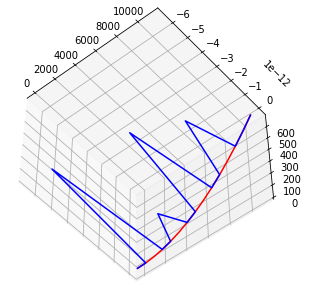

In [137]:
fig=plt.figure(figsize=(13,5))
ax = fig.gca(projection='3d')

X0=us[0][0,[i for i in range(0,node_N)]]
Y0=us[0][0,[i for i in range(2*node_N,3*node_N)]]
Z0=us[0][0,[i for i in range(4*node_N,5*node_N)]]
X=us[0][1,[i for i in range(0,node_N)]]
Y=us[0][1,[i for i in range(2*node_N,3*node_N)]]
Z=us[0][1,[i for i in range(4*node_N,5*node_N)]]
ax.plot(X0,Y0,Z0, color='r')
ax.plot(X,Y,Z, color='b') 
ax.view_init(-50,-50)
# ax.view_init(0,-90)
# ax.set_xlim([0, 5])
# ax.set_ylim([0, 5])
plt.show()

In [138]:
X,Y,Z

(array([    0.        ,   789.4774889 ,  1578.95497778,  2368.43246667,
         3157.90995554,  3947.38744445,  4736.86493334,  5526.34242226,
         6315.81991109,  7105.29740005,  7894.77488886,  8684.25237779,
         9473.72986672, 10263.20735553, 11052.68484446]),
 array([ 0.00000000e+00,  2.07211368e-17, -6.51332000e-12, -1.78327592e-18,
         4.33422442e-17, -1.41644876e-12, -9.94413653e-20,  4.70292854e-17,
        -4.91290758e-12, -1.44777213e-17, -3.76268731e-16, -2.91867280e-12,
        -7.14949755e-17, -3.32360035e-16,  0.00000000e+00]),
 array([  0.        ,   3.53834658,  14.15367063,  31.84682507,
         56.61923152,  88.4728804 , 127.41033113, 173.43471226,
        226.54972179, 286.75962744, 354.06926698, 428.48404866,
        510.0099516 , 598.65352629, 694.42189511]))

In [139]:
X0,Y0,Z0

(array([    0.        ,   789.47748889,  1578.95497778,  2368.43246667,
         3157.90995556,  3947.38744445,  4736.86493334,  5526.34242223,
         6315.81991112,  7105.29740001,  7894.7748889 ,  8684.25237779,
         9473.72986668, 10263.20735557, 11052.68484446]),
 array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
 array([  0.        ,   3.53834658,  14.15367063,  31.84682507,
         56.61923152,  88.4728804 , 127.41033113, 173.43471226,
        226.54972179, 286.75962744, 354.06926698, 428.48404866,
        510.0099516 , 598.65352628, 694.42189511]))

In [140]:
E = 210e9

In [141]:
E*A

16991625880.187403

In [142]:
1e10

10000000000.0

In [ ]:
plot3D(us, numDataPoints, FPS, filename, 3)